In [ ]:
pip install tensorflow_addons --upgrade

Requirement already up-to-date: tensorflow_addons in /usr/local/lib/python3.6/dist-packages (0.12.0)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from google_drive_downloader import GoogleDriveDownloader as gdd

gdd.download_file_from_google_drive(file_id='1_zUFIockLOs5pkGbzEjRU4Em5xvq4ayz',
                                    dest_path='./27-jan.zip',
                                    unzip=False)

In [ ]:
!unzip 27-jan.zip

Archive:  27-jan.zip
replace battery_received.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: battery_received.txt    
replace data_received.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: data_received.txt       


In [ ]:
!ls

27-jan.zip	      data_received.txt  model.png
battery_received.txt  drive		 sample_data


In [ ]:
folder_name = 'prueba_18'

## Data Wrangling

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
sns.set_theme()
sns.set_context("paper")

### Sensor data (Temp, Humidity, RSSI)

In [ ]:
df_sensor = pd.read_csv('data_received.txt')
df_sensor

,ADDR,TIME,TID,TEMP,HUM,RSSI
0,6e6d651fbae3,1.573128e+09,203,1991,1119,-63
1,d8896dfe78e4,1.573128e+09,230,1871,1203,-47
2,352299f096d2,1.573128e+09,229,1943,1168,-43
3,e03dbb9965ed,1.573128e+09,226,3370,641,-81
4,c9dc1485bfd2,1.573128e+09,148,1867,1189,-62
...,...,...,...,...,...,...
1277635,b2bac19576cb,1.580143e+09,18,1579,1265,-60
1277636,61cc6cb2b2f8,1.580143e+09,37,2032,1006,-48
1277637,cb578dd18bce,1.580143e+09,70,2007,1414,-63
1277638,8af3d1337ee3,1.580143e+09,80,3945,484,-46


In [ ]:
# List of ADDR's
df_sensor.ADDR.unique()

array(['6e6d651fbae3', 'd8896dfe78e4', '352299f096d2', 'e03dbb9965ed',
       'c9dc1485bfd2', 'a666402cc7e9', '2b3951d7d4e5', '621216cbcaef',
       '75284b4ab4f9', 'a11bc51cf0cc', '149f971bf5c6', 'ccd28aa193cf',
       '786d1ebbc2c4', '88f48d709fdc', 'b42beaa51dec', 'fe44df630cc9',
       'f0c1637bc7f7', 'b2bac19576cb', '80dfee69bfcb', '8dda80cf20c0',
       '291fb77414f6', '2ffd9d37a7e8', 'cbc218f165e9', '3a86ad3ac0cd',
       'bc3d9b569fc9', '61cc6cb2b2f8', '4ab8aaf5d0f9', '24f402b45cde',
       '69b774f031db', 'c5d81f77f0ed', 'acc8d5c002c3', '8af3d1337ee3',
       'cb578dd18bce', '7dc6e2194aec', '2bfcca8c64e4', '6fd7226a95dd',
       'c1476ee349ca'], dtype=object)

In [ ]:
groups = df_sensor.groupby('ADDR')  
groups_sensor = [groups.get_group(x) for x in groups.groups]

[                 ADDR          TIME  TID  TEMP   HUM  RSSI
 10       149f971bf5c6  1.573128e+09  231  1971  1108   -74
 40       149f971bf5c6  1.573128e+09  232  2382  1284   -53
 71       149f971bf5c6  1.573128e+09  233  3426   686   -54
 102      149f971bf5c6  1.573128e+09  234  3623   606   -60
 135      149f971bf5c6  1.573128e+09  235  3784   560   -60
 ...               ...           ...  ...   ...   ...   ...
 1277532  149f971bf5c6  1.580143e+09   60  3601   492   -55
 1277554  149f971bf5c6  1.580143e+09   61  3571   495   -54
 1277576  149f971bf5c6  1.580143e+09   62  3562   496   -55
 1277598  149f971bf5c6  1.580143e+09   63  3555   497   -55
 1277620  149f971bf5c6  1.580143e+09   64  3579   498   -55
 
 [43212 rows x 6 columns],
                  ADDR          TIME  TID  TEMP   HUM  RSSI
 27       24f402b45cde  1.573128e+09  175  1792  1210   -52
 56       24f402b45cde  1.573128e+09  176  1792  1207   -53
 88       24f402b45cde  1.573128e+09  177  1789  1210   -53
 119      2

In [ ]:
groups_sensor[0]

,ADDR,TIME,TID,TEMP,HUM,RSSI
10,149f971bf5c6,1.573128e+09,231,1971,1108,-74
40,149f971bf5c6,1.573128e+09,232,2382,1284,-53
71,149f971bf5c6,1.573128e+09,233,3426,686,-54
102,149f971bf5c6,1.573128e+09,234,3623,606,-60
135,149f971bf5c6,1.573128e+09,235,3784,560,-60
...,...,...,...,...,...,...
1277532,149f971bf5c6,1.580143e+09,60,3601,492,-55
1277554,149f971bf5c6,1.580143e+09,61,3571,495,-54
1277576,149f971bf5c6,1.580143e+09,62,3562,496,-55
1277598,149f971bf5c6,1.580143e+09,63,3555,497,-55


### Battery Data

In [ ]:
df_batt = pd.read_csv('battery_received.txt')
df_batt

,ADDR,TIME,TID,BATTERY
0,6e6d651fbae3,1.573128e+09,203,2800
1,d8896dfe78e4,1.573128e+09,230,2855
2,352299f096d2,1.573128e+09,229,2819
3,e03dbb9965ed,1.573128e+09,226,2653
4,c9dc1485bfd2,1.573128e+09,148,2855
...,...,...,...,...
1277630,80dfee69bfcb,1.580143e+09,36,1860
1277631,d8896dfe78e4,1.580143e+09,64,2148
1277632,2ffd9d37a7e8,1.580143e+09,39,2029
1277633,a11bc51cf0cc,1.580143e+09,78,1823


In [ ]:
# List of ADDR's
df_batt.ADDR.unique()

array(['6e6d651fbae3', 'd8896dfe78e4', '352299f096d2', 'e03dbb9965ed',
       'c9dc1485bfd2', 'a666402cc7e9', '2b3951d7d4e5', '621216cbcaef',
       '75284b4ab4f9', 'a11bc51cf0cc', '149f971bf5c6', 'ccd28aa193cf',
       '786d1ebbc2c4', '88f48d709fdc', 'b42beaa51dec', 'fe44df630cc9',
       'f0c1637bc7f7', 'b2bac19576cb', '80dfee69bfcb', '8dda80cf20c0',
       '291fb77414f6', '2ffd9d37a7e8', 'cbc218f165e9', '3a86ad3ac0cd',
       'bc3d9b569fc9', '61cc6cb2b2f8', '4ab8aaf5d0f9', '24f402b45cde',
       '69b774f031db', 'c5d81f77f0ed', 'acc8d5c002c3', '8af3d1337ee3',
       'cb578dd18bce', '7dc6e2194aec', '2bfcca8c64e4', '6fd7226a95dd',
       'c1476ee349ca'], dtype=object)

In [ ]:
# Are equal the ADDRs from both datasets??
df_batt.ADDR.unique() == df_sensor.ADDR.unique()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

In [ ]:
groups = df_batt.groupby('ADDR')  
groups_batt = [groups.get_group(x) for x in groups.groups]

[                 ADDR          TIME  TID  BATTERY
 10       149f971bf5c6  1.573128e+09  231     2858
 40       149f971bf5c6  1.573128e+09  232     2858
 71       149f971bf5c6  1.573128e+09  233     2858
 102      149f971bf5c6  1.573128e+09  234     2858
 135      149f971bf5c6  1.573128e+09  235     2858
 ...               ...           ...  ...      ...
 1277532  149f971bf5c6  1.580143e+09   60     1949
 1277554  149f971bf5c6  1.580143e+09   61     1949
 1277576  149f971bf5c6  1.580143e+09   62     1949
 1277598  149f971bf5c6  1.580143e+09   63     1949
 1277620  149f971bf5c6  1.580143e+09   64     1943
 
 [43212 rows x 4 columns],                  ADDR          TIME  TID  BATTERY
 27       24f402b45cde  1.573128e+09  175     2887
 56       24f402b45cde  1.573128e+09  176     2887
 88       24f402b45cde  1.573128e+09  177     2887
 119      24f402b45cde  1.573128e+09  178     2887
 151      24f402b45cde  1.573128e+09  179     2887
 ...               ...           ...  ...      ...
 12

In [ ]:
groups_batt[0]

,ADDR,TIME,TID,BATTERY
10,149f971bf5c6,1.573128e+09,231,2858
40,149f971bf5c6,1.573128e+09,232,2858
71,149f971bf5c6,1.573128e+09,233,2858
102,149f971bf5c6,1.573128e+09,234,2858
135,149f971bf5c6,1.573128e+09,235,2858
...,...,...,...,...
1277532,149f971bf5c6,1.580143e+09,60,1949
1277554,149f971bf5c6,1.580143e+09,61,1949
1277576,149f971bf5c6,1.580143e+09,62,1949
1277598,149f971bf5c6,1.580143e+09,63,1949


### Merge Data

In [ ]:
merged_groups = {} 
for i in range(len(df_batt.ADDR.unique())):
    #VERSION TO USE ONLY TEMP AND HUMIDITY
    #Group Sensor
    groups_sensor_merge = groups_sensor[i].copy()
    #Group Batt
    groups_batt_merge = groups_batt[i].copy()
    
    #Drop first and last values
    n_delete = 60
    groups_sensor_merge.drop(groups_sensor_merge.head(n_delete).index, inplace=True)
    groups_sensor_merge.drop(groups_sensor_merge.tail(n_delete).index, inplace=True)
    groups_batt_merge.drop(groups_batt_merge.head(n_delete).index, inplace=True)
    groups_batt_merge.drop(groups_batt_merge.tail(n_delete).index, inplace=True)
    
    #Fix different lengths
    # REPLACE WITH A TID-BASED FIX IN THE FUTURE IF NEEDED
    if len(groups_sensor_merge) > len(groups_batt_merge):
        groups_sensor_merge.drop(groups_sensor_merge.head(1).index, inplace=True)
    elif len(groups_sensor_merge) < len(groups_batt_merge):
        groups_batt_merge.drop(groups_batt_merge.head(1).index, inplace=True)
    
    #Subsample 1:10
    groups_sensor_merge = groups_sensor_merge.iloc[::10]
    groups_sensor_merge = groups_sensor_merge.reset_index(drop=True)
    groups_batt_merge = groups_batt_merge.iloc[::10]
    groups_batt_merge = groups_batt_merge.reset_index(drop=True)

    print(f'Groups {i}:')
    groups_sensor_merge = groups_sensor_merge.drop(columns=['TIME', 'TID', 'RSSI'])
    addr_sensor = groups_sensor_merge['ADDR'].iloc[0]
    print(f'ADDR sensor: {addr_sensor} | len: {groups_sensor_merge.shape}')
    
    #groups_batt_merge = groups_batt_merge.drop(columns=['TIME', 'TID'])
    addr_batt = groups_batt_merge['ADDR'].iloc[0]
    print(f'ADDR batt:   {addr_batt} | len: {groups_batt_merge.shape}')
       
    #Merge
    groups_merge = groups_sensor_merge.copy()
    groups_sensor_merge['TEMP'] = groups_sensor_merge['TEMP']/100
    groups_sensor_merge['HUM'] = groups_sensor_merge['HUM']/100
    print(f'Group merged shape:              {groups_sensor_merge.shape} \n')
    
    #Add to list
    merged_groups[i] = groups_sensor_merge
    
    
print(f'Len of dict of merged groups: {len(merged_groups)}')
print(f'Shape of first item of dict: {merged_groups[0].shape}')

Groups 0:
ADDR sensor: 149f971bf5c6 | len: (4310, 3)
ADDR batt:   149f971bf5c6 | len: (4310, 4)
Group merged shape:              (4310, 3) 

Groups 1:
ADDR sensor: 24f402b45cde | len: (4217, 3)
ADDR batt:   24f402b45cde | len: (4217, 4)
Group merged shape:              (4217, 3) 

Groups 2:
ADDR sensor: 291fb77414f6 | len: (3191, 3)
ADDR batt:   291fb77414f6 | len: (3191, 4)
Group merged shape:              (3191, 3) 

Groups 3:
ADDR sensor: 2b3951d7d4e5 | len: (4255, 3)
ADDR batt:   2b3951d7d4e5 | len: (4255, 4)
Group merged shape:              (4255, 3) 

Groups 4:
ADDR sensor: 2bfcca8c64e4 | len: (2524, 3)
ADDR batt:   2bfcca8c64e4 | len: (2524, 4)
Group merged shape:              (2524, 3) 

Groups 5:
ADDR sensor: 2ffd9d37a7e8 | len: (4310, 3)
ADDR batt:   2ffd9d37a7e8 | len: (4310, 4)
Group merged shape:              (4310, 3) 

Groups 6:
ADDR sensor: 352299f096d2 | len: (4309, 3)
ADDR batt:   352299f096d2 | len: (4309, 4)
Group merged shape:              (4309, 3) 

Groups 7:
ADD

In [ ]:
# Delete unwanted sensor
del merged_groups[32]
del merged_groups[25]
print(f'Len of dict of merged groups: {len(merged_groups)}')
print(merged_groups.keys())

Len of dict of merged groups: 35
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33, 34, 35, 36])


### Exploratory Data Analysis

In [ ]:
concat_df = pd.concat(merged_groups.values(), ignore_index=True)

#### Plot data

In [ ]:
for j, sensor_df in enumerate(merged_groups.values()):
    headers = list(sensor_df)
    addr = str(sensor_df['ADDR'].iloc[0])
    print(f'Sensor nº {j} - {addr} - Shape: {sensor_df.shape}')
    for i in range(1, len(headers)):
        column = str(headers[i])
        fig, ax = plt.subplots(figsize=(9,3))
        ax.set(xlabel='Samples (Time)')
        sns.lineplot(data=sensor_df[column], ax=ax).set(title=column + ' (' + addr + ')')
        plt.show()
    print('\n\n\n*******************************************')
    print('*******************************************')
    print('*******************************************\n\n\n')

#### Histograms

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='TEMP', bins='auto', kde=True, legend=False).set(title='Temperature Histogram')

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='TEMP', hue="ADDR", bins='auto', multiple='stack', legend=False).set(title='Temperature Histograms')

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['TEMP'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix_temp = series_diff[not_nan_array]

plt.figure(figsize=(9,6))
sns.histplot(series_diff_fix_temp, bins=150, legend=False).set(title='Temperature Derivative Histogram')
print(f'Max: {np.amax(series_diff_fix_temp.to_numpy())}')
print(f'Min: {np.amin(series_diff_fix_temp.to_numpy())}')

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='HUM', bins='auto', kde=True, legend=False).set(title='Humidity Histogram')

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='HUM', bins='auto', hue='ADDR', multiple='stack', legend=False).set(title='Humidity Histograms')

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['HUM'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix = series_diff[not_nan_array]

plt.figure(figsize=(9,6))
sns.histplot(series_diff_fix, bins=150, legend=False).set(title='Relative Humidity Derivative Histogram')
print(f'Max: {np.amax(series_diff_fix.to_numpy())}')
print(f'Min: {np.amin(series_diff_fix.to_numpy())}')

#### Correlations

In [ ]:
corr_df_temp = pd.DataFrame()
for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  data_temp = data[:1773,0]
  name = 'sensor_'+str(i+1)
  corr_df_temp[name]=data_temp
plt.figure(figsize=(10,10))
sns.heatmap(corr_df_temp.corr(), vmin=0, vmax=1, cmap='inferno' ,annot=False, linewidths=0)


In [ ]:
corr_df_humid = pd.DataFrame()
for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  data_temp = data[:1773,1]
  name = 'sensor_'+str(i+1)
  corr_df_humid[name]=data_temp
plt.figure(figsize=(10,10))
sns.heatmap(corr_df_humid.corr(), vmin=0, vmax=1, cmap='viridis' ,annot=False, linewidths=0)

#### Scatter Plot


In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='HUM', y='TEMP', data=concat_df, s=2).set(title='Humidity vs. Temperature')

In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='HUM', y='TEMP', data=concat_df, hue='ADDR',legend=False, s=2).set(title='Humidity vs. Temperature')

In [ ]:
sns.jointplot(data=concat_df, x='HUM', y='TEMP',  kind='kde', height=10, fill=True)

In [ ]:
sns.jointplot(data=concat_df, x='HUM', y='TEMP', s=1.8, height=10)

In [ ]:
plt.figure(figsize=(10,10))
g = sns.JointGrid(data=concat_df, x='HUM', y='TEMP', height=10)
g.plot_joint(sns.scatterplot, s=1.8)
g.plot_marginals(sns.boxplot)

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix, y=series_diff_fix_temp, s=7).set(title='Derivative Humidity vs. Derivative Temperature', 
                                                                                  xlabel='Derivative HUM',
                                                                                  ylabel='Detivative TEMP')

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix.shift(1), y=series_diff_fix_temp, s=7).set(title='Derivative lagged Humidity vs. Detivative Temperature', 
                                                                                  xlabel='Derivative HUM lagged',
                                                                                  ylabel='Derivative TEMP')

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix, y=series_diff_fix_temp.shift(1), s=7).set(title='Derivative Humidity vs. Derivative lagged Temperature', 
                                                                                  xlabel='Derivative HUM',
                                                                                  ylabel='Derivative TEMP lagged')

#### Autocorrelation & Partial Aucorrelation

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

In [ ]:
for sensor_df in merged_groups.values():
  plot_acf(sensor_df['TEMP'])

In [ ]:
for sensor_df in merged_groups.values():
  plot_pacf(sensor_df['TEMP'])

In [ ]:
for sensor_df in merged_groups.values():
  plot_acf(sensor_df['HUM'])

In [ ]:
for sensor_df in merged_groups.values():
  plot_pacf(sensor_df['TEMP'])

### Scale [-1, 1]

In [ ]:
# scale range
a = -1
b = 1

# Which are the MAX and MIN of each column??
Max_temp = -9999
Max_humid = -9999

min_temp = 9999
min_humid = 9999

for sensor_df in merged_groups.values():
    sensor_np = sensor_df.drop(columns='ADDR').to_numpy()
    for j in range(len(sensor_np)):
      if sensor_np[j,0] > Max_temp:
          Max_temp = sensor_np[j,0]
      if sensor_np[j,0] < min_temp:
          min_temp = sensor_np[j,0]
          
      if sensor_np[j,1] > Max_humid:
          Max_humid = sensor_np[j,1]
      if sensor_np[j,1] < min_humid:
          min_humid = sensor_np[j,1]

print(f'Max Temp: {Max_temp}')
print(f'min Temp: {min_temp}')
print(' ')

print(f'Max Humid: {Max_humid}')
print(f'min Humid: {min_humid}')
print(' ')

# Scaling between -1 and 1
diff_temp = Max_temp - min_temp
diff_humid = Max_humid - min_humid

scaled_groups = {} 

for i,sensor_df in enumerate(merged_groups.values()):
  sensor_np = sensor_df.drop(columns='ADDR').to_numpy()
  sensor_sc = np.empty(sensor_np.shape)
  for j in range(len(sensor_np)):
    sensor_sc[j,0] = ((b-a)*(sensor_np[j,0] - min_temp) /(diff_temp) ) + a
    sensor_sc[j,1] = ((b-a)*(sensor_np[j,1] - min_humid)/(diff_humid)) + a
  scaled_groups[i] = sensor_sc

print(f'Len of dict of scaled groups: {len(scaled_groups)}')

Max Temp: 46.94
min Temp: 8.14
 
Max Humid: 23.03
min Humid: 3.0
 
Len of dict of scaled groups: 35


### Prepare data to supervised problem

In [ ]:
# split a multivariate sequence into samples
def split_sequences(sequences, n_steps_in, n_steps_out):
	X, y = list(), list()
	for i in range(len(sequences)):
		# find the end of this pattern
		end_ix = i + n_steps_in
		out_end_ix = end_ix + n_steps_out
		# check if we are beyond the dataset
		if out_end_ix > len(sequences):
			break
		# gather input and output parts of the pattern
		seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, :]
		X.append(seq_x)
		y.append(seq_y)
	return X, y

In [ ]:
n_steps_in = 24
n_steps_out = 1

X = []
y = []
label_sensor = []
for i, sensor_np in enumerate(scaled_groups.values()):
    sensor_X, sensor_y = split_sequences(sensor_np, n_steps_in, n_steps_out)
    for j in range(len(sensor_X)):
      label_sensor.append(i)
    X.extend(sensor_X)
    y.extend(sensor_y)
    
X_sc = np.array(X)
y_sc = np.array(y)
label_sc = np.array(label_sensor)
print(X_sc.shape)
print(y_sc.shape)
print(label_sc.shape)

(125763, 24, 2)
(125763, 1, 2)
(125763,)


In [ ]:
# Number of classes
n_classes = len(np.unique(label_sc))
n_classes

In [ ]:
print(f'Sensor #{label_sc[0]}\n')
print(X_sc[0])
print('\n')
print(y_sc[0]) 

Sensor #18


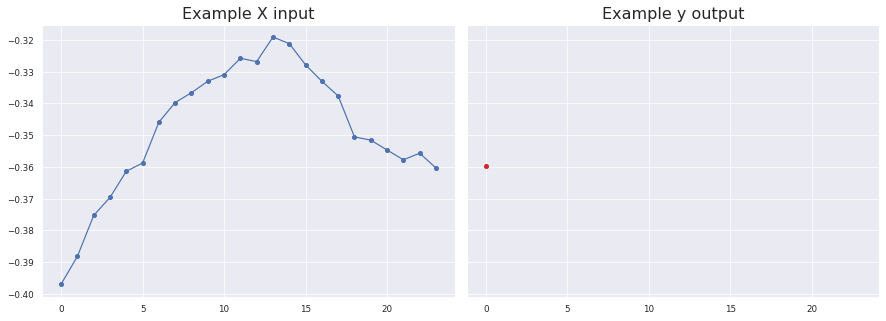

In [ ]:
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_sc[66666,:,0], marker='.', ms=8)
axs[0].set_title('Example X input', fontsize=16)
axs[1].plot(y_sc[66666,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y output', fontsize=16)
print(f'Sensor #{label_sc[66666]}')

### Split Train - Test

In [ ]:
list_ix = list(range(0,X_sc.shape[0]))
print(len(list_ix))

125763


In [ ]:
from sklearn.model_selection import train_test_split
import random
random.shuffle(list_ix)

In [ ]:
max_val_ix = 9999999
security_margin = len(list_ix) - (n_steps_in) 

while (max_val_ix > security_margin):
  train_ix, val_ix = train_test_split(list_ix, test_size=0.20, train_size=0.80)
  max_val_ix = np.amax(val_ix)

print(f'len(train_ix): {len(train_ix)}')
print(f'len(val_ix): {len(val_ix)}')
print(f'total: {len(train_ix)+len(val_ix)}')
print(f'\nmax_val_ix: {max_val_ix}')

len(train_ix): 100610
len(val_ix): 25153
total: 125763

max_val_ix: 125731


In [ ]:
X_train = X_sc[train_ix]
X_val = X_sc[val_ix]

y_train = y_sc[train_ix]
y_val = y_sc[val_ix]

label_train = label_sc[train_ix].astype('float32')
label_val = label_sc[val_ix].astype('float32')

In [ ]:
print(f'X_train shape: {X_train.shape}')
print(f'X_val shape: {X_val.shape}')
print('')
print(f'y_train shape: {y_train.shape}')
print(f'y_val shape: {y_val.shape}')
print('')
print(f'label_train shape: {label_train.shape}')
print(f'label_val shape: {label_val.shape}')

X_train shape: (100610, 24, 2)
X_val shape: (25153, 24, 2)

y_train shape: (100610, 1, 2)
y_val shape: (25153, 1, 2)

label_train shape: (100610,)
label_val shape: (25153,)


Sensor #22.0


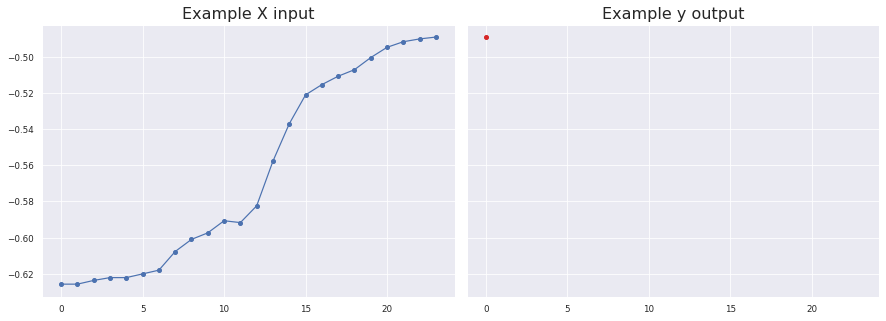

In [ ]:
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_val[666,:,0], marker='.', ms=8)
axs[0].set_title('Example X input', fontsize=16)
axs[1].plot(y_val[666,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y output', fontsize=16)
print(f'Sensor #{label_val[666]}')

In [ ]:
# constants/lists for later use
X_train_list = list(X_train)
X_train_len = len(X_train)
X_val_len = len(X_val)
X_len = len(X_sc)

In [ ]:
X_val_range = np.arange(X_val_len)
print(X_val_range.shape)
print(X_val_range)

(25153,)
[    0     1     2 ... 25150 25151 25152]


In [ ]:
# get real values for comparison - validation set
n_prediction = 24
y_val_real_long = np.empty([X_val_len, n_prediction, 2])
for k, index in enumerate(val_ix):
    index_plus = index + n_prediction
    y_val_real_ = y_sc[index:index_plus, :, :]
    y_val_real = y_val_real_.reshape(1, n_prediction, 2)
    y_val_real_long[k,:,:] = y_val_real
print(f'y_val_real_long shape {y_val_real_long.shape}')

y_val_real_long shape (25153, 24, 2)


Sensor #22.0


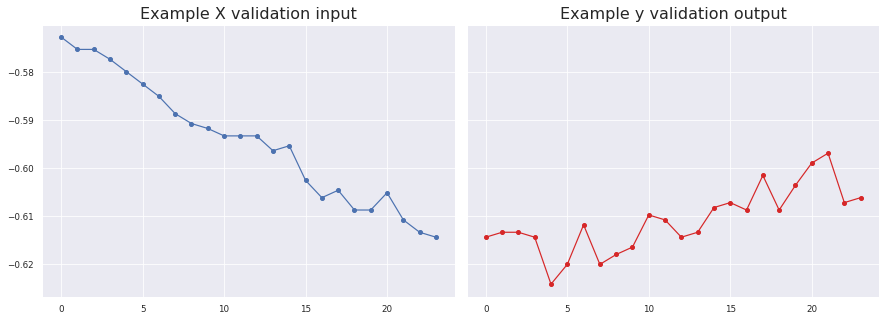

In [ ]:
sns.set_theme()
sns.set_context("paper")
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_val[669,:,0], marker='.', ms=8)
axs[0].set_title('Example X validation input', fontsize=16)
axs[1].plot(y_val_real_long[669,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y validation output', fontsize=16)
print(f'Sensor #{label_val[666]}')

In [ ]:
# dimensions for X to feed the models
dim_out_step = y_train.shape[1]
dim_in_step = X_train.shape[1]
dim_in_plus_out = X_train.shape[1] + y_train.shape[1]
dim_n_vars = X_train.shape[2]
print(f'dim_out_step {dim_out_step}')
print(f'dim_in_step {dim_in_step}')
print(f'dim_in_plus_out {dim_in_plus_out}')
print(f'dim_n_vars {dim_n_vars}')

dim_out_step 1
dim_in_step 24
dim_in_plus_out 25
dim_n_vars 2


In [ ]:
dict_variables = {
    0: 'Temp',
    1: 'Humid'
}

## Wasserstein GAN Gradient Penalty model

In [ ]:
from tensorflow.keras import backend
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras.layers import Dense, Conv1D, BatchNormalization, LSTM, LeakyReLU
from tensorflow.keras.layers import Flatten, Input, Dropout, concatenate, Embedding, Reshape
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.constraints import Constraint
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from tensorflow import concat
from tensorflow.keras.utils import plot_model
import tensorflow_addons as tfa
import tensorflow as tf

from astropy import stats

from math import log2, log, isclose

from scipy.special import kl_div, rel_entr
from scipy.spatial.distance import jensenshannon

from sklearn.metrics import r2_score, max_error, mean_absolute_error, mean_squared_error

In [ ]:
# define the standalone critic model
def define_critic(in_shape=(25, 2), n_classes=35):
	# weight initialization
	init = RandomNormal(stddev=0.02)
 	# define model
	# input time series
	input_layer = Input(shape=in_shape, name='Time-Series_Input')
	#real_next_ = input_layer[:,-1,:] 
	#real_next_layer = Dense(2)(real_next_)
	# block 1
	x = tfa.layers.SpectralNormalization(Conv1D(64, kernel_size=4, strides=1, padding='same', 
      				kernel_initializer=init))(input_layer)
	x = LeakyReLU(alpha=0.2)(x)
	# block 2
	x = tfa.layers.SpectralNormalization(Conv1D(128, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.2)(x)
  # block 3
	x = tfa.layers.SpectralNormalization(Conv1D(192, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.2)(x)
  # block 4
	x = tfa.layers.SpectralNormalization(Conv1D(384, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	# Dense block
	x = Flatten()(x)
	x = Dense(32)(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.15)(x)
  # label input
	in_label = Input(shape=(1,), name='Categorical_Input')
	emb_layer = Embedding(n_classes, 8)(in_label) 
	emb_layer = Dense(8)(emb_layer)
	emb_layer = Reshape((8,))(emb_layer)
  # output
	merge_out = concatenate([x, emb_layer])
	out_layer = Dense(16)(merge_out)
	out_layer = LeakyReLU(alpha=0.2)(out_layer)
	out_layer_ = Dense(1, activation='linear')(out_layer)
	model = Model([input_layer, in_label], out_layer_)
	print(model.summary())
	return model

# define the standalone generator model
def define_generator(latent_dim=8, in_shape=(24, 2), n_classes=35):
	# weight initialization
	init = RandomNormal(stddev=0.02)
 	# define model
	# inputs
	in_condition = Input(shape=in_shape, name='Time-Series_Input')
	x = LSTM(160, kernel_initializer=init, return_sequences=True)(in_condition)
	x = BatchNormalization()(x)
	x = LSTM(64, kernel_initializer=init, return_sequences=False)(x)
	x = BatchNormalization()(x)  
  # label input
	in_label = Input(shape=(1,), name='Categorical_Input')
	emb_layer = Embedding(n_classes, 8)(in_label)
	emb_layer = Dense(8)(emb_layer)
	emb_layer = BatchNormalization()(emb_layer)
	emb_layer = Reshape((8,))(emb_layer)
	# noise block
	in_noise = Input(shape=(latent_dim,), name='Noise_Input')
	# merge and dense block
	merge = concatenate([x, emb_layer, in_noise])
	out_layer = Dense(32)(merge)
	out_layer = BatchNormalization()(out_layer)
	out_layer = LeakyReLU(alpha=0.2)(out_layer)
	out_layer_ = Dense(2, activation='linear')(out_layer)
	model = Model([in_condition, in_label, in_noise], out_layer_)
	print(model.summary())
	return model

class WGAN(tf.keras.Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_extra_steps=5,
        gp_weight=10.0,
    ):
        super(WGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_extra_steps
        self.gp_weight = gp_weight

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super(WGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn

    def gradient_penalty(self, batch_size, labels, real_images, fake_images):
        # both have shape [None, 1, 2]
        # get the interplated image
        alpha = tf.random.normal([batch_size, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
            pred = self.discriminator([interpolated, labels], training=True)
        # 2. Calculate the gradients w.r.t to this interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        # For each batch:
        # 1. Train the generator and get the generator loss
        # 2. Train the discriminator and get the discriminator loss
        # 3. Calculate the gradient penalty
        # 4. Multiply this gradient penalty with a constant weight factor
        # 5. Add gradient penalty to the discriminator loss
        # 6. Return generator and discriminator losses as a loss dictionary.
        input_data, labels = real_images
        real_next_ = input_data[:,-1,:] 
        real_next =  backend.expand_dims(real_next_,axis=1) #[None, 1, 2]
        X_cond = input_data[:,:-1,:] #[None, 24, 2]
        # Get the batch size
        batch_size = tf.shape(input_data)[0]
        # Train discriminator first. The original paper recommends training
        # the discriminator for `x` more steps (typically 5) as compared to
        # one step of the generator
        for i in range(self.d_steps):
            # Get the latent vector
            random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
            with tf.GradientTape() as tape:
                # Generate fake images from the latent vector
                fake_images_ = self.generator([X_cond, labels, random_latent_vectors], training=True)
                fake_images_ = backend.expand_dims(fake_images_,axis=1)
                fake_images = concat([X_cond,fake_images_],axis=1)
                # Get the logits for the fake images
                fake_logits = self.discriminator([fake_images, labels], training=True)
                # Get the logits for real images
                real_logits =self.discriminator([input_data, labels], training=True)

                # Calculate discriminator loss using fake and real logits
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Calculate the gradient penalty
                gp = self.gradient_penalty(batch_size, labels, input_data, fake_images)
                # Add the gradient penalty to the original discriminator loss
                d_loss = d_cost + gp * self.gp_weight
            # Get the gradients w.r.t the discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
            # Update the weights of the discriminator using the discriminator optimizer
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )
        # Train the generator now.
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Generate fake images using the generator
            gen_images_ = self.generator([X_cond, labels, random_latent_vectors], training=True)
            gen_images_ = backend.expand_dims(gen_images_,axis=1)
            generated_images = concat([X_cond,gen_images_],axis=1)
            # Get the discriminator logits for fake images
            gen_img_logits = self.discriminator([generated_images, labels], training=True)
            # Calculate the generator loss
            g_loss = self.g_loss_fn(gen_img_logits)
        # Get the gradients w.r.t the generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update the weights of the generator using the generator optimizer
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}

class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, num_test=2500, latent_dim=8, previous_KL=9999, previous_MSE=9999, previous_Pinball=9999):
        self.num_test = num_test
        self.latent_dim = latent_dim
        self.previous_KL = previous_KL
        self.previous_MSE = previous_MSE
        self.previous_Pinball = previous_Pinball
        self.d_hist = list()
        self.g_hist = list()

    def on_train_batch_end(self, batch, logs=None):
      # append losses for visualization later
      self.d_hist.append(logs.get('d_loss'))
      self.g_hist.append(logs.get('g_loss'))

    def on_epoch_end(self, epoch, logs=None):
      previous_KL = self.previous_KL
      previous_MSE = self.previous_MSE
      previous_Pinball = self.previous_Pinball
      step = epoch
      c_model = self.model.discriminator
      g_model = self.model.generator
      latent_dim = self.latent_dim
      n_prediction = 24
      n_plots = 4
      n_samples = X_val_len

      # Get predictions
      X_aux_2 = np.copy(X_val)
      for p in range(n_prediction):
      	noise_input = tf.random.normal(shape=(n_samples, latent_dim))
      	y_gen_ = g_model.predict([X_aux_2, label_val, noise_input]) #Step 1: Predict [val_len,2]
      	y_gen = y_gen_[:,np.newaxis,:] #[val_len,1,2]
      	if p == 0: #Step 2: Save prediction
      	  y_gen_final = y_gen.copy() 
      	else:
      	  y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
      	X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      	X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
      
      # invert scale
      y_real_inv = np.empty(y_val_real_long.shape)
      y_gen_inv = np.empty(y_gen_final.shape)
      X_cond_inv = np.empty(X_val.shape)
      for s in range(n_samples):
      	for r in range(n_prediction):
      		y_real_inv[s,r,0] = (y_val_real_long[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		y_real_inv[s,r,1] = (y_val_real_long[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
      		y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
      	for t in range(n_prediction):
      		X_cond_inv[s,t,0] = (X_val[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		X_cond_inv[s,t,1] = (X_val[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
        
      temp_real = y_real_inv[:,:,0]
      flat_temp_real = temp_real.flatten()
      temp_gen = y_gen_inv[:,:,0]
      flat_temp_gen = temp_gen.flatten()
      humid_real = y_real_inv[:,:,1]
      flat_humid_real = humid_real.flatten()
      humid_gen = y_gen_inv[:,:,1]
      flat_humid_gen = humid_gen.flatten()

      ### METRICS ###

			# KL divergence with 2D histogram
      H_compute_bins_temp = np.histogram(flat_temp_real, bins='auto')
      H_compute_bins_humid = np.histogram(flat_humid_real, bins='auto')
      n_bins_temp = H_compute_bins_humid[0].shape[0]
      n_bins_humid = H_compute_bins_humid[0].shape[0]
      # If we add more than 2 variables we will need to use np.histogramdd
      H_real, xedges_real, yedges_real = np.histogram2d(flat_temp_real, flat_humid_real, bins=[n_bins_temp,n_bins_humid])
      H_real = (np.where(H_real==0, 1e-6, H_real).flatten())/len(flat_temp_real)
      H_gen, xedges_gen, yedges_gen = np.histogram2d(flat_temp_gen, flat_humid_gen, bins=[n_bins_temp,n_bins_humid])
      H_gen = (np.where(H_gen==0, 1e-6, H_gen).flatten())/len(flat_temp_gen)
      assert isclose(sum(H_real),1.,rel_tol=1e-5)
      assert isclose(sum(H_gen), 1.,rel_tol=1e-5)
      KL_diverg = kl_divergence(H_gen,H_real)

      # Pinball Loss Function
      pinball_temp = list()
      pinball_humid = list()
      tau = [0.1, 0.3, 0.5, 0.7, 0.9]
      for t in tau:
        pinball_temp.append(pinball_func(flat_temp_real, flat_temp_gen, tau=t))
        pinball_humid.append(pinball_func(flat_humid_real, flat_humid_gen, tau=t))

      pinball_mean_temp = sum(pinball_temp)/(len(pinball_temp))
      pinball_mean_humid = sum(pinball_humid)/(len(pinball_humid))
      Pinball_mean = (pinball_mean_temp + pinball_mean_humid)/2

			#MSE
      MSE_temp = mean_absolute_error(flat_temp_real, flat_temp_gen)
      MSE_humid = mean_absolute_error(flat_humid_real, flat_humid_gen)
      MSE_mean = (MSE_temp + MSE_humid)/2

      # random samples fron validation set to plot
      ix_plot = np.random.choice(X_val_range, n_plots, replace=False)

      # save models
      tail_name_kl = ''
      tail_name_pinball = ''
      tail_name_mse = ''
      save_models = False
      print('')
      if (KL_diverg < previous_KL):
      	self.previous_KL = KL_diverg
      	save_models = True
      	tail_name_kl = '_KL'
      	print('Better KL')
      if (Pinball_mean < previous_Pinball):
      	self.previous_Pinball = Pinball_mean
      	save_models = True
      	tail_name_pinball = '_Pinball'
      	print('Better Pinball')
      if (MSE_mean < previous_MSE):
      	self.previous_MSE = MSE_mean
      	save_models = True
      	tail_name_mse = '_MSE'
      	print('Better MSE')
      if save_models == True:
        filename_critic = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'c_model_'+str(step+1)+tail_name_kl+tail_name_pinball+tail_name_mse
        c_model.save_weights(filename_critic)
        filename_generator = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'gen_model_'+str(step+1)+tail_name_kl+tail_name_pinball+tail_name_mse
        g_model.save_weights(filename_generator)
        print(f'>{step+1} MODELS HAVE BEEN SAVED')
        # save data
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_temp_real.npy'
        np.save(filename, temp_real)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_temp_gen.npy'
        np.save(filename, temp_gen)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_humid_real.npy'
        np.save(filename, humid_real)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_humid_gen.npy'
        np.save(filename, humid_gen)
        # plot images and metrics
        for num, i in enumerate(ix_plot):
          for j in range(dim_n_vars):
            fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
            axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
            name = dict_variables[j] + ' - Input'
            axs[0].set_title(name, fontsize=16)
            axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
            axs[1].plot(y_gen_inv[i,:,j], 'tab:red', marker='.', ms=8)
            axs[1].set_title('Output (red: predicted)', fontsize=16)
            filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_'+str(i)+'_'+str(dict_variables[j])+'.png'
            plt.savefig(filename_img)
            plt.show()
            plt.close()
            print(f'Sensor #{label_val[i]}')
            print(dict_variables[j])
						# mean absolute error ± standard deviation
            error_np = np.subtract(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            mae = mean_absolute_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            std = np.std(error_np)
            print(f'MAE: {mae} ± {std}') 
            # mean squared error
            mse = mean_squared_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            print(f'MSE: {mse}') 
						# root mean square error
            rmse = np.sqrt(mse)
            print(f'RMSE: {rmse}') 
						# max error
            max_err = max_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            print(f'Max Error: {max_err}') 
      #Print global metrics
      print(f'\nKL Divergence: {KL_diverg} bits')
      print(f'Pinball Loss Temp mean: {pinball_mean_temp}')
      print(f'Pinball Loss Humid mean: {pinball_mean_humid}')
      print(f'MSE Temp: {MSE_temp}')
      print(f'MSE Humid: {MSE_humid}')
      # plot histograms
      fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(12,4),gridspec_kw={'wspace': 0.03})
      #axs[0].hist(flat_temp_real, bins='auto')
      axs[0].set_title('Temp Real Distribution', fontsize=14)
      sns.histplot(flat_temp_real, bins=n_bins_temp, ax=axs[0])
      #axs[1].hist(flat_temp_gen, bins='auto')
      axs[1].set_title('Temp Generated Distribution', fontsize=14)
      sns.histplot(flat_temp_gen, bins=n_bins_temp, ax=axs[1])
      filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_histogram_temp.png'
      plt.savefig(filename_img)
      plt.show()
      plt.close()
      fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(12,4),gridspec_kw={'wspace': 0.03})
      #axs[0].hist(flat_humid_real, bins='auto')
      axs[0].set_title('Humid Real Distribution', fontsize=14)
      sns.histplot(flat_humid_real, bins=n_bins_humid, ax=axs[0])
      #axs[1].hist(flat_humid_gen, bins='auto')
      axs[1].set_title('Humid Generated Distribution', fontsize=14)
      sns.histplot(flat_humid_gen, bins=n_bins_humid, ax=axs[1])
      filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_histogram_humid.png'
      plt.savefig(filename_img)
      plt.show()
      plt.close()
      # plot and save history
      plot_history(self.d_hist, self.g_hist, step)

# pinball loss function [https://www.tensorflow.org/addons/api_docs/python/tfa/losses/pinball_loss]
def pinball_func(y_true, y_pred, tau):
	values = list()
	for l in range(len(y_true)):
		values.append(max(tau*(y_true[l] - y_pred[l]), (tau - 1)*(y_true[l] - y_pred[l])))
	return (sum(values)/len(values))

# calculate the kl divergence in bits
def kl_divergence(p,q):
	return sum((p[i] * log2(p[i]/q[i]) for i in range(len(p))))

# calculate the kl divergence in nats
def kl_divergence_nats(p,q):
	return sum((p[i] * log(p[i]/q[i]) for i in range(len(p))))

# create a line plot of loss for the gan and save to file
def plot_history(d_hist, g_hist, step):
	# plot history
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'final_d_hist.npy'
	np.save(filename, d_hist)
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'final_g_hist.npy'
	np.save(filename, g_hist)
	plt.plot(d_hist, label='crit')
	plt.plot(g_hist, label='gen')
	plt.legend()
	#pyplot.savefig('plot_line_plot_loss.png')
	#pyplot.close()
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_final_train_loss.png'
	plt.savefig(filename)
	plt.show()
	plt.close()
 
# Define the loss functions to be used for discrimiator
# This should be (fake_loss - real_loss)
# We will add the gradient penalty later to this loss function
def discriminator_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss

# Define the loss functions to be used for generator
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

In [ ]:
# Adam optimizer
d_opt_Adam = Adam(learning_rate=0.0003, beta_1=0.5, beta_2=0.9)
g_opt_Adam = Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.9)

### Alternative Optimizers [AdaBelief, OMD]

In [ ]:
# AdaBelief optimizer
!pip install adabelief-tf==0.1.0

In [ ]:
from adabelief_tf import AdaBeliefOptimizer
d_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=2e-4, epsilon=1e-10, rectify=False)
g_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=6.7e-5, epsilon=1e-10, rectify=False)
#g_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=2e-4, epsilon=1e-10, rectify=False)

In [ ]:
# Optimistic Mirror Descent for the Adam optimizer
from tensorflow.keras.optimizers import Optimizer
class optimAdam(Optimizer):
    def __init__(self, lr=0.001, beta_1=0.9, beta_2=0.999,
                 epsilon=1e-8, decay=0., **kwargs):
        super(optimAdam, self).__init__(**kwargs)
        with backend.name_scope(self.__class__.__name__):
            self.iterations = backend.variable(0, dtype='int64', name='iterations')
            self.lr = backend.variable(lr, name='lr')
            self.beta_1 = backend.variable(beta_1, name='beta_1')
            self.beta_2 = backend.variable(beta_2, name='beta_2')
            self.decay = backend.variable(decay, name='decay')
        self.epsilon = epsilon
        self.initial_decay = decay

    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [backend.update_add(self.iterations, 1)]

        lr = self.lr
        if self.initial_decay > 0:
            lr *= (1. / (1. + self.decay * backend.cast(self.iterations,
                                                  backend.dtype(self.decay))))

        t = backend.cast(self.iterations, backend.floatx()) + 1
        lr_t = lr * (backend.sqrt(1. - backend.pow(self.beta_2, t)) /
                     (1. - backend.pow(self.beta_1, t)))

        ms = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        vs = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        self.weights = [self.iterations] + ms + vs
        ms_old = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        vs_old = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]

        for p, g, m, v, m_old, v_old in zip(params, grads, ms, vs, ms_old, vs_old):
            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * backend.square(g)
            p_t = p - 2 * lr_t * m_t / (backend.sqrt(v_t) + self.epsilon) + lr_t * m_old / (backend.sqrt(v_old) + self.epsilon)

            self.updates.append(backend.update(m_old, m))
            self.updates.append(backend.update(v_old, v))
            self.updates.append(backend.update(m, m_t))
            self.updates.append(backend.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(backend.update(p, new_p))
        return self.updates

    def get_config(self):
        config = {'lr': float(backend.get_value(self.lr)),
                  'beta_1': float(backend.get_value(self.beta_1)),
                  'beta_2': float(backend.get_value(self.beta_2)),
                  'decay': float(backend.get_value(self.decay)),
                  'epsilon': self.epsilon}
        base_config = super(optimAdam, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

In [ ]:
# Get the Optimistic Mirror Adam optimizer
d_opt_OptimisticAdam = optimAdam(lr=0.003, beta_1=0.9, beta_2=0.999, epsilon=1e-8, decay=0., name='d_opt_OptimisticAdam')
g_opt_OptimisticAdam = optimAdam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-8, decay=0., name='g_opt_OptimisticAdam')

### Plot models

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Time-Series_Input (InputLayer)  [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization (Spectra (None, 25, 64)       640         Time-Series_Input[0][0]          
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 25, 64)       0           spectral_normalization[0][0]     
__________________________________________________________________________________________________
spectral_normalization_1 (Spect (None, 25, 128)      33024       leaky_re_lu[0][0]                
______________________________________________________________________________________________

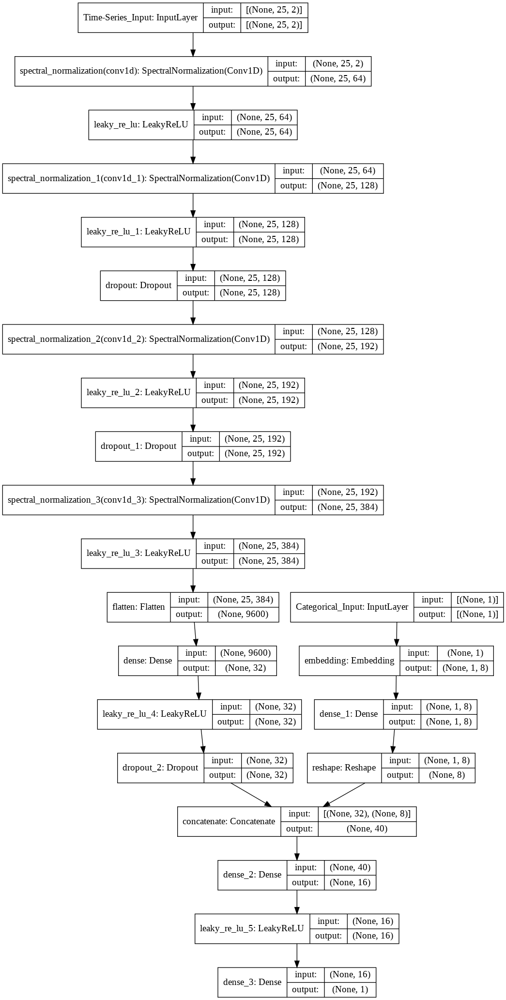

In [ ]:
d_model = define_critic(in_shape=(25, 2), n_classes=35)
plot_model(d_model, show_shapes=True)

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Time-Series_Input (InputLayer)  [(None, 24, 2)]      0                                            
__________________________________________________________________________________________________
Categorical_Input (InputLayer)  [(None, 1)]          0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 160)      104320      Time-Series_Input[0][0]          
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 1, 8)         280         Categorical_Input[0][0]          
____________________________________________________________________________________________

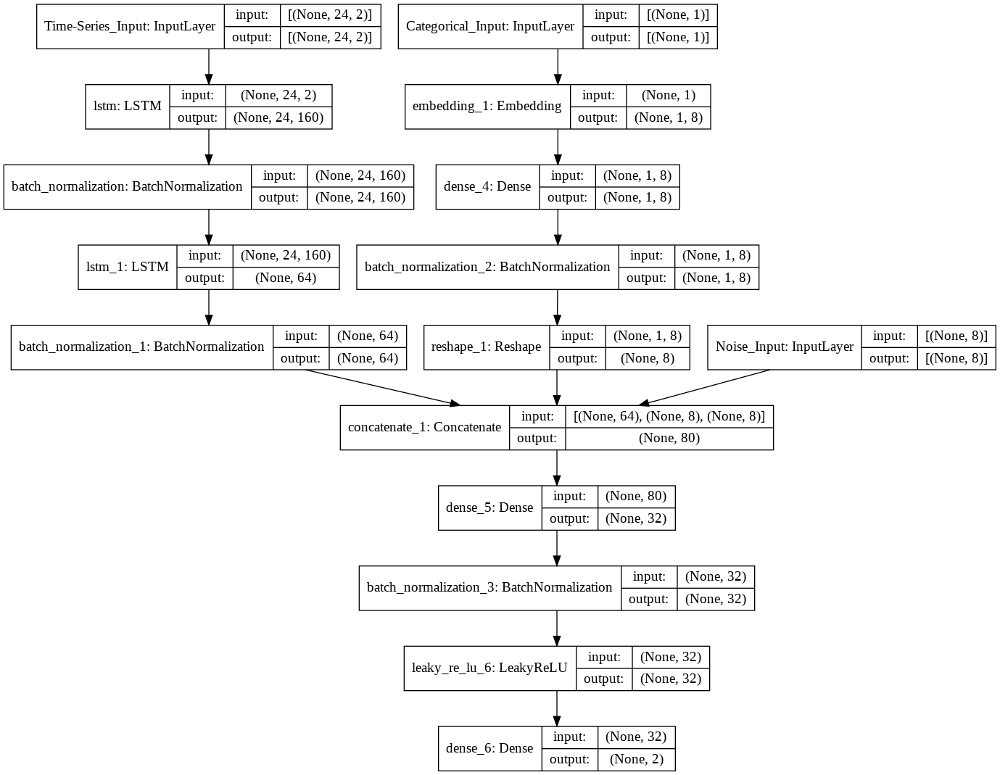

In [ ]:
g_model = define_generator(latent_dim=8, in_shape=(24, 2), n_classes=35)
plot_model(g_model, show_shapes=True)

## Training


Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization_4 (Spect (None, 25, 64)       640         input_6[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_7 (LeakyReLU)       (None, 25, 64)       0           spectral_normalization_4[0][0]   
__________________________________________________________________________________________________
spectral_normalization_5 (Spect (None, 25, 128)      33024       leaky_re_lu_7[0][0]              
_______________________________________________________________________________________

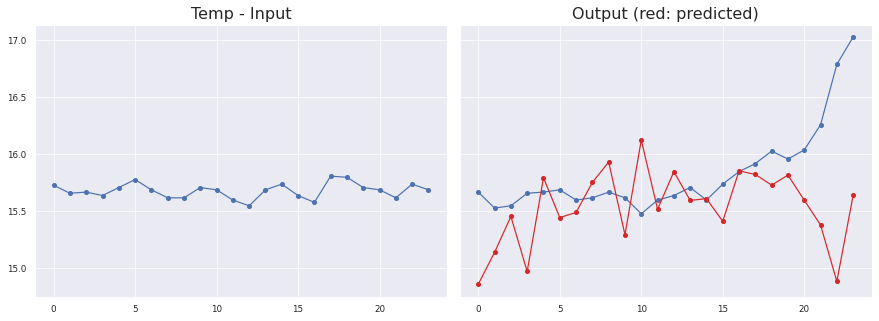

Sensor #34.0
Temp
MAE: 0.404744988481204 ± 0.5319092383298731
MSE: 0.36599124537349836
RMSE: 0.6049721029712845
Max Error: 1.9031745910644524


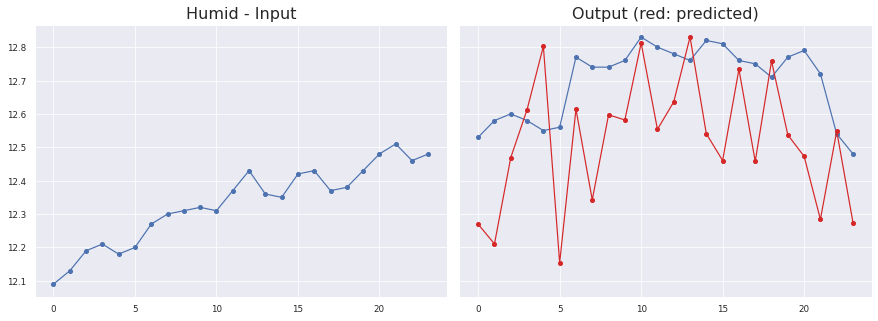

Sensor #34.0
Humid
MAE: 0.2083650091725088 ± 0.1733805514075971
MSE: 0.060353805221420836
RMSE: 0.2456701146281754
Max Error: 0.43596321463584964


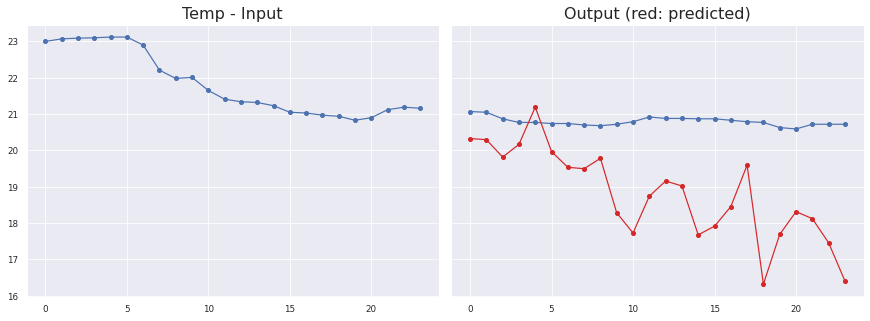

Sensor #3.0
Temp
MAE: 2.019894248545169 ± 1.2014684969926754
MSE: 5.383146039573263
RMSE: 2.3201607788197056
Max Error: 4.4507984209060645


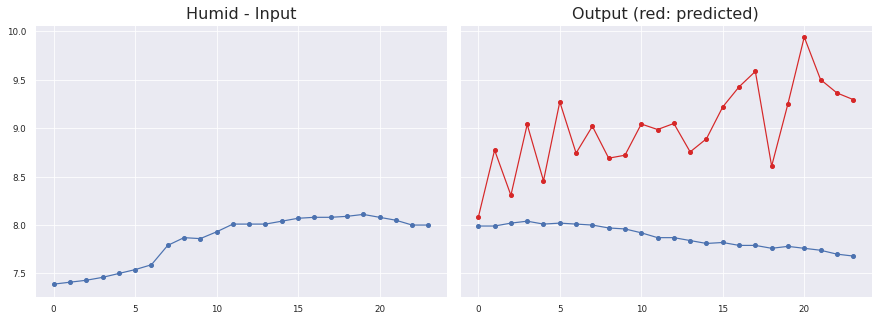

Sensor #3.0
Humid
MAE: 1.12014203508695 ± 0.4970018472599747
MSE: 1.5017290149485614
RMSE: 1.2254505354964604
Max Error: 2.1809184046089642


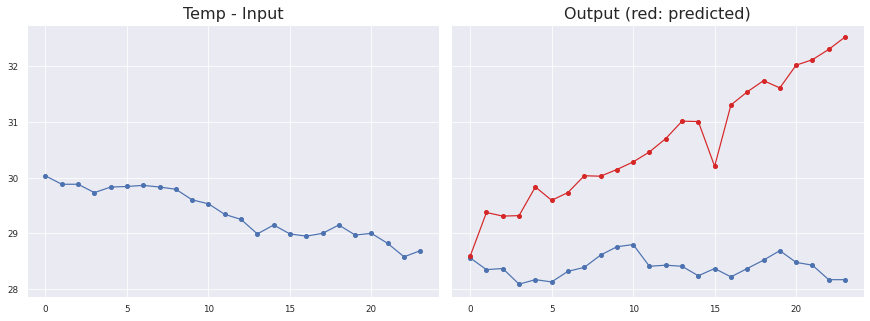

Sensor #7.0
Temp
MAE: 2.219283835527797 ± 1.0872518777980598
MSE: 6.107337388410376
RMSE: 2.4713027714973284
Max Error: 4.347723020315172


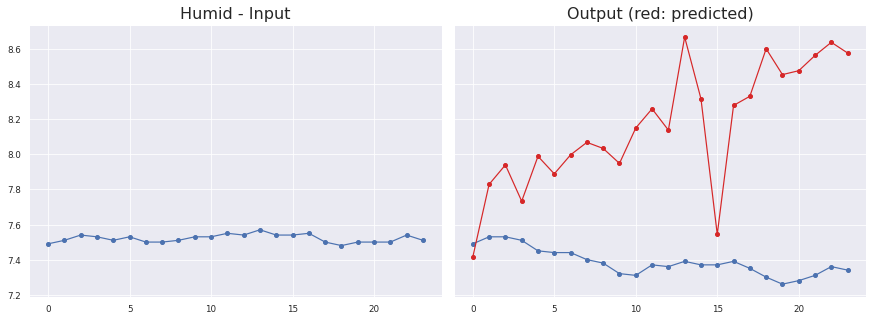

Sensor #7.0
Humid
MAE: 0.7814274365889532 ± 0.3923198602446902
MSE: 0.7548253584196599
RMSE: 0.8688068591002606
Max Error: 1.3025658257305608


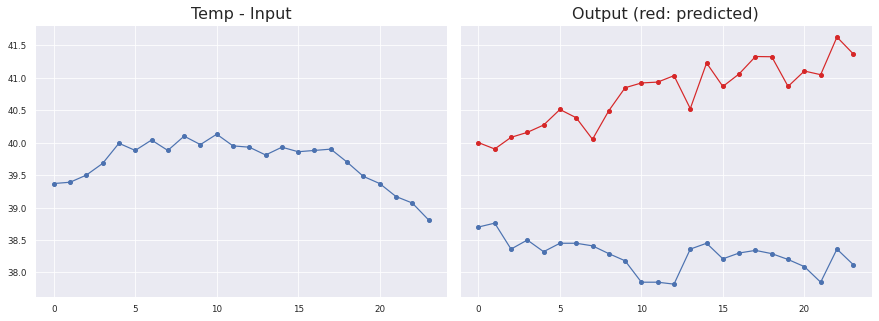

Sensor #19.0
Temp
MAE: 2.4754378437995888 ± 0.6501894746858418
MSE: 6.550538871507409
RMSE: 2.5594020535092583
Max Error: 3.2667995977401745


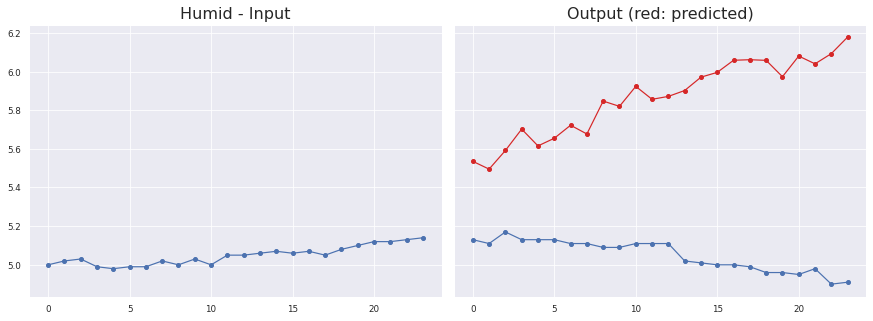

Sensor #19.0
Humid
MAE: 0.8128148427853984 ± 0.26534179354012805
MSE: 0.7310742360513439
RMSE: 0.8550287925276808
Max Error: 1.2682080191373828

KL Divergence: 3.3737717707715627 bits
Pinball Loss Temp mean: 0.919997624852566
Pinball Loss Humid mean: 0.4170045871193719
MSE Temp: 1.83999524970517
MSE Humid: 0.834009174238747


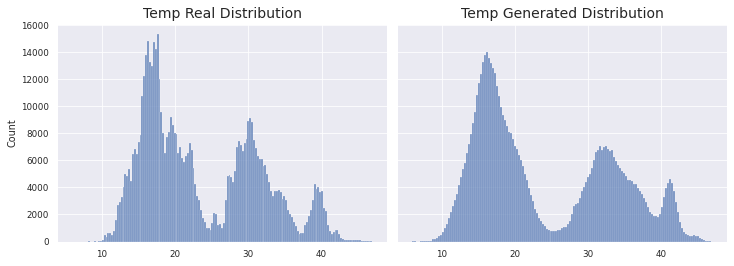

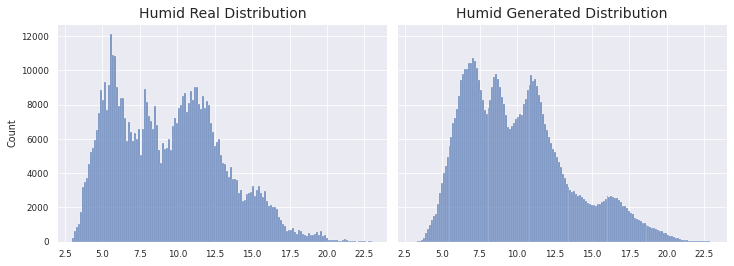

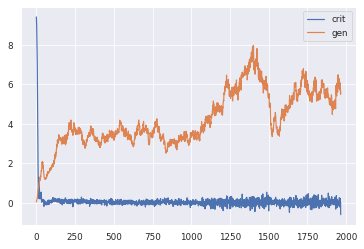

1966/1966 [==============================] - 139s 71ms/step - d_loss: 0.0764 - g_loss: 4.2081
Epoch 2/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0337 - g_loss: 4.2013

KL Divergence: 4.12055149399981 bits
Pinball Loss Temp mean: 2.3248264093422
Pinball Loss Humid mean: 0.688734227608036
MSE Temp: 4.649652818684382
MSE Humid: 1.3774684552160734


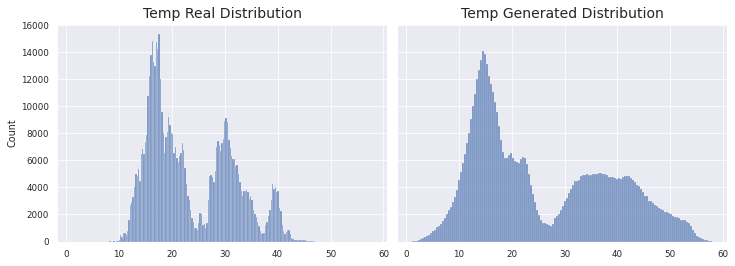

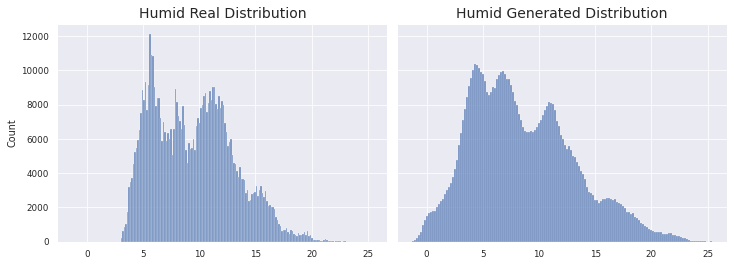

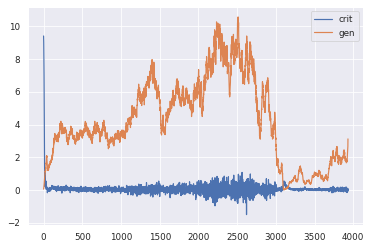

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0337 - g_loss: 4.2002
Epoch 3/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0136 - g_loss: 4.2104

KL Divergence: 4.227012515214724 bits
Pinball Loss Temp mean: 1.8559317242297915
Pinball Loss Humid mean: 0.7487061206951966
MSE Temp: 3.711863448459613
MSE Humid: 1.4974122413903759


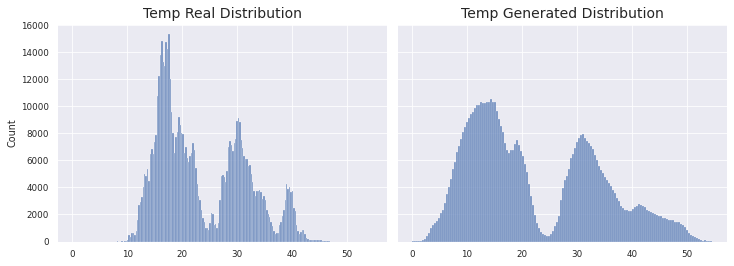

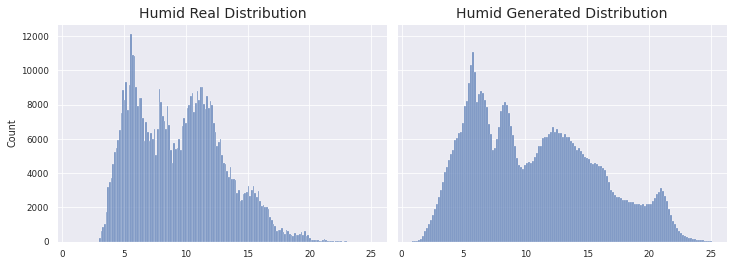

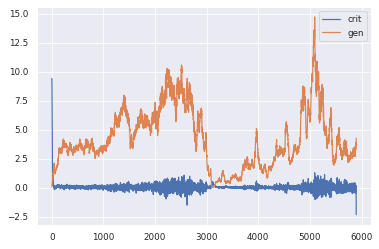

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0112 - g_loss: 4.2105
Epoch 4/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0375 - g_loss: 3.8169
Better KL
>4 MODELS HAVE BEEN SAVED


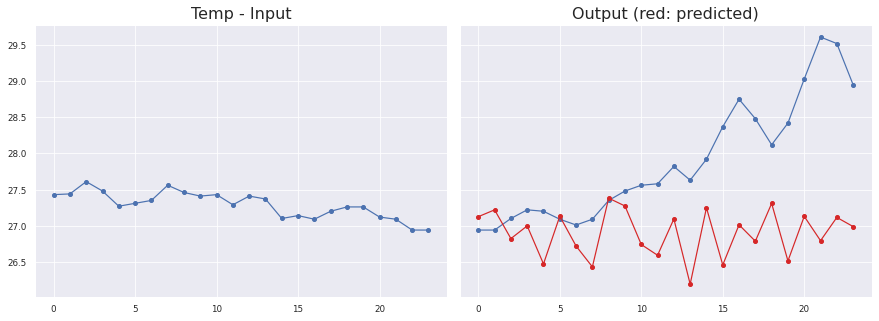

Sensor #13.0
Temp
MAE: 1.029707888048143 ± 0.8603444075060253
MSE: 1.7102958461856683
RMSE: 1.307782797786264
Max Error: 2.816826279908419


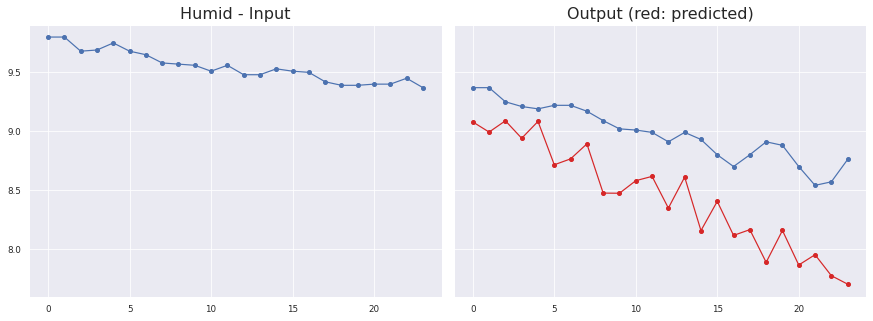

Sensor #13.0
Humid
MAE: 0.5322801764495669 ± 0.2432958035780043
MSE: 0.3425150342798489
RMSE: 0.5852478400471453
Max Error: 1.0593083238601677


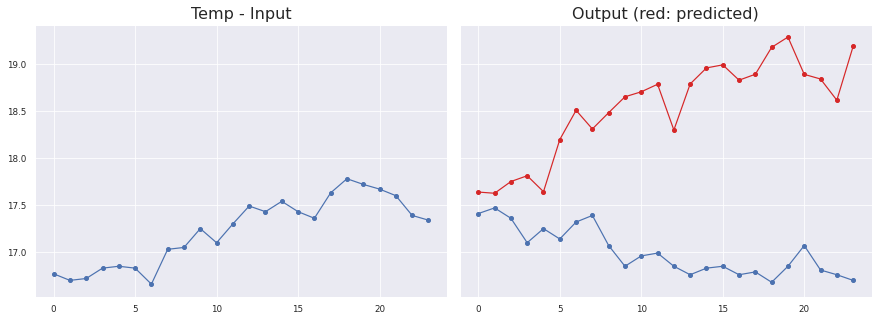

Sensor #28.0
Temp
MAE: 1.534286152174075 ± 0.7207541868923266
MSE: 2.8735205946759472
RMSE: 1.6951461868157411
Max Error: 2.4962961232662195


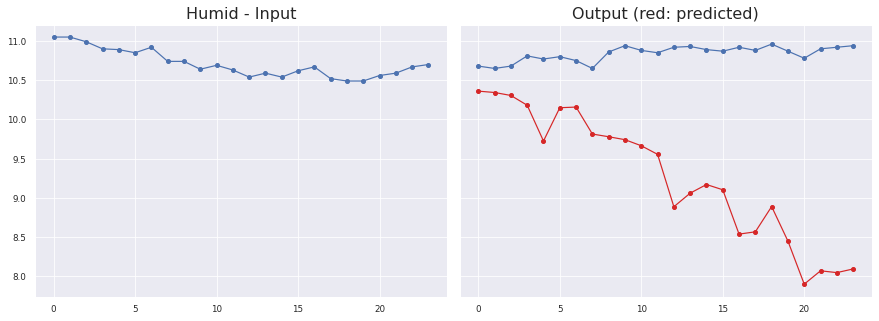

Sensor #28.0
Humid
MAE: 1.56395399276788 ± 0.8620459750461288
MSE: 3.1890753545878248
RMSE: 1.7857982401681958
Max Error: 2.8787130293250076


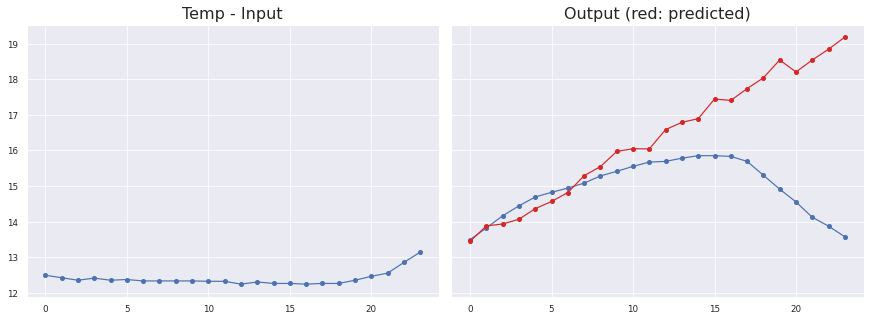

Sensor #30.0
Temp
MAE: 1.5205219623943174 ± 1.7743702291006334
MSE: 5.127046580987288
RMSE: 2.264298253540661
Max Error: 5.613657898902893


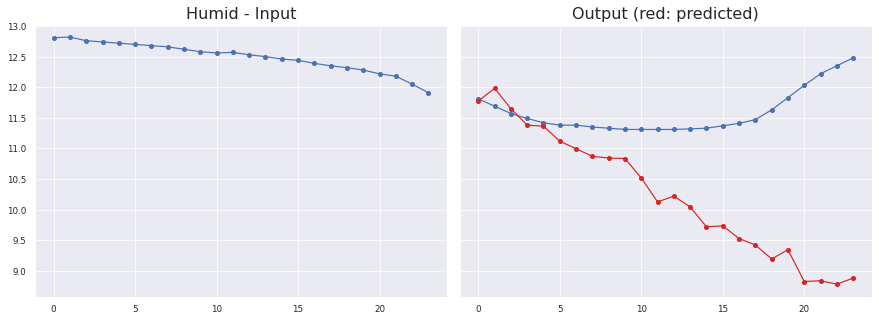

Sensor #30.0
Humid
MAE: 1.3691821537322053 ± 1.2147516381827945
MSE: 3.2662901567231413
RMSE: 1.807288066890041
Max Error: 3.5995300087332716


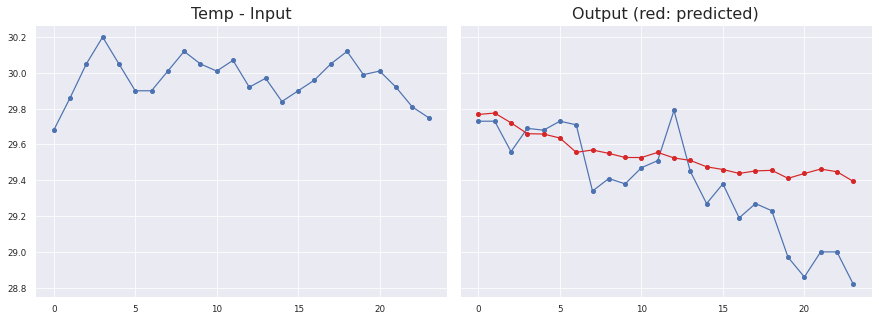

Sensor #7.0
Temp
MAE: 0.20563611447811056 ± 0.21410364781137162
MSE: 0.07099743716140096
RMSE: 0.2664534427651498
Max Error: 0.5779721993207936


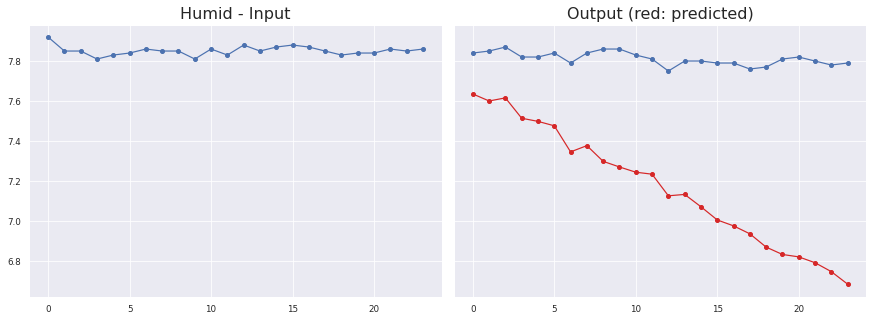

Sensor #7.0
Humid
MAE: 0.6418819003552195 ± 0.27242295200587635
MSE: 0.4862266387832241
RMSE: 0.6972995330438879
Max Error: 1.1069438648223882

KL Divergence: 2.007316641129835 bits
Pinball Loss Temp mean: 0.8269589449074841
Pinball Loss Humid mean: 0.59533110424625
MSE Temp: 1.6539178898149334
MSE Humid: 1.1906622084925014


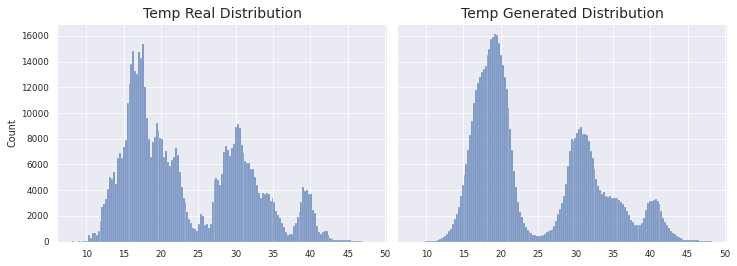

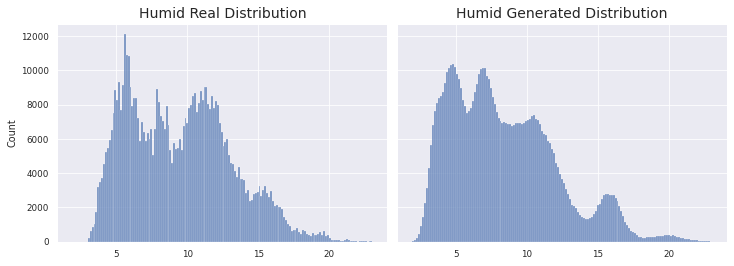

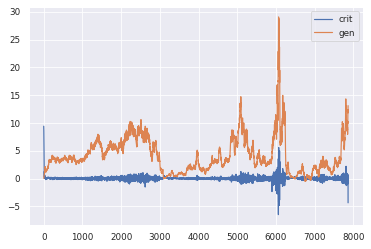

1966/1966 [==============================] - 136s 69ms/step - d_loss: 0.0331 - g_loss: 3.8264
Epoch 5/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0370 - g_loss: 4.4519

KL Divergence: 2.542845535527201 bits
Pinball Loss Temp mean: 1.149711089377447
Pinball Loss Humid mean: 0.3648195596794324
MSE Temp: 2.299422178754901
MSE Humid: 0.7296391193588705


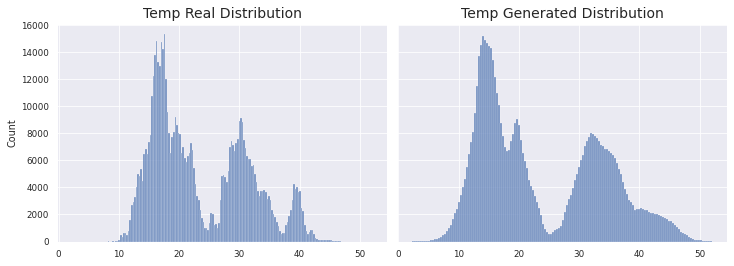

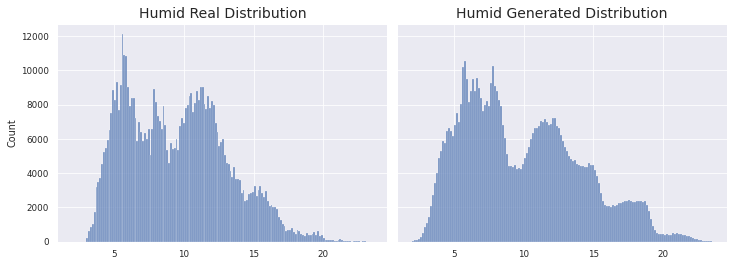

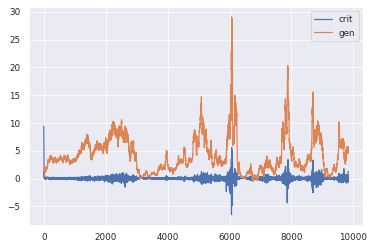

1966/1966 [==============================] - 133s 68ms/step - d_loss: 0.0383 - g_loss: 4.4521
Epoch 6/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0137 - g_loss: 6.8054
Better Pinball
Better MSE
>6 MODELS HAVE BEEN SAVED


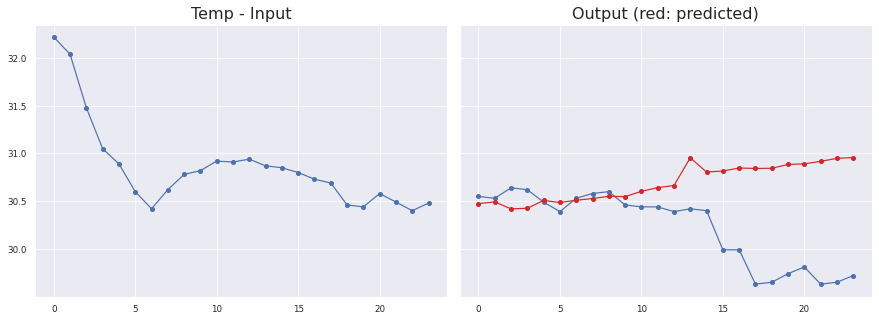

Sensor #25.0
Temp
MAE: 0.52375423848629 ± 0.5434624554207255
MSE: 0.515673509190956
RMSE: 0.7181041074878739
Max Error: 1.2985524201393126


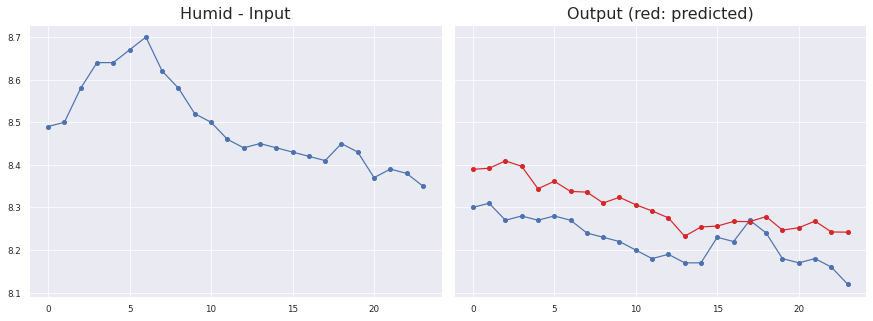

Sensor #25.0
Humid
MAE: 0.08076790961747375 ± 0.030713854832493736
MSE: 0.007425003318308289
RMSE: 0.0861684589528459
Max Error: 0.1393197643756885


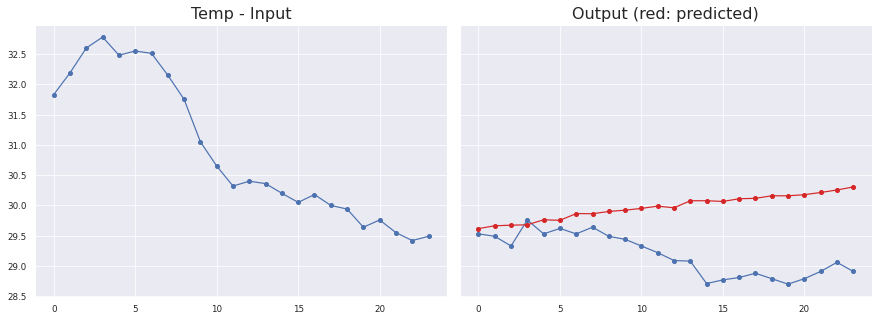

Sensor #15.0
Temp
MAE: 0.7943496167411407 ± 0.5163778437092773
MSE: 0.887102125700603
RMSE: 0.9418609906459673
Max Error: 1.4587263429164885


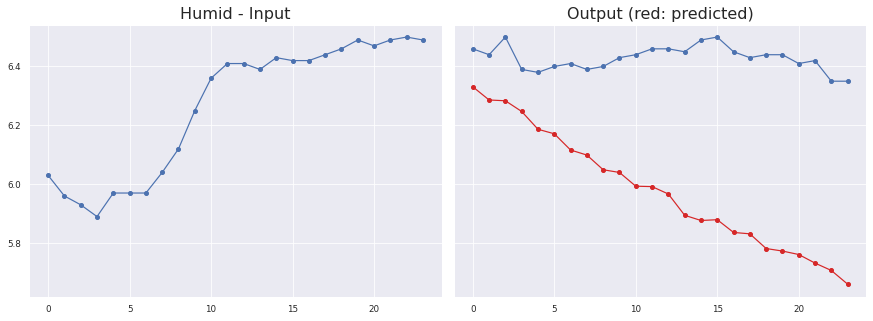

Sensor #15.0
Humid
MAE: 0.44984502354015854 ± 0.19550208290829468
MSE: 0.24058160962532757
RMSE: 0.4904911921995415
Max Error: 0.6896253439784044


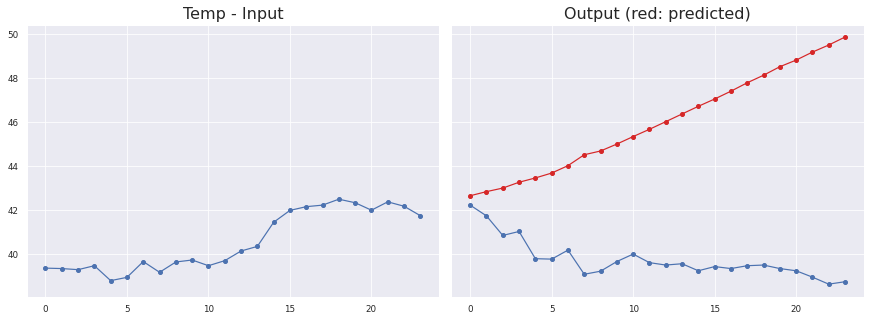

Sensor #33.0
Temp
MAE: 6.238579955200353 ± 2.9766330029588675
MSE: 47.78022389173156
RMSE: 6.912324058645656
Max Error: 11.147998914718627


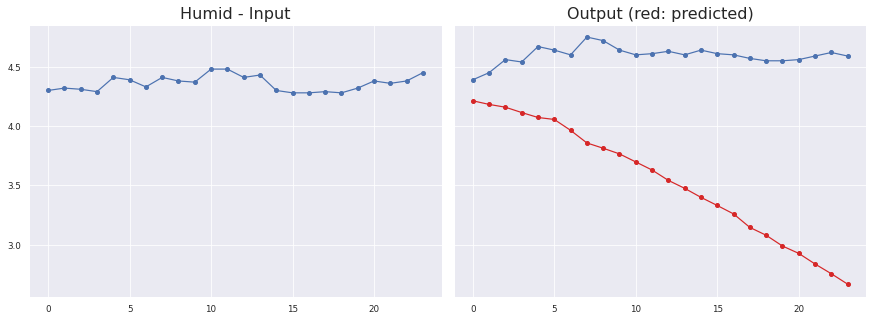

Sensor #33.0
Humid
MAE: 1.0559172955403724 ± 0.49548924343982204
MSE: 1.3604709253858613
RMSE: 1.1663922690869746
Max Error: 1.9218499785661698


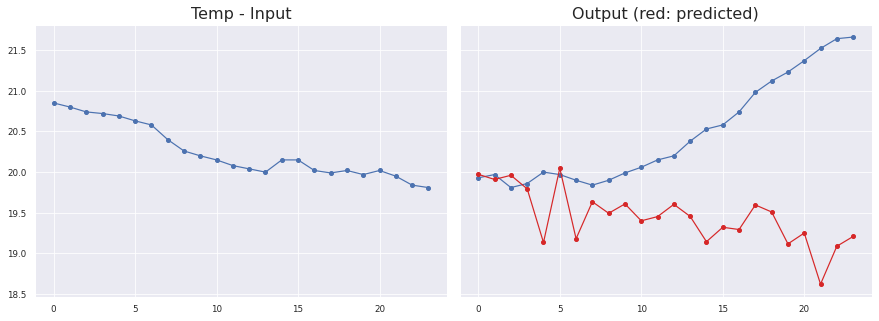

Sensor #16.0
Temp
MAE: 1.0441194654504458 ± 0.88257729053201
MSE: 1.822320615731316
RMSE: 1.3499335597470403
Max Error: 2.8968731212615957


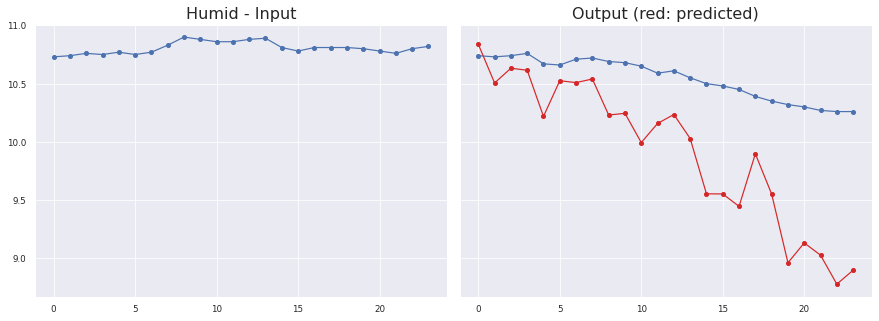

Sensor #16.0
Humid
MAE: 0.6334135543710239 ± 0.45093741124100045
MSE: 0.594312618243552
RMSE: 0.770916738852875
Max Error: 1.481782039254906

KL Divergence: 2.8910209196434167 bits
Pinball Loss Temp mean: 0.9707336894954313
Pinball Loss Humid mean: 0.25789433223079666
MSE Temp: 1.9414673789908894
MSE Humid: 0.5157886644615854


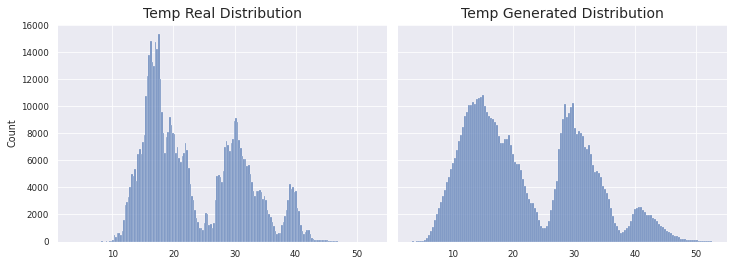

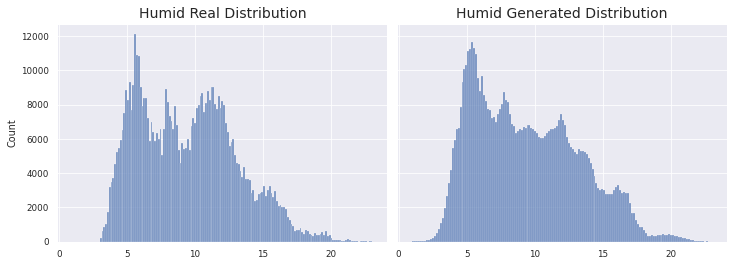

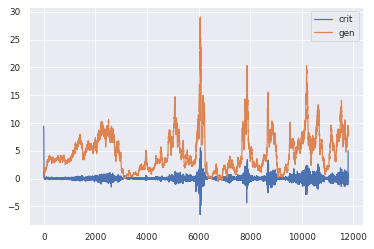

1966/1966 [==============================] - 135s 69ms/step - d_loss: 0.0188 - g_loss: 6.8077
Epoch 7/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0304 - g_loss: 3.6973
Better Pinball
Better MSE
>7 MODELS HAVE BEEN SAVED


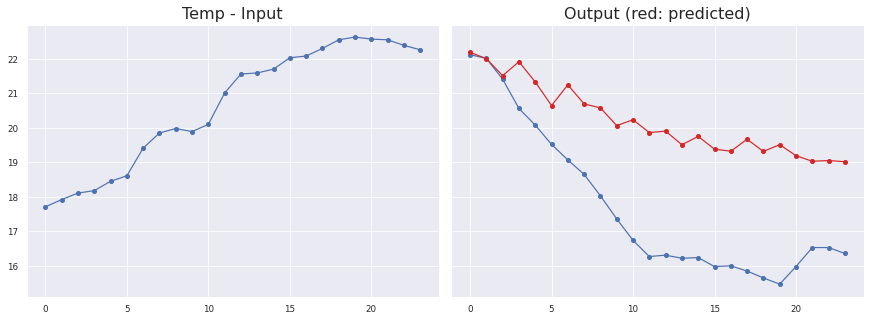

Sensor #27.0
Temp
MAE: 2.4998858989775186 ± 1.2179669913192224
MSE: 7.730459057239375
RMSE: 2.7803703093723637
Max Error: 4.04285351753235


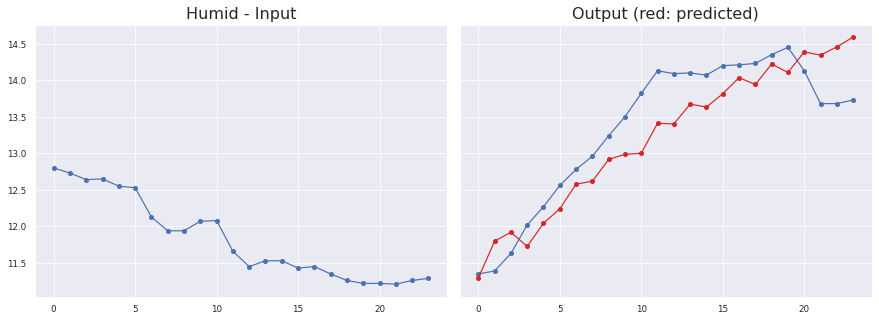

Sensor #27.0
Humid
MAE: 0.4144200408738101 ± 0.44770327184843267
MSE: 0.2208991816071518
RMSE: 0.469999129368504
Max Error: 0.8606183771044016


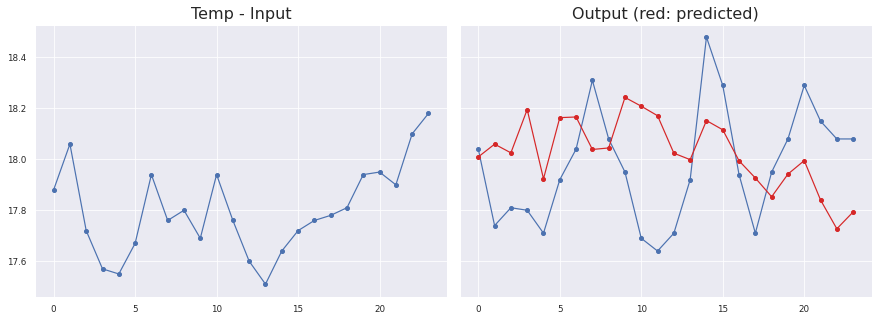

Sensor #34.0
Temp
MAE: 0.2432531875371926 ± 0.27298191406650935
MSE: 0.07703008388233862
RMSE: 0.27754294060980655
Max Error: 0.5311509728431716


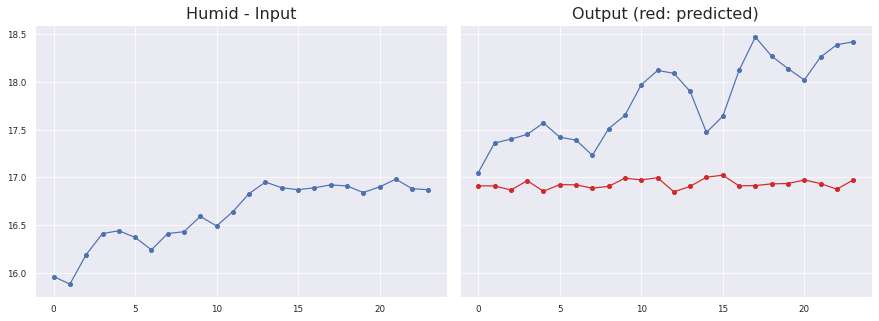

Sensor #34.0
Humid
MAE: 0.8746419979011009 ± 0.41099814527908063
MSE: 0.9339180999152736
RMSE: 0.9663943811484386
Max Error: 1.5570103575289238


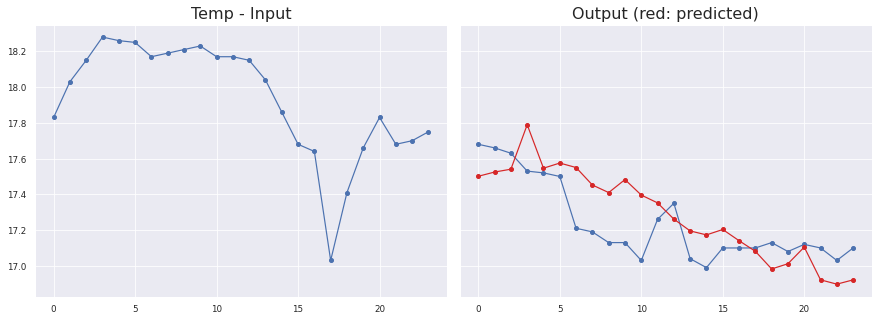

Sensor #6.0
Temp
MAE: 0.1569710197051363 ± 0.17987651933085982
MSE: 0.03531378041630736
RMSE: 0.18791961157981185
Max Error: 0.3660073971748332


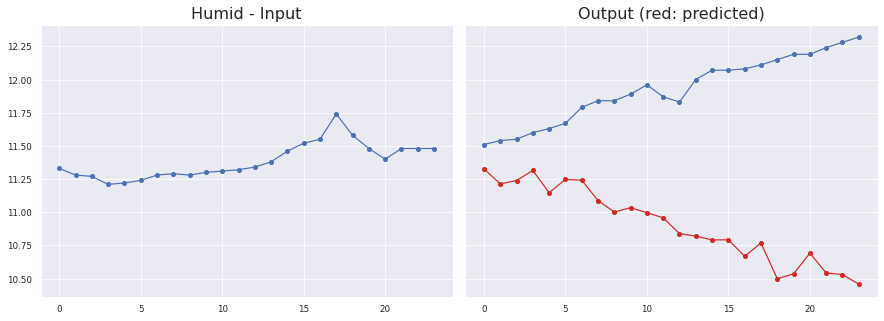

Sensor #6.0
Humid
MAE: 1.020022626811017 ± 0.5158261875908736
MSE: 1.3065228150109827
RMSE: 1.1430322895749632
Max Error: 1.8621899059414861


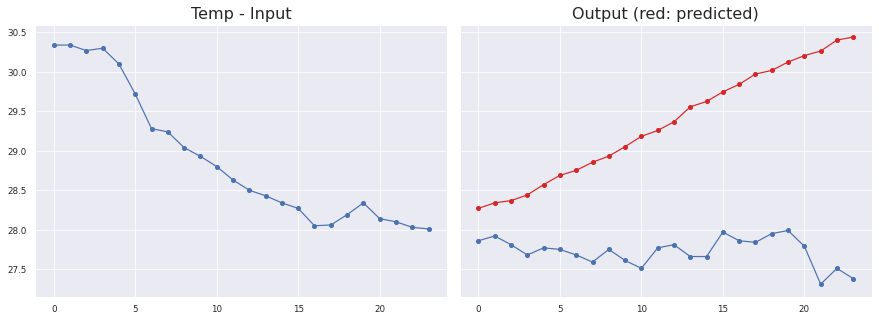

Sensor #23.0
Temp
MAE: 1.6188717824220653 ± 0.7574107456842879
MSE: 3.194416885600424
RMSE: 1.7872931728176058
Max Error: 3.061327061653138


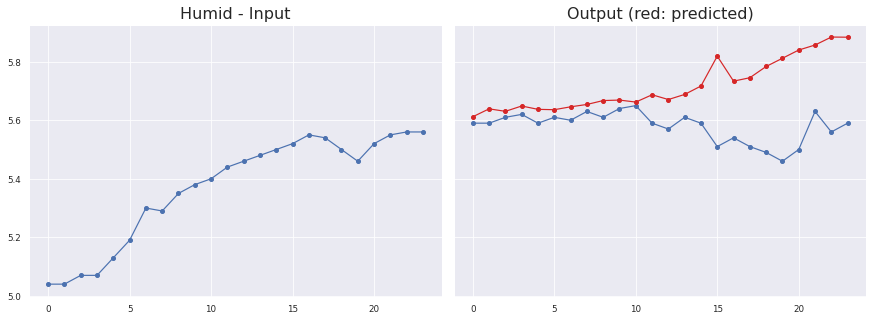

Sensor #23.0
Humid
MAE: 0.13884869226564966 ± 0.12072704277192019
MSE: 0.03385397820033413
RMSE: 0.18399450589714392
Max Error: 0.35175996512174734

KL Divergence: 2.2062001484311398 bits
Pinball Loss Temp mean: 0.7091250675259302
Pinball Loss Humid mean: 0.25003738538149994
MSE Temp: 1.4182501350518777
MSE Humid: 0.5000747707629991


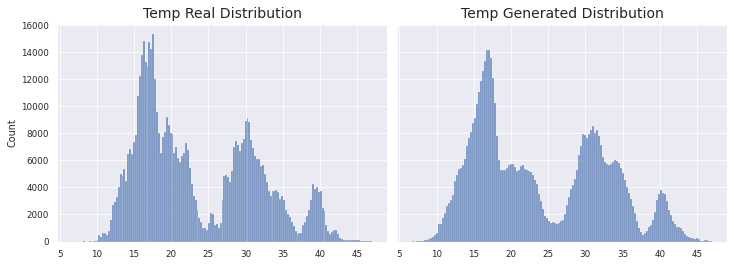

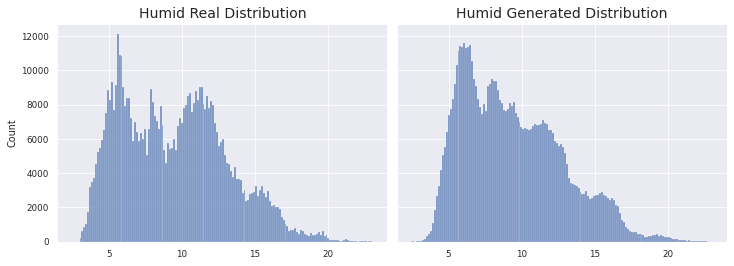

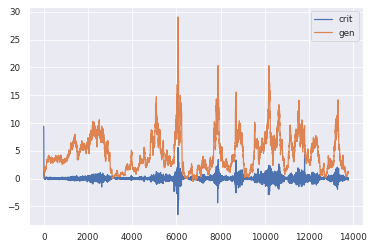

1966/1966 [==============================] - 137s 70ms/step - d_loss: 0.0300 - g_loss: 3.6949
Epoch 8/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0151 - g_loss: 4.7025

KL Divergence: 3.708351264309776 bits
Pinball Loss Temp mean: 1.3194549181660125
Pinball Loss Humid mean: 0.3619073145236584
MSE Temp: 2.6389098363320302
MSE Humid: 0.7238146290473091


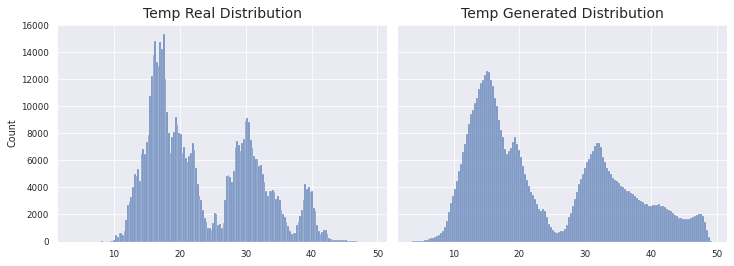

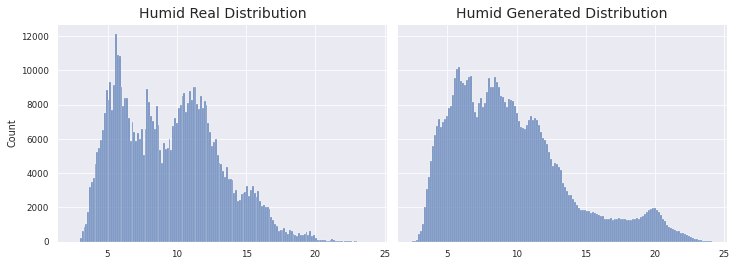

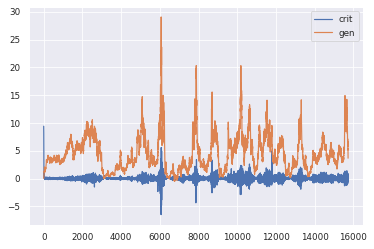

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0142 - g_loss: 4.7015
Epoch 9/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0241 - g_loss: 3.7699

KL Divergence: 11.487454846674902 bits
Pinball Loss Temp mean: 0.7512279062194714
Pinball Loss Humid mean: 0.2714737268595366
MSE Temp: 1.5024558124389555
MSE Humid: 0.5429474537190725


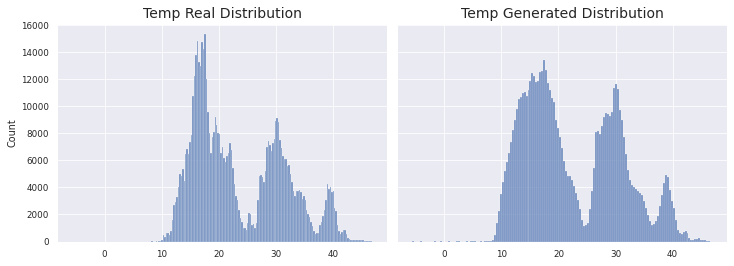

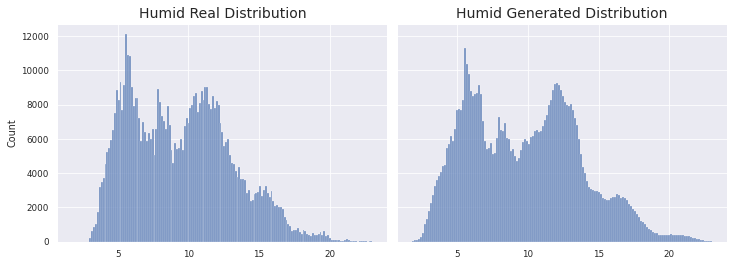

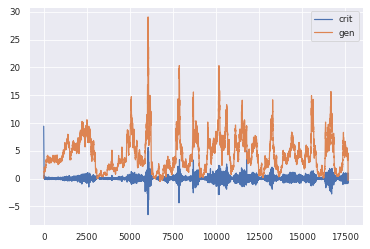

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0243 - g_loss: 3.7657
Epoch 10/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0258 - g_loss: 1.9346

KL Divergence: 9.43544478701759 bits
Pinball Loss Temp mean: 0.7425024611547303
Pinball Loss Humid mean: 0.25628639765299605
MSE Temp: 1.485004922309479
MSE Humid: 0.5125727953059928


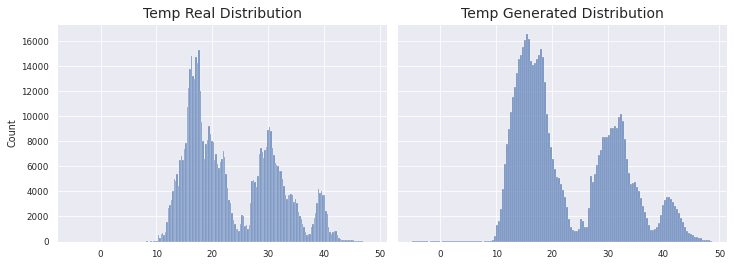

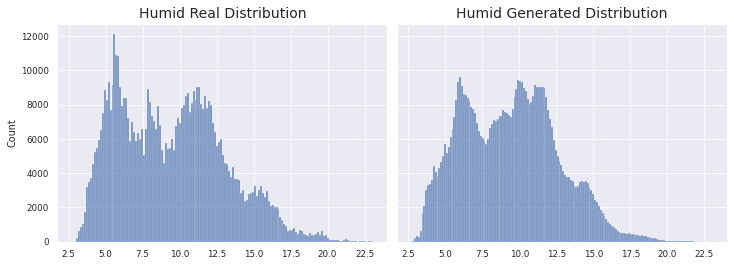

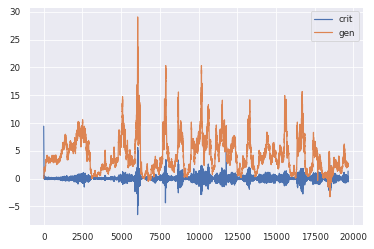

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0271 - g_loss: 1.9349
Epoch 11/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0229 - g_loss: 2.1626

KL Divergence: 8.429469090312427 bits
Pinball Loss Temp mean: 0.7687630262716059
Pinball Loss Humid mean: 0.253362729975272
MSE Temp: 1.5375260525431922
MSE Humid: 0.506725459950539


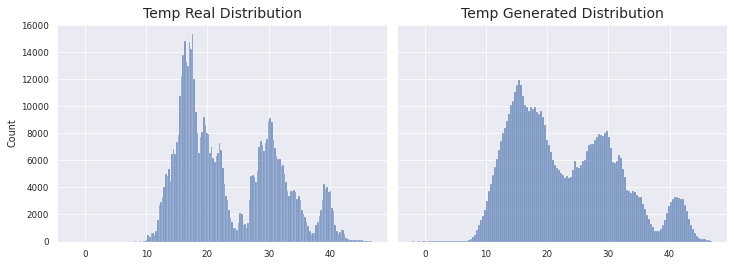

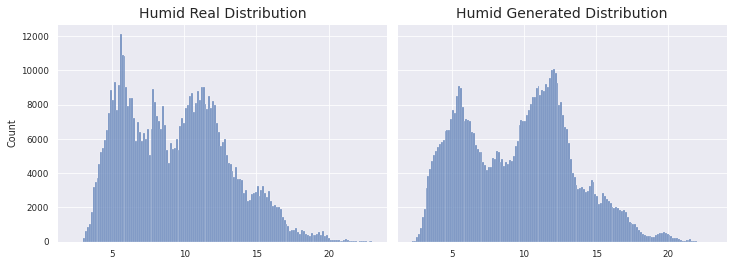

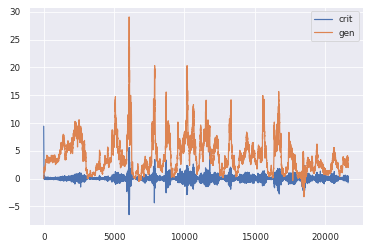

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0221 - g_loss: 2.1626
Epoch 12/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0194 - g_loss: 3.7141

KL Divergence: 9.282736959372343 bits
Pinball Loss Temp mean: 1.0943474652705731
Pinball Loss Humid mean: 0.4878783159451731
MSE Temp: 2.1886949305411285
MSE Humid: 0.9757566318903337


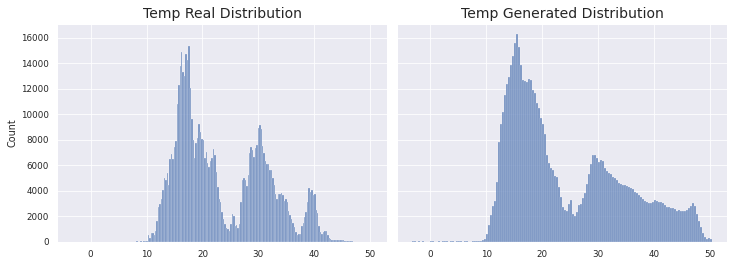

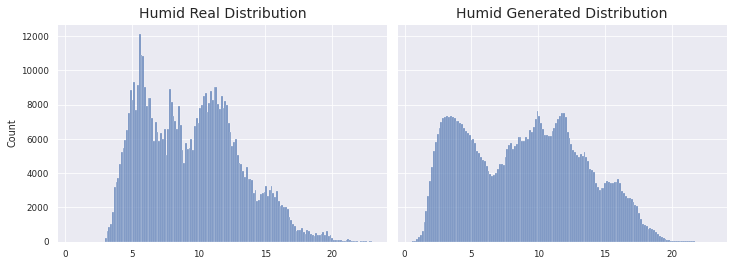

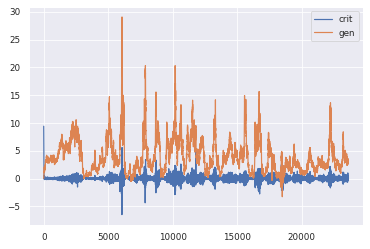

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0193 - g_loss: 3.7140
Epoch 13/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0082 - g_loss: 6.2073

KL Divergence: 9.723774149815362 bits
Pinball Loss Temp mean: 0.8599514698658819
Pinball Loss Humid mean: 0.35545942361944693
MSE Temp: 1.719902939731748
MSE Humid: 0.7109188472388865


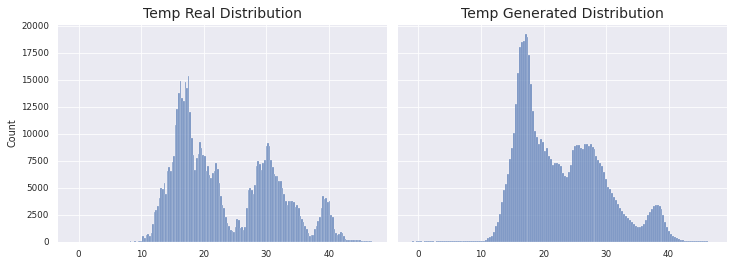

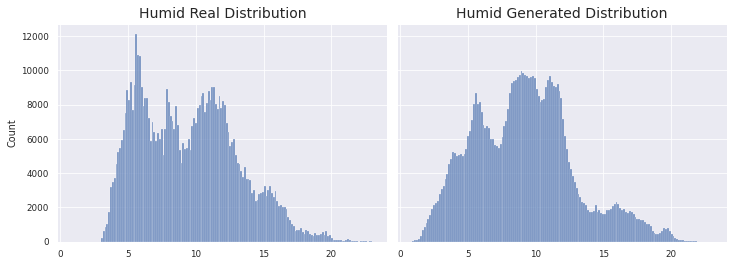

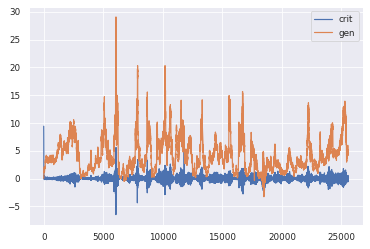

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0081 - g_loss: 6.2057
Epoch 14/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0025 - g_loss: 8.7421
Better Pinball
Better MSE
>14 MODELS HAVE BEEN SAVED


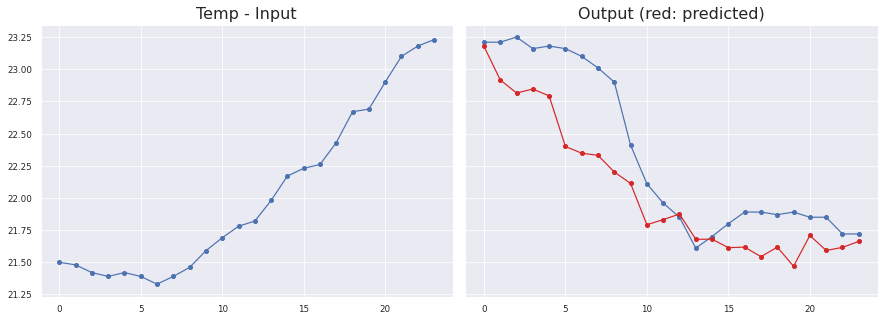

Sensor #2.0
Temp
MAE: 0.3020521124949059 ± 0.2346454213014557
MSE: 0.14166734981434007
RMSE: 0.37638723386206935
Max Error: 0.7599850428104382


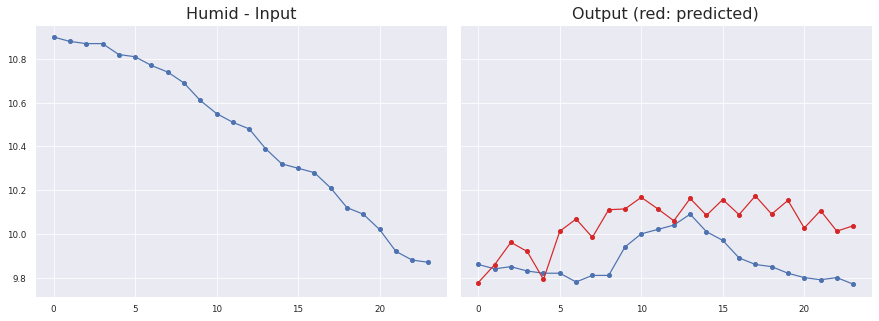

Sensor #2.0
Humid
MAE: 0.17420520012577376 ± 0.11233717472086031
MSE: 0.03982275273216046
RMSE: 0.1995563898555004
Max Error: 0.3331119549274444


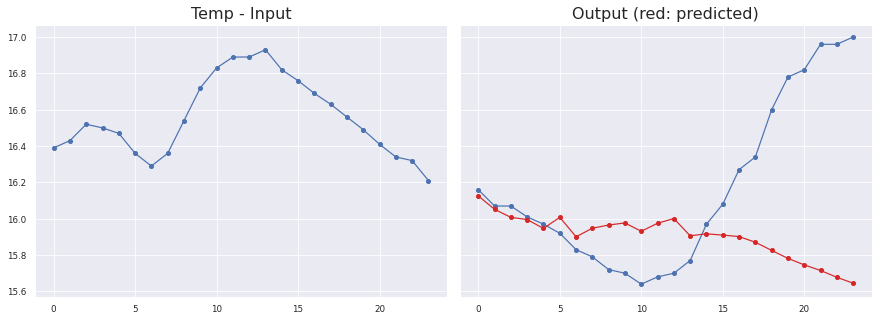

Sensor #8.0
Temp
MAE: 0.4084922321637476 ± 0.5434277681993868
MSE: 0.3594807823942349
RMSE: 0.5995671625383056
Max Error: 1.354889152050017


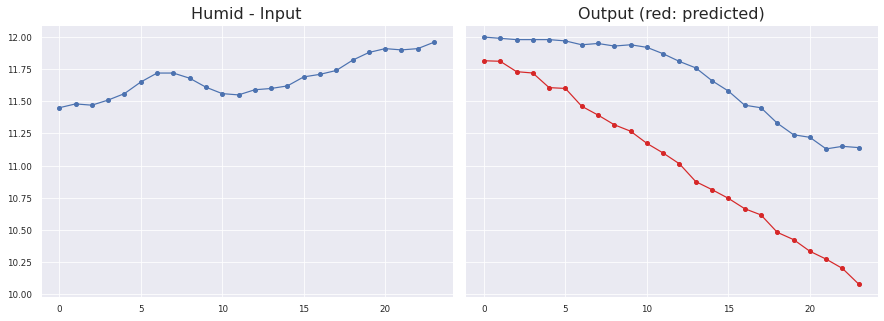

Sensor #8.0
Humid
MAE: 0.6614683593126631 ± 0.2583154020124985
MSE: 0.5042672372886651
RMSE: 0.7101177629722165
Max Error: 1.0620231571793557


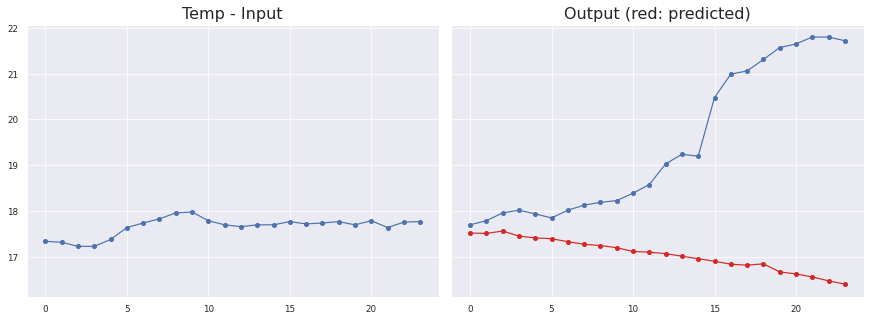

Sensor #1.0
Temp
MAE: 2.387838511765004 ± 1.894273839375375
MSE: 9.290046136810034
RMSE: 3.047957699314417
Max Error: 5.323402235507967


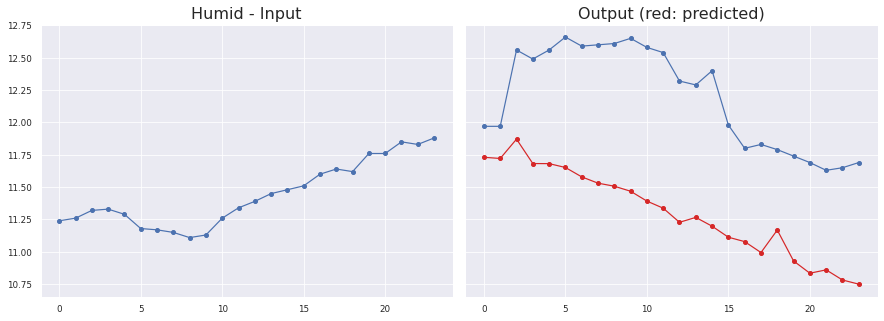

Sensor #1.0
Humid
MAE: 0.8846641439168401 ± 0.25365358528289084
MSE: 0.8469707888589803
RMSE: 0.9203101590545333
Max Error: 1.2026713279634702


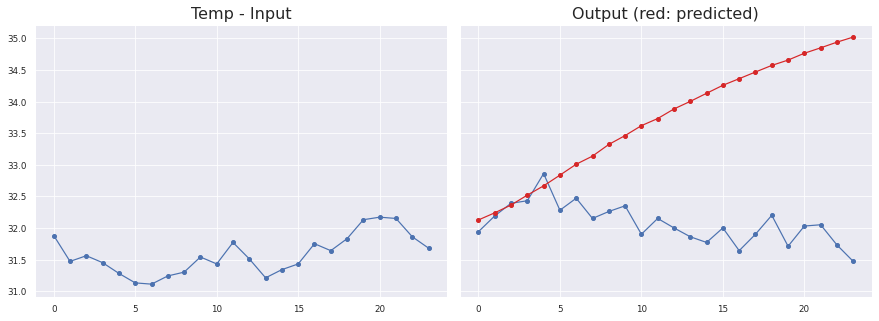

Sensor #21.0
Temp
MAE: 1.652213550657032 ± 1.1326851341914455
MSE: 3.952090782351734
RMSE: 1.987986615234553
Max Error: 3.551295651197435


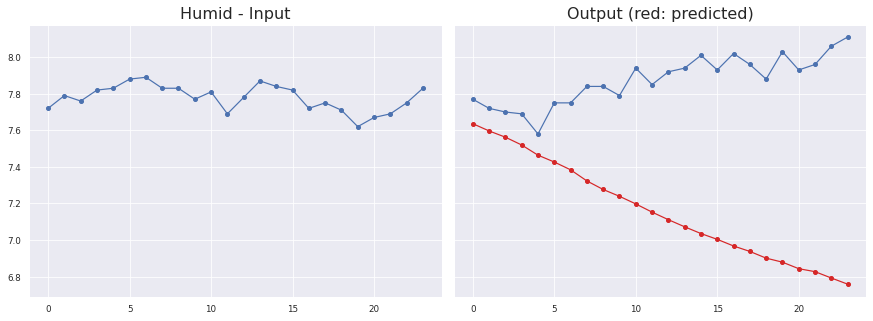

Sensor #21.0
Humid
MAE: 0.7111818195258574 ± 0.3915161466079014
MSE: 0.6590644734788088
RMSE: 0.8118278595113676
Max Error: 1.3516016143560403

KL Divergence: 3.329345599447204 bits
Pinball Loss Temp mean: 0.6436374209467177
Pinball Loss Humid mean: 0.2992528962423776
MSE Temp: 1.2872748418934354
MSE Humid: 0.5985057924847461


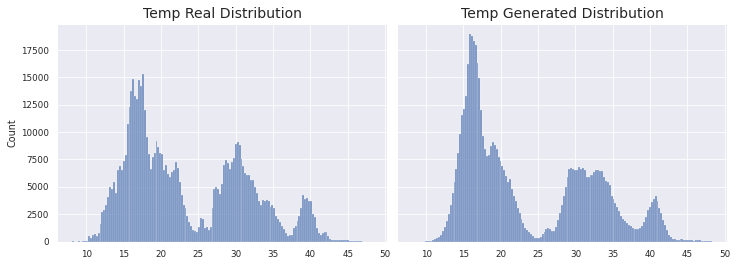

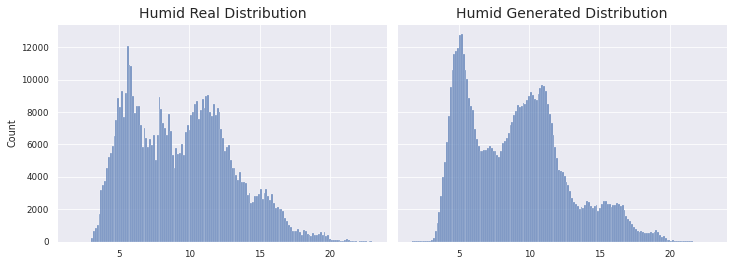

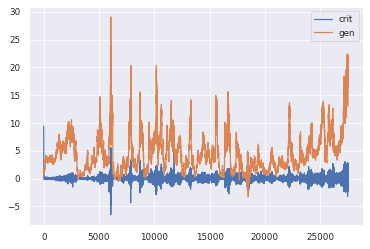

1966/1966 [==============================] - 136s 69ms/step - d_loss: 0.0012 - g_loss: 8.7465
Epoch 15/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0237 - g_loss: 11.9012

KL Divergence: 3.9795568404342276 bits
Pinball Loss Temp mean: 0.958393017585168
Pinball Loss Humid mean: 0.2618621831856879
MSE Temp: 1.9167860351703803
MSE Humid: 0.5237243663713772


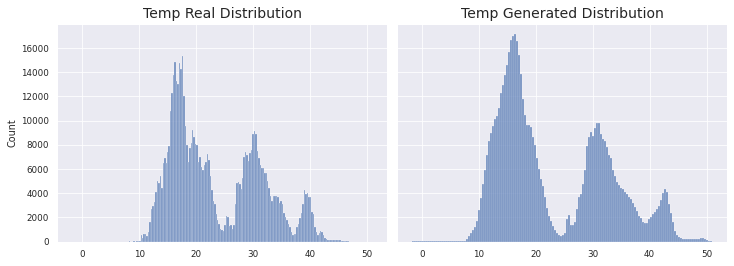

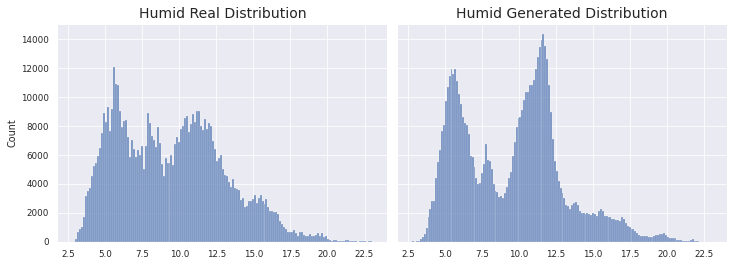

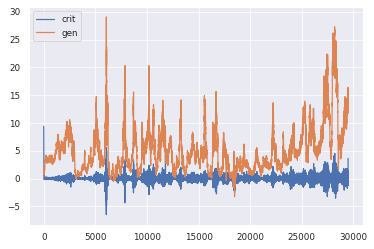

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0273 - g_loss: 11.9057
Epoch 16/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0106 - g_loss: 16.6581

KL Divergence: 2.122864856824339 bits
Pinball Loss Temp mean: 1.0927666519604222
Pinball Loss Humid mean: 0.35148769227871596
MSE Temp: 2.185533303920854
MSE Humid: 0.7029753845574196


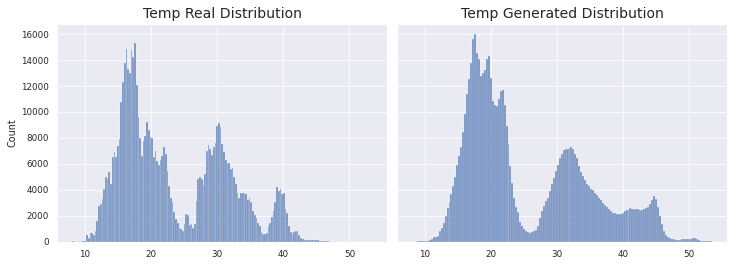

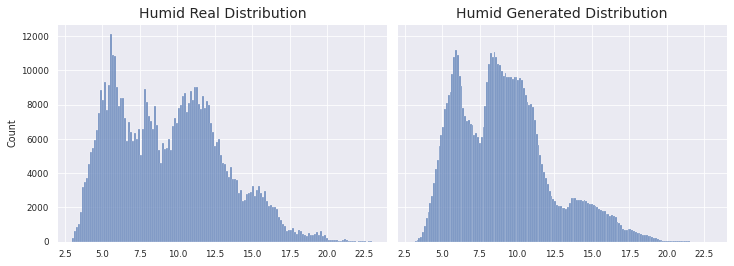

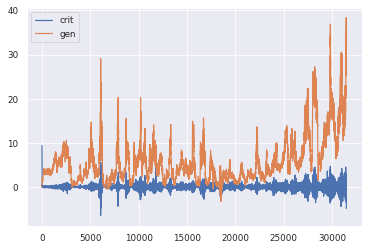

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0155 - g_loss: 16.6801
Epoch 17/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0419 - g_loss: 16.0855
Better Pinball
Better MSE
>17 MODELS HAVE BEEN SAVED


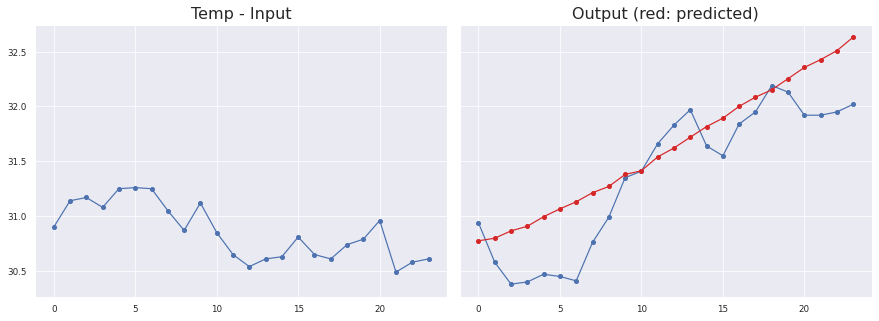

Sensor #15.0
Temp
MAE: 0.31977243045965764 ± 0.28405335488022604
MSE: 0.1454705709729417
RMSE: 0.38140604475144557
Max Error: 0.7205824840068793


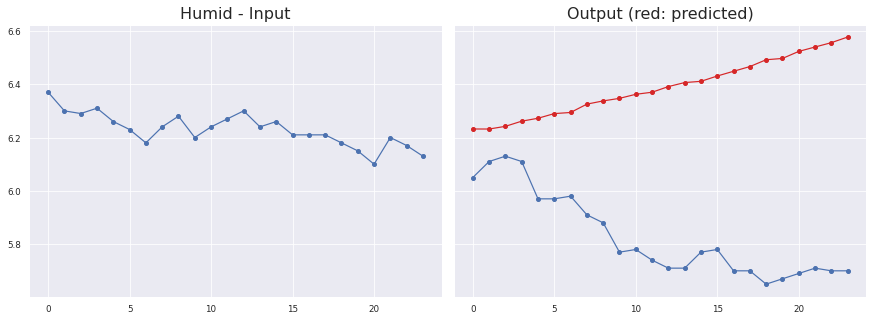

Sensor #15.0
Humid
MAE: 0.5588370944062871 ± 0.2529841678450281
MSE: 0.3762998872647028
RMSE: 0.6134328710337447
Max Error: 0.8768777284026141


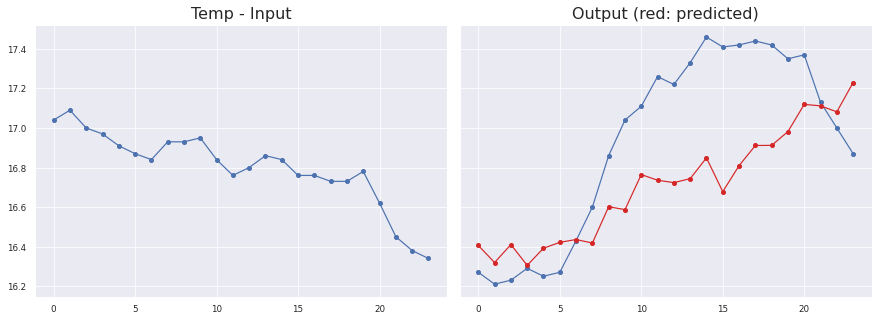

Sensor #24.0
Temp
MAE: 0.3189526353279746 ± 0.31515907163000334
MSE: 0.14795330438139306
RMSE: 0.3846469867052036
Max Error: 0.7320285034179719


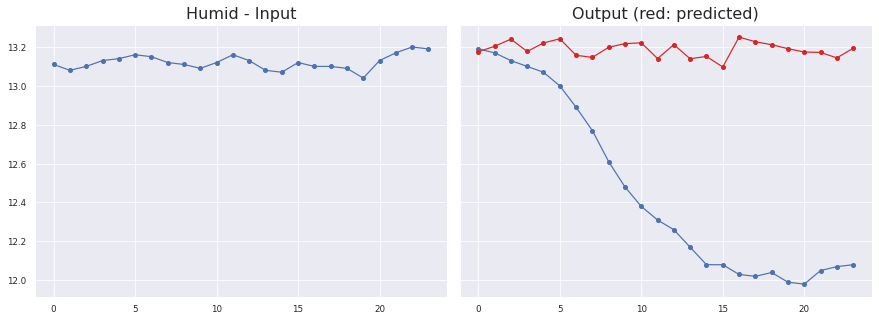

Sensor #24.0
Humid
MAE: 0.7326509901182728 ± 0.4392609384214146
MSE: 0.7279420352237417
RMSE: 0.8531951917490754
Max Error: 1.2210444952361303


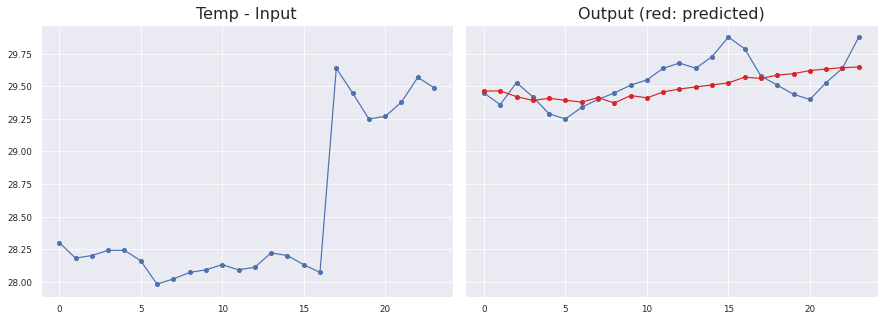

Sensor #12.0
Temp
MAE: 0.12487274418274626 ± 0.14560625647211023
MSE: 0.022896284543745943
RMSE: 0.1513151827932212
Max Error: 0.3522777938842765


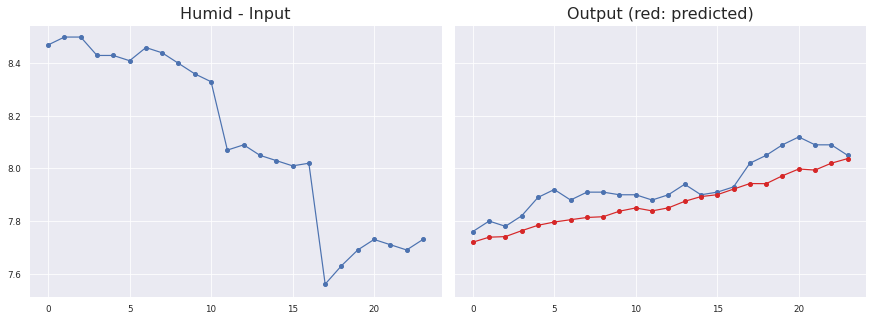

Sensor #12.0
Humid
MAE: 0.06619827112182959 ± 0.03580425957112576
MSE: 0.005664156102955808
RMSE: 0.07526058797907313
Max Error: 0.12368203461170069


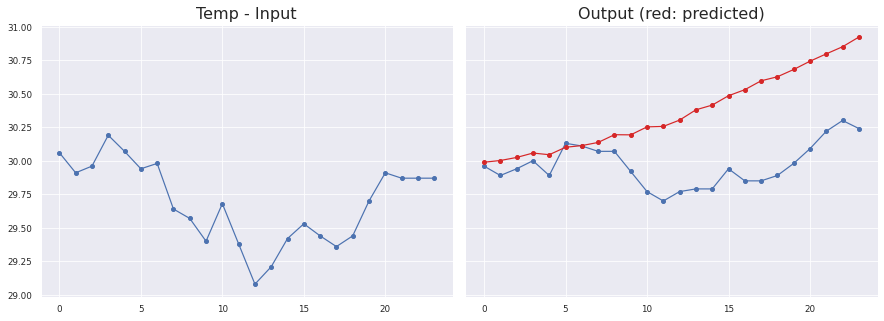

Sensor #20.0
Temp
MAE: 0.39943764428297596 ± 0.27364987135747765
MSE: 0.23247069955892555
RMSE: 0.4821521539503122
Max Error: 0.7459142321348189


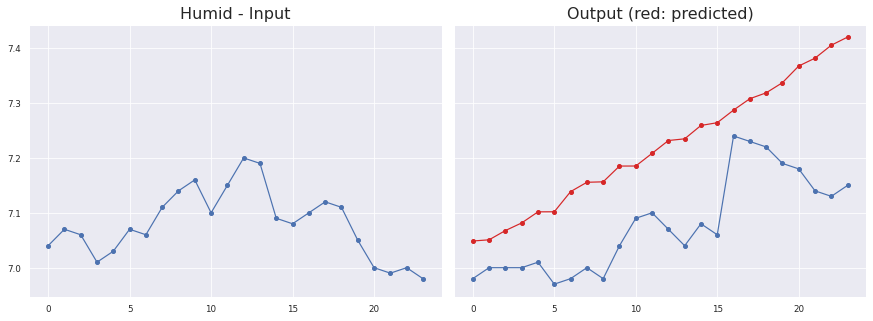

Sensor #20.0
Humid
MAE: 0.14238043518116092 ± 0.06461337871394604
MSE: 0.02444707703120858
RMSE: 0.15635561080821045
Max Error: 0.2754204216599465

KL Divergence: 2.5614419844819123 bits
Pinball Loss Temp mean: 0.6945743331441703
Pinball Loss Humid mean: 0.2008482866103333
MSE Temp: 1.3891486662883603
MSE Humid: 0.40169657322066676


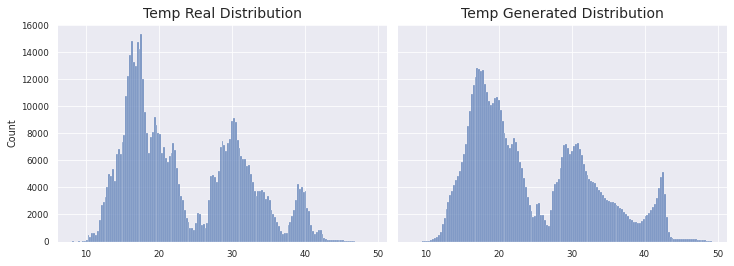

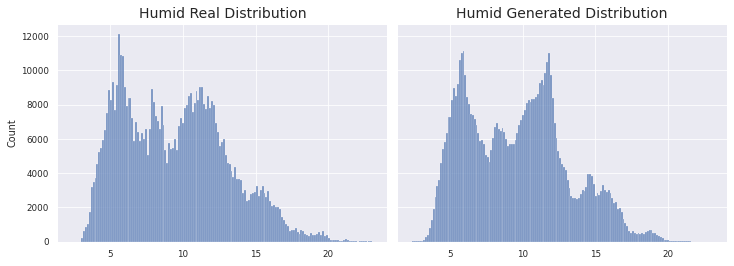

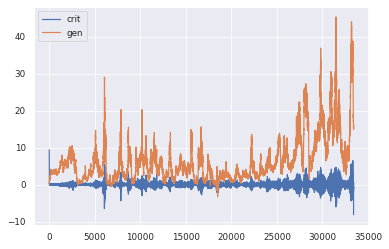

1966/1966 [==============================] - 135s 69ms/step - d_loss: 0.0337 - g_loss: 16.0844
Epoch 18/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0083 - g_loss: 17.5041

KL Divergence: 2.333176033274922 bits
Pinball Loss Temp mean: 1.1247321724422559
Pinball Loss Humid mean: 0.4450641415062734
MSE Temp: 2.2494643448845264
MSE Humid: 0.8901282830125504


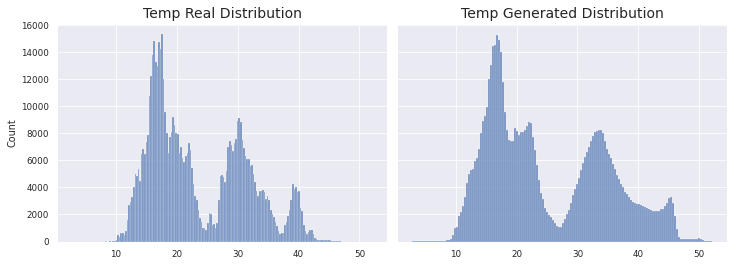

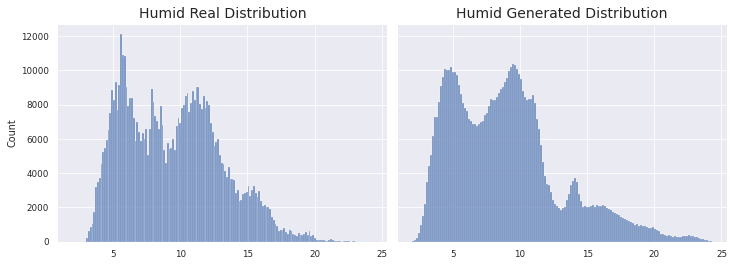

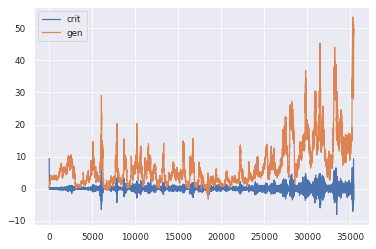

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0036 - g_loss: 17.5094
Epoch 19/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0120 - g_loss: 33.3706

KL Divergence: 2.3454956354490584 bits
Pinball Loss Temp mean: 0.8629256184111677
Pinball Loss Humid mean: 0.3552418139984411
MSE Temp: 1.7258512368223138
MSE Humid: 0.7104836279968807


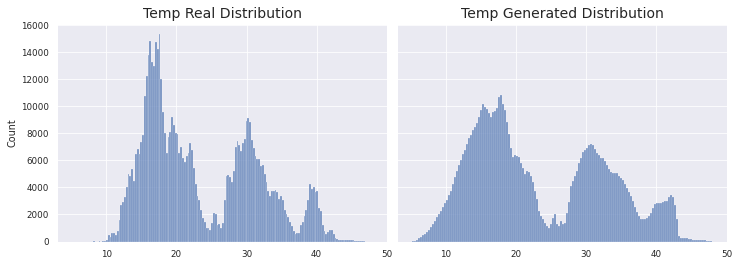

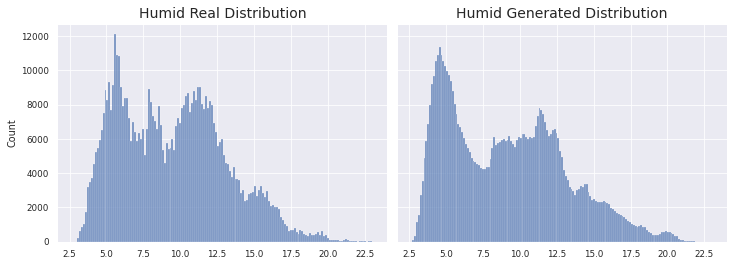

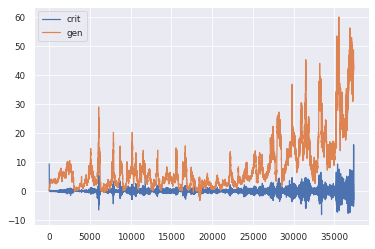

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0282 - g_loss: 33.3863
Epoch 20/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0092 - g_loss: 33.8394
Better KL
Better Pinball
Better MSE
>20 MODELS HAVE BEEN SAVED


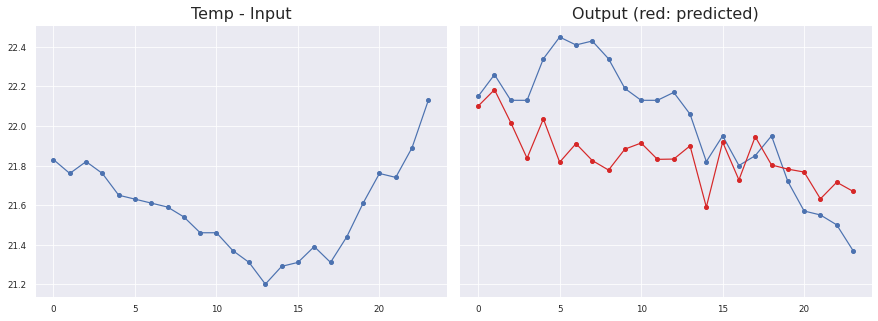

Sensor #2.0
Temp
MAE: 0.24529404789209375 ± 0.25128405934802583
MSE: 0.0906973610187956
RMSE: 0.30116002559900873
Max Error: 0.6330407953262309


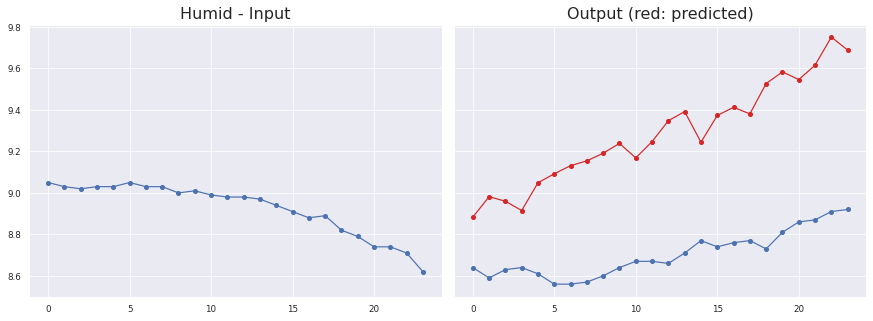

Sensor #2.0
Humid
MAE: 0.5827875968006753 ± 0.15859777550163587
MSE: 0.36479463737877377
RMSE: 0.603982315452012
Max Error: 0.8414318746328355


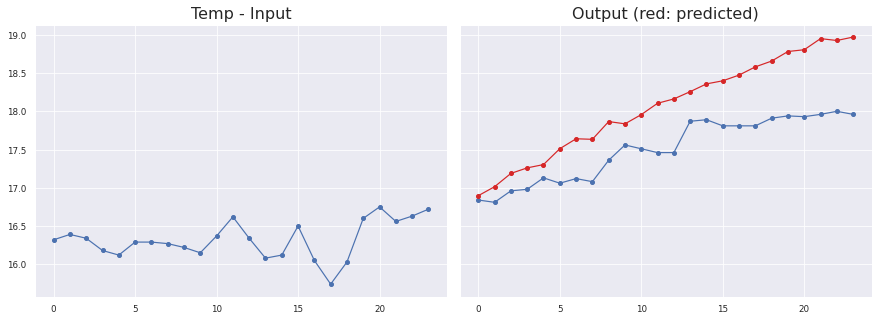

Sensor #10.0
Temp
MAE: 0.5547936855256546 ± 0.26499163110548113
MSE: 0.3780165980550823
RMSE: 0.6148305441787049
Max Error: 1.0109573352336874


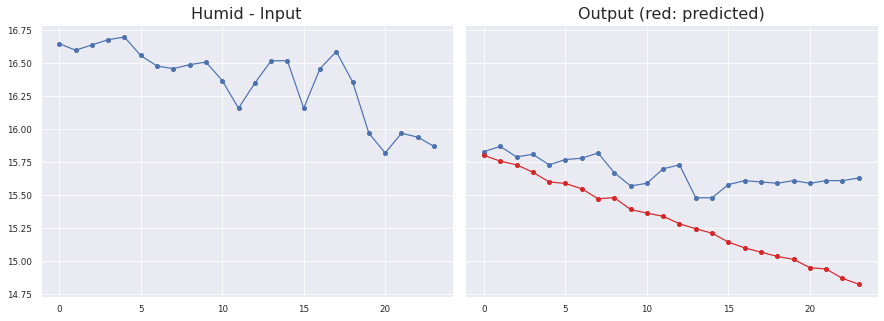

Sensor #10.0
Humid
MAE: 0.3593499744186787 ± 0.22340702829788084
MSE: 0.17904310440759516
RMSE: 0.42313485369039877
Max Error: 0.8057323887944214


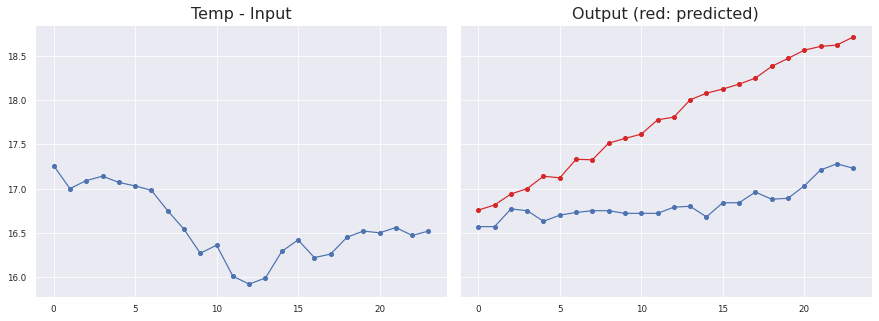

Sensor #34.0
Temp
MAE: 0.953660587966442 ± 0.4700382304195505
MSE: 1.1304044550964425
RMSE: 1.063204803928407
Max Error: 1.5808035135269165


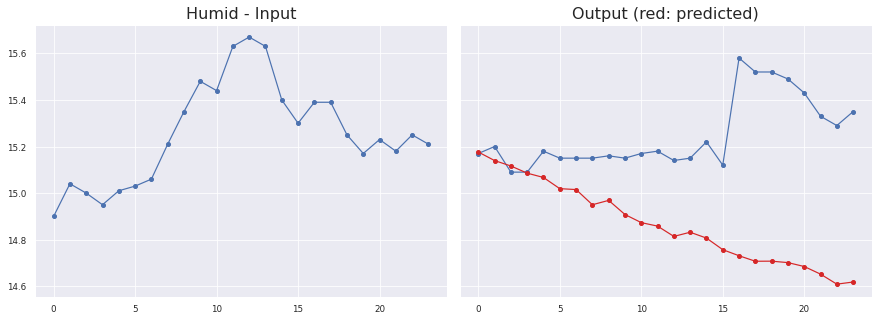

Sensor #34.0
Humid
MAE: 0.3852688128252821 ± 0.29253554599763837
MSE: 0.2319158056645302
RMSE: 0.4815763757334139
Max Error: 0.8490365794301002


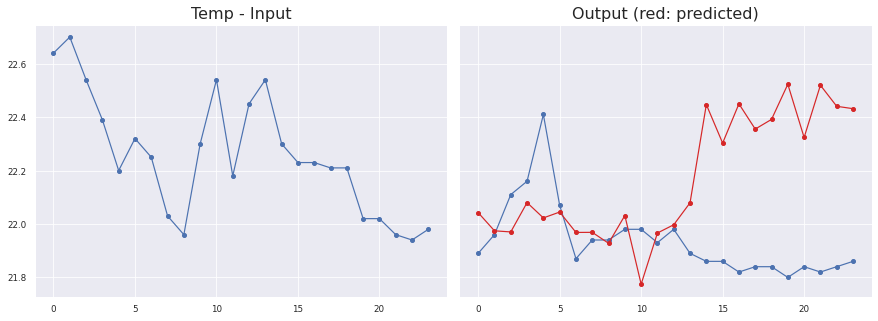

Sensor #4.0
Temp
MAE: 0.301838755061229 ± 0.3197812671631744
MSE: 0.15562527225867387
RMSE: 0.39449369102518467
Max Error: 0.7232479476928724


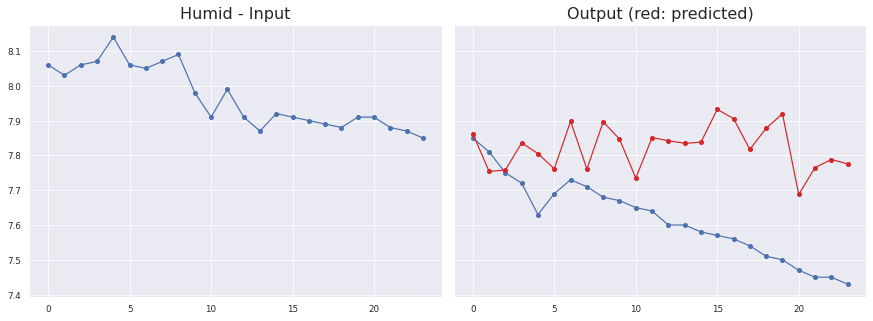

Sensor #4.0
Humid
MAE: 0.21129102693249802 ± 0.127218786316041
MSE: 0.058872848294065305
RMSE: 0.24263727721449832
Max Error: 0.4194799268245699

KL Divergence: 1.6665359136784217 bits
Pinball Loss Temp mean: 0.5328358247540207
Pinball Loss Humid mean: 0.2948719867082357
MSE Temp: 1.0656716495080334
MSE Humid: 0.5897439734164766


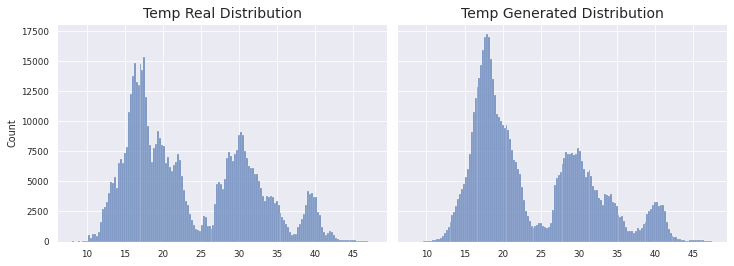

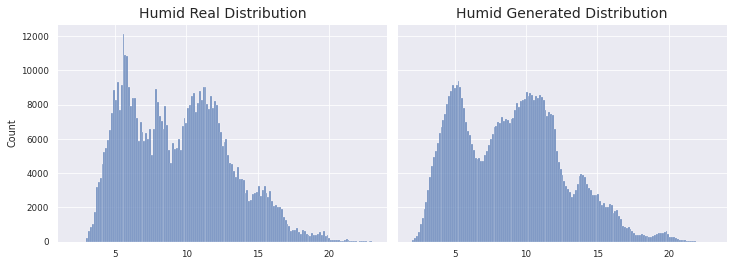

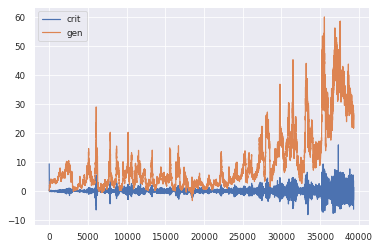

1966/1966 [==============================] - 135s 69ms/step - d_loss: 0.0029 - g_loss: 33.8271
Epoch 21/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0813 - g_loss: 46.5026

KL Divergence: 3.1725101525811286 bits
Pinball Loss Temp mean: 1.120905498002941
Pinball Loss Humid mean: 0.4496156699633162
MSE Temp: 2.2418109960058854
MSE Humid: 0.8992313399266149


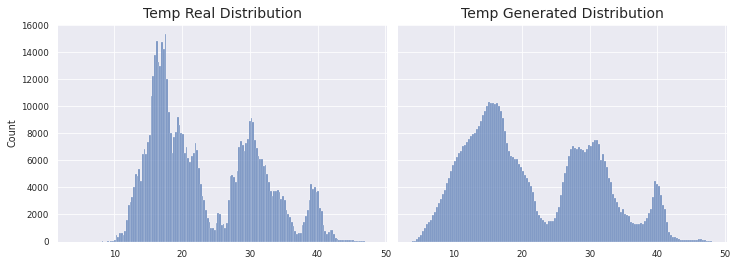

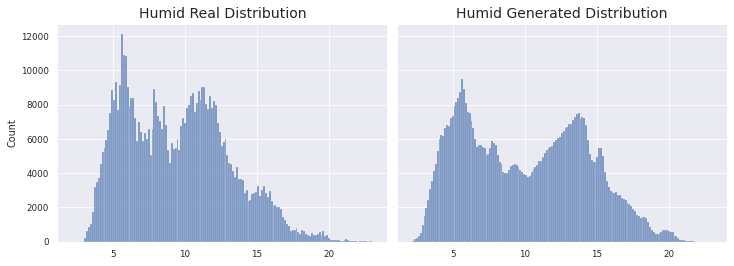

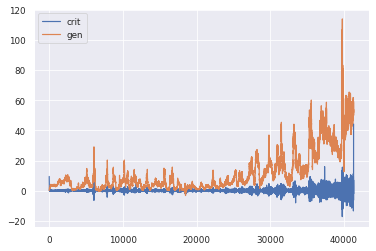

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.0362 - g_loss: 46.5062
Epoch 22/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0134 - g_loss: 53.6495

KL Divergence: 1.7214547467163956 bits
Pinball Loss Temp mean: 0.5909913018064293
Pinball Loss Humid mean: 0.2708151164629318
MSE Temp: 1.1819826036128689
MSE Humid: 0.541630232925855


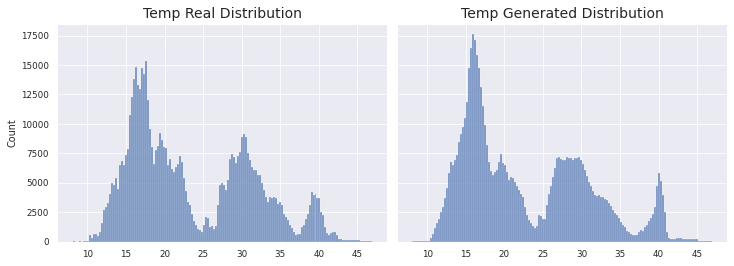

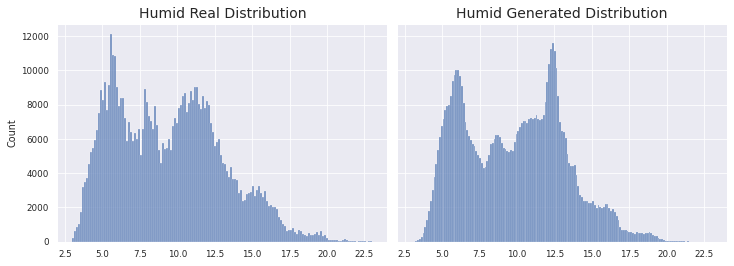

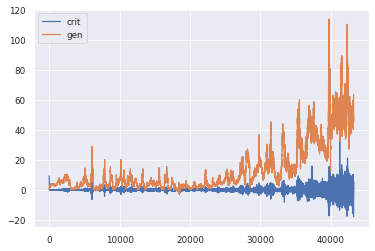

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0315 - g_loss: 53.6596
Epoch 23/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0704 - g_loss: 42.3896

KL Divergence: 8.601394631359135 bits
Pinball Loss Temp mean: 1.1960097484177576
Pinball Loss Humid mean: 0.29228971607863635
MSE Temp: 2.3920194968355193
MSE Humid: 0.5845794321572758


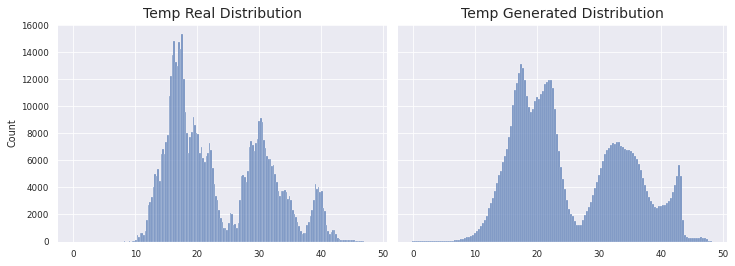

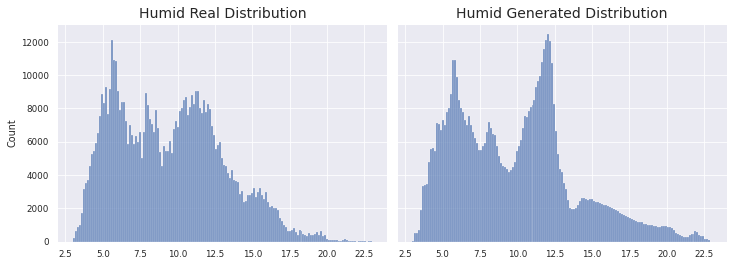

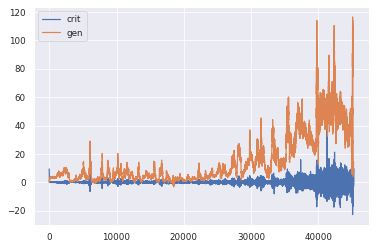

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0804 - g_loss: 42.3607
Epoch 24/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0440 - g_loss: 36.5124

KL Divergence: 3.01308510228336 bits
Pinball Loss Temp mean: 0.51736317753119
Pinball Loss Humid mean: 0.3510081457987981
MSE Temp: 1.034726355062387
MSE Humid: 0.7020162915976035


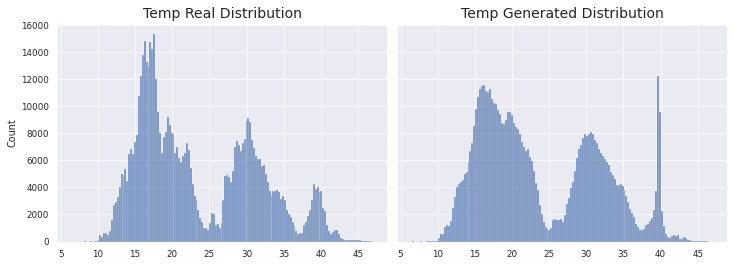

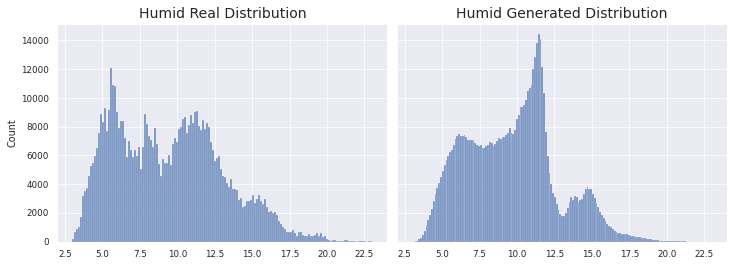

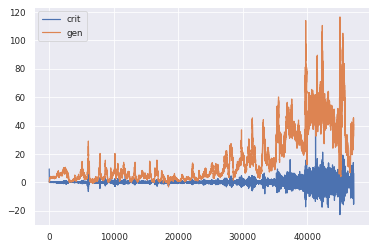

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0283 - g_loss: 36.5169
Epoch 25/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0614 - g_loss: 28.5061

KL Divergence: 3.362658974122648 bits
Pinball Loss Temp mean: 0.7489164484146402
Pinball Loss Humid mean: 0.3171262613446459
MSE Temp: 1.497832896829271
MSE Humid: 0.6342525226892921


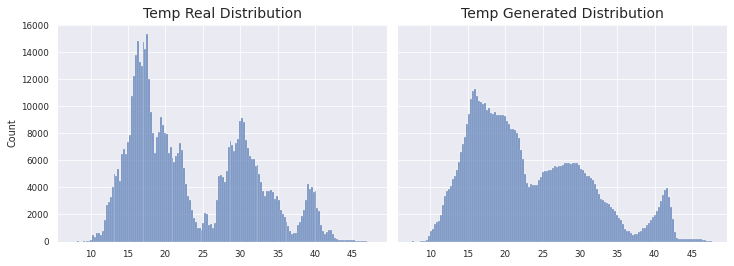

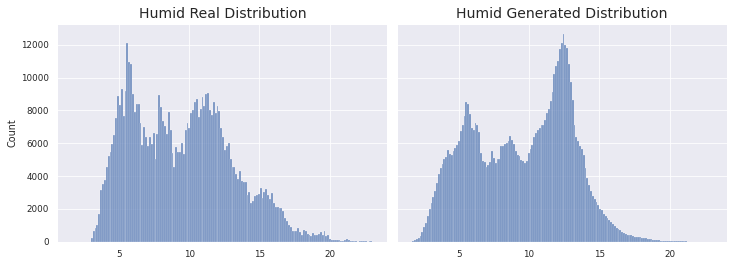

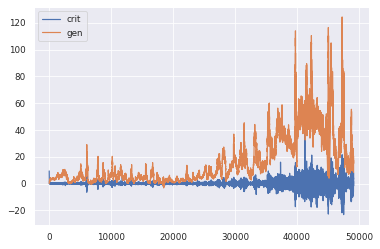

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0633 - g_loss: 28.4855
Epoch 26/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1116 - g_loss: 10.2994

KL Divergence: 2.2656635923767836 bits
Pinball Loss Temp mean: 1.0912998823487197
Pinball Loss Humid mean: 0.33325298444143747
MSE Temp: 2.1825997646974242
MSE Humid: 0.6665059688828834


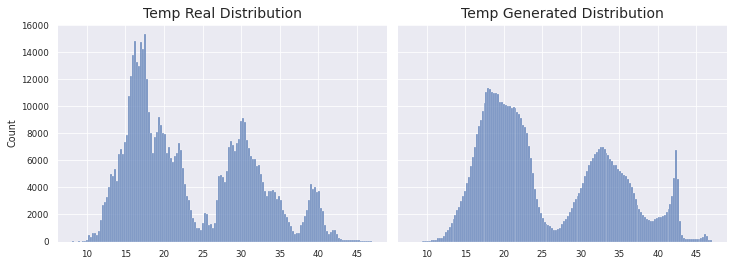

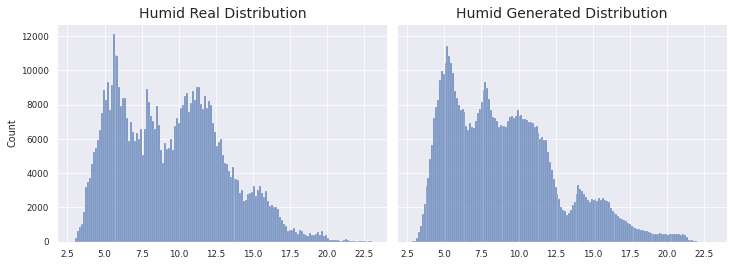

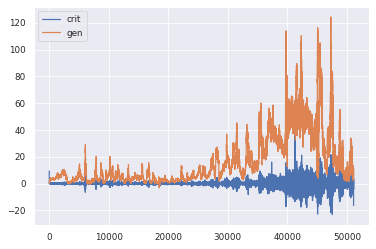

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0948 - g_loss: 10.2920
Epoch 27/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0215 - g_loss: 13.2553

KL Divergence: 5.331567300858785 bits
Pinball Loss Temp mean: 1.9678540184565612
Pinball Loss Humid mean: 0.37224684446718537
MSE Temp: 3.9357080369131063
MSE Humid: 0.7444936889343713


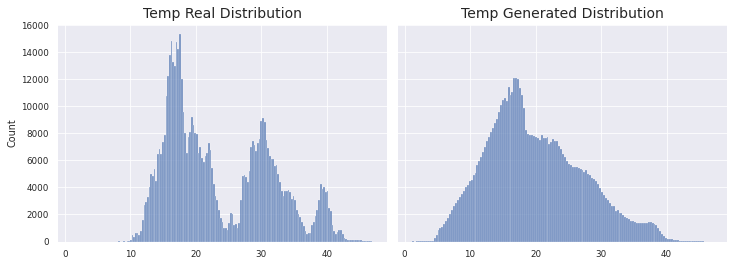

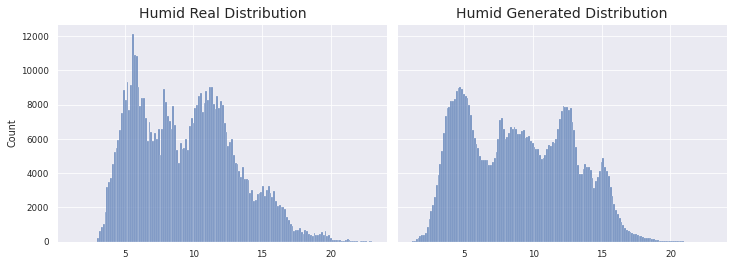

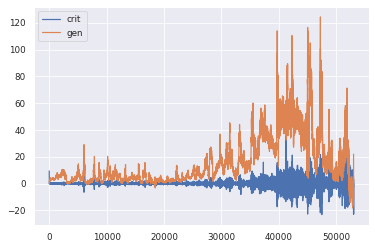

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0017 - g_loss: 13.2641
Epoch 28/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0469 - g_loss: -15.5305

KL Divergence: 2.692373394215931 bits
Pinball Loss Temp mean: 0.906653996608572
Pinball Loss Humid mean: 0.39819618718527827
MSE Temp: 1.813307993217163
MSE Humid: 0.7963923743705712


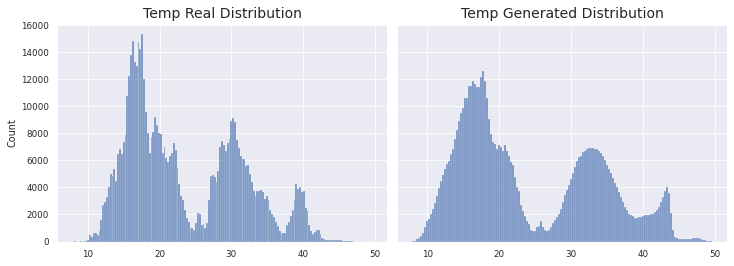

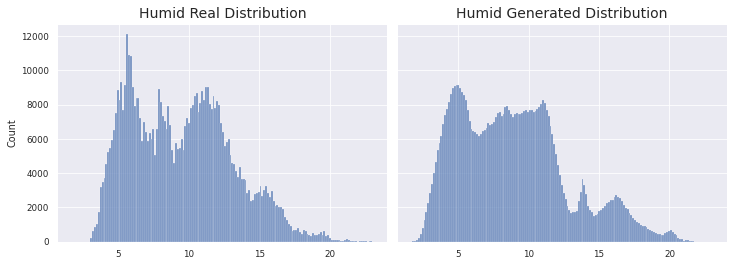

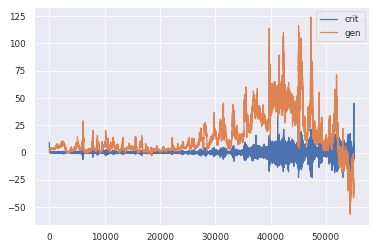

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0927 - g_loss: -15.5474
Epoch 29/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0274 - g_loss: -25.6967

KL Divergence: 3.035186055852624 bits
Pinball Loss Temp mean: 0.7333884599669721
Pinball Loss Humid mean: 0.22869903316235557
MSE Temp: 1.4667769199339582
MSE Humid: 0.4573980663247071


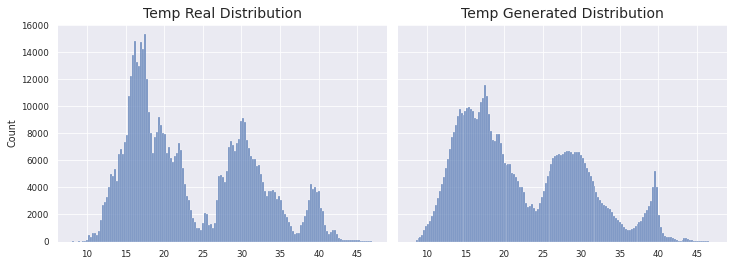

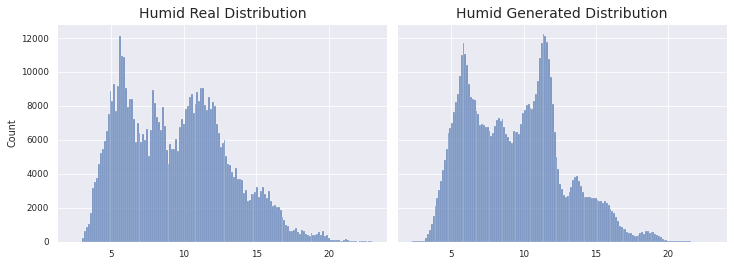

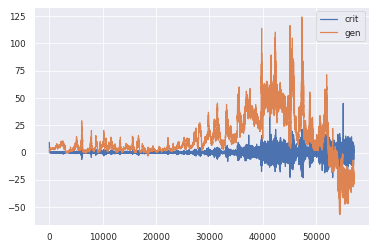

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0277 - g_loss: -25.6867
Epoch 30/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1166 - g_loss: -12.2077

KL Divergence: 5.8760165383930465 bits
Pinball Loss Temp mean: 1.0382099141086936
Pinball Loss Humid mean: 0.39419481200547046
MSE Temp: 2.076419828217386
MSE Humid: 0.7883896240109338


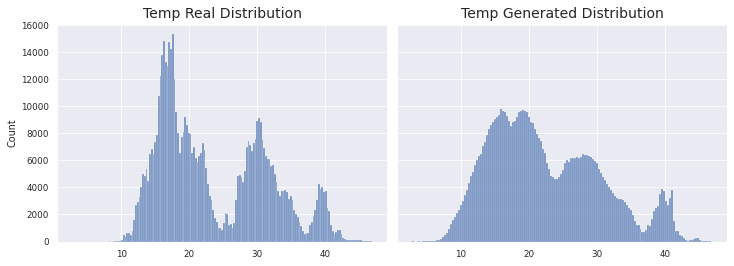

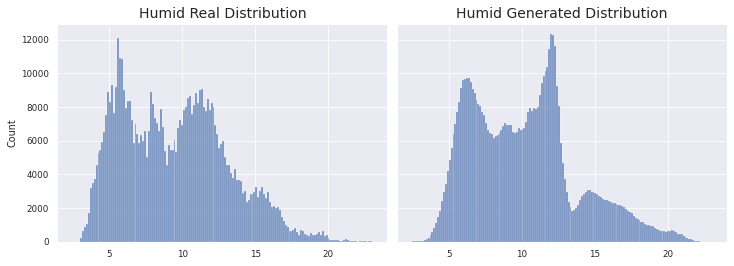

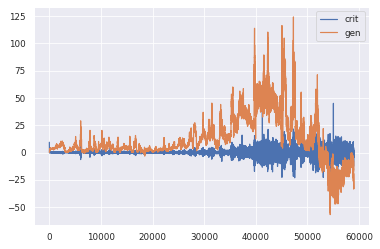

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1165 - g_loss: -12.2289
Epoch 31/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0794 - g_loss: -22.6865

KL Divergence: 2.421540410248209 bits
Pinball Loss Temp mean: 1.217951326927985
Pinball Loss Humid mean: 0.349744342856147
MSE Temp: 2.4359026538559525
MSE Humid: 0.6994886857123078


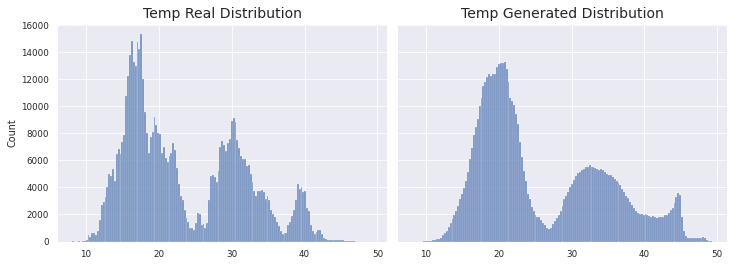

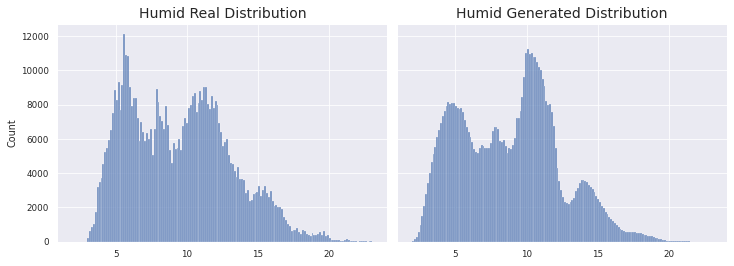

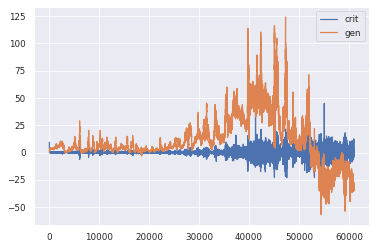

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0918 - g_loss: -22.6931
Epoch 32/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0941 - g_loss: -31.1243

KL Divergence: 4.469222913727547 bits
Pinball Loss Temp mean: 1.3774453641354605
Pinball Loss Humid mean: 1.0372449334141618
MSE Temp: 2.754890728270962
MSE Humid: 2.0744898668283245


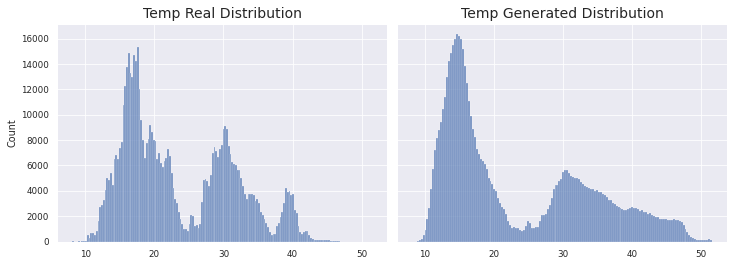

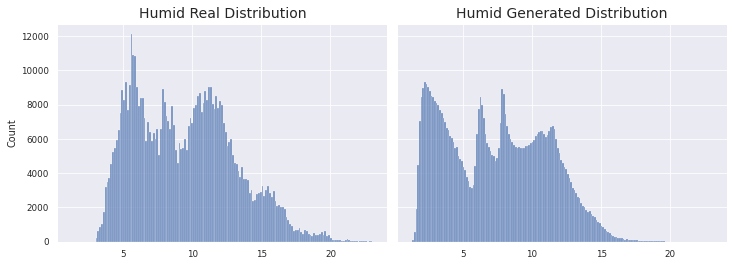

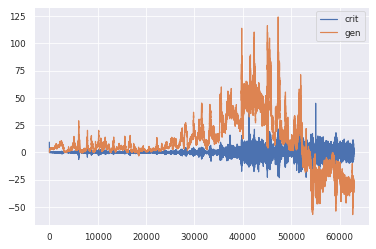

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1020 - g_loss: -31.1299
Epoch 33/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0329 - g_loss: -30.6252

KL Divergence: 2.3737213272266877 bits
Pinball Loss Temp mean: 0.7097108378764903
Pinball Loss Humid mean: 0.23504272773273366
MSE Temp: 1.4194216757529583
MSE Humid: 0.47008545546547204


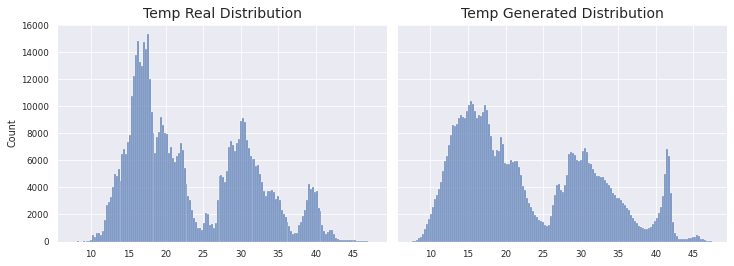

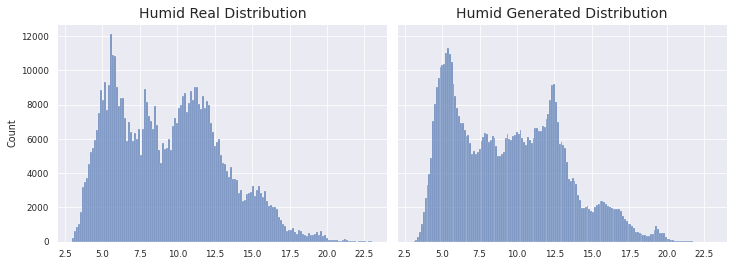

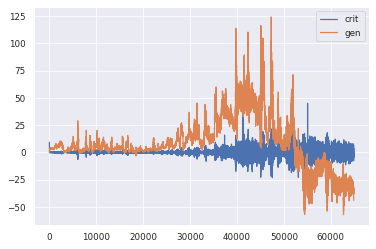

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0387 - g_loss: -30.6387
Epoch 34/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0015 - g_loss: -45.2060 

KL Divergence: 2.6771180087579256 bits
Pinball Loss Temp mean: 0.7922218934998478
Pinball Loss Humid mean: 0.2859269960467497
MSE Temp: 1.5844437869996684
MSE Humid: 0.571853992093489


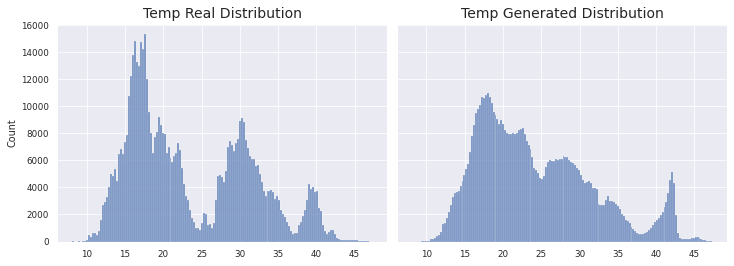

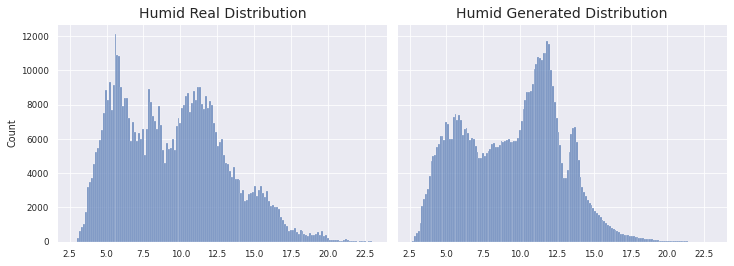

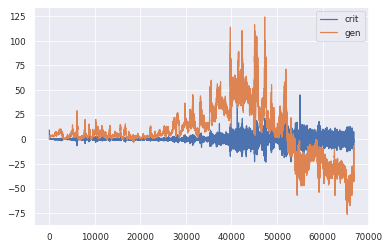

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0019 - g_loss: -45.1673
Epoch 35/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1665 - g_loss: -16.9577

KL Divergence: 3.197923976076388 bits
Pinball Loss Temp mean: 0.7662713469041684
Pinball Loss Humid mean: 0.3518685547354161
MSE Temp: 1.5325426938083262
MSE Humid: 0.7037371094708261


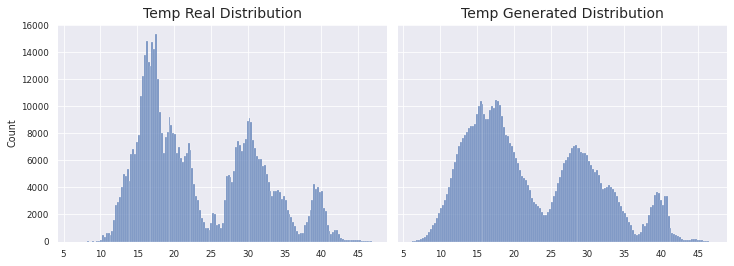

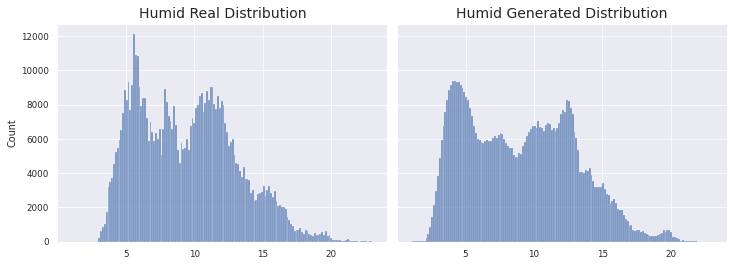

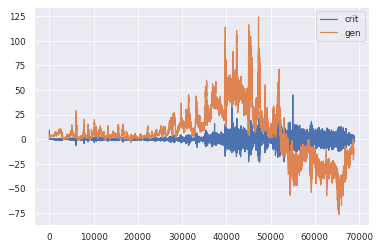

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1640 - g_loss: -16.9480
Epoch 36/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0032 - g_loss: -13.7575

KL Divergence: 2.180088859872733 bits
Pinball Loss Temp mean: 0.7603515342170952
Pinball Loss Humid mean: 0.32256188984748746
MSE Temp: 1.5207030684341738
MSE Humid: 0.645123779694964


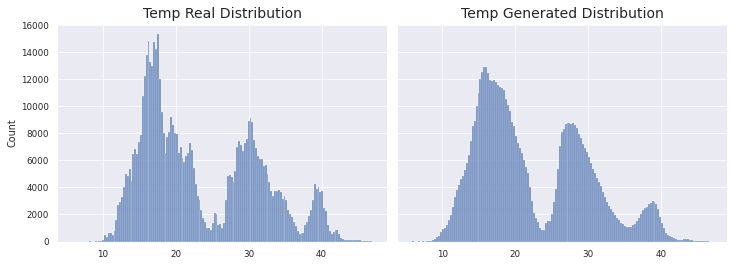

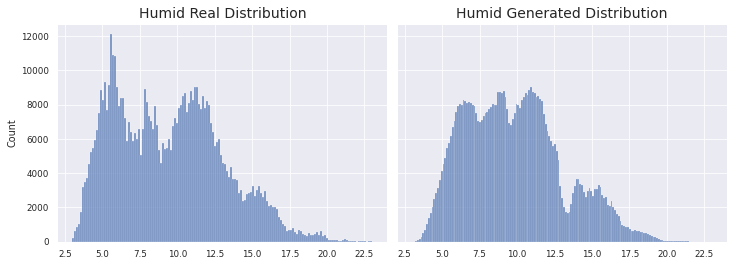

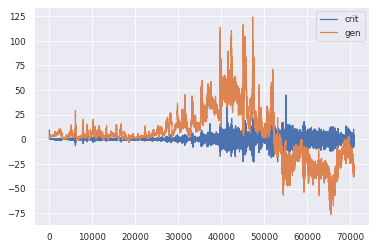

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0088 - g_loss: -13.7821
Epoch 37/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0715 - g_loss: -26.1504

KL Divergence: 2.2594469566931954 bits
Pinball Loss Temp mean: 0.6440910138768612
Pinball Loss Humid mean: 0.44683346177006256
MSE Temp: 1.288182027753733
MSE Humid: 0.8936669235401299


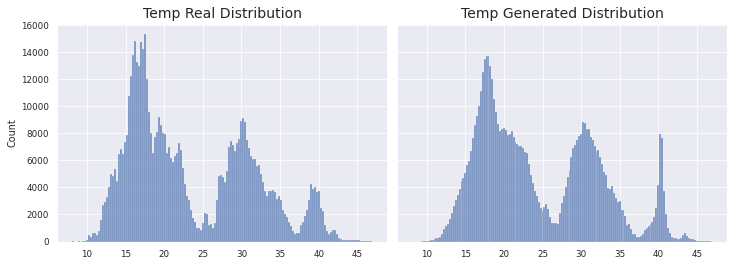

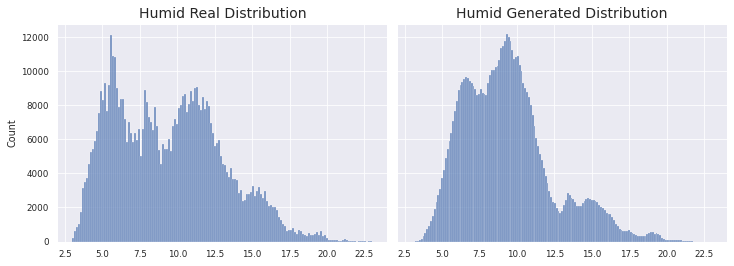

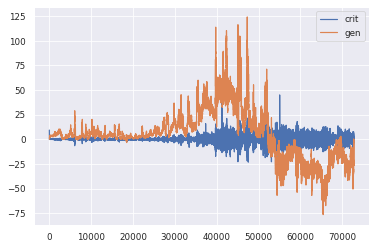

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0674 - g_loss: -26.1237
Epoch 38/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0208 - g_loss: -16.8486

KL Divergence: 6.869704595998576 bits
Pinball Loss Temp mean: 0.825958149736141
Pinball Loss Humid mean: 0.3595336203197522
MSE Temp: 1.6519162994723051
MSE Humid: 0.7190672406394981


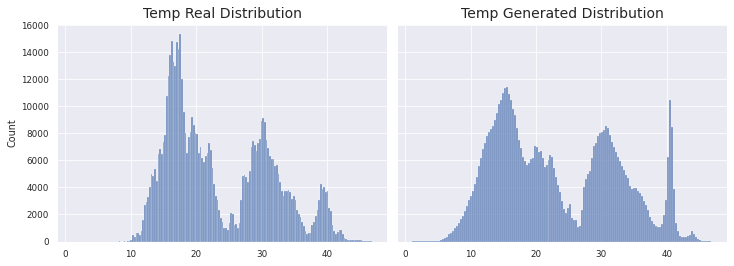

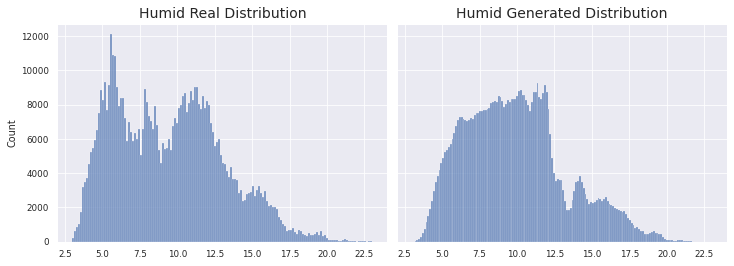

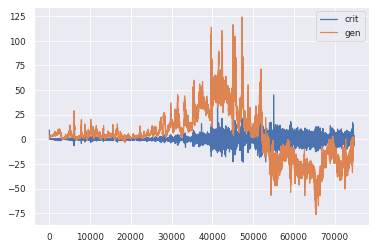

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0139 - g_loss: -16.8312
Epoch 39/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0601 - g_loss: 1.3474

KL Divergence: 2.5925887036783988 bits
Pinball Loss Temp mean: 0.7450539645179511
Pinball Loss Humid mean: 0.2792655305706567
MSE Temp: 1.4901079290359152
MSE Humid: 0.558531061141314


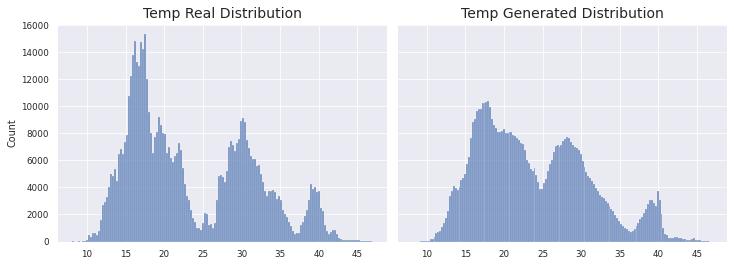

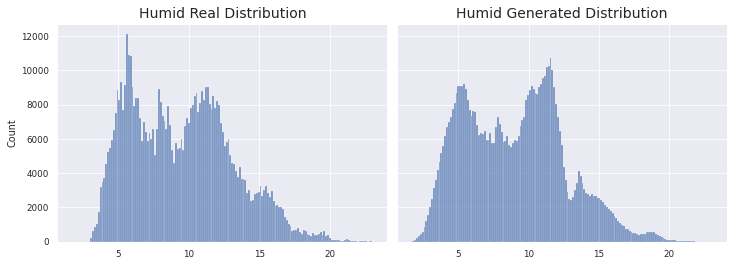

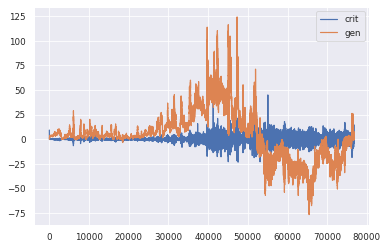

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0751 - g_loss: 1.3534
Epoch 40/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0237 - g_loss: -9.7079

KL Divergence: 6.522288636197937 bits
Pinball Loss Temp mean: 0.6097176388255221
Pinball Loss Humid mean: 0.4870851161281152
MSE Temp: 1.2194352776510202
MSE Humid: 0.9741702322562432


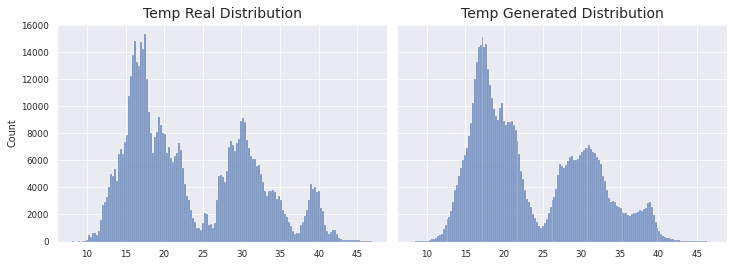

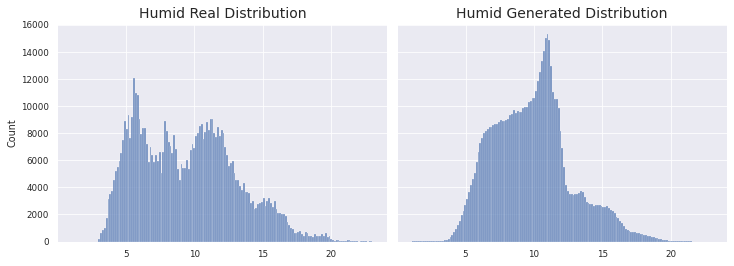

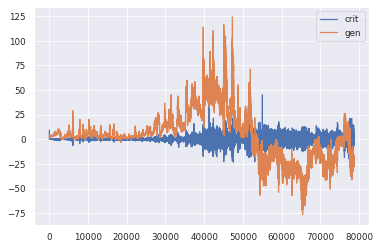

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0297 - g_loss: -9.7258
Epoch 41/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0983 - g_loss: -16.9735

KL Divergence: 2.8712673853119686 bits
Pinball Loss Temp mean: 0.8212802310517491
Pinball Loss Humid mean: 0.26464234770715656
MSE Temp: 1.6425604621035186
MSE Humid: 0.5292846954143138


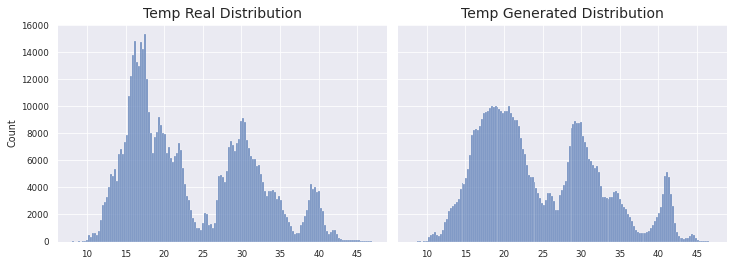

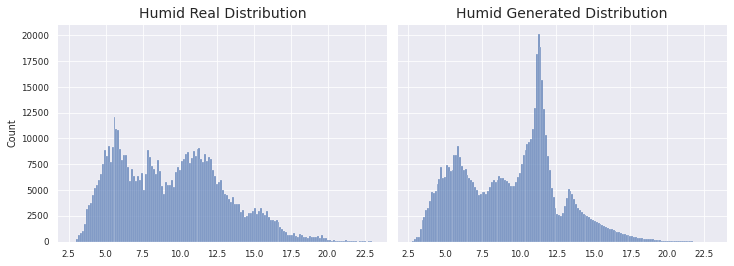

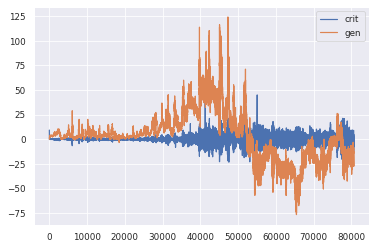

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1074 - g_loss: -16.9840
Epoch 42/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0714 - g_loss: -14.8782

KL Divergence: 3.373842164401586 bits
Pinball Loss Temp mean: 1.1055830383783345
Pinball Loss Humid mean: 0.29182778424069783
MSE Temp: 2.211166076756673
MSE Humid: 0.5836555684813978


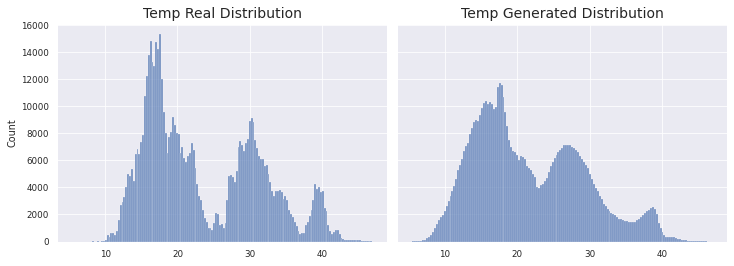

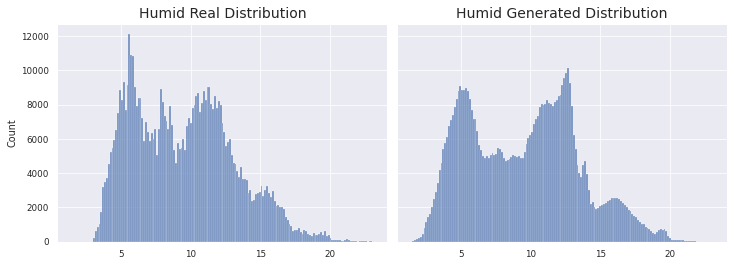

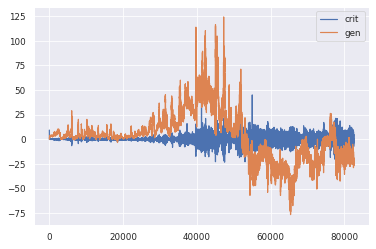

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0789 - g_loss: -14.8762
Epoch 43/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0942 - g_loss: -13.9282

KL Divergence: 4.379605748960064 bits
Pinball Loss Temp mean: 0.8271520500609985
Pinball Loss Humid mean: 0.35895432768007474
MSE Temp: 1.6543041001220096
MSE Humid: 0.7179086553601608


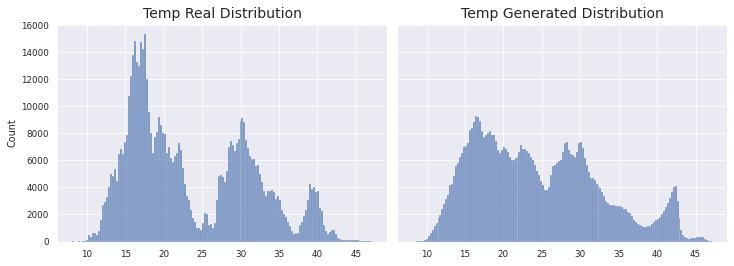

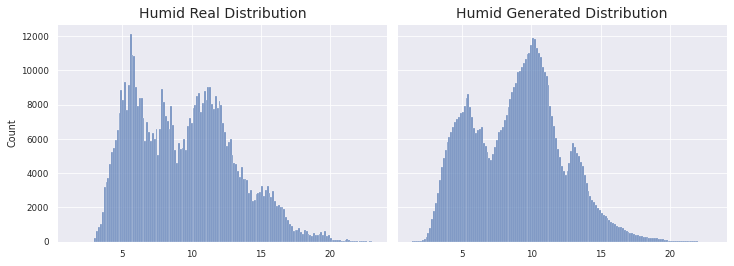

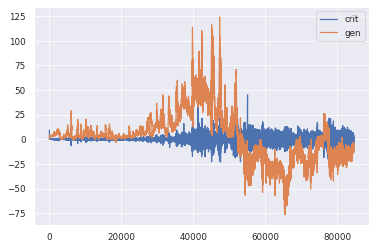

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0944 - g_loss: -13.9275
Epoch 44/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0379 - g_loss: -13.0613

KL Divergence: 2.4111950954471006 bits
Pinball Loss Temp mean: 0.5232725175834073
Pinball Loss Humid mean: 0.3615571003487046
MSE Temp: 1.0465450351668126
MSE Humid: 0.7231142006974065


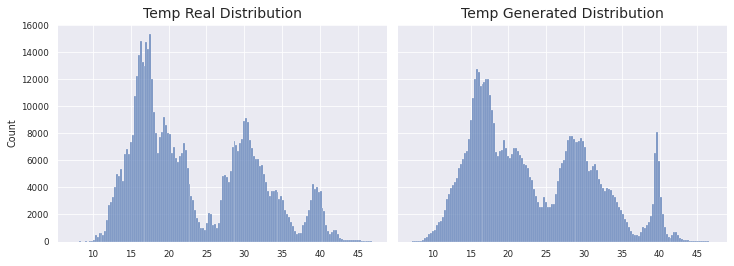

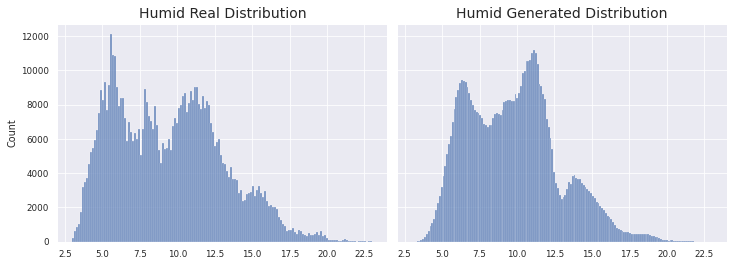

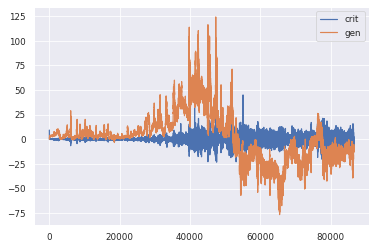

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.0479 - g_loss: -13.0534
Epoch 45/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1907 - g_loss: -13.6747
Better KL
Better Pinball
Better MSE
>45 MODELS HAVE BEEN SAVED


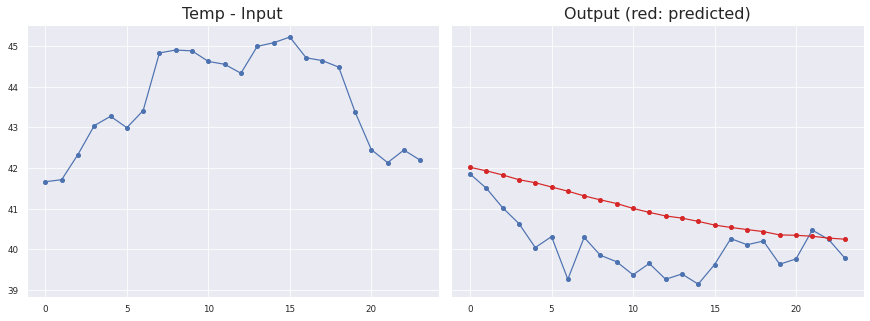

Sensor #33.0
Temp
MAE: 0.9357236991325989 ± 0.5963321564943542
MSE: 1.207685884364829
RMSE: 1.0989476258515822
Max Error: 2.167726962566377


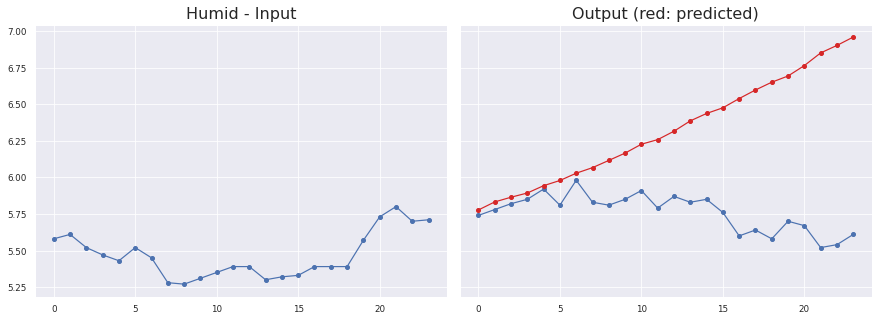

Sensor #33.0
Humid
MAE: 0.5609321397915484 ± 0.4563622735016749
MSE: 0.5229113901267428
RMSE: 0.7231261232501166
Max Error: 1.362183448076249


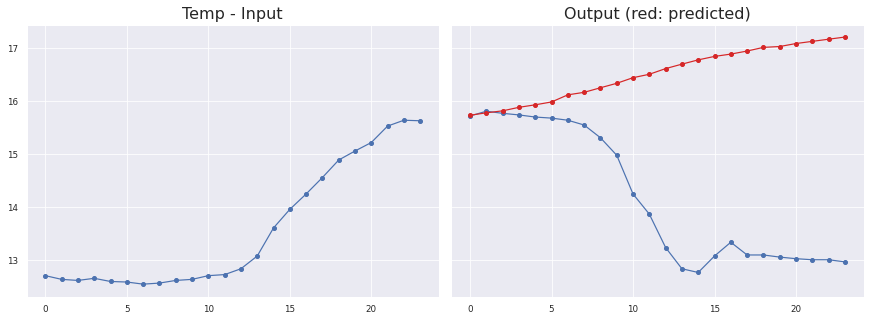

Sensor #8.0
Temp
MAE: 2.3265374478697773 ± 1.6980251775435926
MSE: 8.28428333615881
RMSE: 2.8782430988640986
Max Error: 4.2381002855300896


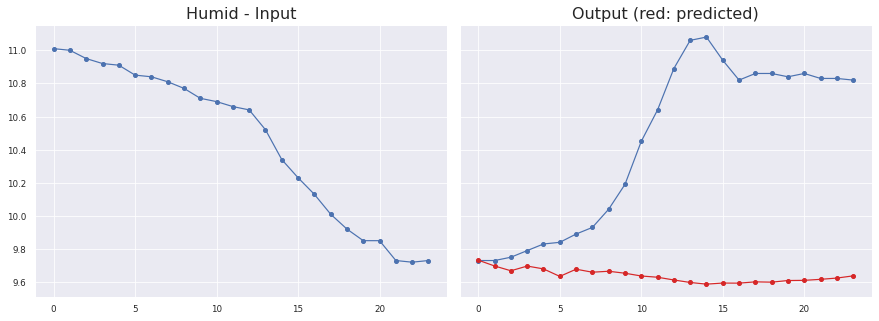

Sensor #8.0
Humid
MAE: 0.7996894658170636 ± 0.5346946743213205
MSE: 0.9251183215155999
RMSE: 0.9618307135435008
Max Error: 1.4926363311707966


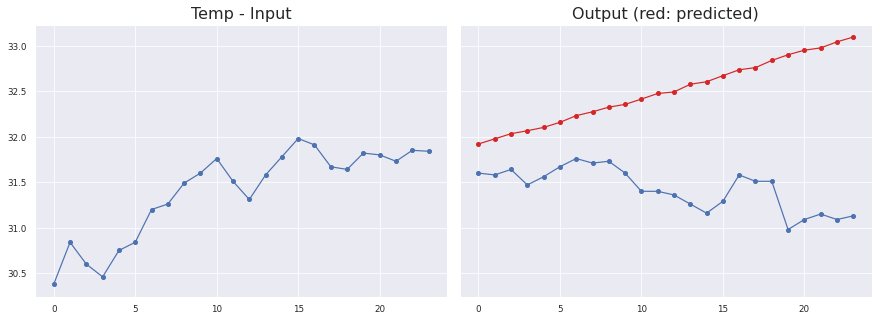

Sensor #14.0
Temp
MAE: 1.0721121516823766 ± 0.5463040181557515
MSE: 1.447872546038135
RMSE: 1.2032757564407814
Max Error: 1.964606860876085


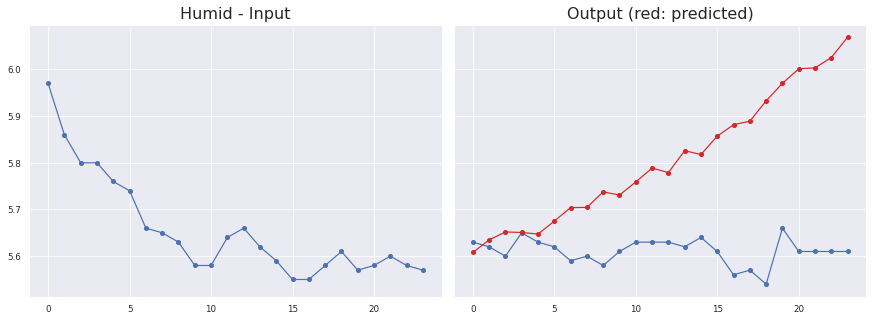

Sensor #14.0
Humid
MAE: 0.1971161917969586 ± 0.14463893191180666
MSE: 0.05905054041103785
RMSE: 0.24300316954936585
Max Error: 0.45949082434177324


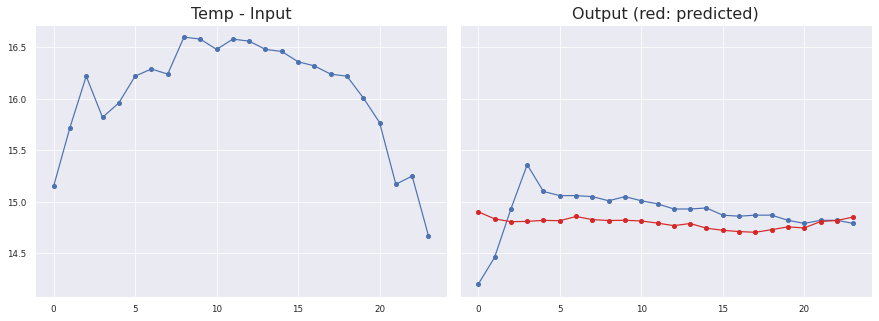

Sensor #10.0
Temp
MAE: 0.19966156373421304 ± 0.22970017946530286
MSE: 0.06374424635113353
RMSE: 0.25247622927937896
Max Error: 0.7024624609947203


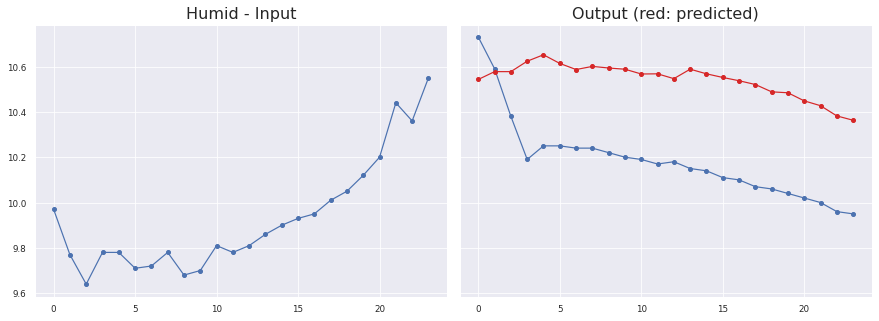

Sensor #10.0
Humid
MAE: 0.37355164907872734 ± 0.1490940904404292
MSE: 0.14962154504920883
RMSE: 0.3868094428128776
Max Error: 0.45062286153435593

KL Divergence: 1.431968505559659 bits
Pinball Loss Temp mean: 0.48841611087050874
Pinball Loss Humid mean: 0.2190017512447131
MSE Temp: 0.976832221741014
MSE Humid: 0.4380035024894256


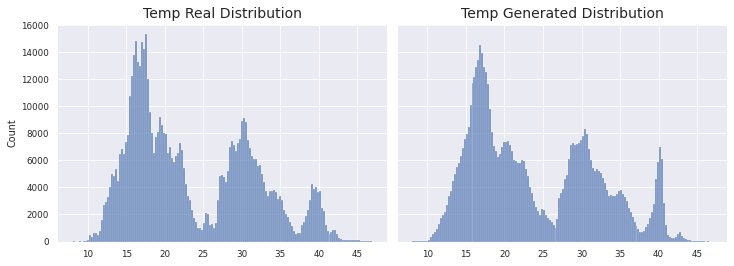

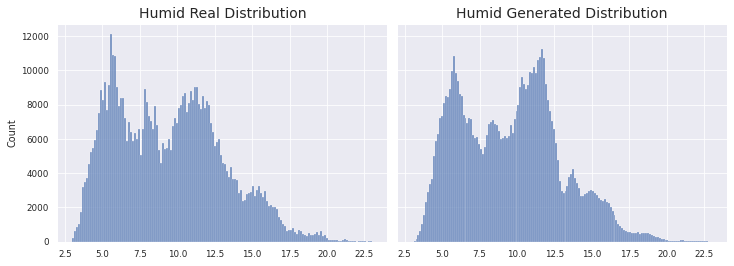

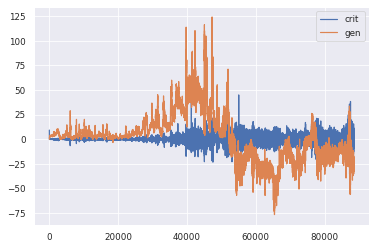

1966/1966 [==============================] - 137s 70ms/step - d_loss: -0.1937 - g_loss: -13.6942
Epoch 46/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0848 - g_loss: -34.5655

KL Divergence: 1.7702188308999875 bits
Pinball Loss Temp mean: 0.5149165032232098
Pinball Loss Humid mean: 0.35385735953753356
MSE Temp: 1.029833006446419
MSE Humid: 0.7077147190750721


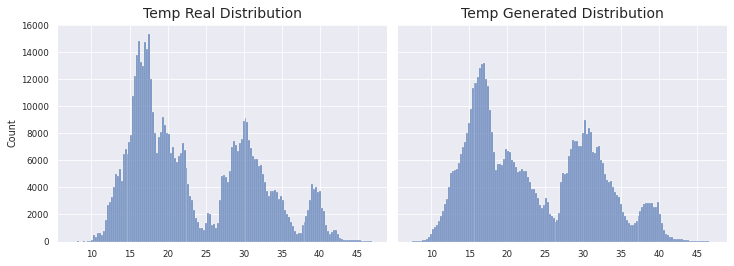

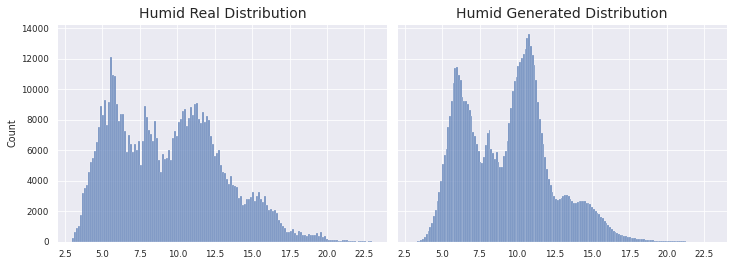

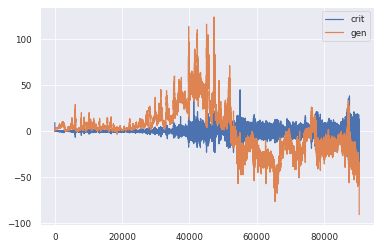

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0384 - g_loss: -34.6225
Epoch 47/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4195 - g_loss: -75.2058

KL Divergence: 2.9350766818578737 bits
Pinball Loss Temp mean: 0.6434821574625028
Pinball Loss Humid mean: 0.3448829283862093
MSE Temp: 1.2869643149250463
MSE Humid: 0.6897658567724185


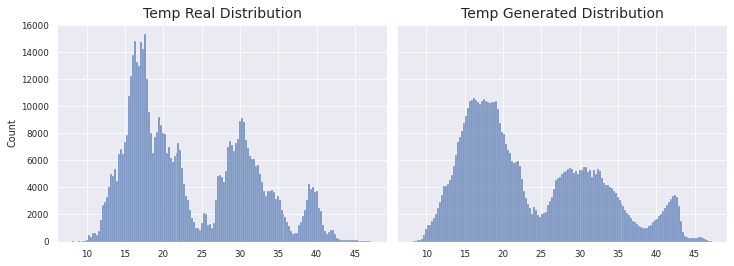

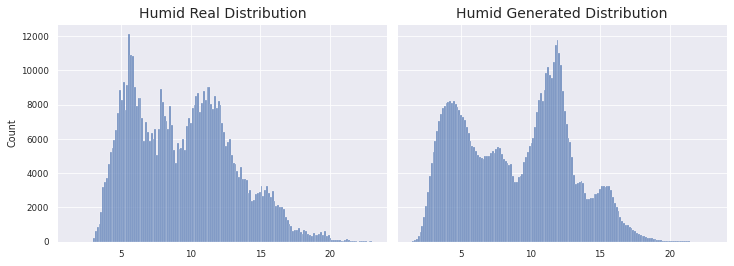

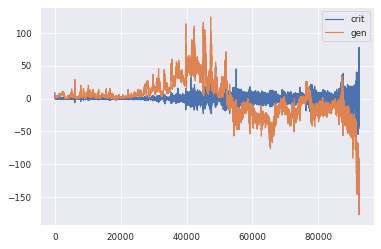

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.3399 - g_loss: -75.3089
Epoch 48/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2203 - g_loss: -70.8926

KL Divergence: 13.32836737269185 bits
Pinball Loss Temp mean: 2.0427059262617506
Pinball Loss Humid mean: 0.6151421476752332
MSE Temp: 4.085411852523459
MSE Humid: 1.230284295350464


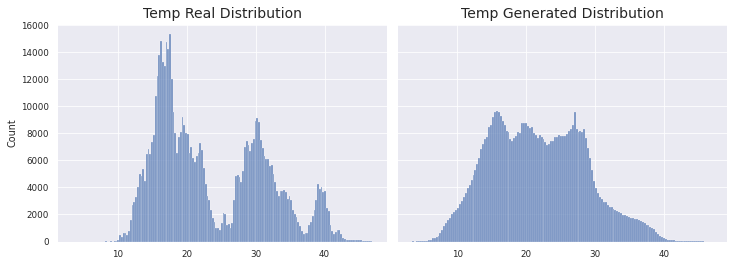

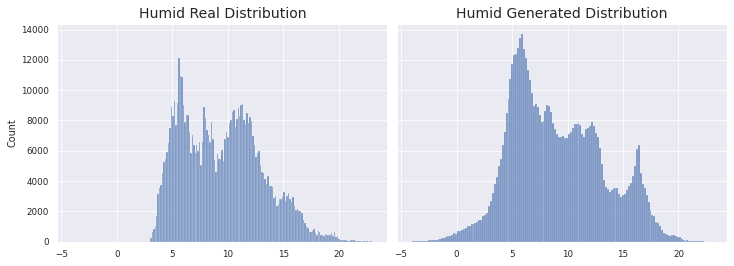

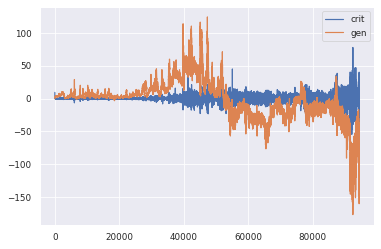

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.2583 - g_loss: -70.9591
Epoch 49/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1176 - g_loss: -102.1130

KL Divergence: 1.8267824728795676 bits
Pinball Loss Temp mean: 0.946739937329004
Pinball Loss Humid mean: 0.362394900163708
MSE Temp: 1.8934798746580048
MSE Humid: 0.7247898003274007


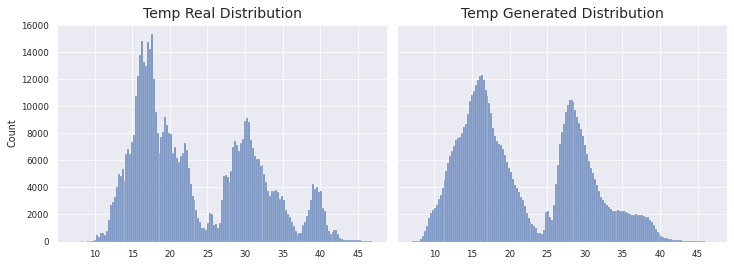

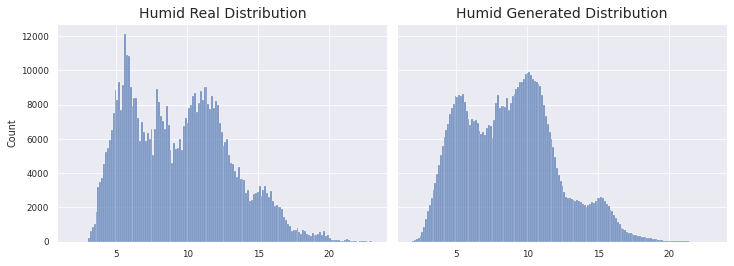

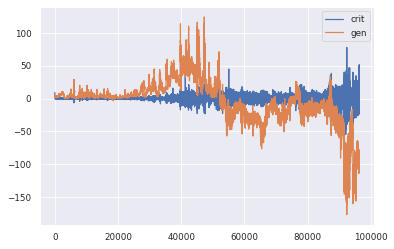

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.1696 - g_loss: -102.0925
Epoch 50/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0855 - g_loss: -82.2006

KL Divergence: 2.650180042434277 bits
Pinball Loss Temp mean: 0.8125638046795544
Pinball Loss Humid mean: 0.44217618758316
MSE Temp: 1.625127609359132
MSE Humid: 0.8843523751663173


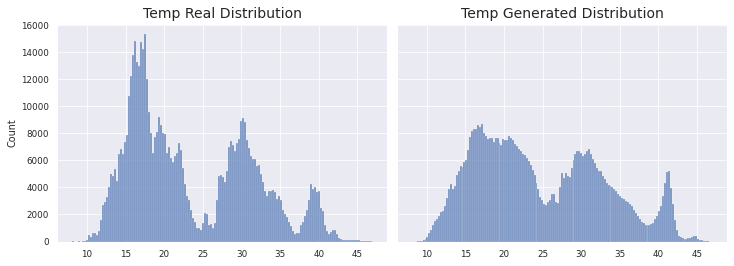

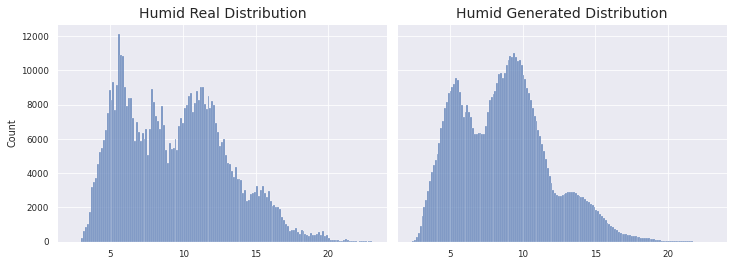

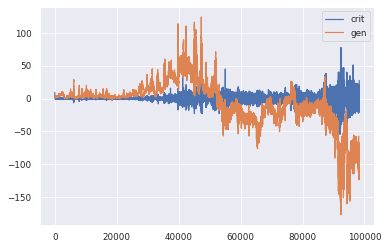

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1135 - g_loss: -82.2385
Epoch 51/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1150 - g_loss: -89.3175

KL Divergence: 3.7727685208697683 bits
Pinball Loss Temp mean: 0.7468824112918804
Pinball Loss Humid mean: 0.5631578540935778
MSE Temp: 1.4937648225837585
MSE Humid: 1.126315708187143


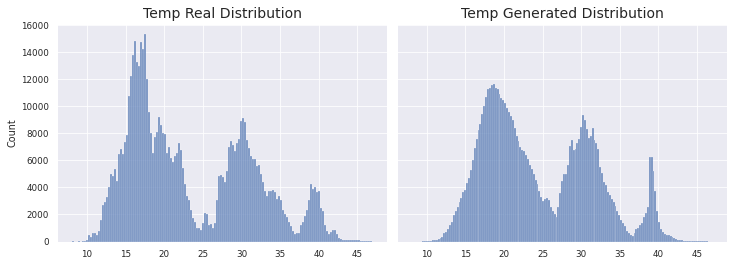

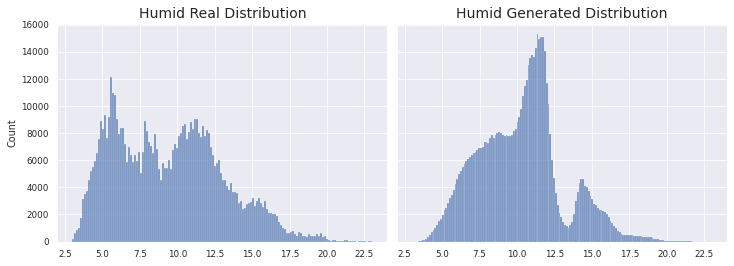

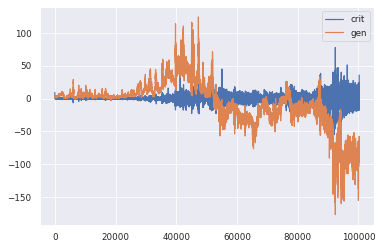

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1515 - g_loss: -89.3157
Epoch 52/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3124 - g_loss: -79.3791

KL Divergence: 2.0901426257982547 bits
Pinball Loss Temp mean: 0.7668485570342305
Pinball Loss Humid mean: 0.2639425600915445
MSE Temp: 1.533697114068467
MSE Humid: 0.527885120183096


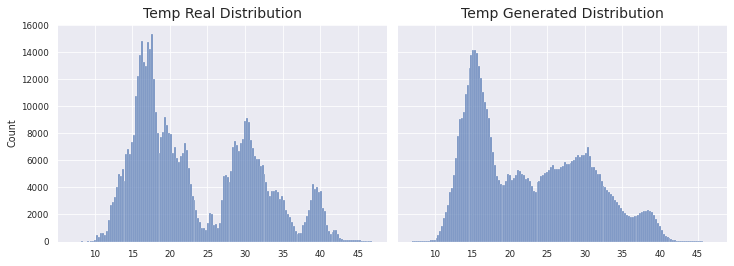

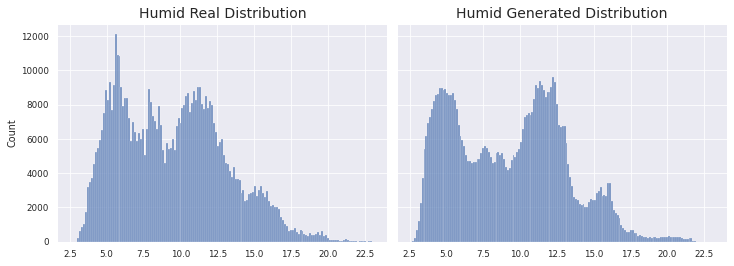

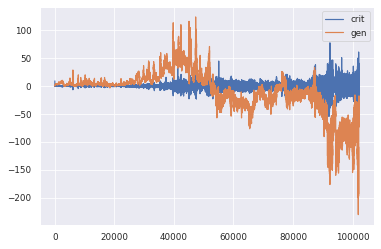

1966/1966 [==============================] - 132s 67ms/step - d_loss: -0.3468 - g_loss: -79.3640
Epoch 53/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1980 - g_loss: -30.5193

KL Divergence: 1.8438603993242109 bits
Pinball Loss Temp mean: 0.8800191107127049
Pinball Loss Humid mean: 0.40402753244637013
MSE Temp: 1.7600382214254011
MSE Humid: 0.8080550648927445


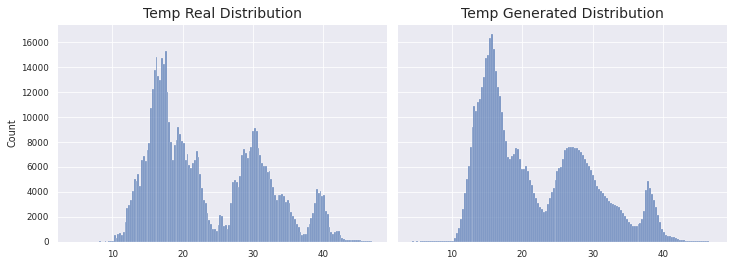

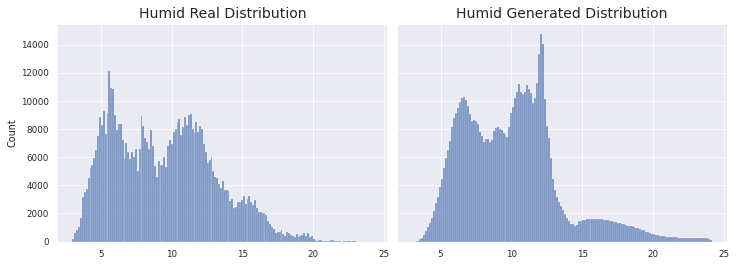

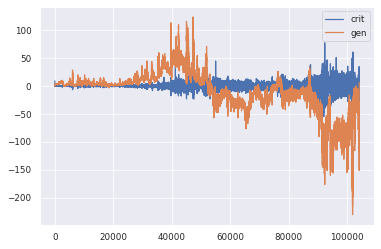

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1747 - g_loss: -30.4815
Epoch 54/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2049 - g_loss: -72.0156

KL Divergence: 3.978646676427507 bits
Pinball Loss Temp mean: 0.9276739332950379
Pinball Loss Humid mean: 0.25501092227876565
MSE Temp: 1.855347866590059
MSE Humid: 0.5100218445575285


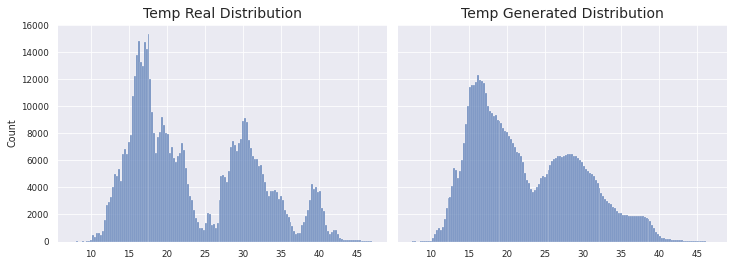

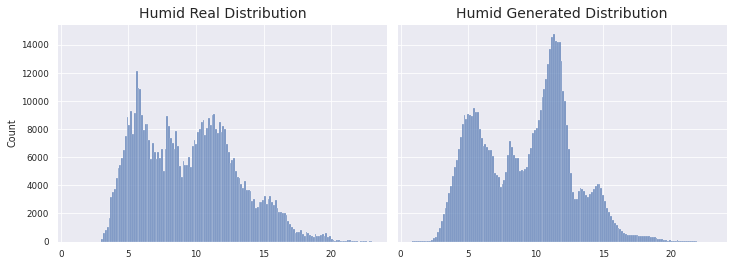

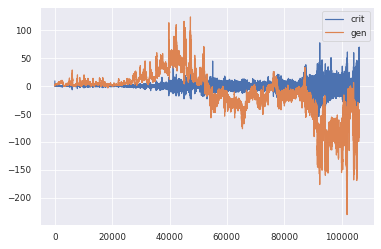

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.2757 - g_loss: -72.0349
Epoch 55/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1075 - g_loss: -60.3216

KL Divergence: 6.081253826862269 bits
Pinball Loss Temp mean: 0.6863020928500065
Pinball Loss Humid mean: 0.29562407022564025
MSE Temp: 1.3726041857000189
MSE Humid: 0.5912481404512883


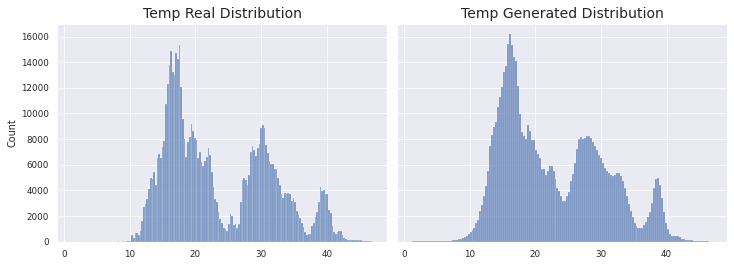

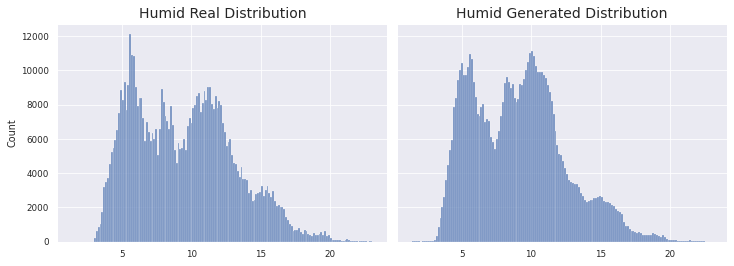

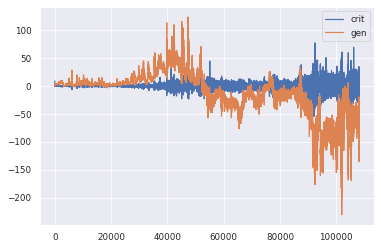

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0121 - g_loss: -60.2803
Epoch 56/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3179 - g_loss: -43.0587

KL Divergence: 2.1059774714944623 bits
Pinball Loss Temp mean: 0.8946639521260114
Pinball Loss Humid mean: 0.4159775150155903
MSE Temp: 1.7893279042520187
MSE Humid: 0.8319550300311963


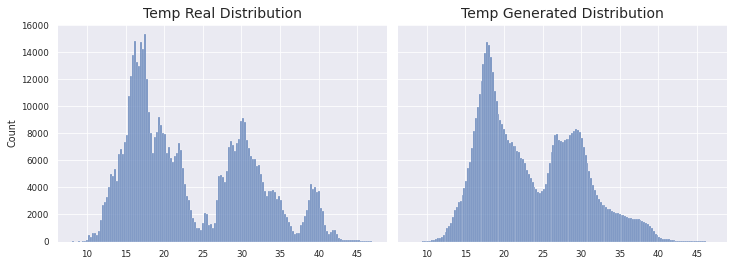

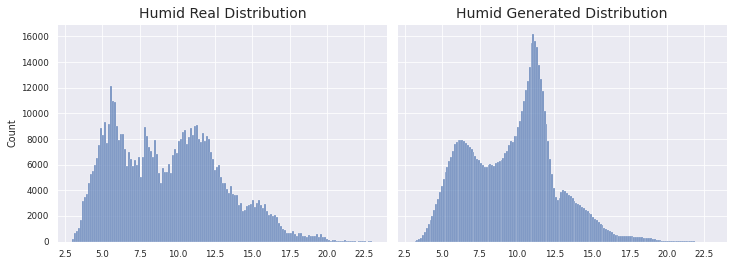

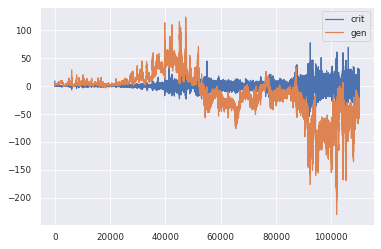

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.3223 - g_loss: -43.0665
Epoch 57/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0714 - g_loss: -31.6831

KL Divergence: 8.532308318536622 bits
Pinball Loss Temp mean: 4.504376398474829
Pinball Loss Humid mean: 0.9320080491165346
MSE Temp: 9.008752796949633
MSE Humid: 1.864016098233062


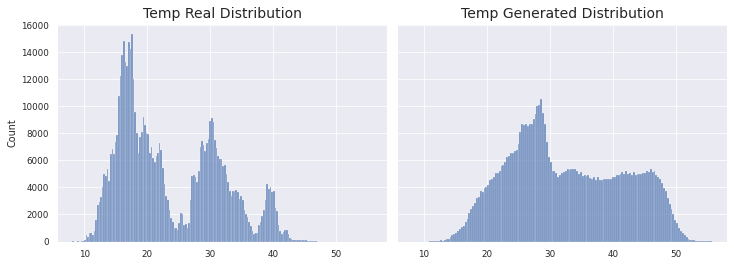

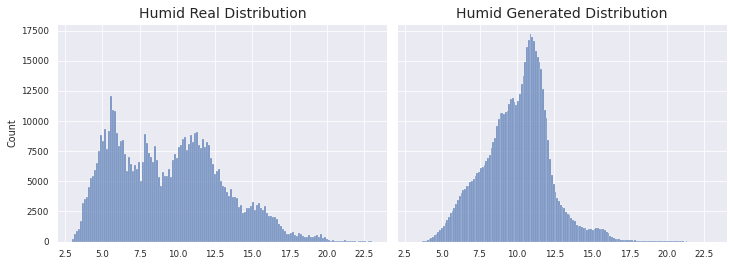

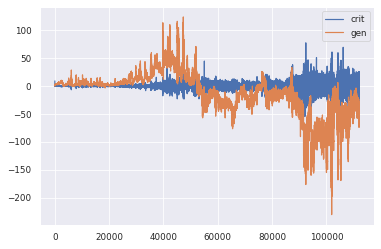

1966/1966 [==============================] - 132s 67ms/step - d_loss: -0.1359 - g_loss: -31.7137
Epoch 58/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0625 - g_loss: -31.7639

KL Divergence: 9.044604123619715 bits
Pinball Loss Temp mean: 2.0984515752399155
Pinball Loss Humid mean: 0.9039996202480356
MSE Temp: 4.196903150479938
MSE Humid: 1.807999240496036


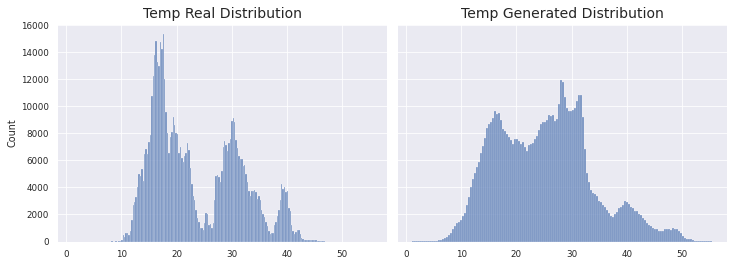

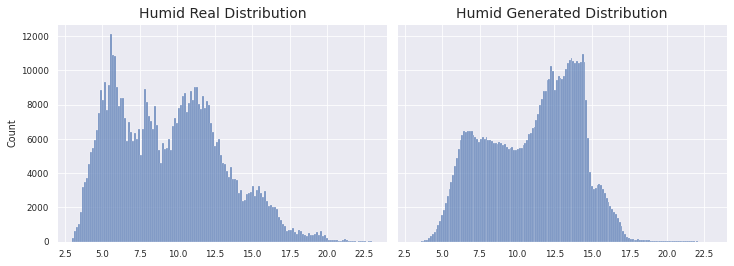

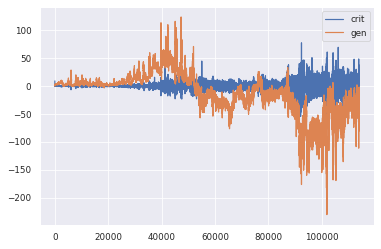

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0919 - g_loss: -31.7653
Epoch 59/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2442 - g_loss: -2.4637

KL Divergence: 11.113685590119452 bits
Pinball Loss Temp mean: 4.191523879960787
Pinball Loss Humid mean: 1.1273644336972692
MSE Temp: 8.383047759921565
MSE Humid: 2.2547288673945167


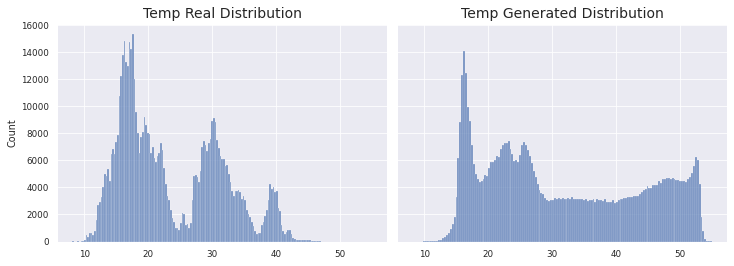

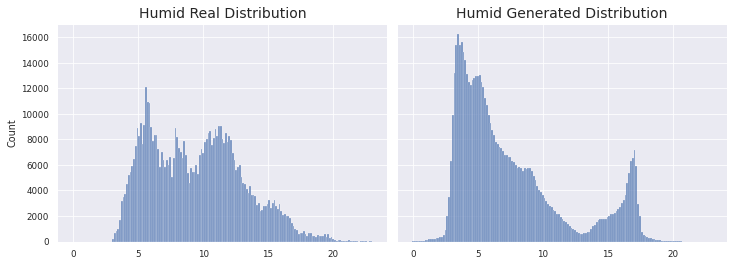

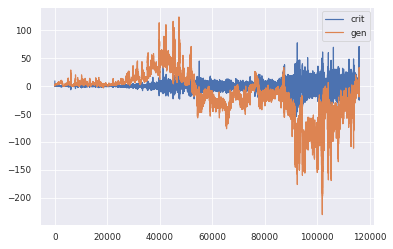

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.3162 - g_loss: -2.4532
Epoch 60/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0674 - g_loss: 3.8149

KL Divergence: 3.1811761311396105 bits
Pinball Loss Temp mean: 0.9585507443442713
Pinball Loss Humid mean: 0.4176469005126836
MSE Temp: 1.917101488688566
MSE Humid: 0.8352938010253563


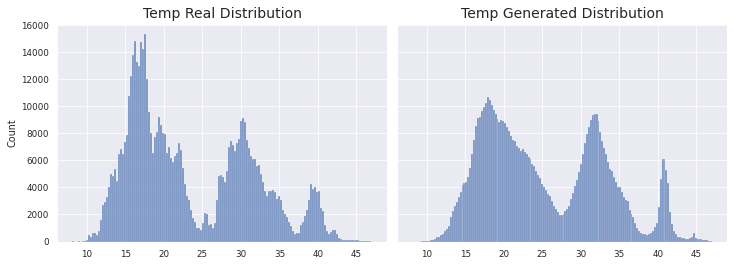

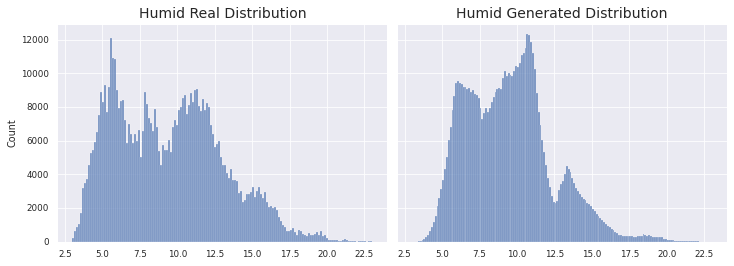

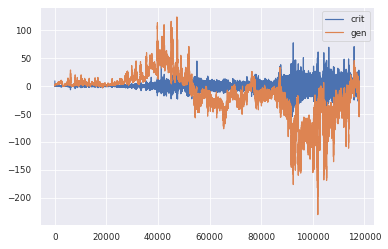

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0628 - g_loss: 3.7554
Epoch 61/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0249 - g_loss: 0.2304

KL Divergence: 4.409553204908888 bits
Pinball Loss Temp mean: 1.946796442725942
Pinball Loss Humid mean: 0.8519742647032889
MSE Temp: 3.893592885451905
MSE Humid: 1.7039485294065522


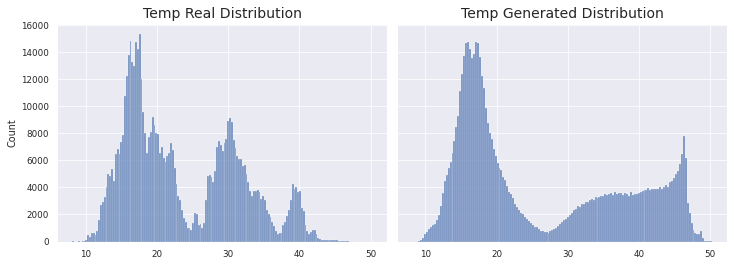

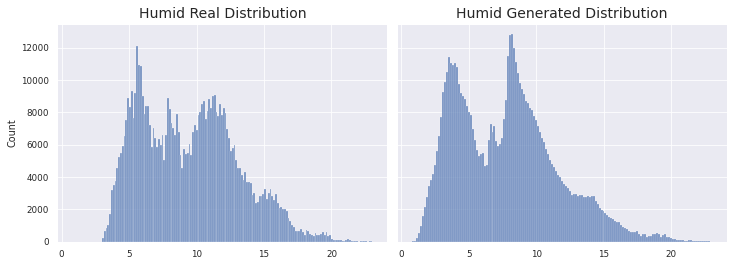

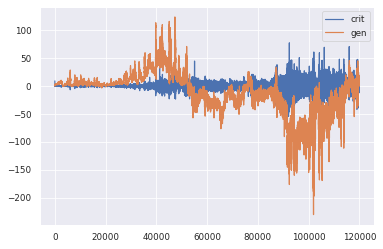

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.0130 - g_loss: 0.2447
Epoch 62/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1252 - g_loss: 0.9977

KL Divergence: 2.3057177291139572 bits
Pinball Loss Temp mean: 0.6060303111106976
Pinball Loss Humid mean: 0.34481432512985977
MSE Temp: 1.2120606222214012
MSE Humid: 0.6896286502597252


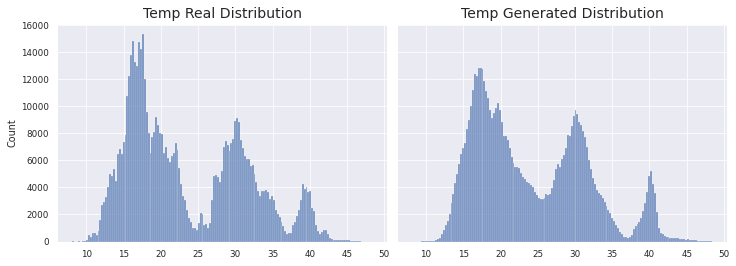

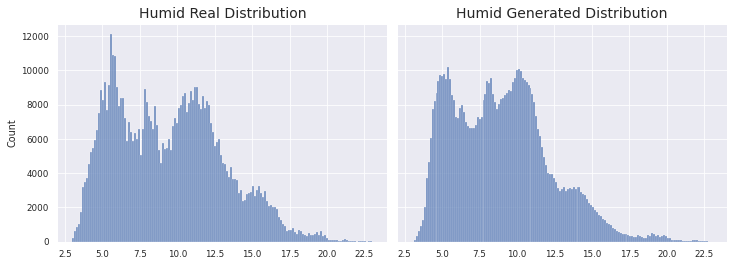

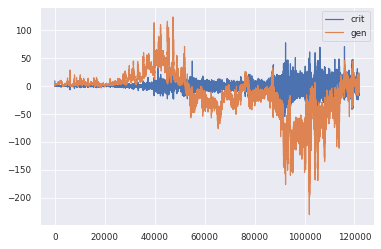

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1290 - g_loss: 1.0203
Epoch 63/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0307 - g_loss: 19.0079

KL Divergence: 5.531993119520339 bits
Pinball Loss Temp mean: 0.7371824824348696
Pinball Loss Humid mean: 1.0831511848575273
MSE Temp: 1.4743649648697765
MSE Humid: 2.16630236971506


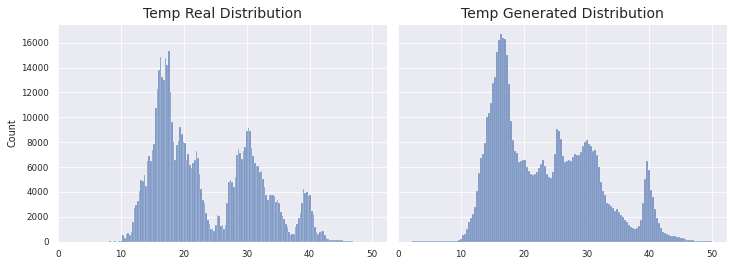

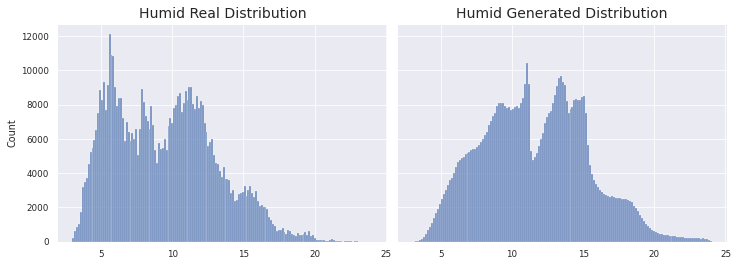

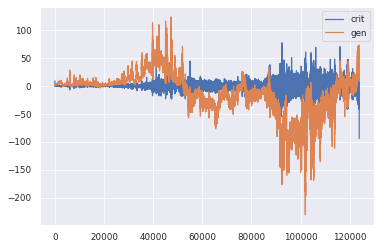

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.0648 - g_loss: 19.0539
Epoch 64/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2549 - g_loss: 22.1187

KL Divergence: 1.975052212069736 bits
Pinball Loss Temp mean: 1.3927130726365318
Pinball Loss Humid mean: 0.27062334724975357
MSE Temp: 2.7854261452730964
MSE Humid: 0.541246694499498


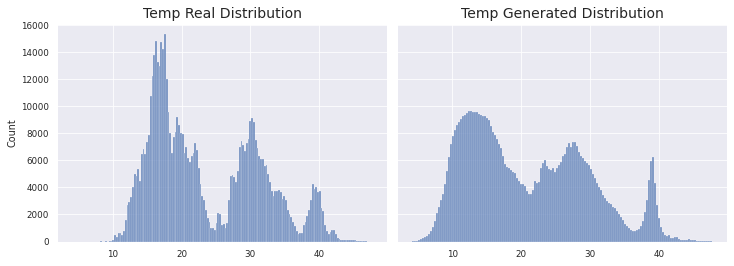

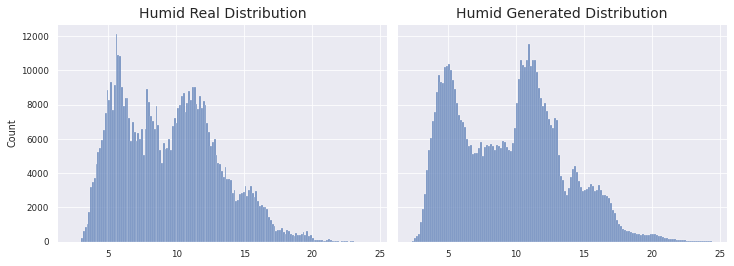

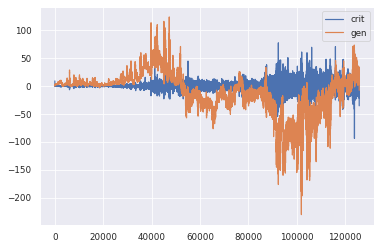

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.2188 - g_loss: 22.0887
Epoch 65/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0185 - g_loss: 21.7210

KL Divergence: 1.5575794347123986 bits
Pinball Loss Temp mean: 0.844666898776795
Pinball Loss Humid mean: 0.2777127078979002
MSE Temp: 1.6893337975535851
MSE Humid: 0.5554254157958037


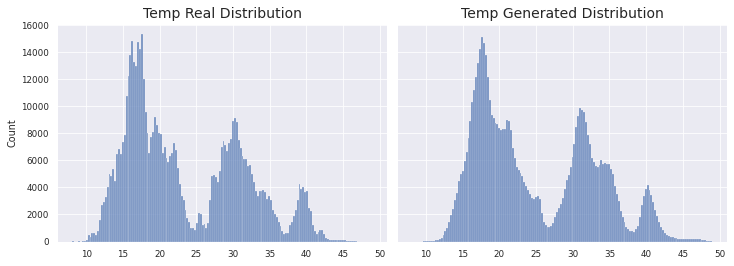

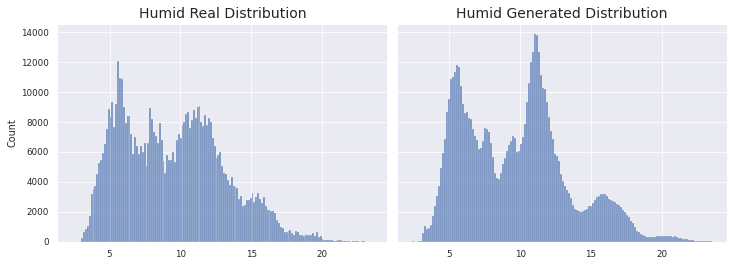

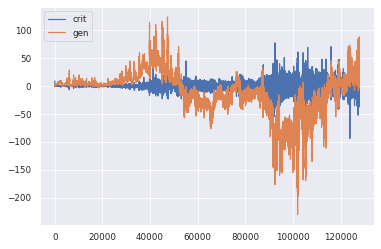

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0108 - g_loss: 21.7885
Epoch 66/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2571 - g_loss: 7.1178

KL Divergence: 2.7009327623325325 bits
Pinball Loss Temp mean: 1.2932166627316373
Pinball Loss Humid mean: 0.36388908934696973
MSE Temp: 2.5864333254632212
MSE Humid: 0.7277781786939367


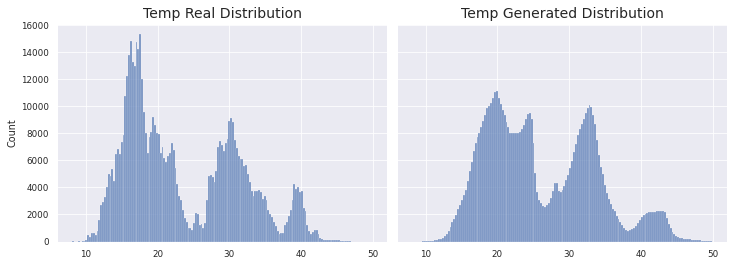

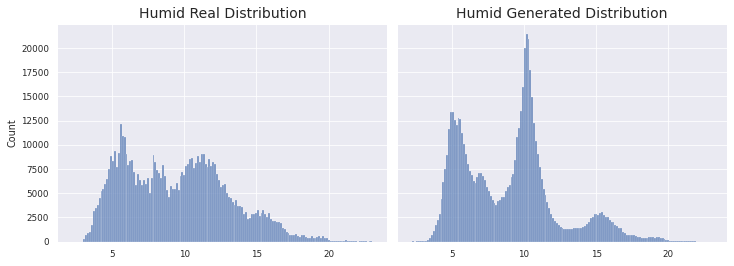

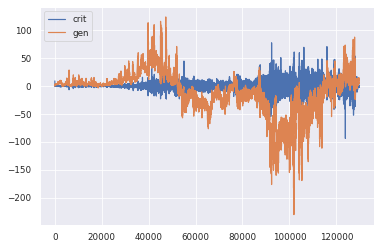

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2559 - g_loss: 7.1166
Epoch 67/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1473 - g_loss: 6.0063

KL Divergence: 1.6457261716849736 bits
Pinball Loss Temp mean: 0.6648849532039295
Pinball Loss Humid mean: 0.45801606320755195
MSE Temp: 1.329769906407831
MSE Humid: 0.9160321264151066


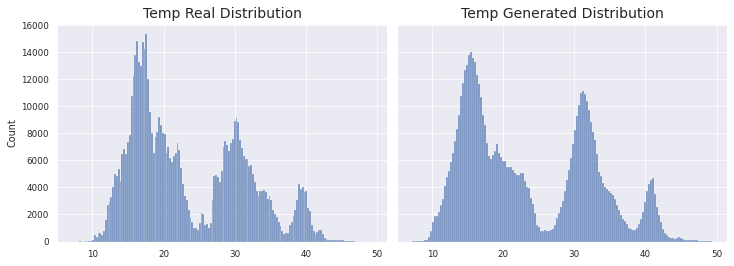

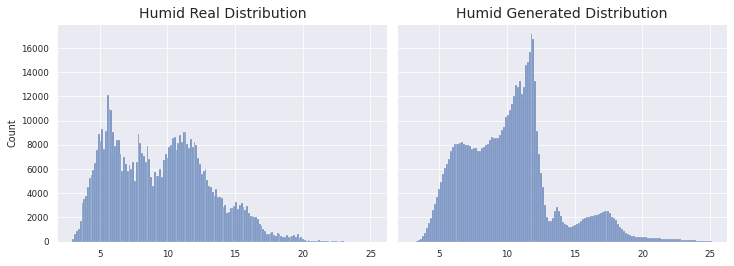

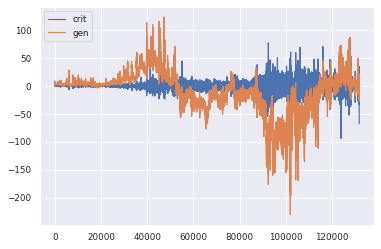

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0785 - g_loss: 5.9733
Epoch 68/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1034 - g_loss: 11.0464

KL Divergence: 3.233681206785607 bits
Pinball Loss Temp mean: 1.0311064815830464
Pinball Loss Humid mean: 0.6461154330403931
MSE Temp: 2.062212963166107
MSE Humid: 1.2922308660807862


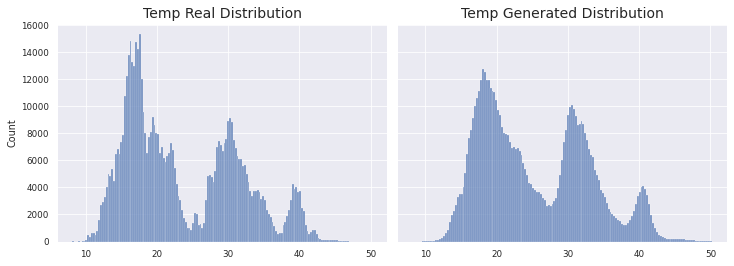

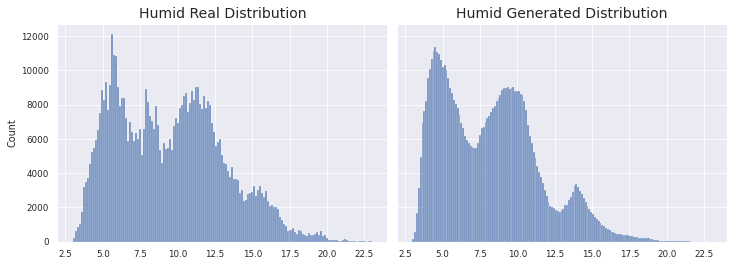

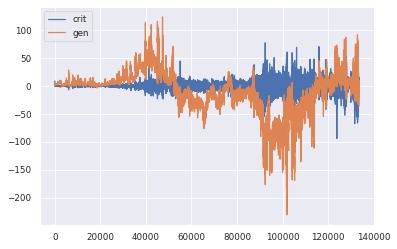

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.1131 - g_loss: 10.9988
Epoch 69/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2450 - g_loss: -2.0324

KL Divergence: 7.679149470159518 bits
Pinball Loss Temp mean: 2.0194831618009084
Pinball Loss Humid mean: 1.159405217287749
MSE Temp: 4.038966323601814
MSE Humid: 2.3188104345754716


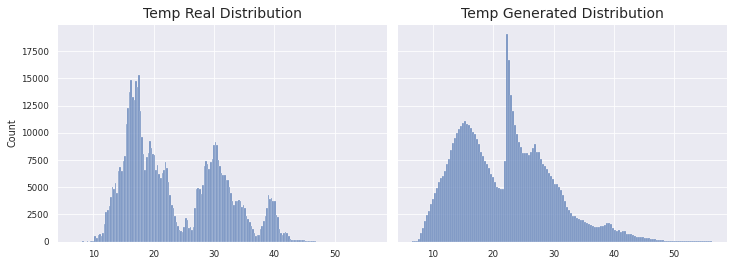

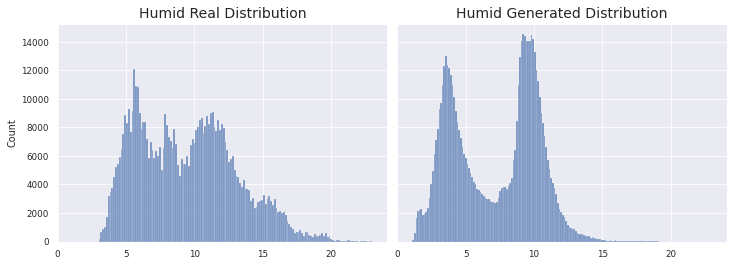

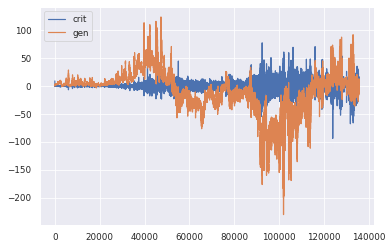

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.2530 - g_loss: -2.0441
Epoch 70/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0286 - g_loss: -8.2021

KL Divergence: 12.21579749496378 bits
Pinball Loss Temp mean: 1.3975983821586524
Pinball Loss Humid mean: 0.48687789142427446
MSE Temp: 2.795196764317295
MSE Humid: 0.9737557828485612


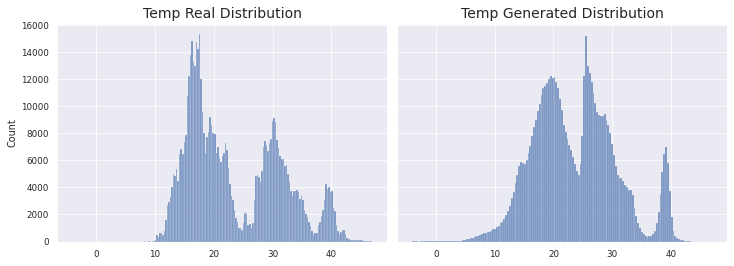

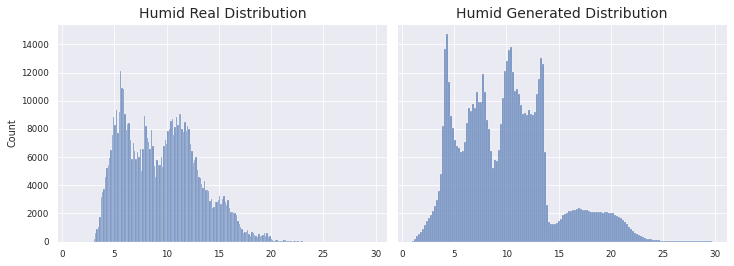

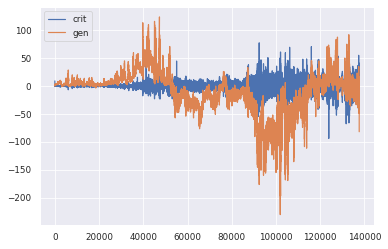

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0115 - g_loss: -8.2770
Epoch 71/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4647 - g_loss: -16.8442

KL Divergence: 8.795029125085499 bits
Pinball Loss Temp mean: 0.8275028269571596
Pinball Loss Humid mean: 0.2982058364265936
MSE Temp: 1.6550056539143239
MSE Humid: 0.5964116728531809


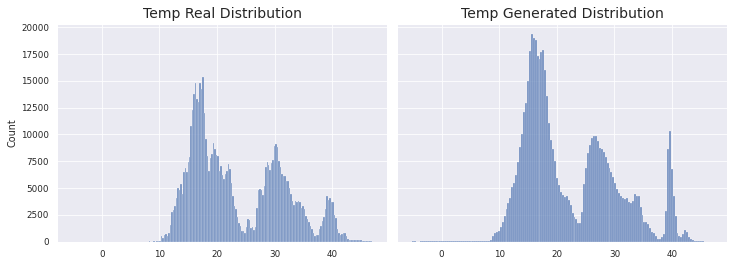

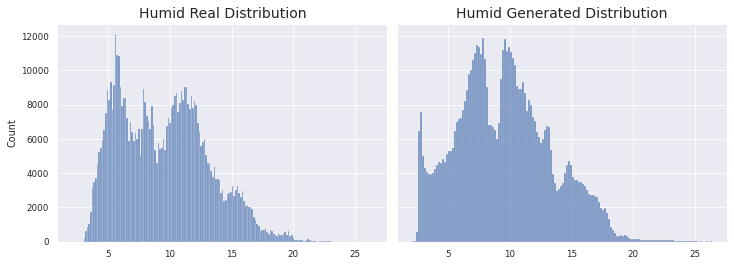

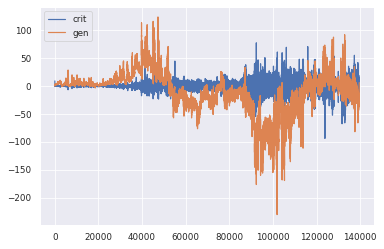

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.4777 - g_loss: -16.8205
Epoch 72/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0764 - g_loss: -28.3335

KL Divergence: 9.636846159613967 bits
Pinball Loss Temp mean: 0.8964093107543043
Pinball Loss Humid mean: 0.3979338978254493
MSE Temp: 1.7928186215086435
MSE Humid: 0.7958677956508917


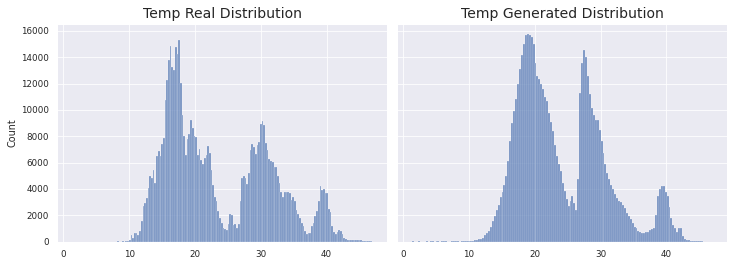

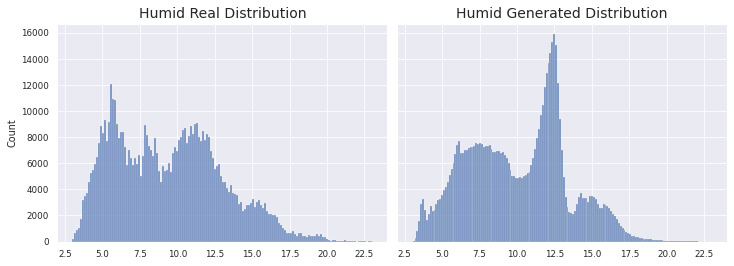

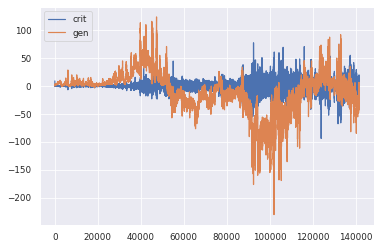

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0395 - g_loss: -28.3126
Epoch 73/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0046 - g_loss: -21.7579

KL Divergence: 4.720867772972606 bits
Pinball Loss Temp mean: 2.264409967703547
Pinball Loss Humid mean: 0.41723545787300403
MSE Temp: 4.528819935407065
MSE Humid: 0.8344709157460166


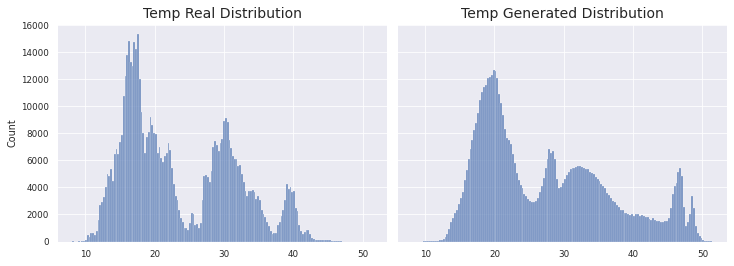

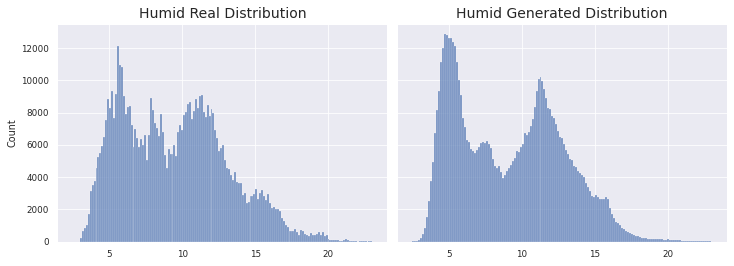

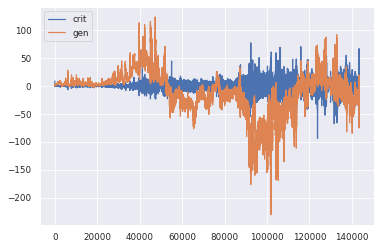

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0320 - g_loss: -21.7167
Epoch 74/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1799 - g_loss: -69.7250

KL Divergence: 2.5917150390280908 bits
Pinball Loss Temp mean: 0.6057919716443496
Pinball Loss Humid mean: 0.3222430270626448
MSE Temp: 1.2115839432886948
MSE Humid: 0.6444860541252917


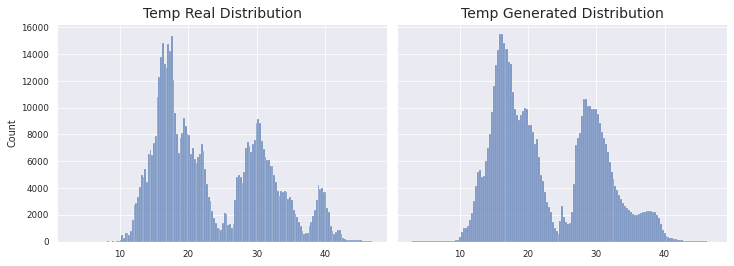

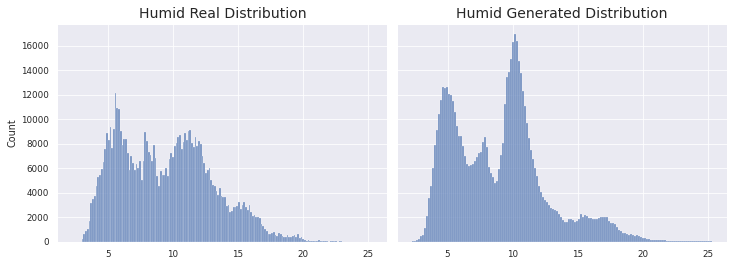

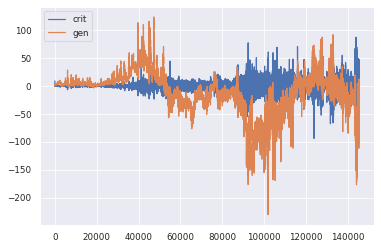

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.1632 - g_loss: -69.6633
Epoch 75/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0560 - g_loss: -47.2634

KL Divergence: 2.4586471044831972 bits
Pinball Loss Temp mean: 0.6920871013660956
Pinball Loss Humid mean: 0.2866707686054206
MSE Temp: 1.3841742027322093
MSE Humid: 0.5733415372108434


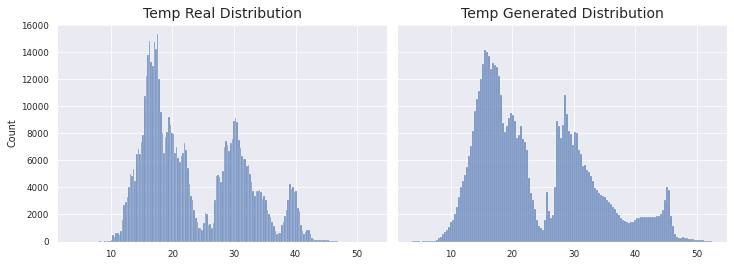

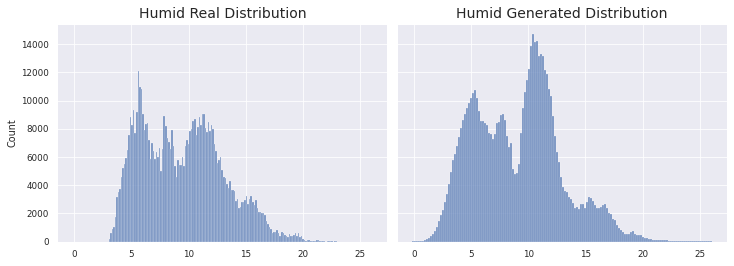

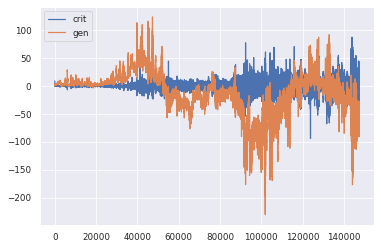

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0824 - g_loss: -47.2710
Epoch 76/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1342 - g_loss: -59.7382

KL Divergence: 4.918682317885997 bits
Pinball Loss Temp mean: 0.788099821846863
Pinball Loss Humid mean: 0.5236423585174917
MSE Temp: 1.5761996436937278
MSE Humid: 1.0472847170349702


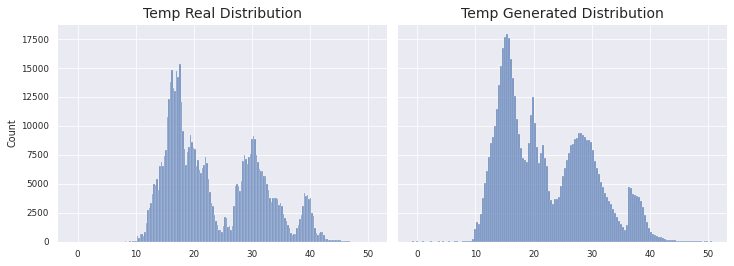

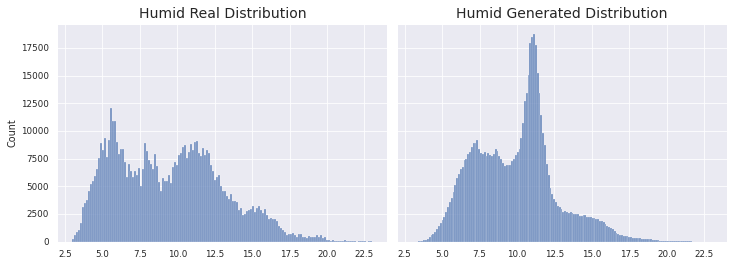

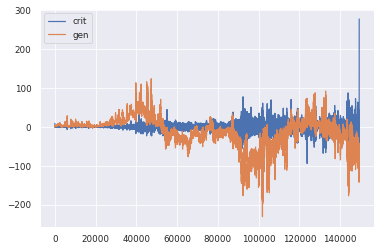

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1488 - g_loss: -59.7208
Epoch 77/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2143 - g_loss: -73.7046

KL Divergence: 3.2816543487973977 bits
Pinball Loss Temp mean: 0.9640350905392021
Pinball Loss Humid mean: 0.5582575674722369
MSE Temp: 1.928070181078445
MSE Humid: 1.1165151349444842


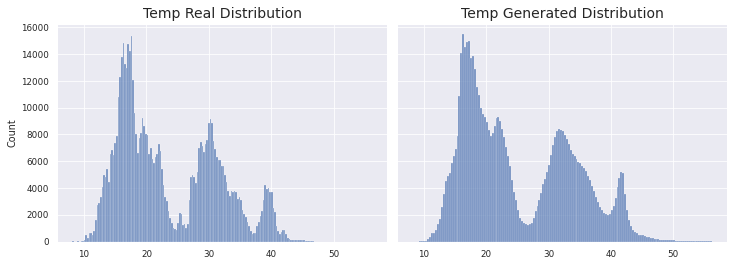

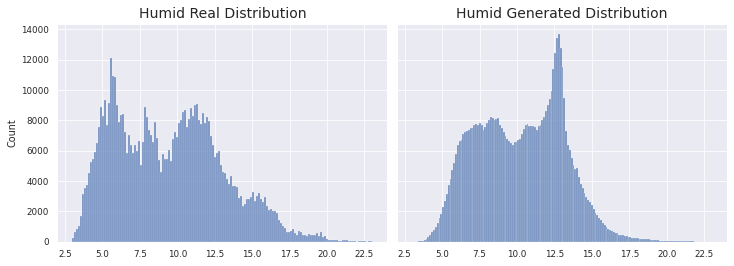

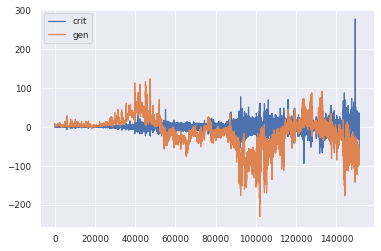

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1489 - g_loss: -73.7165
Epoch 78/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1099 - g_loss: -52.9656

KL Divergence: 3.883715498577123 bits
Pinball Loss Temp mean: 1.083742719683815
Pinball Loss Humid mean: 0.535021171050259
MSE Temp: 2.1674854393676357
MSE Humid: 1.070042342100517


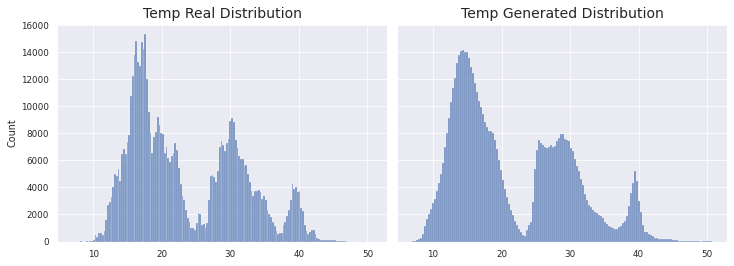

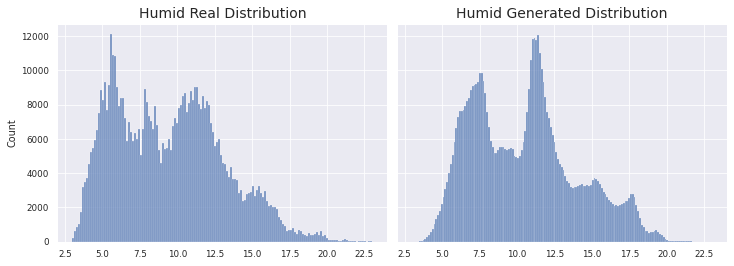

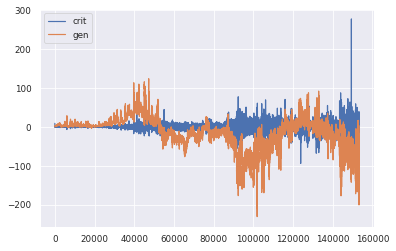

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.1292 - g_loss: -52.9084
Epoch 79/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1199 - g_loss: -61.4262

KL Divergence: 3.186012143454258 bits
Pinball Loss Temp mean: 0.7797493050672891
Pinball Loss Humid mean: 0.6427475822275127
MSE Temp: 1.5594986101346078
MSE Humid: 1.2854951644550103


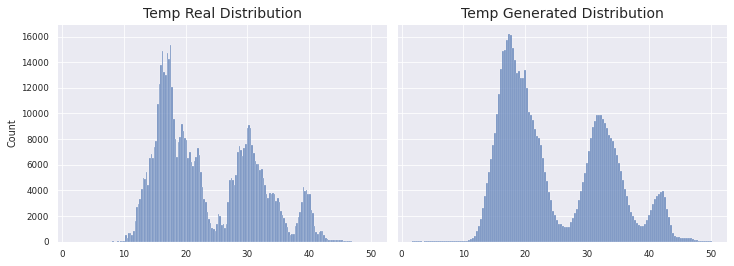

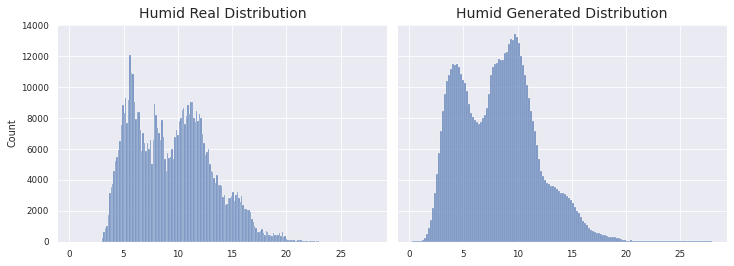

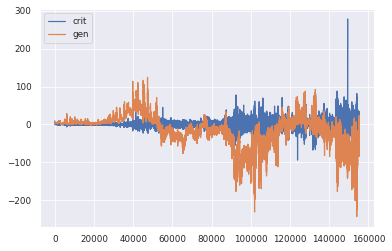

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1006 - g_loss: -61.3834
Epoch 80/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3031 - g_loss: -29.4913

KL Divergence: 5.450796308747173 bits
Pinball Loss Temp mean: 2.6117332846934245
Pinball Loss Humid mean: 1.078383129488468
MSE Temp: 5.223466569386903
MSE Humid: 2.1567662589769743


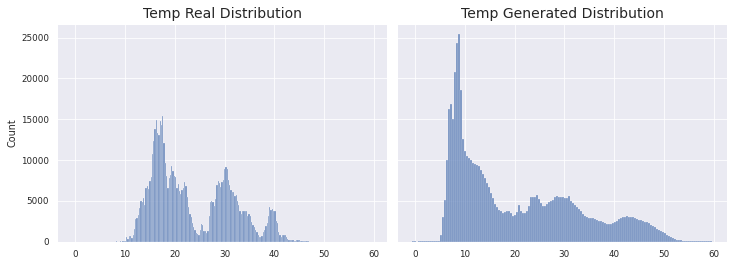

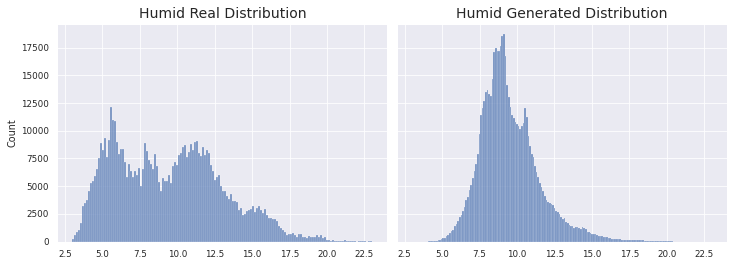

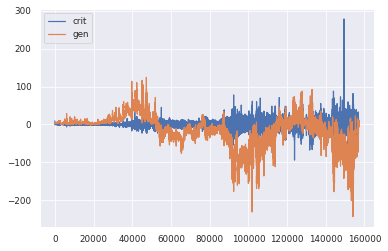

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.2979 - g_loss: -29.4548
Epoch 81/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3248 - g_loss: -16.9843

KL Divergence: 3.857460120389076 bits
Pinball Loss Temp mean: 0.9127138034757951
Pinball Loss Humid mean: 0.2761659349121387
MSE Temp: 1.8254276069516011
MSE Humid: 0.5523318698242649


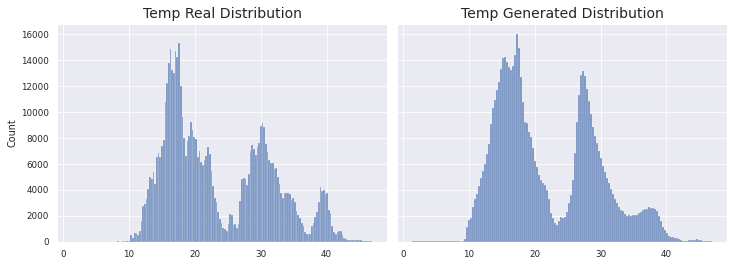

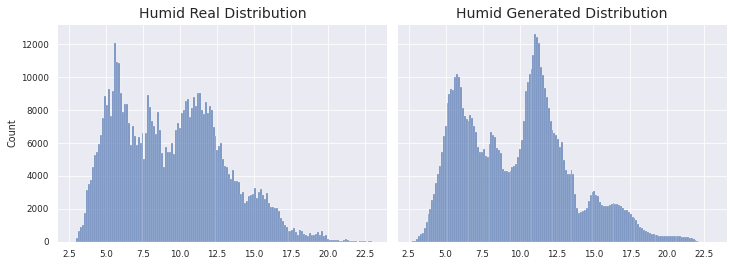

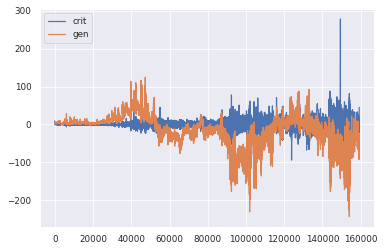

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.3705 - g_loss: -16.9927
Epoch 82/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2808 - g_loss: -31.0352

KL Divergence: 6.042503552277386 bits
Pinball Loss Temp mean: 2.7034341104222834
Pinball Loss Humid mean: 0.7864869364071888
MSE Temp: 5.406868220844578
MSE Humid: 1.5729738728143903


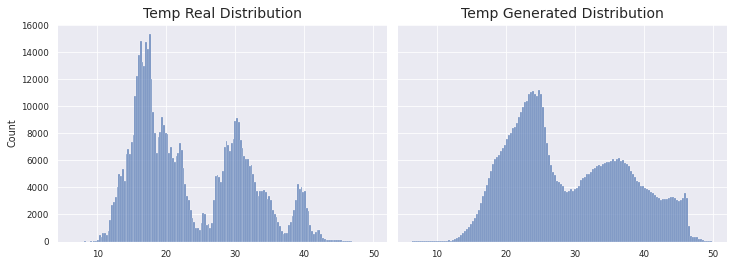

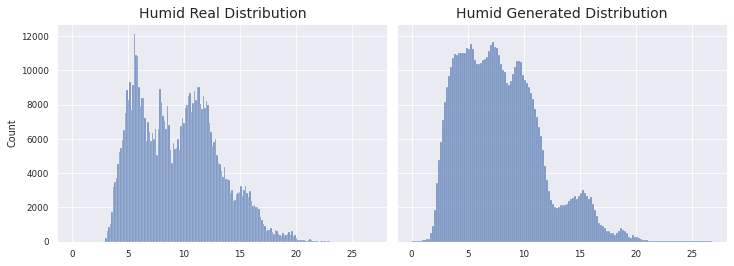

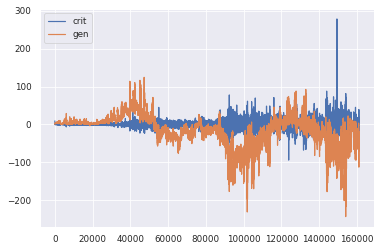

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2433 - g_loss: -31.0391
Epoch 83/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0701 - g_loss: -31.1653

KL Divergence: 3.450896797459351 bits
Pinball Loss Temp mean: 0.58438936550781
Pinball Loss Humid mean: 0.2973772287794206
MSE Temp: 1.1687787310156106
MSE Humid: 0.594754457558834


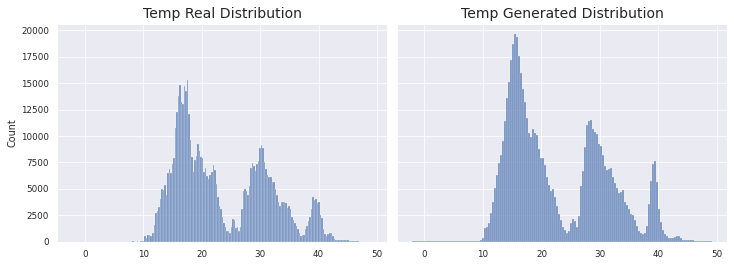

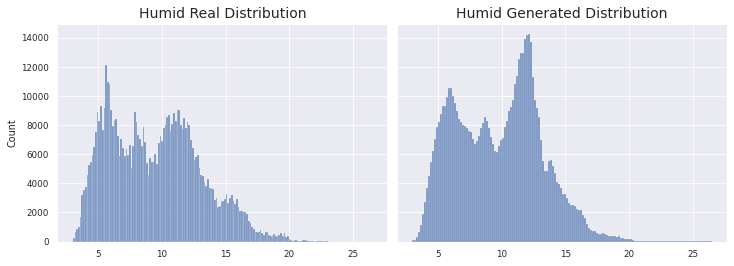

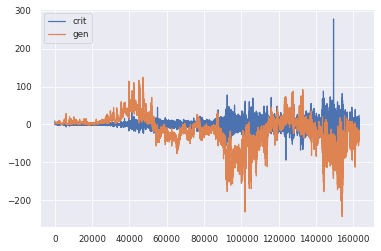

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0945 - g_loss: -31.1621
Epoch 84/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2501 - g_loss: -25.2318

KL Divergence: 17.349299807281312 bits
Pinball Loss Temp mean: 1.5218629170459423
Pinball Loss Humid mean: 0.7270051205885524
MSE Temp: 3.0437258340918962
MSE Humid: 1.4540102411771108


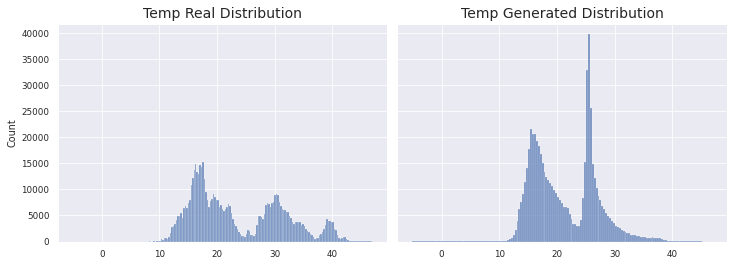

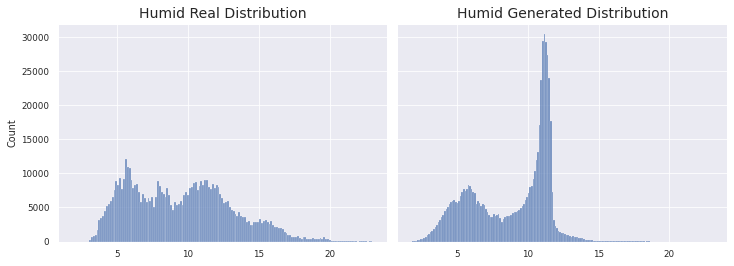

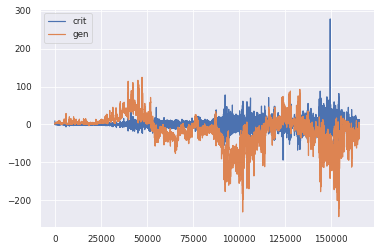

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2495 - g_loss: -25.2010
Epoch 85/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1160 - g_loss: -18.1279

KL Divergence: 6.188608057398064 bits
Pinball Loss Temp mean: 3.253063369316725
Pinball Loss Humid mean: 1.0557487562694507
MSE Temp: 6.506126738633402
MSE Humid: 2.111497512538886


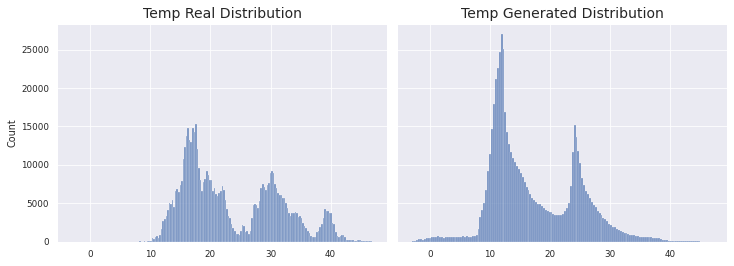

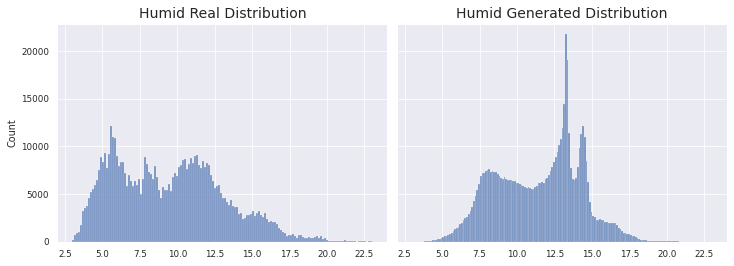

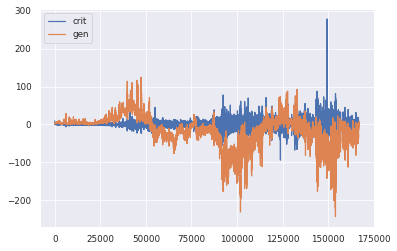

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.1167 - g_loss: -18.1138
Epoch 86/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1756 - g_loss: -5.7519

KL Divergence: 2.7347240593073443 bits
Pinball Loss Temp mean: 0.6111916972185271
Pinball Loss Humid mean: 0.25972132580118773
MSE Temp: 1.2223833944370681
MSE Humid: 0.5194426516023867


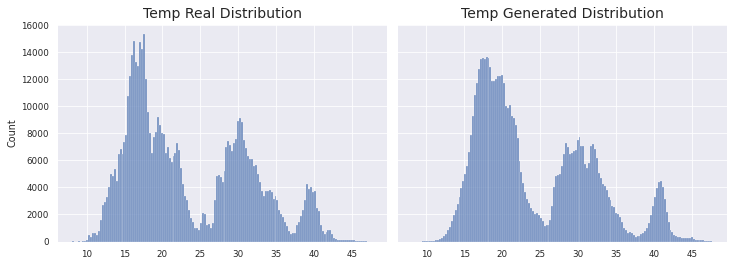

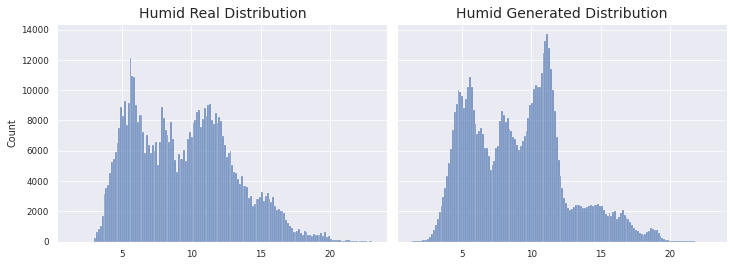

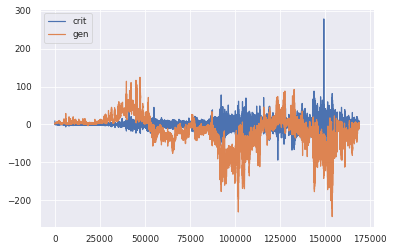

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1681 - g_loss: -5.7582
Epoch 87/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0462 - g_loss: -5.2375

KL Divergence: 4.498321655412126 bits
Pinball Loss Temp mean: 0.805385990643623
Pinball Loss Humid mean: 0.40770673051248674
MSE Temp: 1.6107719812872499
MSE Humid: 0.8154134610249638


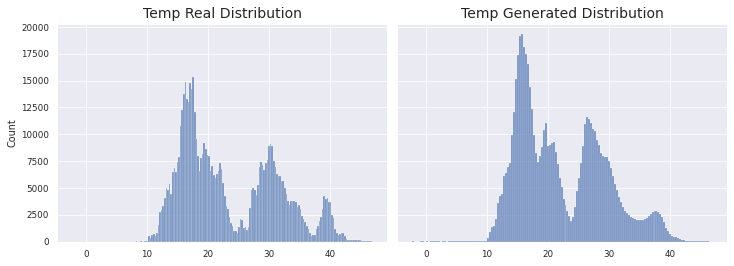

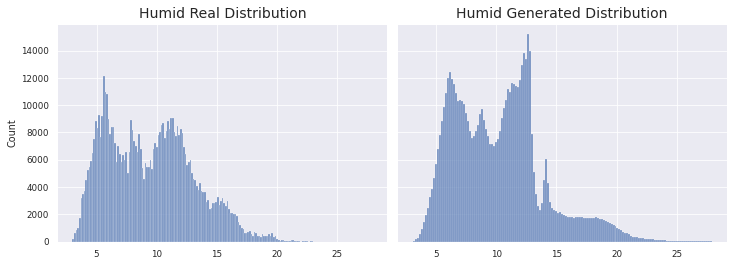

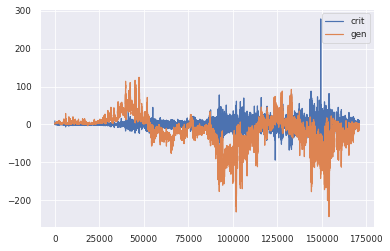

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0569 - g_loss: -5.2332
Epoch 88/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0342 - g_loss: -2.9270

KL Divergence: 2.4094283143409934 bits
Pinball Loss Temp mean: 1.118620839426007
Pinball Loss Humid mean: 0.3689628326192469
MSE Temp: 2.237241678851991
MSE Humid: 0.7379256652385023


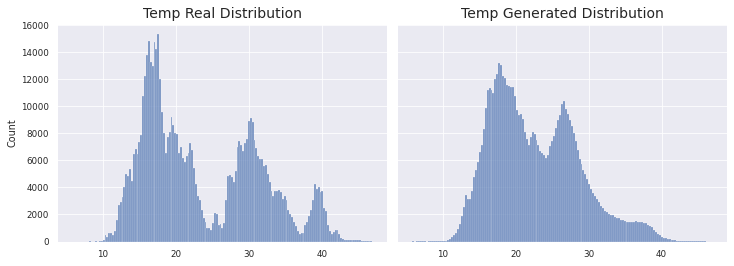

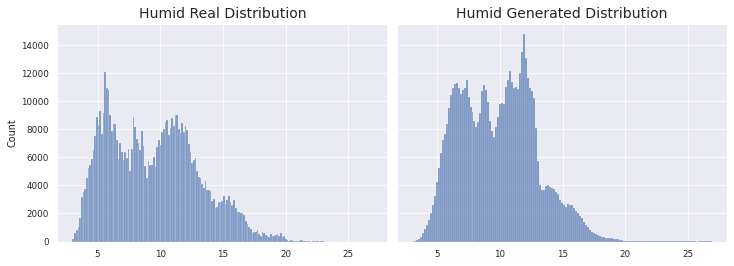

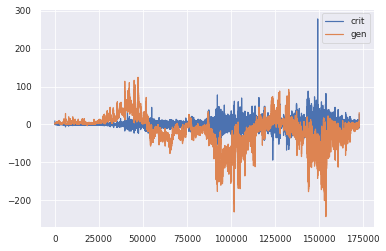

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0622 - g_loss: -2.8922
Epoch 89/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0096 - g_loss: 19.0911

KL Divergence: 6.50383588554908 bits
Pinball Loss Temp mean: 0.5295174931383426
Pinball Loss Humid mean: 0.4833310947603116
MSE Temp: 1.0590349862766757
MSE Humid: 0.966662189520613


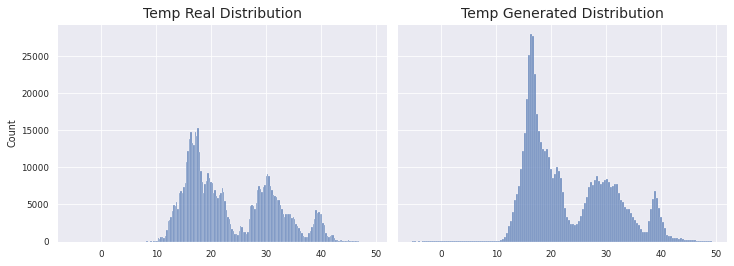

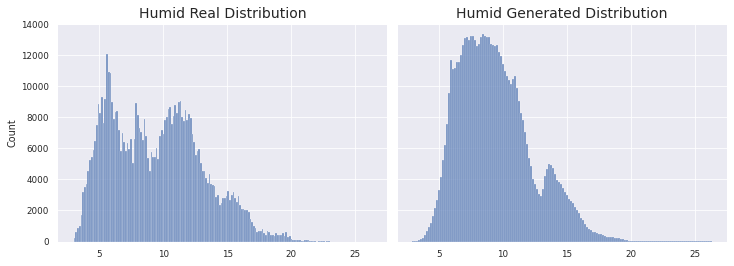

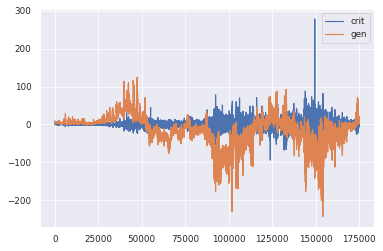

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0122 - g_loss: 19.0788
Epoch 90/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0668 - g_loss: 7.6580

KL Divergence: 7.39806493103375 bits
Pinball Loss Temp mean: 2.198159116361906
Pinball Loss Humid mean: 1.3056520515402923
MSE Temp: 4.39631823272382
MSE Humid: 2.6113041030805633


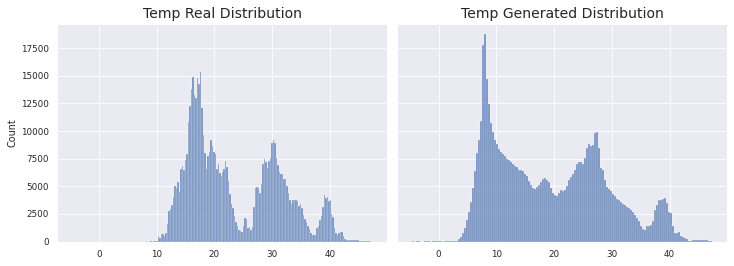

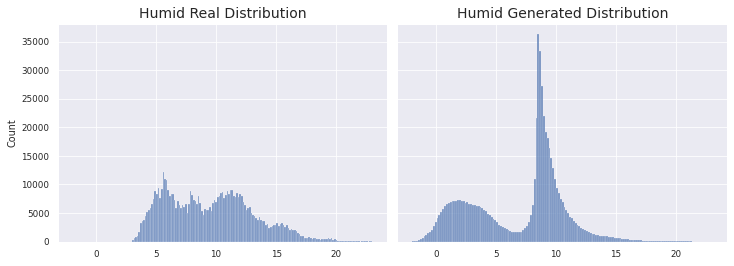

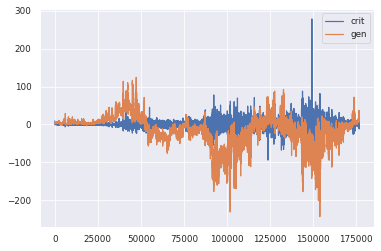

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0586 - g_loss: 7.6758
Epoch 91/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2061 - g_loss: 11.2956

KL Divergence: 8.430359516356223 bits
Pinball Loss Temp mean: 1.5389385645335698
Pinball Loss Humid mean: 0.9274963054757542
MSE Temp: 3.0778771290670974
MSE Humid: 1.8549926109515085


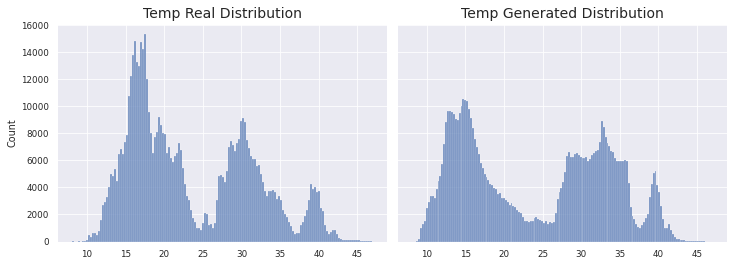

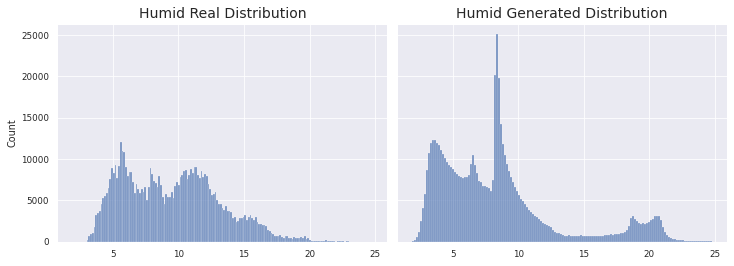

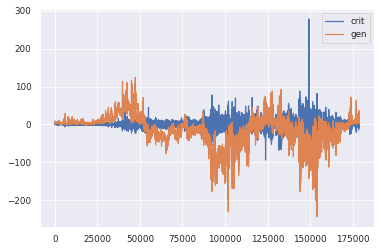

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2058 - g_loss: 11.2894
Epoch 92/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1931 - g_loss: 5.6543

KL Divergence: 17.14644401727665 bits
Pinball Loss Temp mean: 2.285272545133328
Pinball Loss Humid mean: 1.0150042174013714
MSE Temp: 4.570545090266515
MSE Humid: 2.0300084348027285


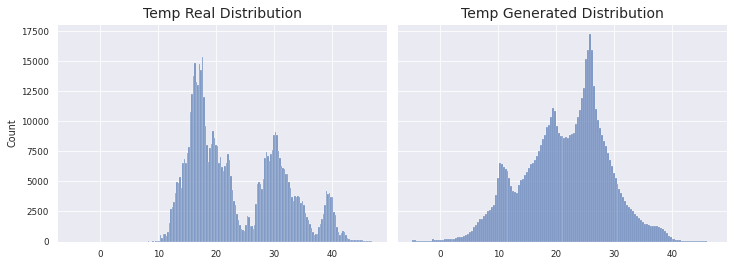

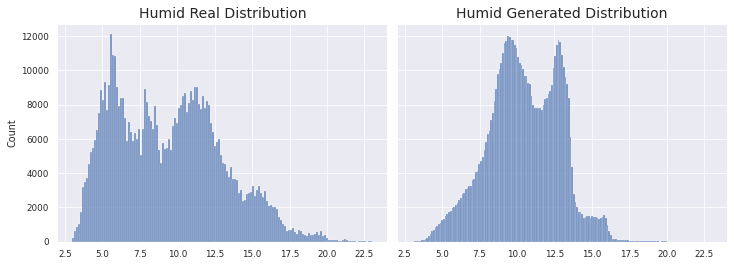

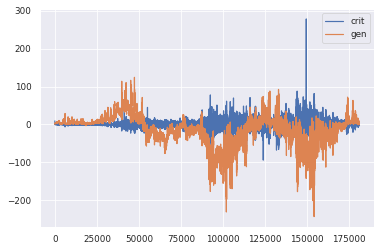

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1930 - g_loss: 5.6503
Epoch 93/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0893 - g_loss: 2.5392

KL Divergence: 6.1522035041892265 bits
Pinball Loss Temp mean: 0.5633095315405174
Pinball Loss Humid mean: 0.3495332946835984
MSE Temp: 1.1266190630810367
MSE Humid: 0.699066589367214


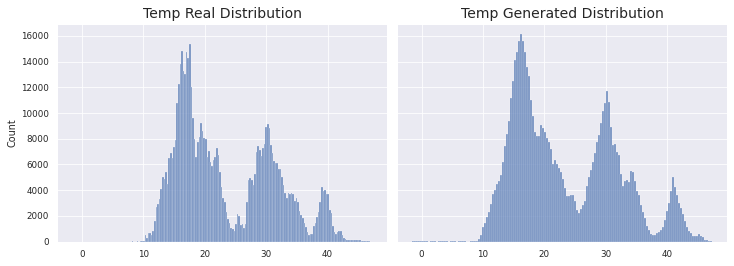

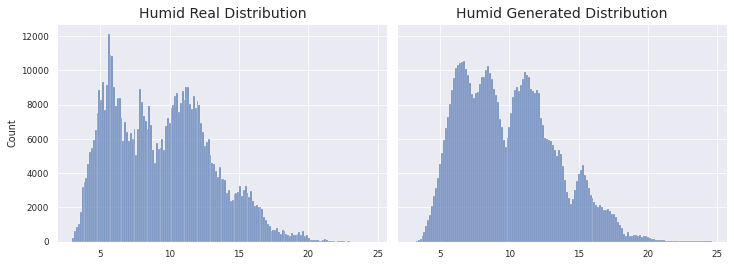

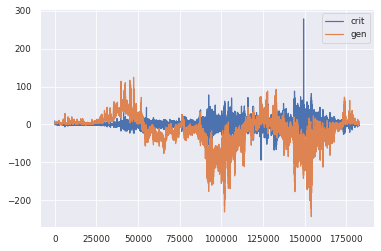

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0946 - g_loss: 2.5452
Epoch 94/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0633 - g_loss: 1.0836

KL Divergence: 7.840538117163041 bits
Pinball Loss Temp mean: 1.7066270601731457
Pinball Loss Humid mean: 1.1288017633856815
MSE Temp: 3.413254120346277
MSE Humid: 2.2576035267713945


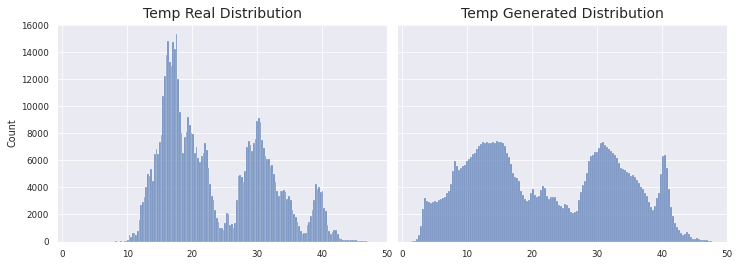

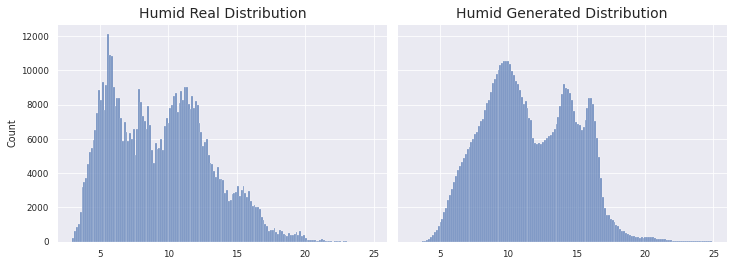

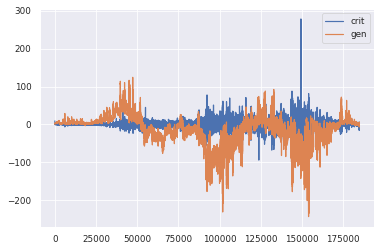

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0480 - g_loss: 1.0885
Epoch 95/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0817 - g_loss: 1.1814

KL Divergence: 2.160169660995921 bits
Pinball Loss Temp mean: 0.5991985149346573
Pinball Loss Humid mean: 0.4008042330257389
MSE Temp: 1.1983970298693176
MSE Humid: 0.8016084660514661


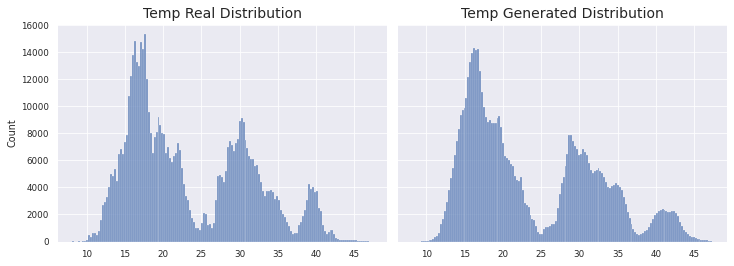

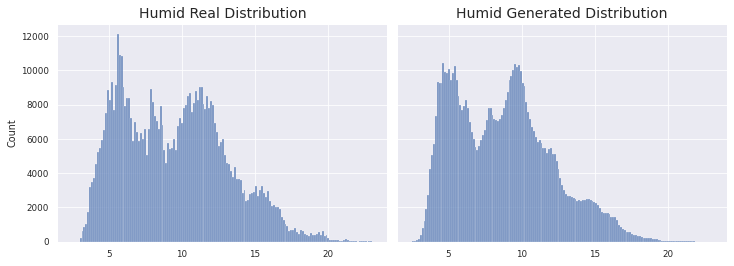

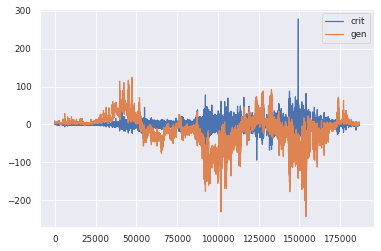

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0812 - g_loss: 1.1827
Epoch 96/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0990 - g_loss: 2.3249

KL Divergence: 2.1616253423851206 bits
Pinball Loss Temp mean: 0.6940481539544031
Pinball Loss Humid mean: 0.49646917336282587
MSE Temp: 1.3880963079088038
MSE Humid: 0.9929383467256633


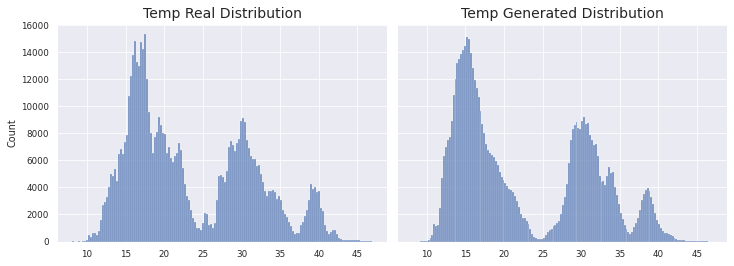

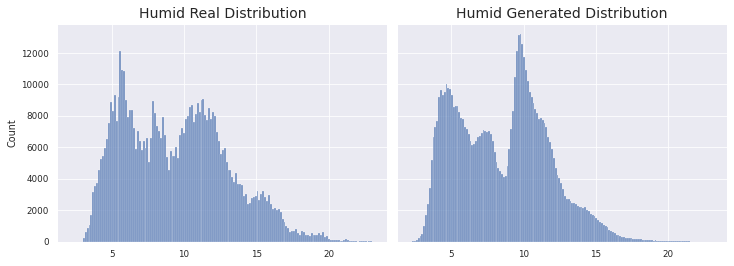

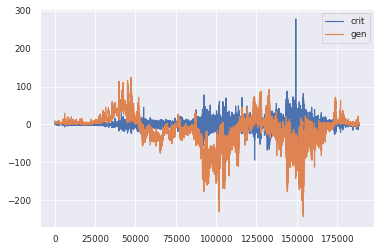

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0985 - g_loss: 2.3232
Epoch 97/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0857 - g_loss: 2.7550

KL Divergence: 10.51468014561453 bits
Pinball Loss Temp mean: 2.329813172337029
Pinball Loss Humid mean: 1.6307465162408363
MSE Temp: 4.659626344674074
MSE Humid: 3.2614930324816993


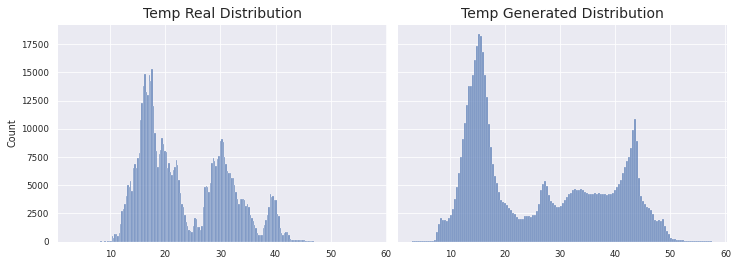

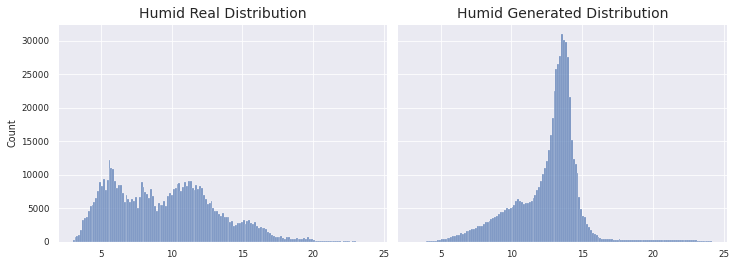

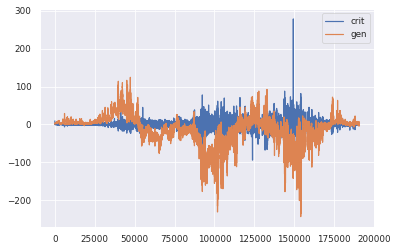

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0862 - g_loss: 2.7514
Epoch 98/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0489 - g_loss: 2.1205

KL Divergence: 10.867177198130465 bits
Pinball Loss Temp mean: 1.5170602067904937
Pinball Loss Humid mean: 1.089010255072778
MSE Temp: 3.034120413581052
MSE Humid: 2.1780205101455272


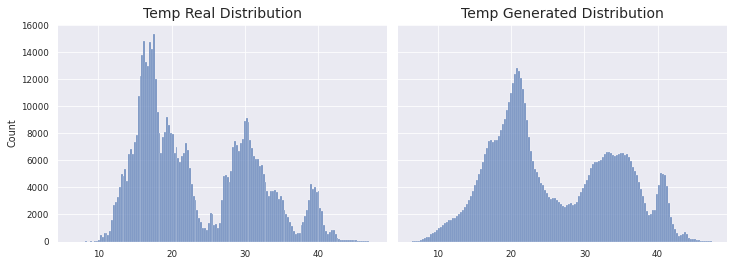

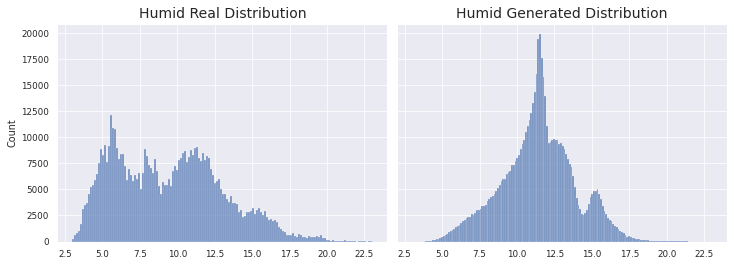

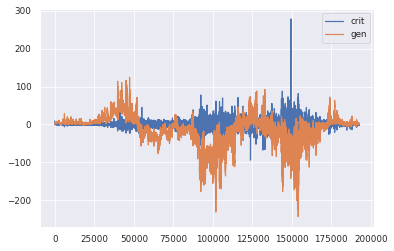

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0479 - g_loss: 2.1203
Epoch 99/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0539 - g_loss: 3.4539

KL Divergence: 3.9947750888268296 bits
Pinball Loss Temp mean: 0.8115380544677432
Pinball Loss Humid mean: 0.3463859117645096
MSE Temp: 1.623076108935479
MSE Humid: 0.6927718235290271


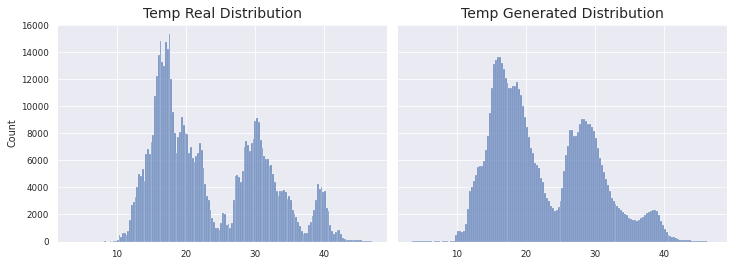

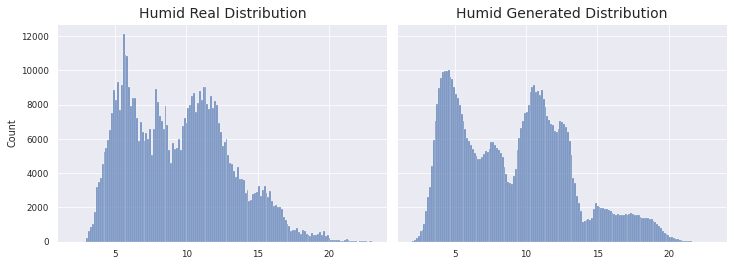

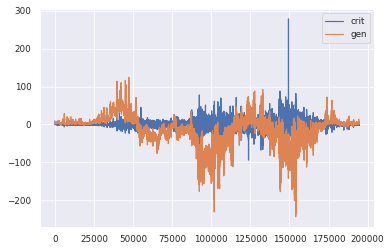

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0549 - g_loss: 3.4541
Epoch 100/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0614 - g_loss: 2.1748

KL Divergence: 11.617367165216217 bits
Pinball Loss Temp mean: 3.1478923315550538
Pinball Loss Humid mean: 2.105547481900272
MSE Temp: 6.29578466311004
MSE Humid: 4.211094963800579


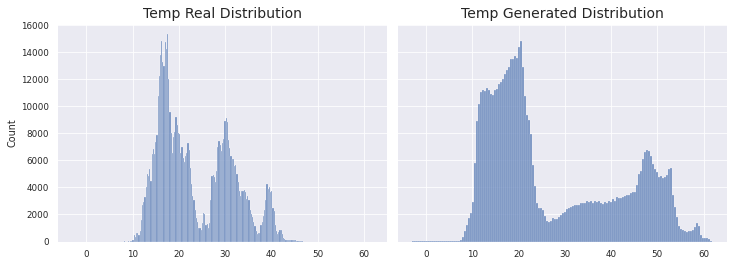

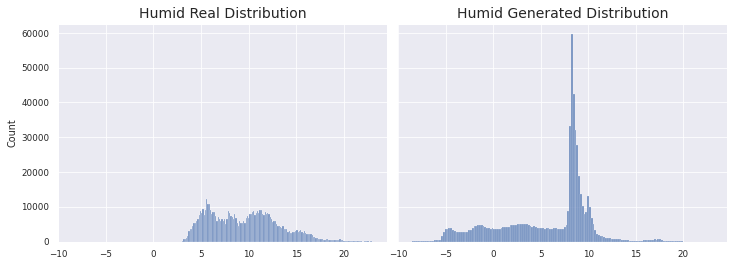

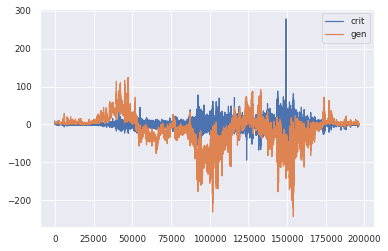

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0614 - g_loss: 2.1748
Epoch 101/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0633 - g_loss: 1.3058

KL Divergence: 5.6874929302343435 bits
Pinball Loss Temp mean: 0.8034423028648032
Pinball Loss Humid mean: 0.2863758536103866
MSE Temp: 1.6068846057296038
MSE Humid: 0.5727517072207713


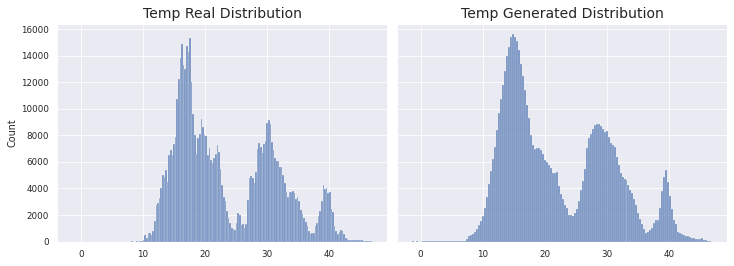

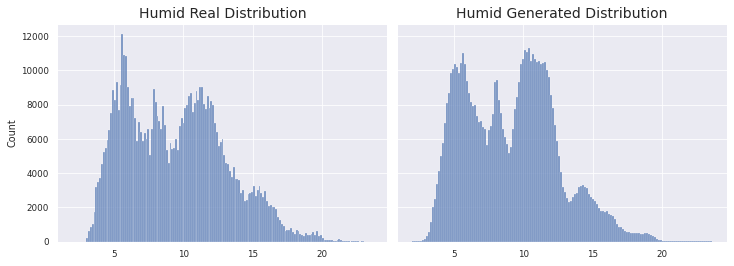

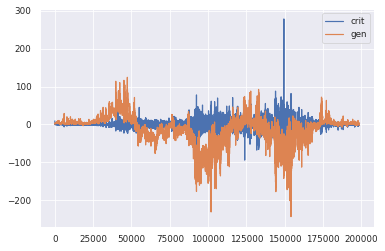

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0615 - g_loss: 1.3050
Epoch 102/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0577 - g_loss: 0.4996

KL Divergence: 13.978469435872778 bits
Pinball Loss Temp mean: 2.242384684194157
Pinball Loss Humid mean: 2.129288591982536
MSE Temp: 4.484769368388256
MSE Humid: 4.258577183965084


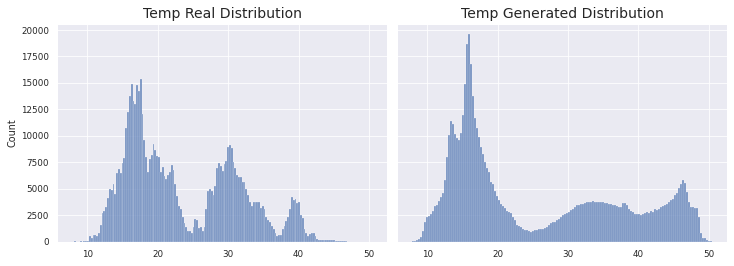

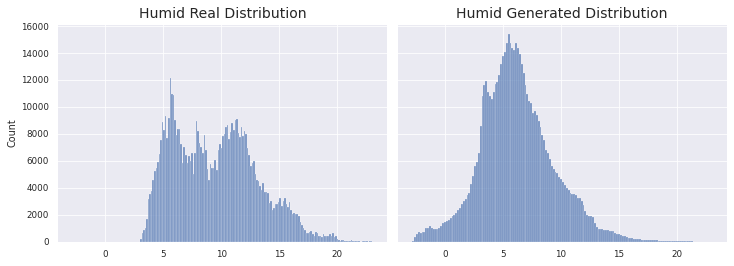

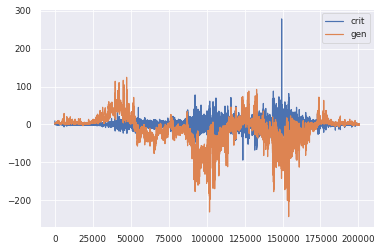

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0562 - g_loss: 0.4972
Epoch 103/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0409 - g_loss: 1.7554

KL Divergence: 9.618180279999093 bits
Pinball Loss Temp mean: 1.9517645709353175
Pinball Loss Humid mean: 1.4653881232422539
MSE Temp: 3.903529141870591
MSE Humid: 2.930776246484547


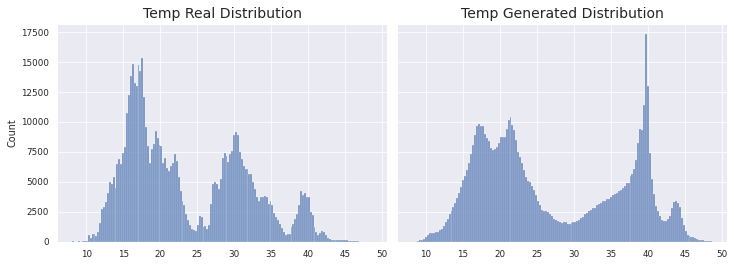

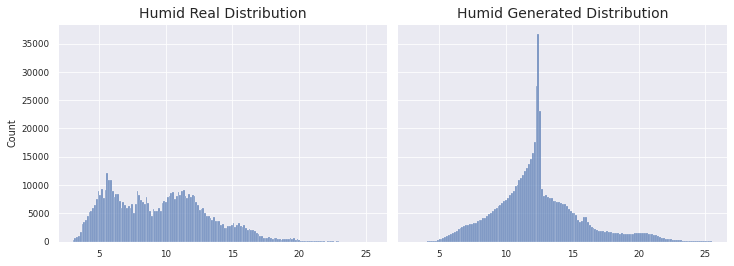

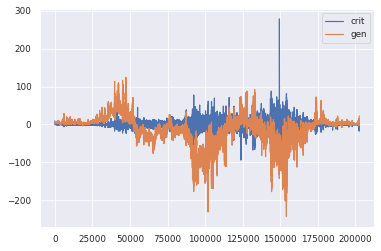

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0237 - g_loss: 1.7767
Epoch 104/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1233 - g_loss: 1.4383

KL Divergence: 4.608420459919963 bits
Pinball Loss Temp mean: 0.7826577720567496
Pinball Loss Humid mean: 0.43461241621429386
MSE Temp: 1.5653155441134794
MSE Humid: 0.8692248324285826


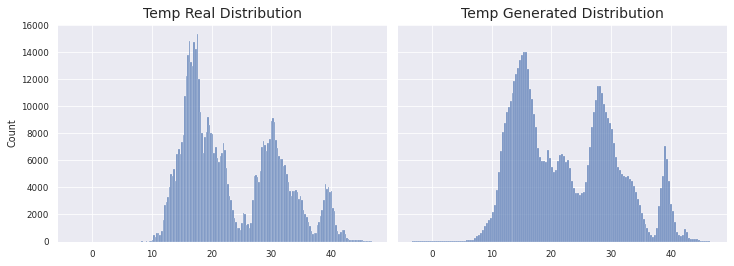

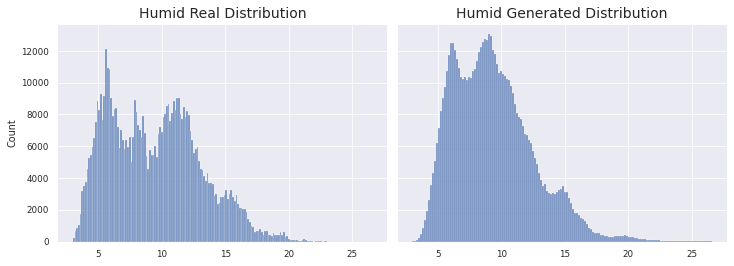

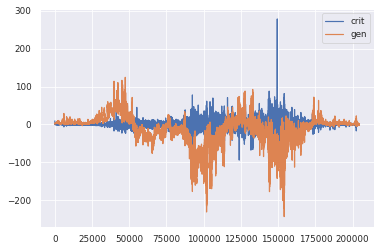

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1228 - g_loss: 1.4349
Epoch 105/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0345 - g_loss: -0.6067

KL Divergence: 6.6170443761293765 bits
Pinball Loss Temp mean: 1.1795073140886323
Pinball Loss Humid mean: 0.9513919002167416
MSE Temp: 2.3590146281772513
MSE Humid: 1.902783800433479


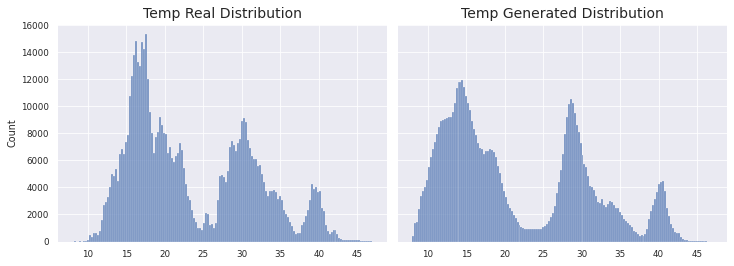

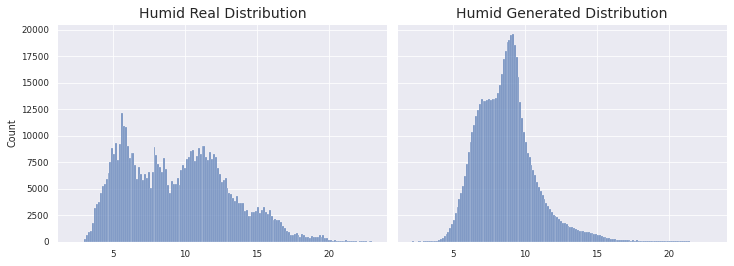

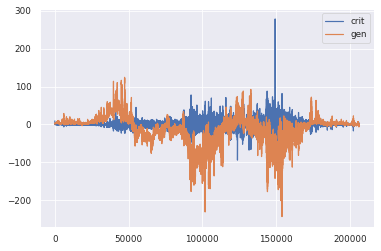

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0327 - g_loss: -0.6087
Epoch 106/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0247 - g_loss: -4.8922

KL Divergence: 7.039369390819057 bits
Pinball Loss Temp mean: 1.146359640008446
Pinball Loss Humid mean: 0.7626848703690392
MSE Temp: 2.2927192800168767
MSE Humid: 1.5253697407381026


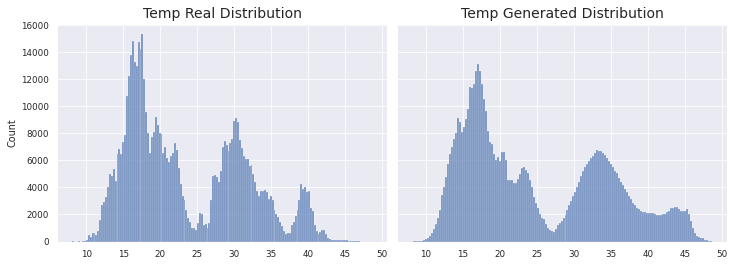

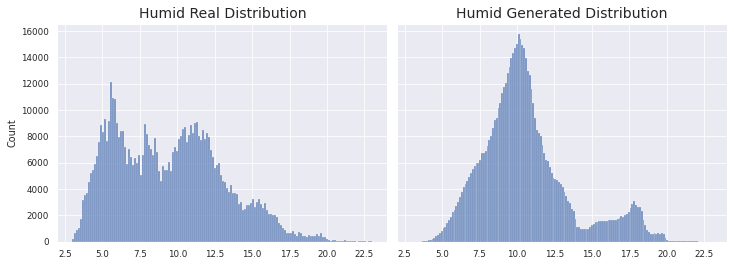

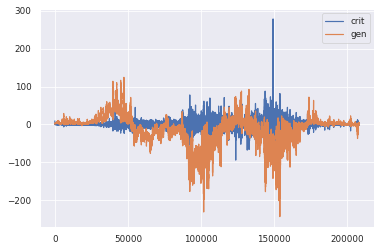

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0259 - g_loss: -4.8883
Epoch 107/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0544 - g_loss: -3.4312

KL Divergence: 8.76721778962787 bits
Pinball Loss Temp mean: 2.4236787167396656
Pinball Loss Humid mean: 1.6301970374156975
MSE Temp: 4.847357433479321
MSE Humid: 3.260394074831364


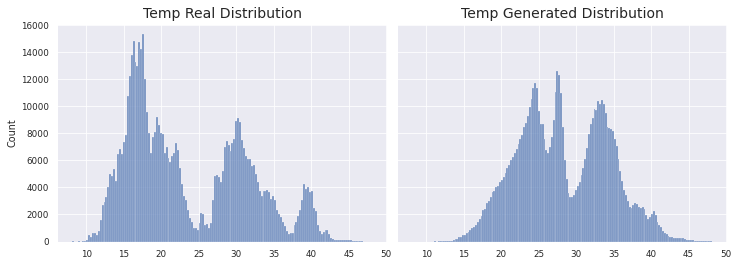

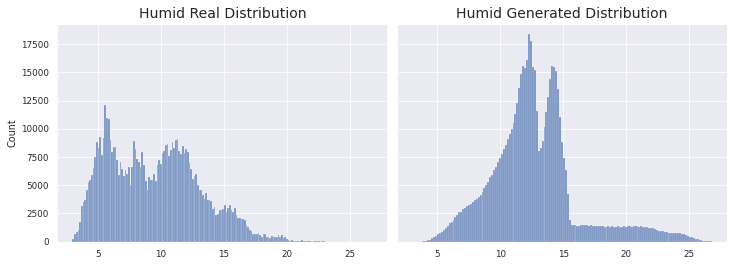

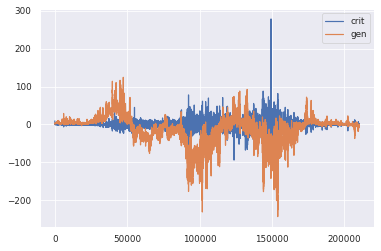

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0542 - g_loss: -3.4306
Epoch 108/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0651 - g_loss: -2.8053

KL Divergence: 4.482040071982601 bits
Pinball Loss Temp mean: 0.9357083102557662
Pinball Loss Humid mean: 0.965276586138959
MSE Temp: 1.8714166205115719
MSE Humid: 1.9305531722779412


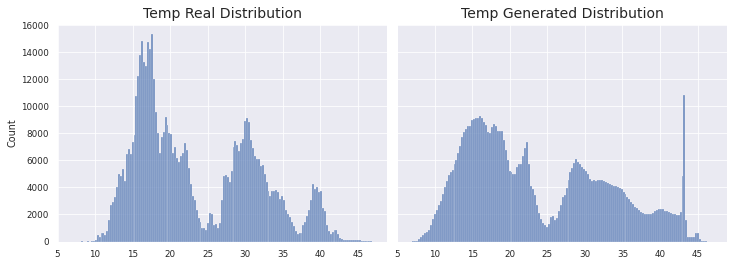

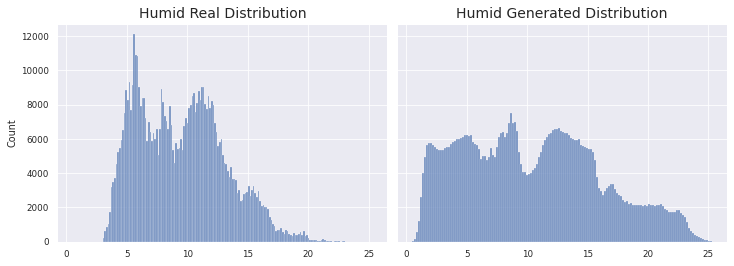

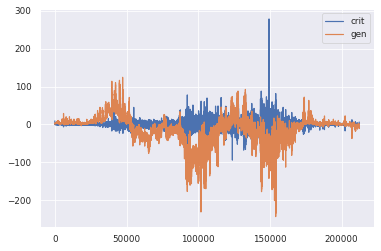

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0715 - g_loss: -2.8127
Epoch 109/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0532 - g_loss: -1.2048

KL Divergence: 5.908890679678535 bits
Pinball Loss Temp mean: 2.4097761202777326
Pinball Loss Humid mean: 2.2250838822606953
MSE Temp: 4.8195522405555
MSE Humid: 4.450167764521417


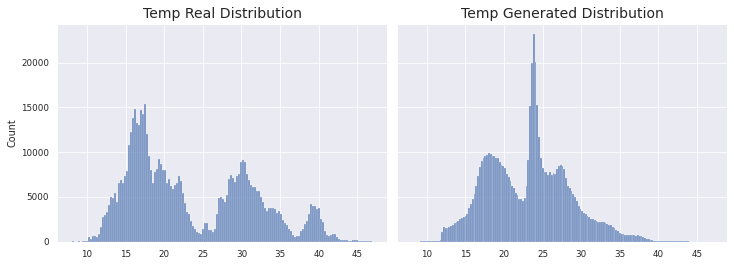

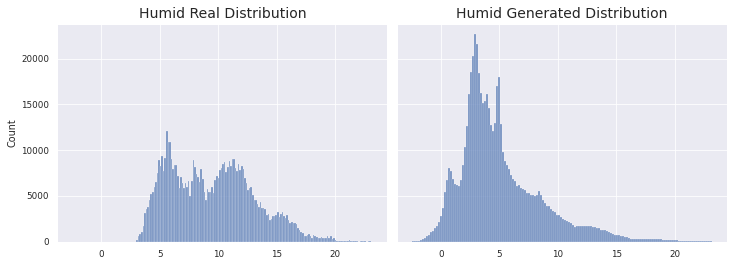

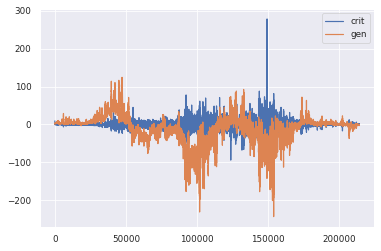

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0537 - g_loss: -1.2065
Epoch 110/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0681 - g_loss: -1.0005

KL Divergence: 3.6482479761953797 bits
Pinball Loss Temp mean: 0.8428201089885725
Pinball Loss Humid mean: 0.5314806806565598
MSE Temp: 1.6856402179771517
MSE Humid: 1.062961361313115


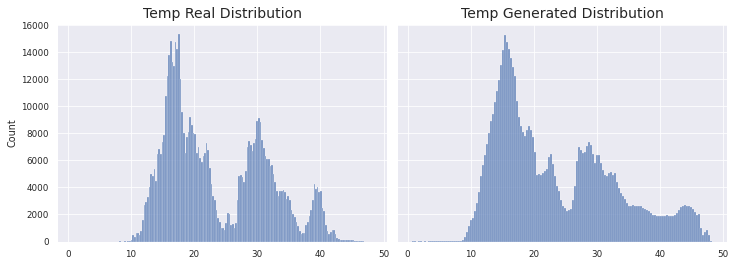

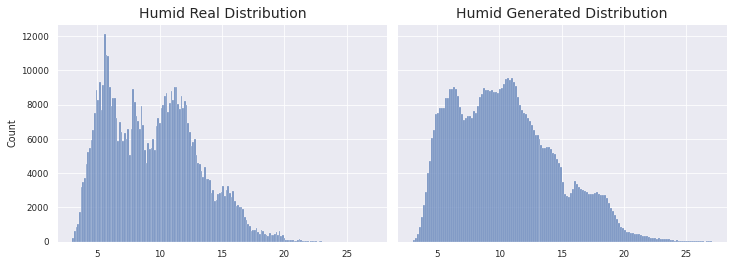

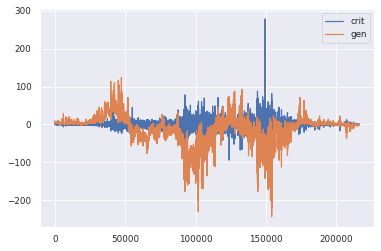

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0681 - g_loss: -0.9986
Epoch 111/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0552 - g_loss: 0.5886

KL Divergence: 3.332904459358274 bits
Pinball Loss Temp mean: 2.8731478028009825
Pinball Loss Humid mean: 2.5199425689794754
MSE Temp: 5.746295605602055
MSE Humid: 5.039885137958931


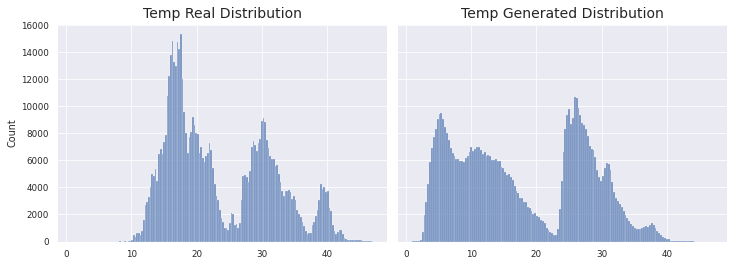

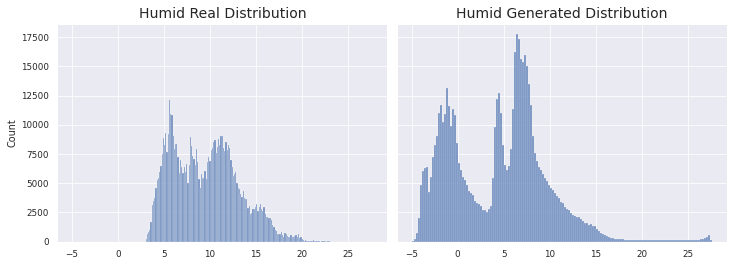

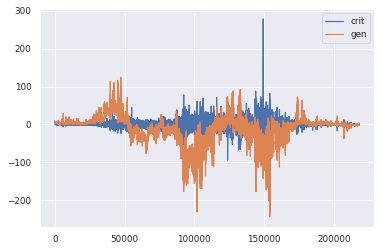

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0568 - g_loss: 0.5872
Epoch 112/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0458 - g_loss: -0.2350

KL Divergence: 4.0165658384976375 bits
Pinball Loss Temp mean: 1.1179724037442973
Pinball Loss Humid mean: 0.3184069233415857
MSE Temp: 2.2359448074885977
MSE Humid: 0.6368138466831715


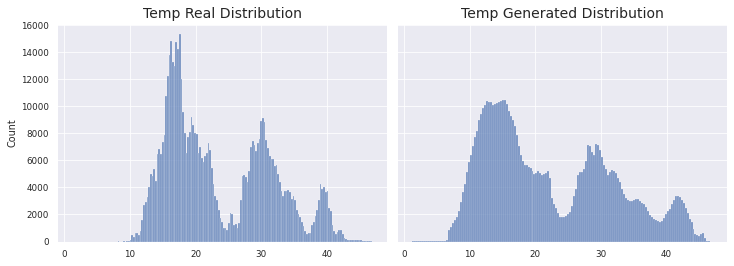

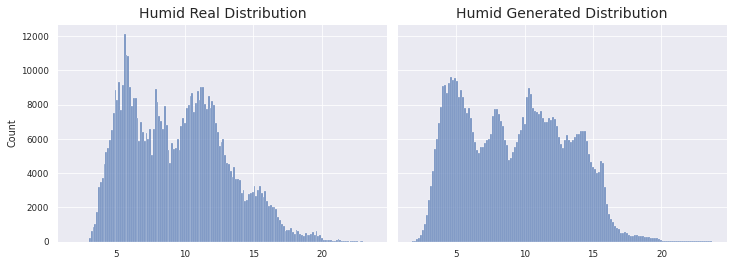

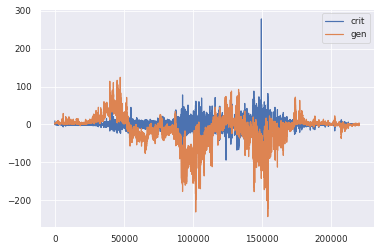

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0452 - g_loss: -0.2376
Epoch 113/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0547 - g_loss: -3.6723

KL Divergence: 8.229248720917848 bits
Pinball Loss Temp mean: 1.2091127978032774
Pinball Loss Humid mean: 1.799586092419752
MSE Temp: 2.4182255956065513
MSE Humid: 3.5991721848395337


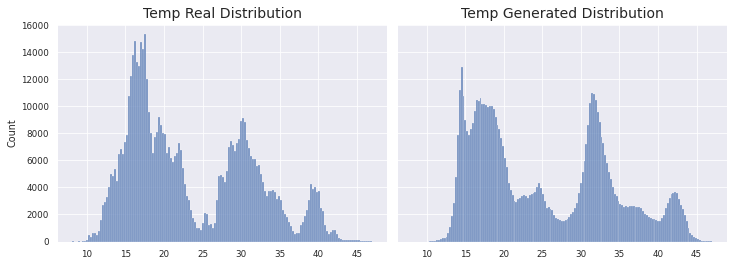

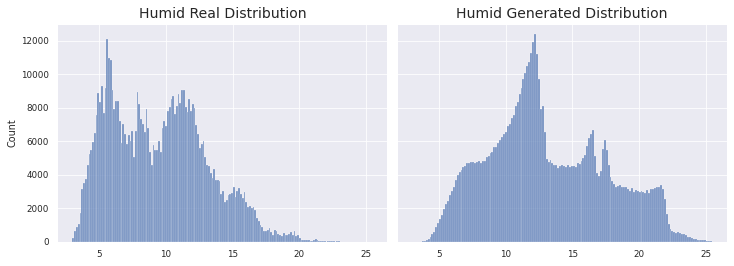

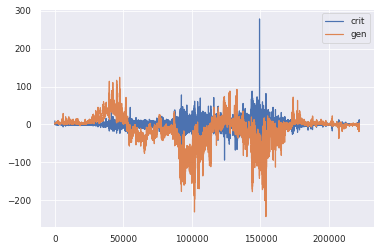

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0668 - g_loss: -3.6727
Epoch 114/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0477 - g_loss: -5.5599

KL Divergence: 9.498271845364906 bits
Pinball Loss Temp mean: 3.179027755411096
Pinball Loss Humid mean: 2.5645085964244396
MSE Temp: 6.3580555108221555
MSE Humid: 5.129017192848971


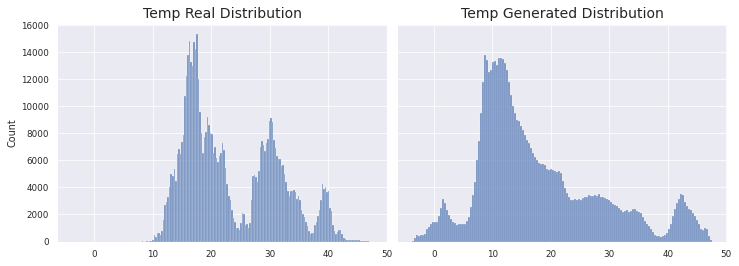

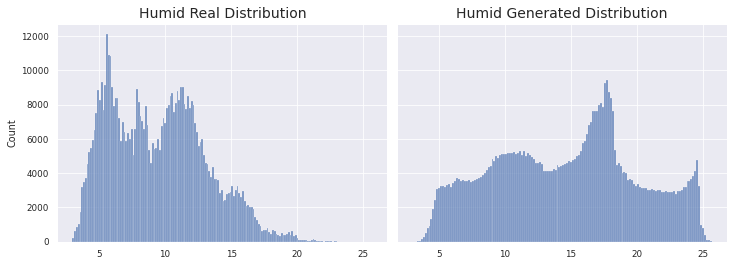

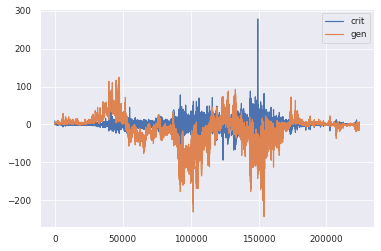

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0471 - g_loss: -5.5479
Epoch 115/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0886 - g_loss: -1.7246

KL Divergence: 2.6066775488131086 bits
Pinball Loss Temp mean: 0.8830095619897771
Pinball Loss Humid mean: 0.24905146032204292
MSE Temp: 1.766019123979587
MSE Humid: 0.49810292064408407


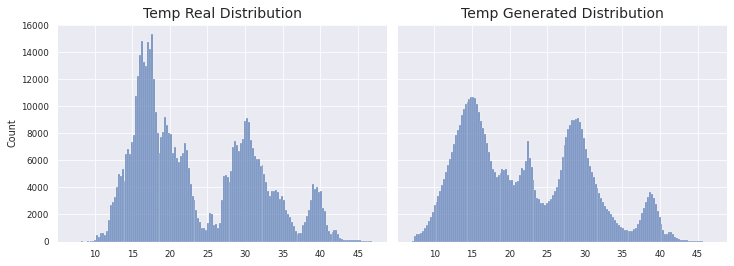

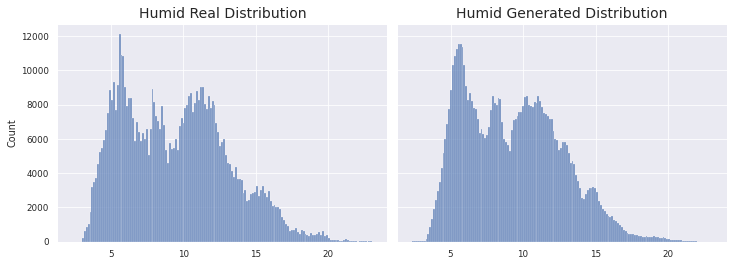

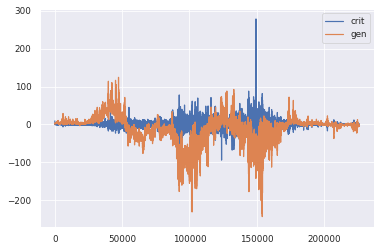

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0879 - g_loss: -1.7250
Epoch 116/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0515 - g_loss: -3.0614

KL Divergence: 3.8882062621208457 bits
Pinball Loss Temp mean: 0.900388955320549
Pinball Loss Humid mean: 0.4680694822293899
MSE Temp: 1.800777910641111
MSE Humid: 0.9361389644587643


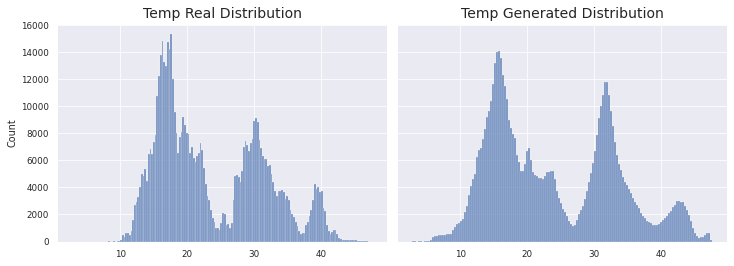

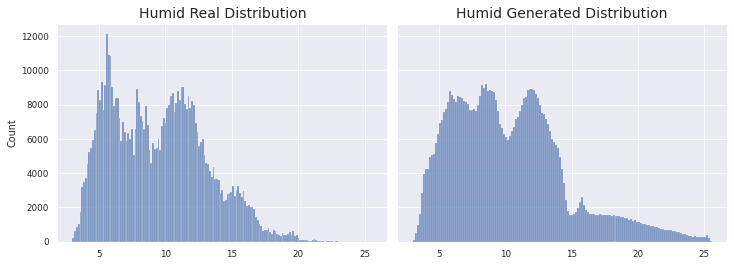

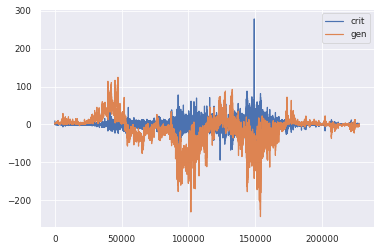

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.0515 - g_loss: -3.0583
Epoch 117/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0636 - g_loss: -2.9850

KL Divergence: 5.420365390480435 bits
Pinball Loss Temp mean: 1.6453059891415909
Pinball Loss Humid mean: 0.33971390655928174
MSE Temp: 3.2906119782831658
MSE Humid: 0.6794278131185696


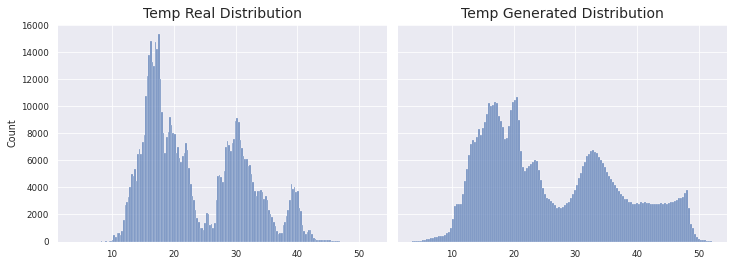

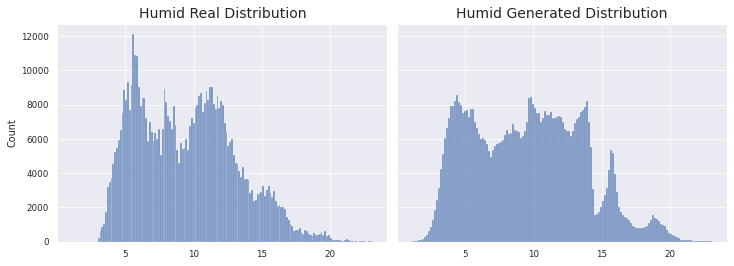

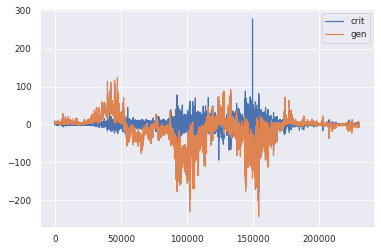

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0648 - g_loss: -2.9873
Epoch 118/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0396 - g_loss: -3.1187

KL Divergence: 7.896682974274599 bits
Pinball Loss Temp mean: 7.705481466917649
Pinball Loss Humid mean: 1.9252901500599677
MSE Temp: 15.410962933835318
MSE Humid: 3.8505803001199403


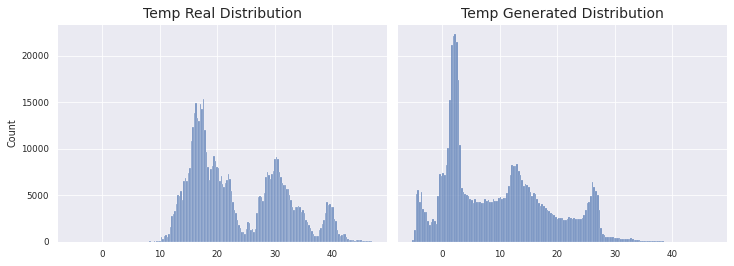

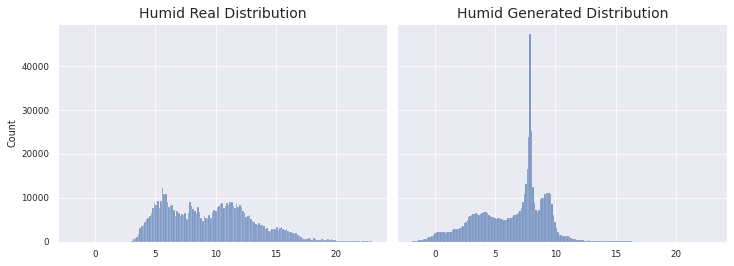

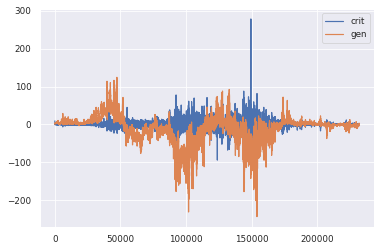

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0400 - g_loss: -3.1135
Epoch 119/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0657 - g_loss: -1.6643

KL Divergence: 21.868453278606736 bits
Pinball Loss Temp mean: 0.8662274991344759
Pinball Loss Humid mean: 0.6898686324189999
MSE Temp: 1.7324549982689492
MSE Humid: 1.3797372648380055


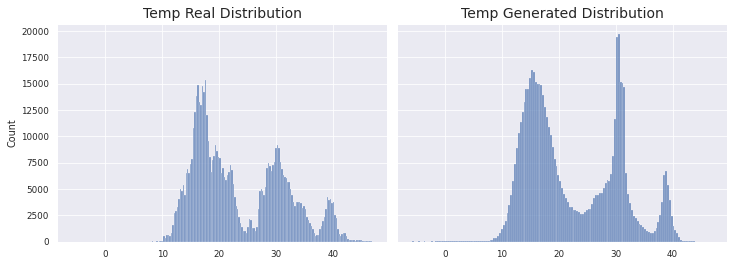

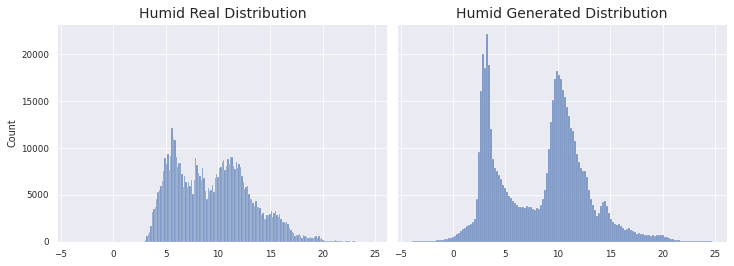

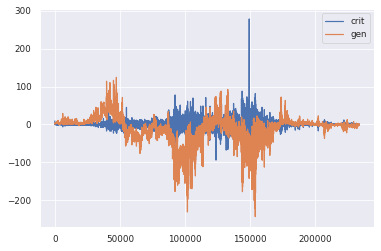

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0658 - g_loss: -1.6634
Epoch 120/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0066 - g_loss: -1.2643

KL Divergence: 11.435466736431817 bits
Pinball Loss Temp mean: 1.0397696182781588
Pinball Loss Humid mean: 0.47921428884369777
MSE Temp: 2.0795392365563106
MSE Humid: 0.9584285776874103


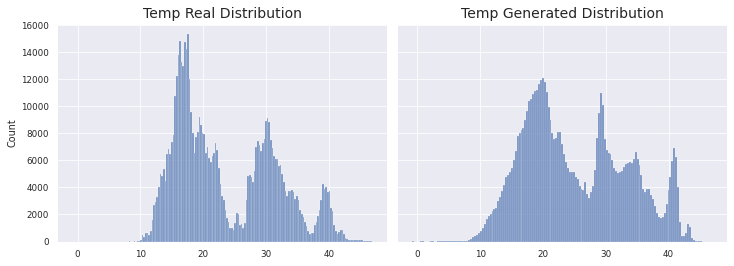

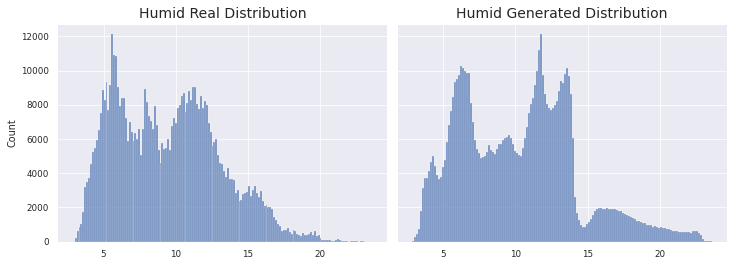

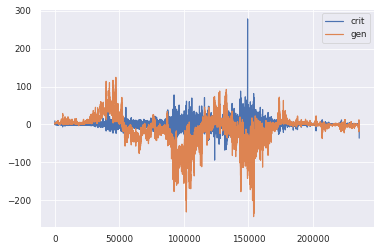

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0300 - g_loss: -1.2794
Epoch 121/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0882 - g_loss: -6.0983

KL Divergence: 13.016587427834132 bits
Pinball Loss Temp mean: 0.9579747018338383
Pinball Loss Humid mean: 0.3344243651981141
MSE Temp: 1.9159494036676614
MSE Humid: 0.6688487303962355


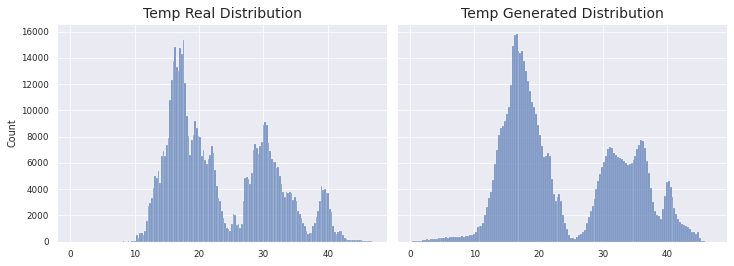

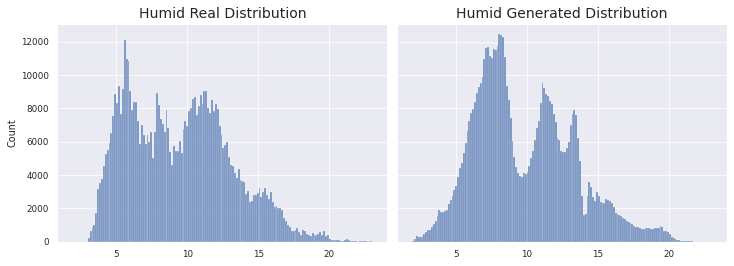

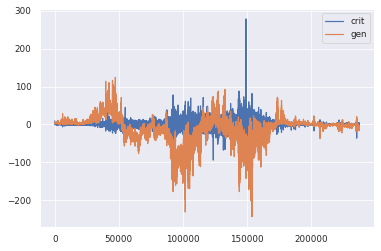

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0850 - g_loss: -6.1004
Epoch 122/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1040 - g_loss: 0.3601

KL Divergence: 4.592944007236397 bits
Pinball Loss Temp mean: 1.1373364411339344
Pinball Loss Humid mean: 0.8006133421472764
MSE Temp: 2.274672882267885
MSE Humid: 1.6012266842945595


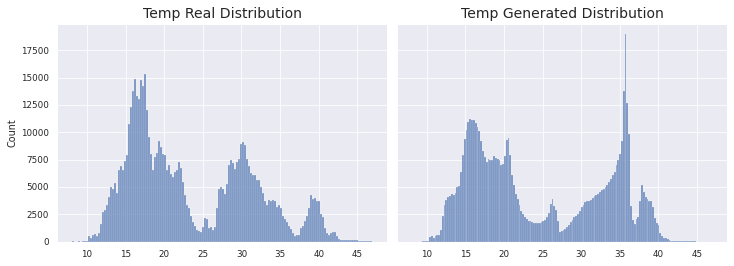

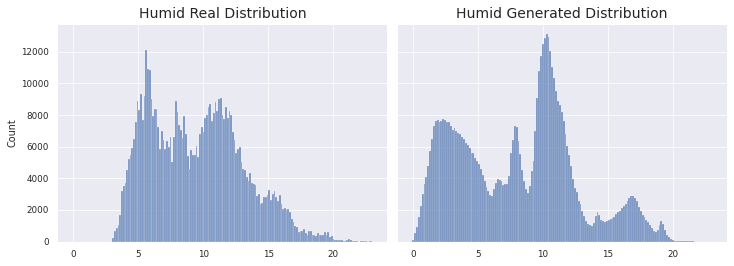

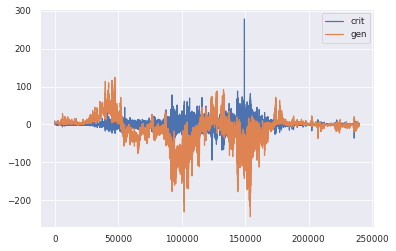

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1040 - g_loss: 0.3539
Epoch 123/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0817 - g_loss: 0.9173

KL Divergence: 7.8424655130798975 bits
Pinball Loss Temp mean: 1.3590539171489542
Pinball Loss Humid mean: 0.8590338299528872
MSE Temp: 2.7181078342978946
MSE Humid: 1.718067659905772


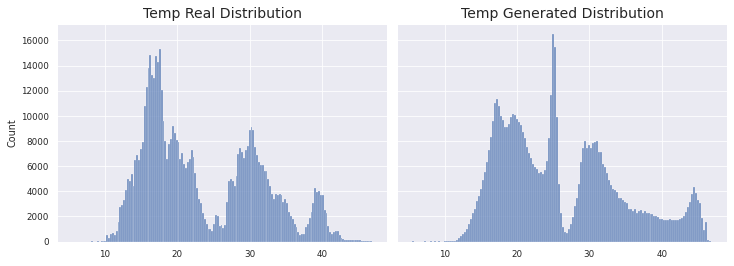

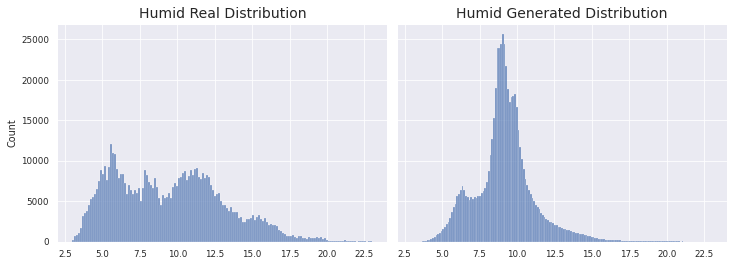

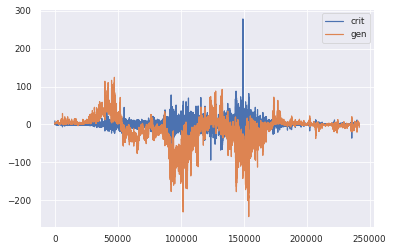

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0806 - g_loss: 0.9082
Epoch 124/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0708 - g_loss: 0.3955

KL Divergence: 1.444322543618253 bits
Pinball Loss Temp mean: 0.6960209985275474
Pinball Loss Humid mean: 0.6720207037185735
MSE Temp: 1.392041997055066
MSE Humid: 1.3440414074371636


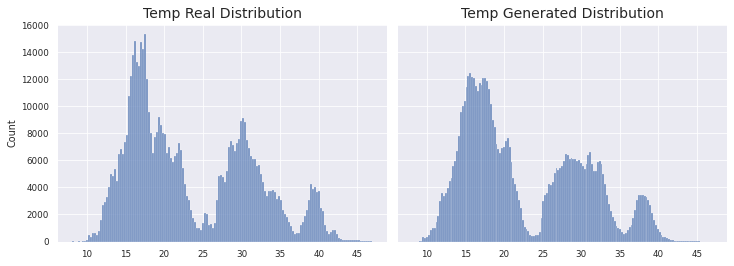

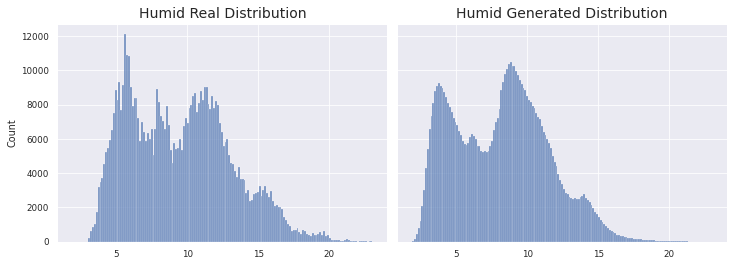

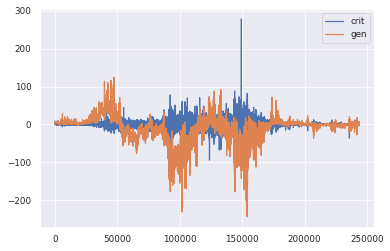

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0691 - g_loss: 0.4008
Epoch 125/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0616 - g_loss: 0.5672

KL Divergence: 4.806546522320941 bits
Pinball Loss Temp mean: 1.2787945621892027
Pinball Loss Humid mean: 1.5354176116548537
MSE Temp: 2.55758912437841
MSE Humid: 3.0708352233097247


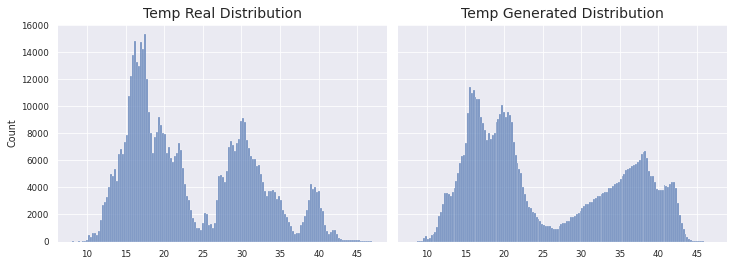

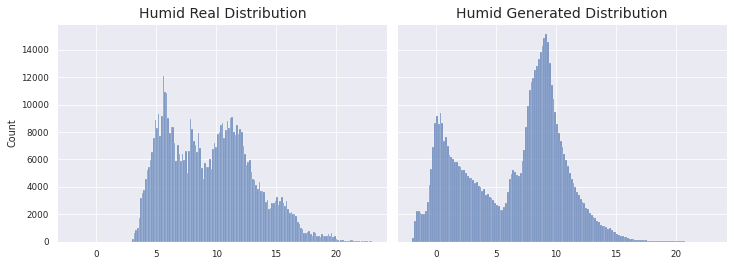

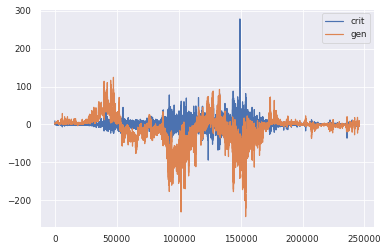

1966/1966 [==============================] - 129s 66ms/step - d_loss: 0.0654 - g_loss: 0.5705
Epoch 126/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0758 - g_loss: -1.8090

KL Divergence: 7.653434339235948 bits
Pinball Loss Temp mean: 1.969073943868341
Pinball Loss Humid mean: 0.4565797325984179
MSE Temp: 3.9381478877366987
MSE Humid: 0.9131594651968468


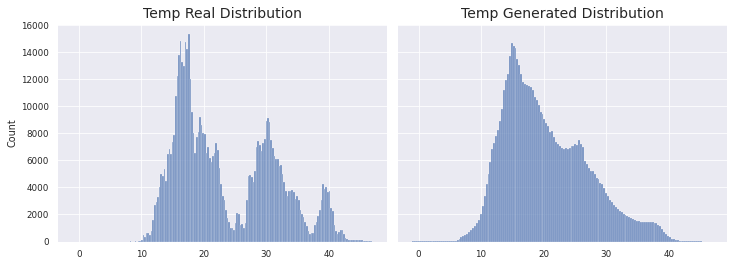

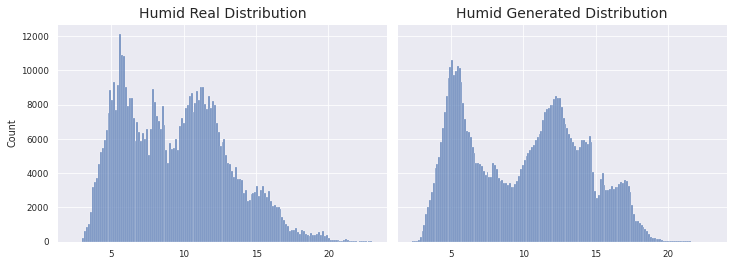

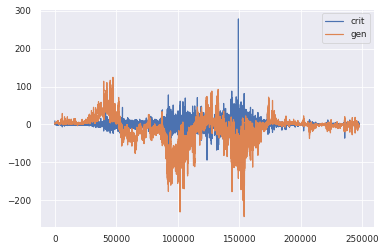

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0692 - g_loss: -1.8127
Epoch 127/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0568 - g_loss: -1.8559

KL Divergence: 6.048055245578015 bits
Pinball Loss Temp mean: 2.0868636265969935
Pinball Loss Humid mean: 0.7920762099698481
MSE Temp: 4.173727253194011
MSE Humid: 1.5841524199397137


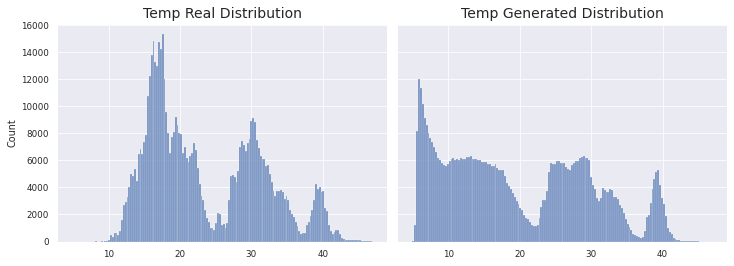

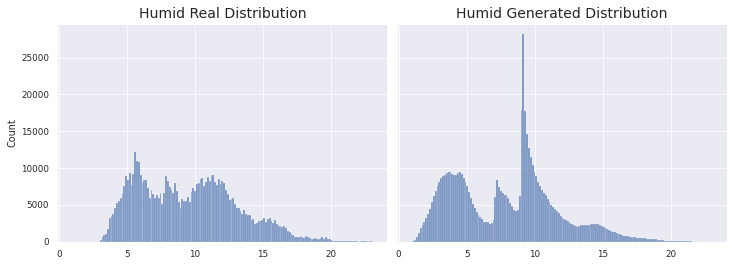

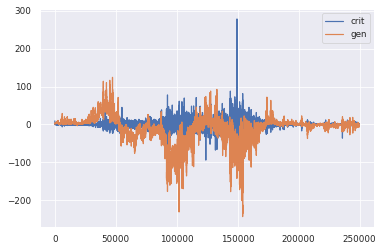

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0564 - g_loss: -1.8545
Epoch 128/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0172 - g_loss: -7.5719

KL Divergence: 15.060538001878978 bits
Pinball Loss Temp mean: 2.69625142669434
Pinball Loss Humid mean: 1.4741487658192123
MSE Temp: 5.392502853388647
MSE Humid: 2.9482975316384255


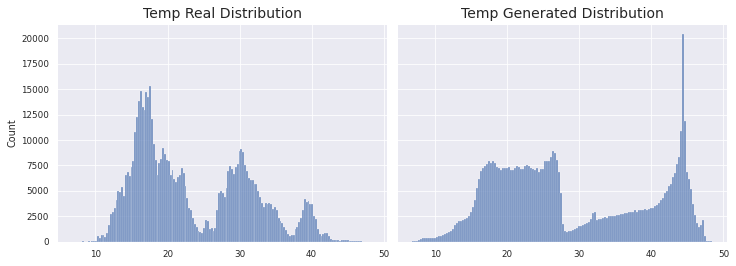

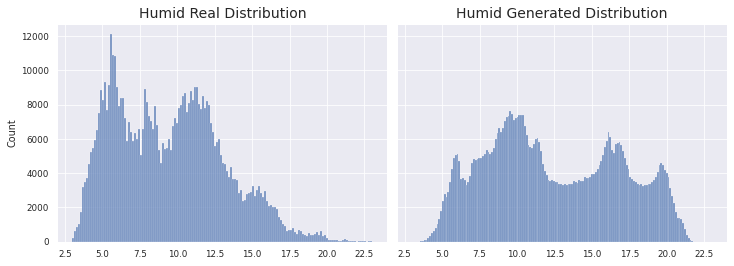

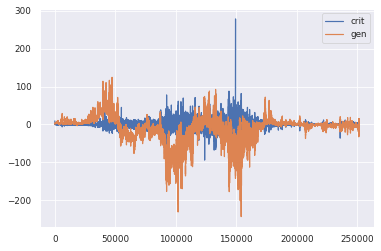

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0194 - g_loss: -7.5650
Epoch 129/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0989 - g_loss: -1.7551

KL Divergence: 2.9718459622330236 bits
Pinball Loss Temp mean: 1.1984412467612109
Pinball Loss Humid mean: 0.33363697244317
MSE Temp: 2.39688249352239
MSE Humid: 0.6672739448863397


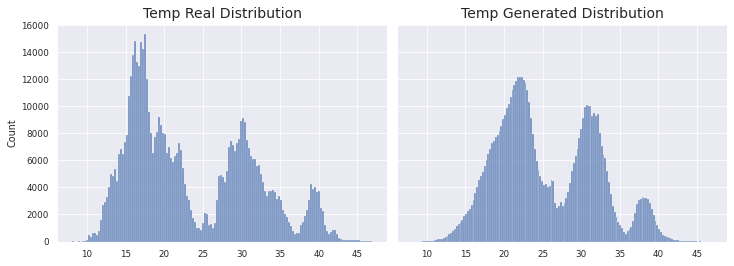

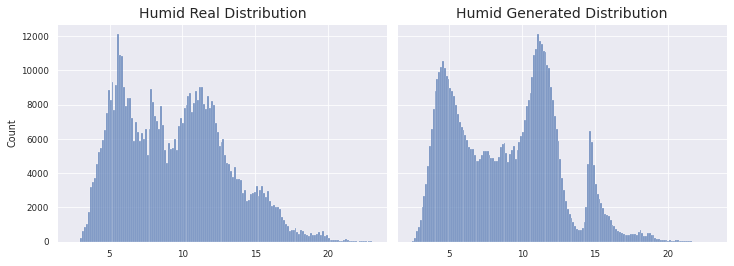

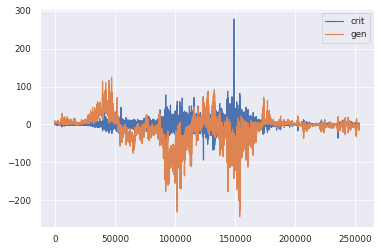

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0991 - g_loss: -1.7543
Epoch 130/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0155 - g_loss: -2.5860

KL Divergence: 3.1536594364250368 bits
Pinball Loss Temp mean: 1.4419489192071577
Pinball Loss Humid mean: 1.6456144603345275
MSE Temp: 2.883897838414298
MSE Humid: 3.291228920669019


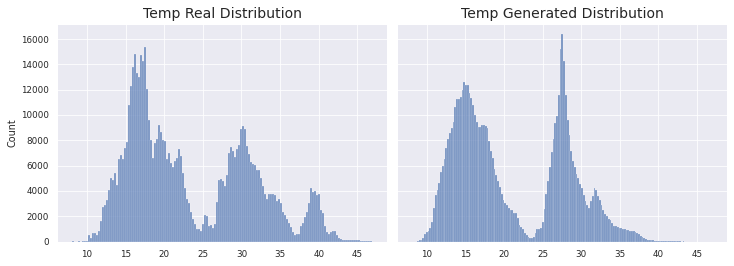

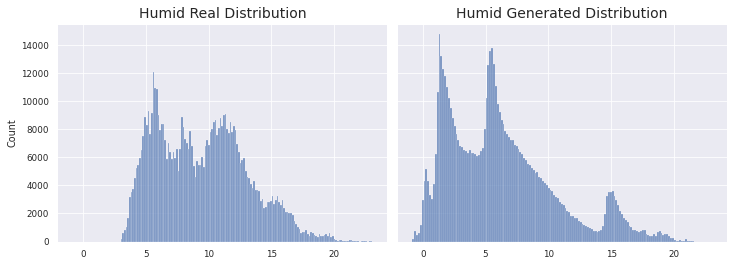

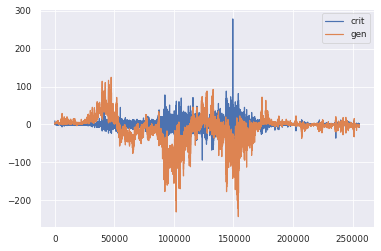

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0085 - g_loss: -2.5884
Epoch 131/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0594 - g_loss: -2.2237

KL Divergence: 3.486965587733104 bits
Pinball Loss Temp mean: 1.2741066071770435
Pinball Loss Humid mean: 0.4338776177975297
MSE Temp: 2.548213214354069
MSE Humid: 0.8677552355950517


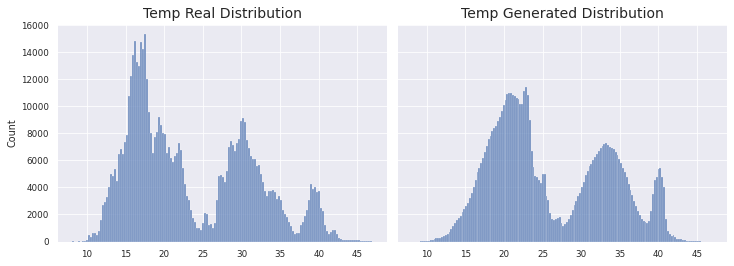

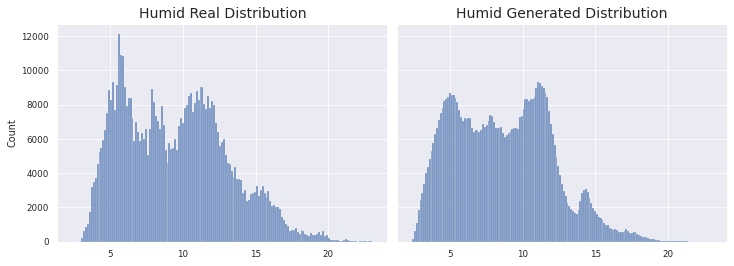

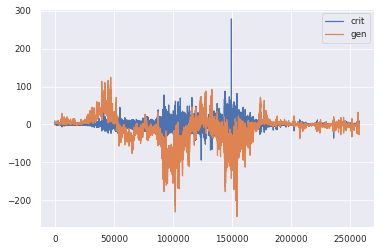

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0503 - g_loss: -2.2393
Epoch 132/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0676 - g_loss: -4.3206

KL Divergence: 9.302117554667698 bits
Pinball Loss Temp mean: 1.6841027031642675
Pinball Loss Humid mean: 0.3769389492464838
MSE Temp: 3.3682054063284976
MSE Humid: 0.7538778984929575


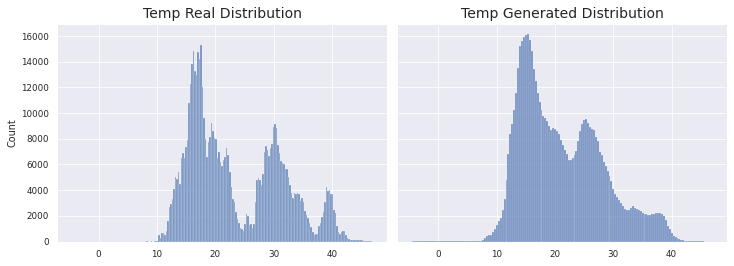

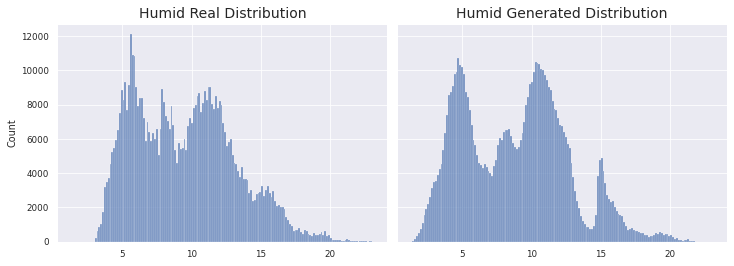

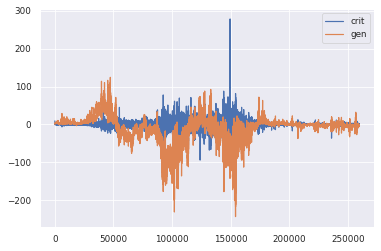

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0667 - g_loss: -4.3189
Epoch 133/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0309 - g_loss: -0.6504

KL Divergence: 7.397394507414379 bits
Pinball Loss Temp mean: 1.689007401393603
Pinball Loss Humid mean: 0.43058277041280535
MSE Temp: 3.378014802787204
MSE Humid: 0.8611655408256035


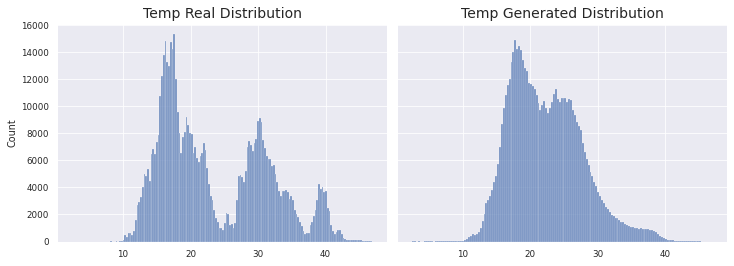

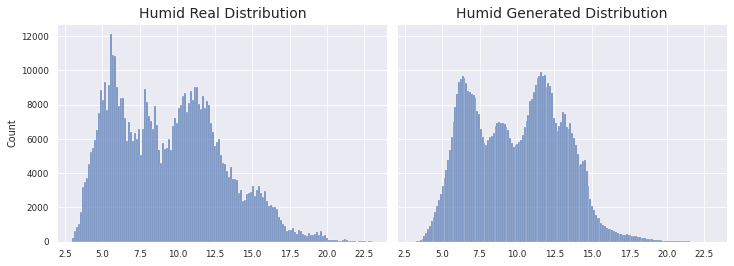

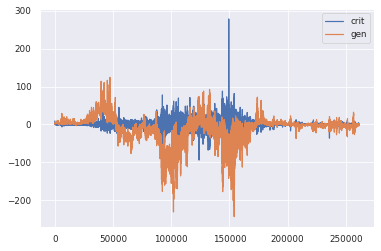

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0335 - g_loss: -0.6499
Epoch 134/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0378 - g_loss: -3.3259

KL Divergence: 4.1549337774793855 bits
Pinball Loss Temp mean: 0.9061054969602985
Pinball Loss Humid mean: 0.6113200491830764
MSE Temp: 1.8122109939205846
MSE Humid: 1.222640098366152


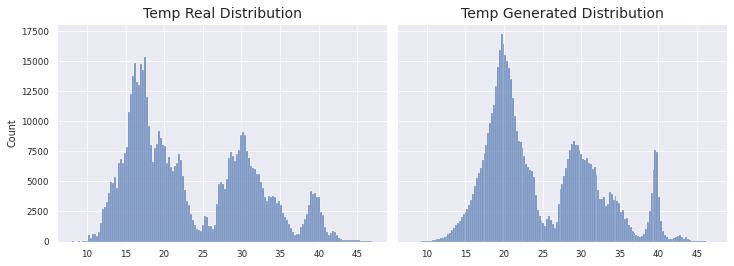

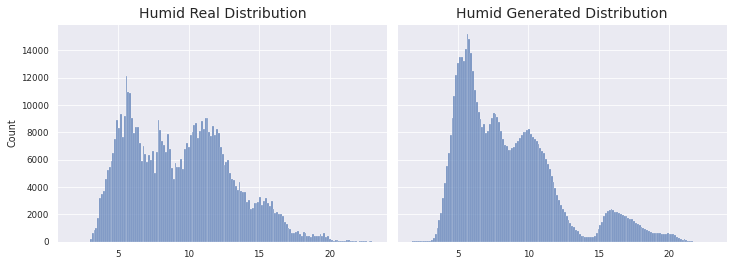

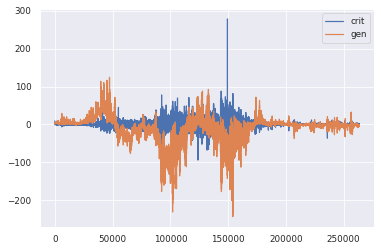

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0405 - g_loss: -3.3282
Epoch 135/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0232 - g_loss: -0.8836

KL Divergence: 4.278317436046122 bits
Pinball Loss Temp mean: 1.6142707955898303
Pinball Loss Humid mean: 2.295397157394001
MSE Temp: 3.228541591179656
MSE Humid: 4.590794314788009


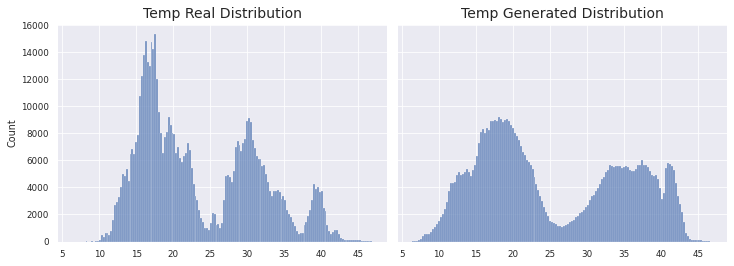

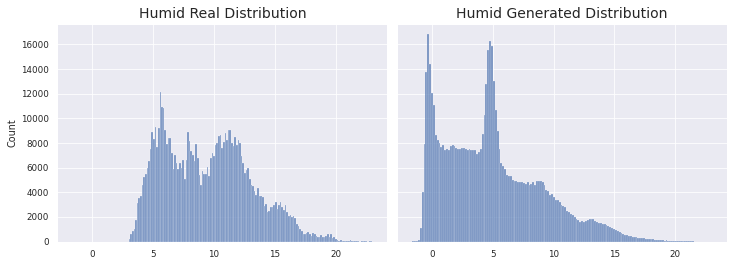

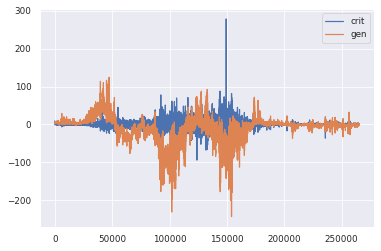

1966/1966 [==============================] - 129s 66ms/step - d_loss: 0.0235 - g_loss: -0.8830
Epoch 136/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0272 - g_loss: -1.7639

KL Divergence: 9.065763190546399 bits
Pinball Loss Temp mean: 1.8405052051952069
Pinball Loss Humid mean: 1.0959830182602741
MSE Temp: 3.6810104103904213
MSE Humid: 2.191966036520582


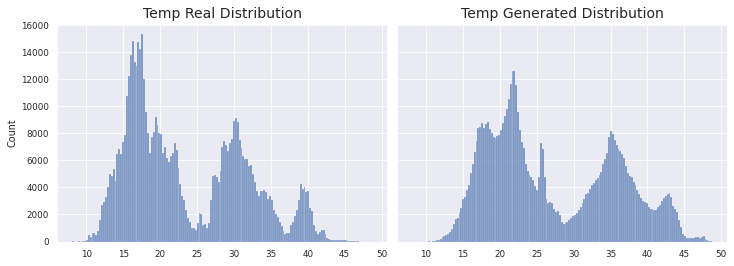

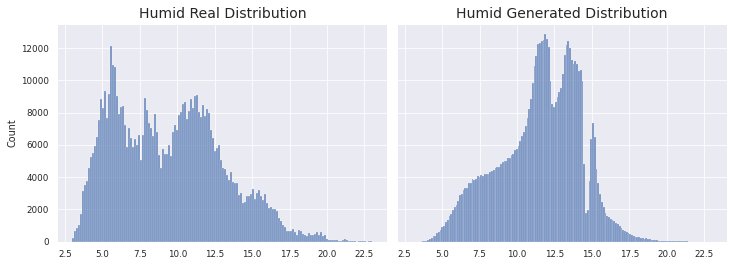

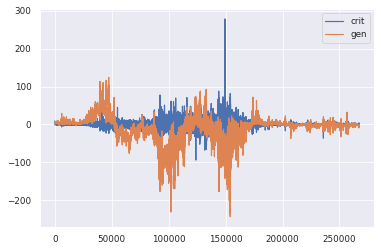

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0303 - g_loss: -1.7662
Epoch 137/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0012 - g_loss: -4.9375

KL Divergence: 9.745151943518724 bits
Pinball Loss Temp mean: 2.2900954328608134
Pinball Loss Humid mean: 0.8567726730182252
MSE Temp: 4.580190865721585
MSE Humid: 1.7135453460364183


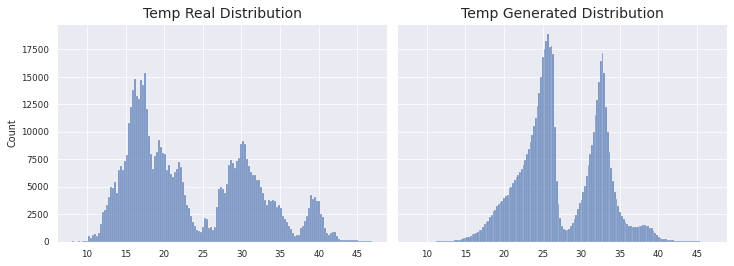

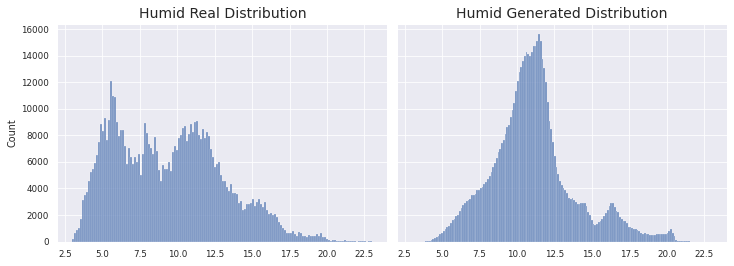

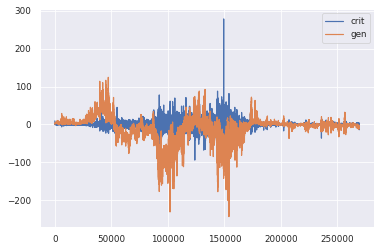

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0127 - g_loss: -4.9439
Epoch 138/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0338 - g_loss: -8.1498

KL Divergence: 6.591196768212199 bits
Pinball Loss Temp mean: 1.3957607319590748
Pinball Loss Humid mean: 0.38740698993881023
MSE Temp: 2.791521463918162
MSE Humid: 0.7748139798776265


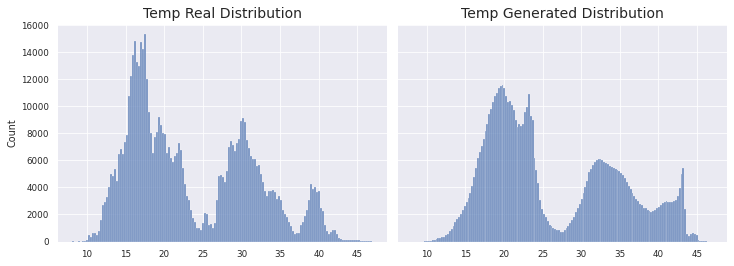

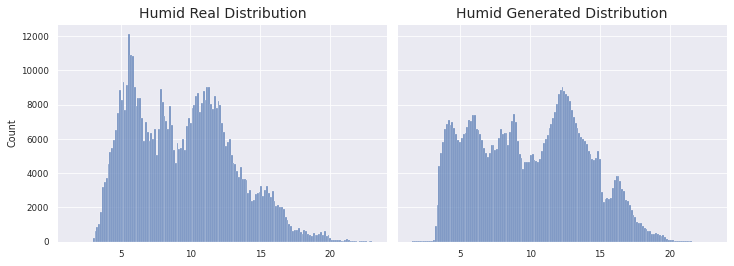

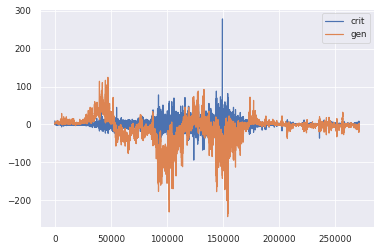

1966/1966 [==============================] - 131s 67ms/step - d_loss: -0.0359 - g_loss: -8.1536
Epoch 139/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0988 - g_loss: -3.3163

KL Divergence: 6.026534243999579 bits
Pinball Loss Temp mean: 1.762040656314877
Pinball Loss Humid mean: 0.5385166784261914
MSE Temp: 3.5240813126297783
MSE Humid: 1.0770333568523769


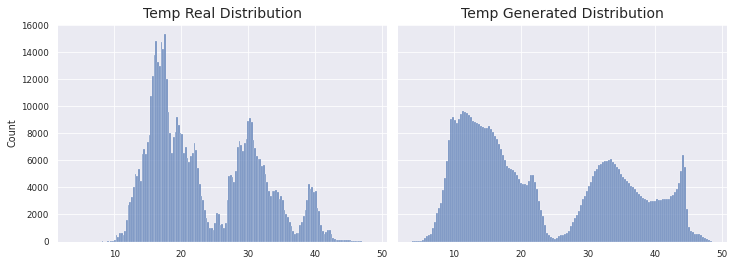

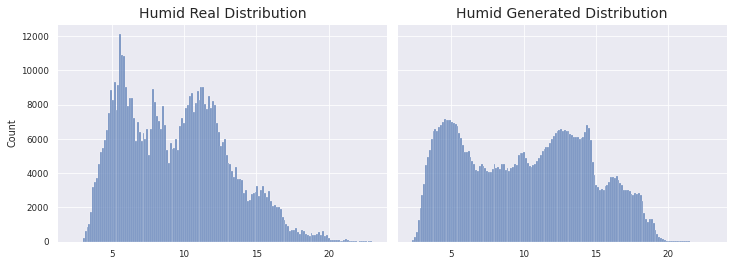

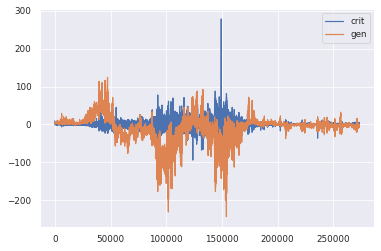

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0957 - g_loss: -3.3189
Epoch 140/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.7182e-04 - g_loss: -7.6229 

KL Divergence: 7.725825783350455 bits
Pinball Loss Temp mean: 2.0161394563554116
Pinball Loss Humid mean: 1.0785268874238807
MSE Temp: 4.03227891271083
MSE Humid: 2.1570537748477783


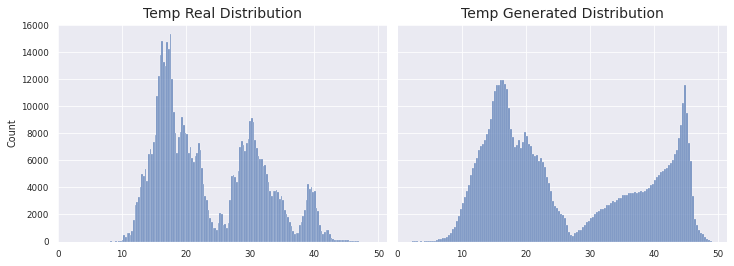

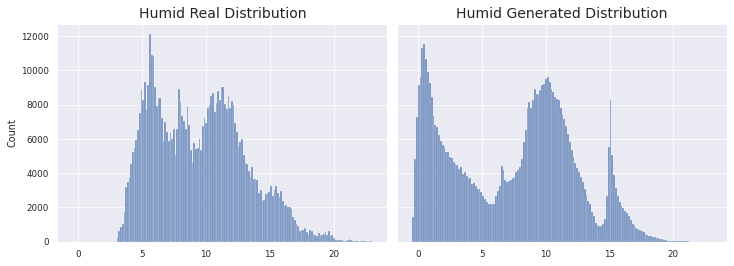

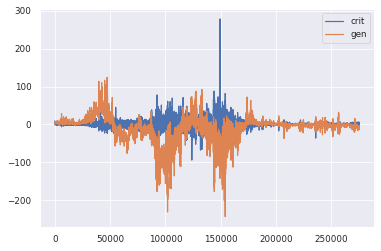

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0059 - g_loss: -7.6250
Epoch 141/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0813 - g_loss: -7.3503

KL Divergence: 7.824840685344842 bits
Pinball Loss Temp mean: 1.0129719294996675
Pinball Loss Humid mean: 0.3739346432379722
MSE Temp: 2.0259438589993164
MSE Humid: 0.747869286475943


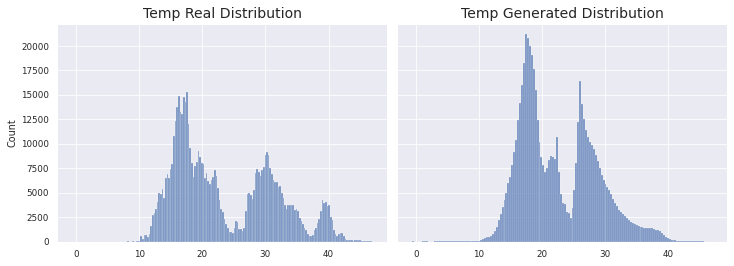

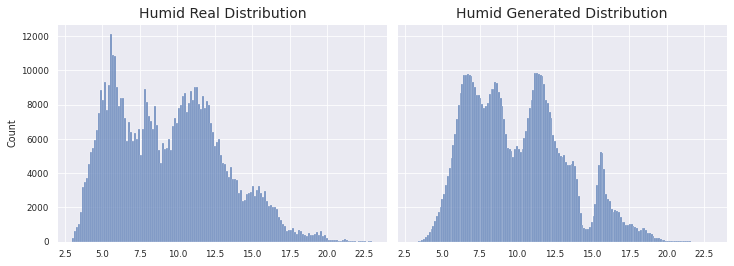

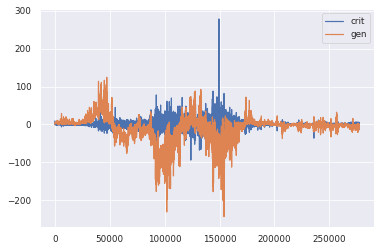

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0672 - g_loss: -7.3549
Epoch 142/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0163 - g_loss: -10.9372

KL Divergence: 5.175678780499227 bits
Pinball Loss Temp mean: 1.2030362423088863
Pinball Loss Humid mean: 0.4317207758894283
MSE Temp: 2.4060724846177477
MSE Humid: 0.8634415517788516


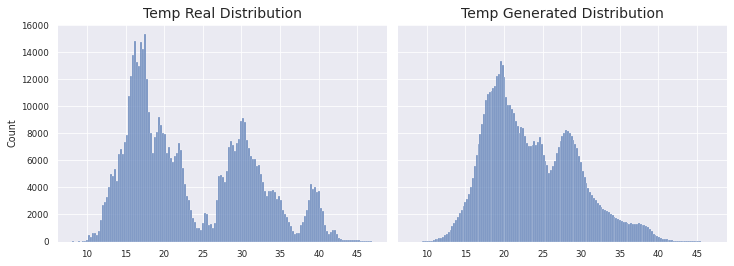

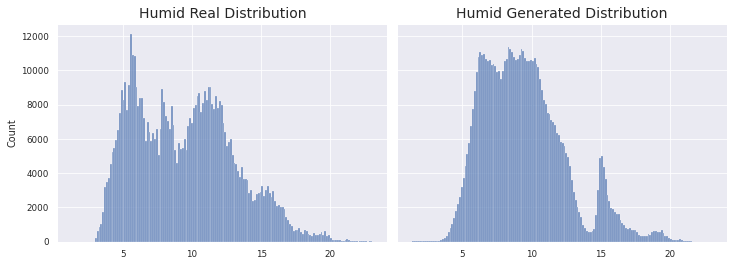

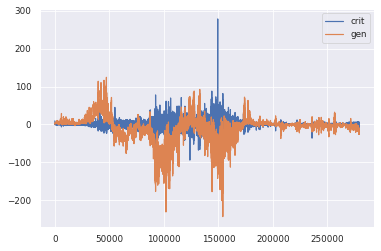

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0192 - g_loss: -10.9527
Epoch 143/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0142 - g_loss: -7.8278

KL Divergence: 23.930500805112406 bits
Pinball Loss Temp mean: 3.13322399934884
Pinball Loss Humid mean: 1.573514511491078
MSE Temp: 6.266447998697652
MSE Humid: 3.147029022982112


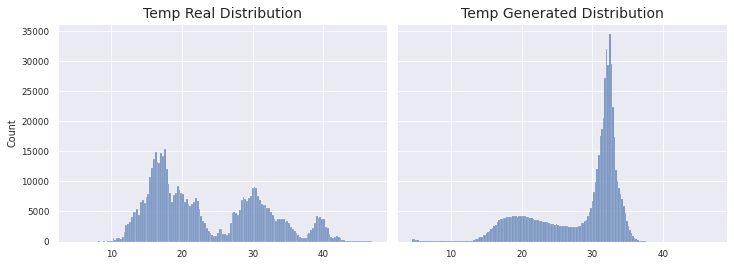

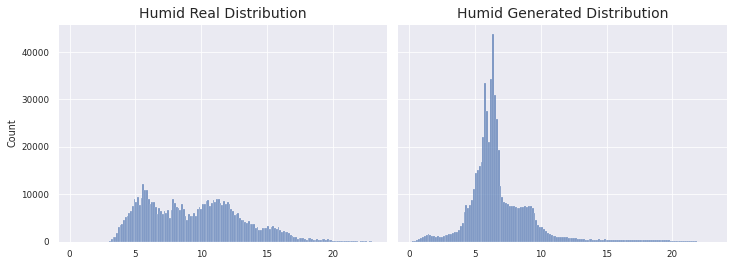

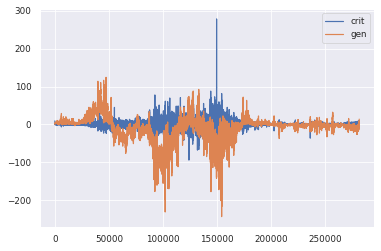

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0219 - g_loss: -7.8055
Epoch 144/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0767 - g_loss: -1.4172

KL Divergence: 7.353132712024875 bits
Pinball Loss Temp mean: 1.2693083879790727
Pinball Loss Humid mean: 1.060359358223433
MSE Temp: 2.538616775958206
MSE Humid: 2.120718716446866


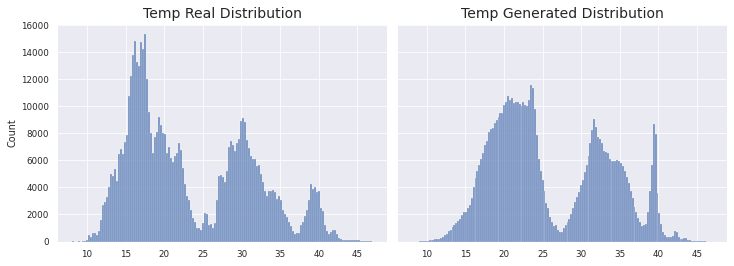

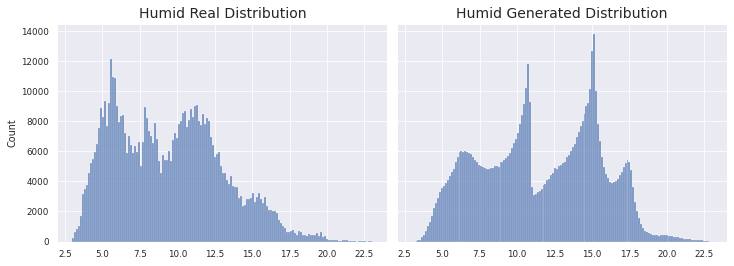

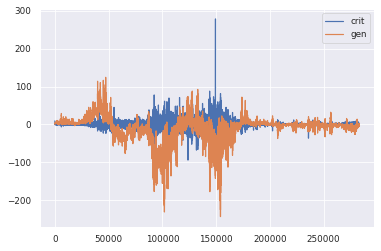

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0768 - g_loss: -1.4212
Epoch 145/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0326 - g_loss: 0.6246

KL Divergence: 8.728920496401917 bits
Pinball Loss Temp mean: 2.002865540799185
Pinball Loss Humid mean: 0.7117893201153791
MSE Temp: 4.0057310815983875
MSE Humid: 1.4235786402307498


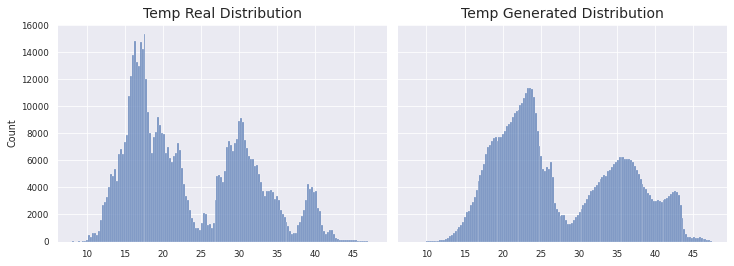

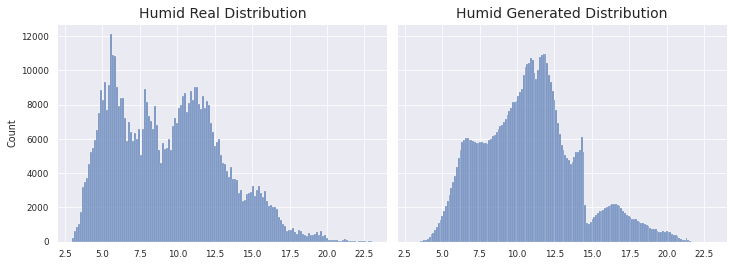

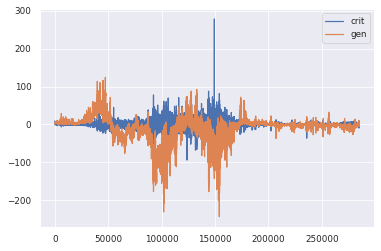

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0292 - g_loss: 0.6199
Epoch 146/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0452 - g_loss: -1.9597

KL Divergence: 6.663872937863289 bits
Pinball Loss Temp mean: 1.0344152693018618
Pinball Loss Humid mean: 0.7812363293153626
MSE Temp: 2.0688305386037134
MSE Humid: 1.562472658630716


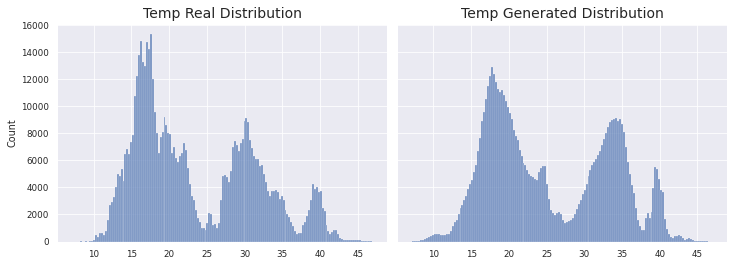

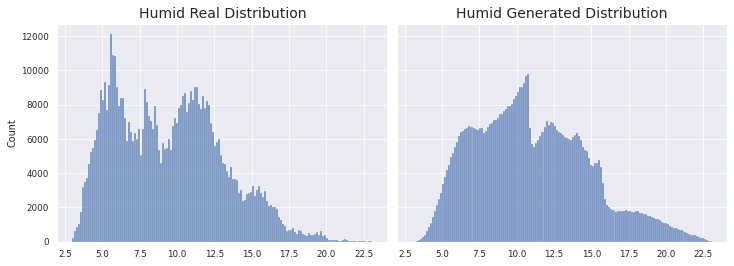

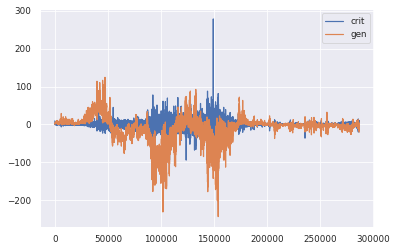

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0578 - g_loss: -1.9784
Epoch 147/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0270 - g_loss: 3.7842

KL Divergence: 19.243487926622375 bits
Pinball Loss Temp mean: 1.7890582466545215
Pinball Loss Humid mean: 2.0675298741970347
MSE Temp: 3.5781164933090266
MSE Humid: 4.135059748394022


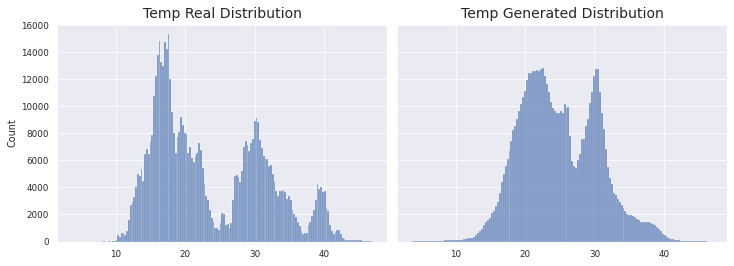

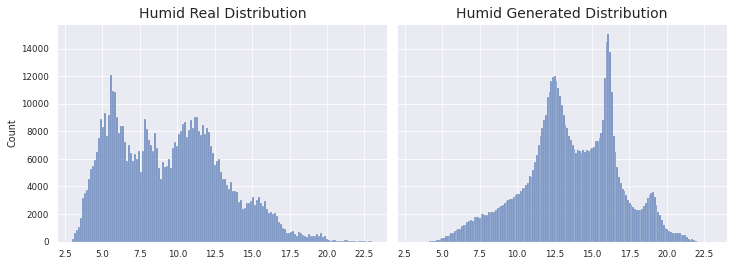

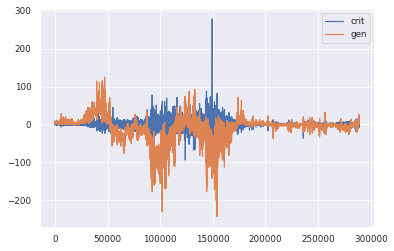

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0336 - g_loss: 3.7922
Epoch 148/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1779 - g_loss: 26.7594

KL Divergence: 8.094046800094231 bits
Pinball Loss Temp mean: 2.402546401865112
Pinball Loss Humid mean: 1.0380846861111404
MSE Temp: 4.805092803730131
MSE Humid: 2.076169372222246


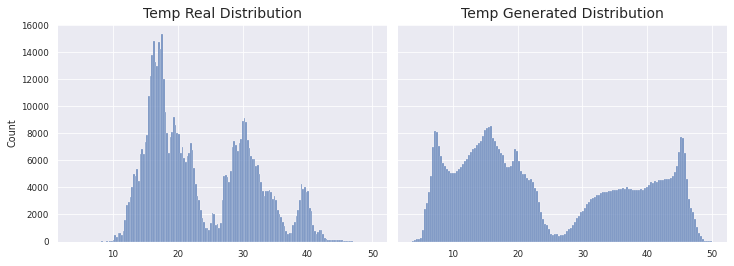

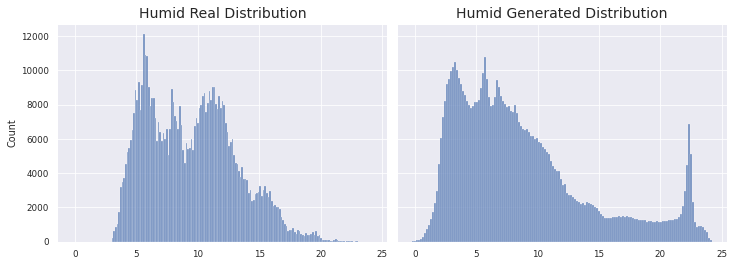

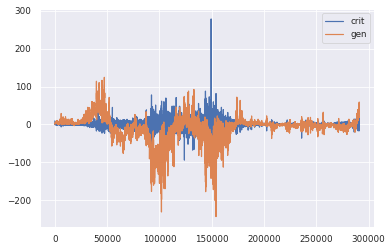

1966/1966 [==============================] - 131s 66ms/step - d_loss: -0.1796 - g_loss: 26.7711
Epoch 149/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0438 - g_loss: 27.2932

KL Divergence: 5.3241227667707225 bits
Pinball Loss Temp mean: 1.946036920837893
Pinball Loss Humid mean: 0.9890462166866938
MSE Temp: 3.8920738416758582
MSE Humid: 1.9780924333733674


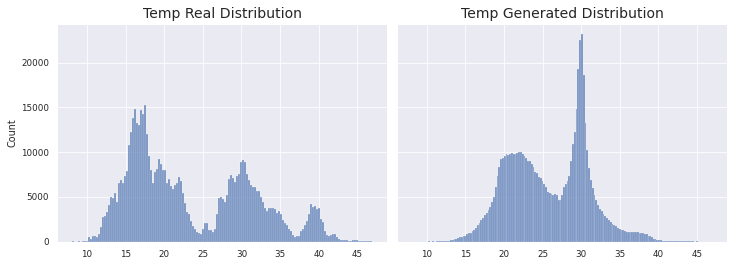

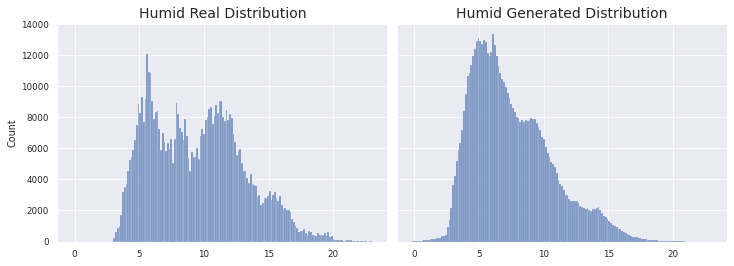

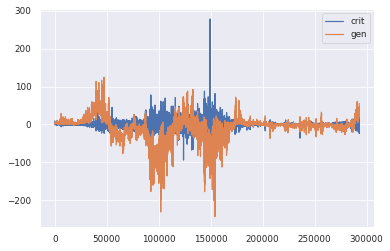

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0322 - g_loss: 27.3077
Epoch 150/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1682 - g_loss: 23.5142

KL Divergence: 8.608163849517101 bits
Pinball Loss Temp mean: 2.7767767713377167
Pinball Loss Humid mean: 0.472641281586733
MSE Temp: 5.553553542675403
MSE Humid: 0.9452825631734675


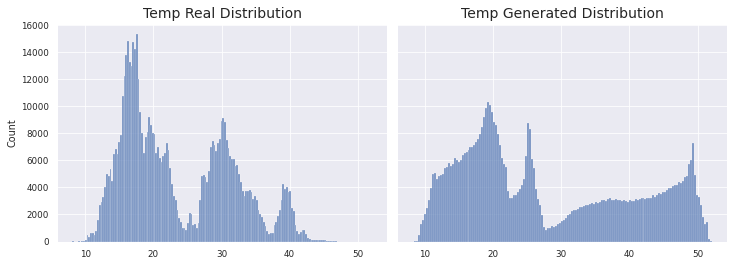

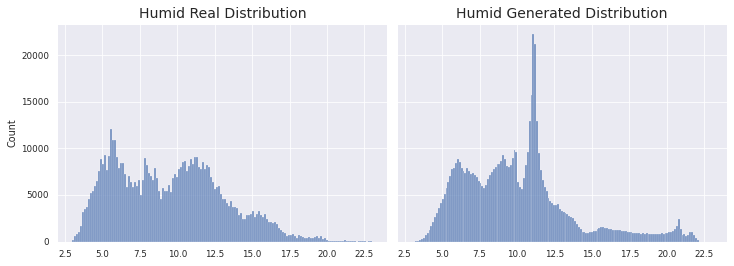

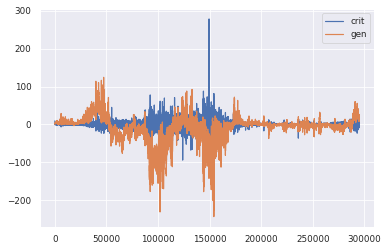

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1694 - g_loss: 23.4983
Epoch 151/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0438 - g_loss: 28.6576

KL Divergence: 6.816902298422521 bits
Pinball Loss Temp mean: 1.8902684027091348
Pinball Loss Humid mean: 0.7303359368935897
MSE Temp: 3.780536805418261
MSE Humid: 1.4606718737871813


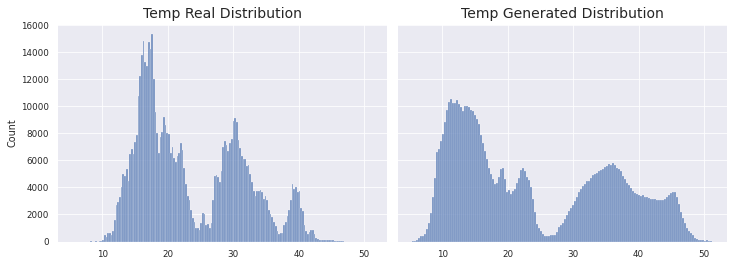

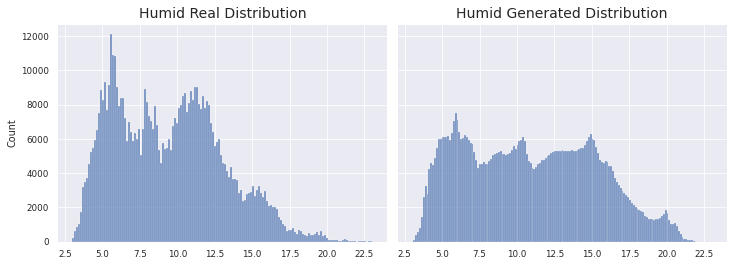

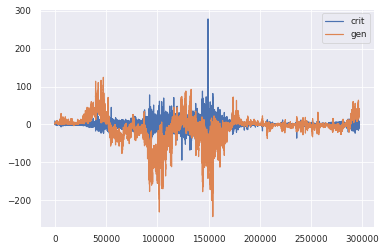

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.0321 - g_loss: 28.6689
Epoch 152/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0756 - g_loss: 16.7290

KL Divergence: 10.648335735973236 bits
Pinball Loss Temp mean: 4.034347502111897
Pinball Loss Humid mean: 1.0394179789696085
MSE Temp: 8.068695004223853
MSE Humid: 2.078835957939241


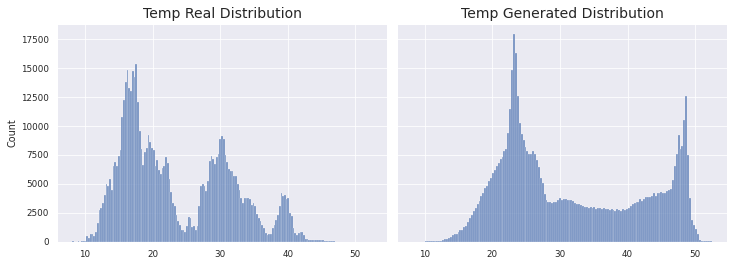

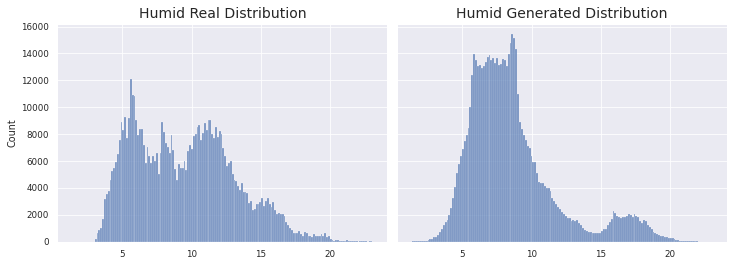

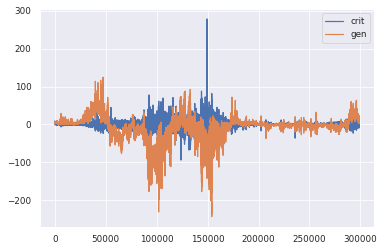

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.0796 - g_loss: 16.7143
Epoch 153/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1220 - g_loss: 12.9328

KL Divergence: 29.908262225921977 bits
Pinball Loss Temp mean: 3.9083011106325047
Pinball Loss Humid mean: 1.5383344159870362
MSE Temp: 7.816602221264969
MSE Humid: 3.07666883197404


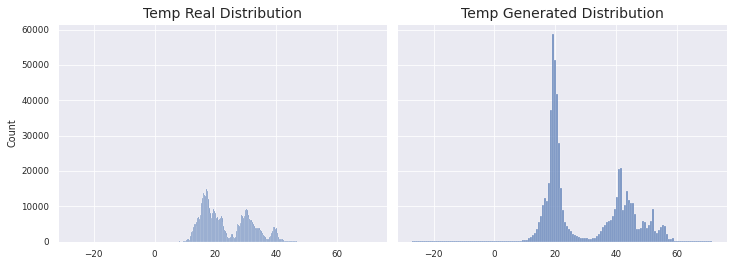

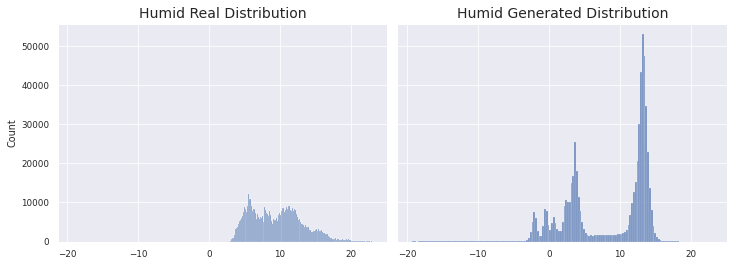

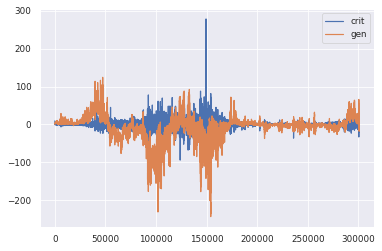

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0850 - g_loss: 12.9320
Epoch 154/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1451 - g_loss: -1.9309

KL Divergence: 29.06076382229606 bits
Pinball Loss Temp mean: 1.7812207763584613
Pinball Loss Humid mean: 0.9551549244715195
MSE Temp: 3.562441552716919
MSE Humid: 1.9103098489430288


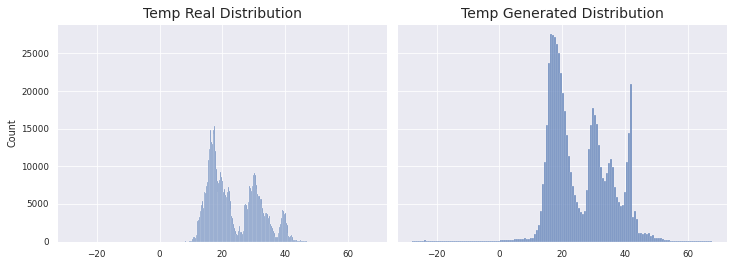

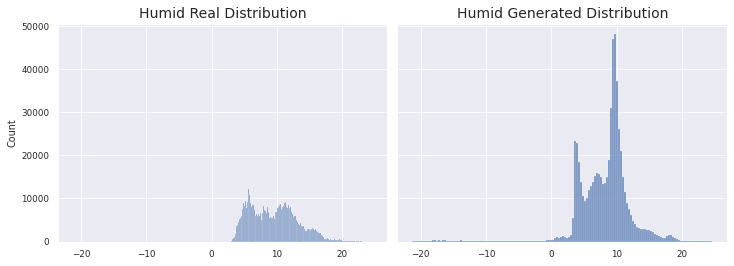

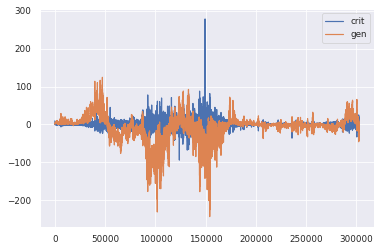

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1228 - g_loss: -1.9417
Epoch 155/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0411 - g_loss: -11.8686

KL Divergence: 28.26569221727329 bits
Pinball Loss Temp mean: 1.9908290762237535
Pinball Loss Humid mean: 0.8055064408166019
MSE Temp: 3.981658152447536
MSE Humid: 1.6110128816331886


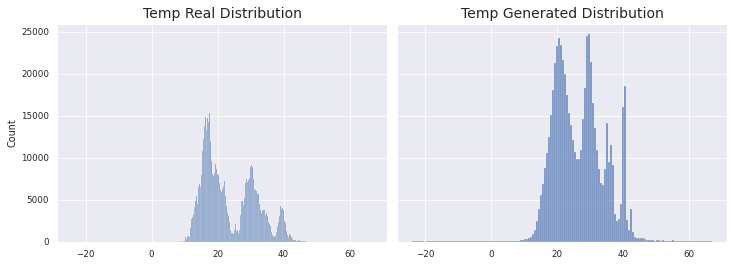

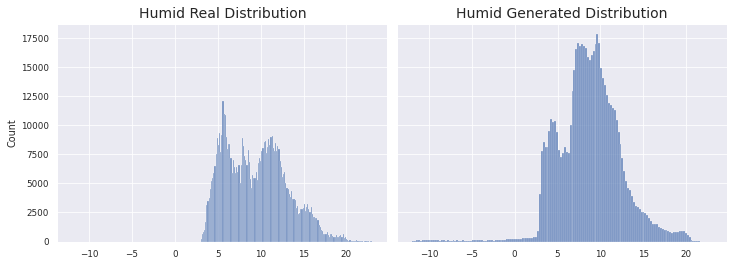

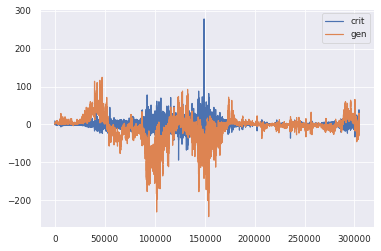

1966/1966 [==============================] - 130s 66ms/step - d_loss: -0.0444 - g_loss: -11.8494
Epoch 156/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1873 - g_loss: 3.9471

KL Divergence: 27.839862237123018 bits
Pinball Loss Temp mean: 2.1171674548324373
Pinball Loss Humid mean: 1.090746107421888
MSE Temp: 4.234334909664912
MSE Humid: 2.1814922148437756


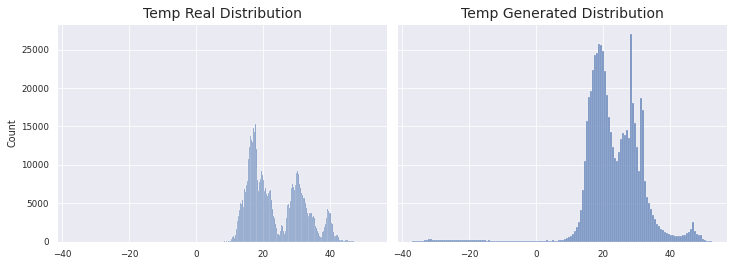

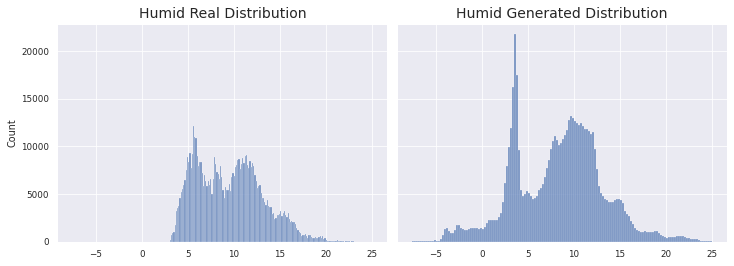

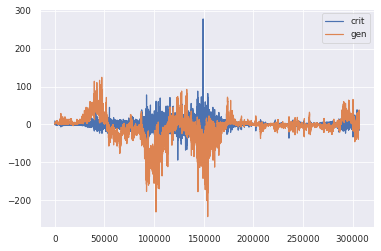

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.1867 - g_loss: 3.9708
Epoch 157/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0857 - g_loss: 4.0649

KL Divergence: 27.489375860319967 bits
Pinball Loss Temp mean: 3.924686061408381
Pinball Loss Humid mean: 1.637363997793108
MSE Temp: 7.849372122816662
MSE Humid: 3.2747279955862


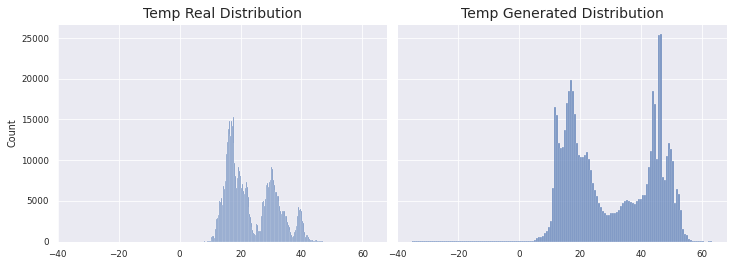

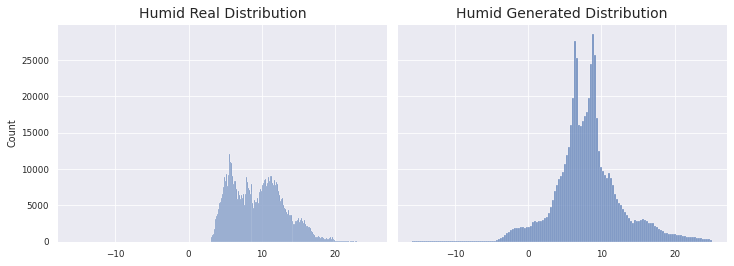

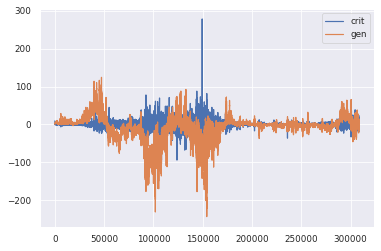

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0864 - g_loss: 4.0688
Epoch 158/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1808 - g_loss: -4.8559

KL Divergence: 21.11803557289395 bits
Pinball Loss Temp mean: 2.174481620982596
Pinball Loss Humid mean: 0.6495983679558499
MSE Temp: 4.348963241965307
MSE Humid: 1.2991967359117031


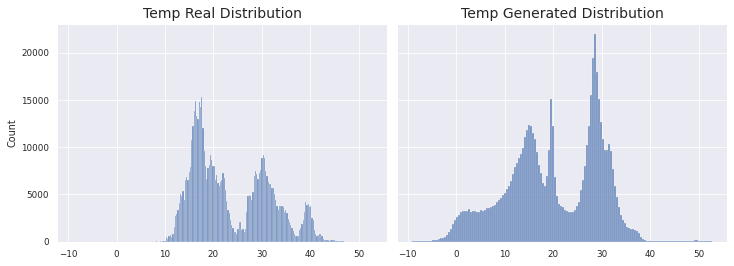

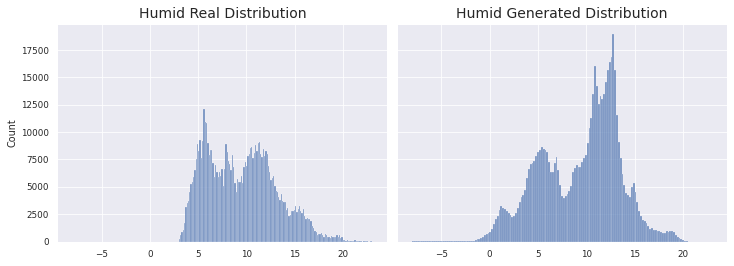

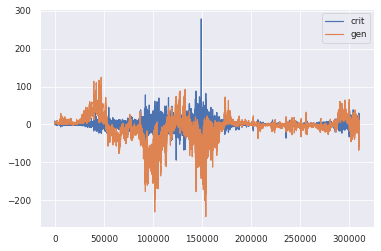

1966/1966 [==============================] - 131s 66ms/step - d_loss: 0.1865 - g_loss: -4.8516
Epoch 159/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1217 - g_loss: -3.4651

KL Divergence: 18.132961653738544 bits
Pinball Loss Temp mean: 0.9459552910912455
Pinball Loss Humid mean: 0.6345897702442623
MSE Temp: 1.891910582182481
MSE Humid: 1.2691795404885131


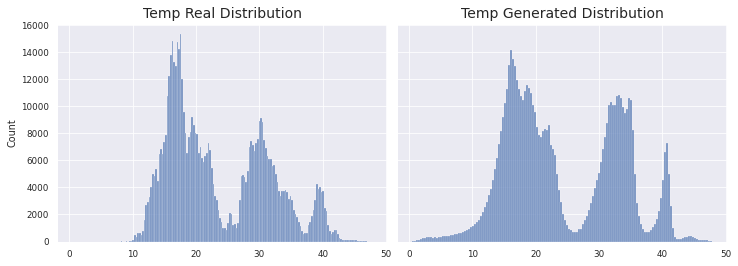

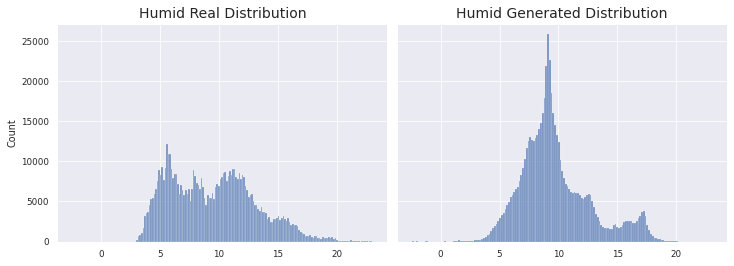

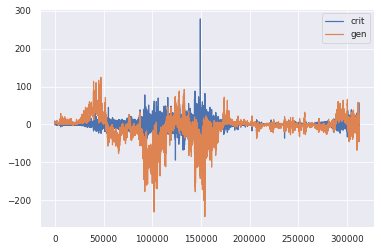

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.1792 - g_loss: -3.4735
Epoch 160/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2752 - g_loss: -8.9126

KL Divergence: 14.48190078223259 bits
Pinball Loss Temp mean: 2.048698904166715
Pinball Loss Humid mean: 1.288162965794744
MSE Temp: 4.097397808333401
MSE Humid: 2.5763259315894684


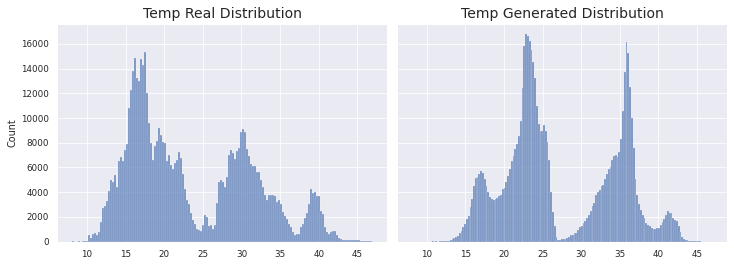

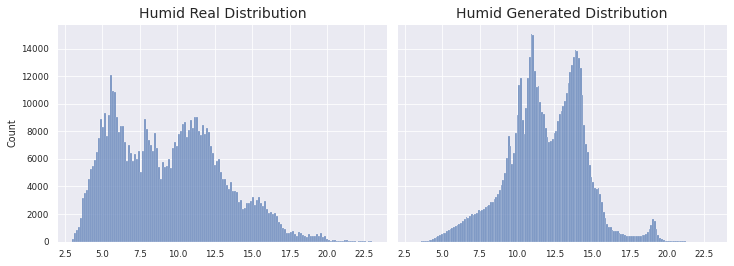

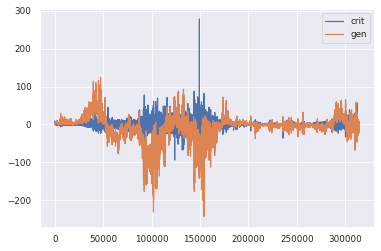

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2812 - g_loss: -8.9062
Epoch 161/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2491 - g_loss: -5.9069

KL Divergence: 6.626958986682868 bits
Pinball Loss Temp mean: 1.0415200345100173
Pinball Loss Humid mean: 0.47097720708023144
MSE Temp: 2.083040069020052
MSE Humid: 0.9419544141604838


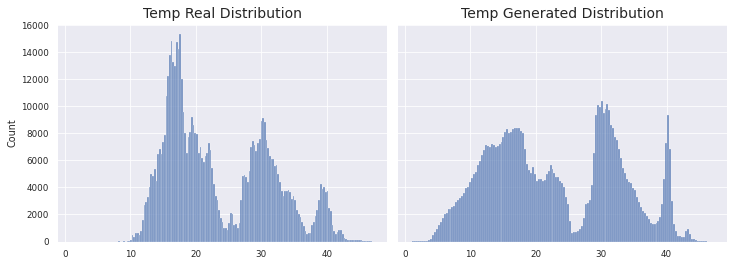

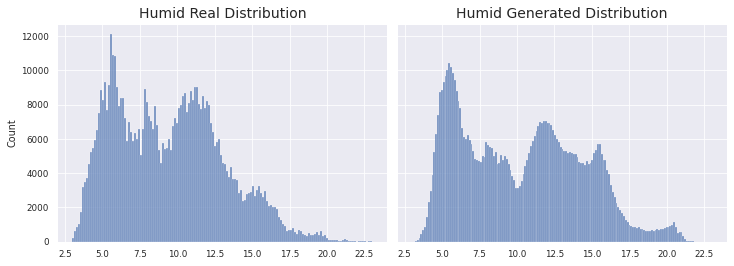

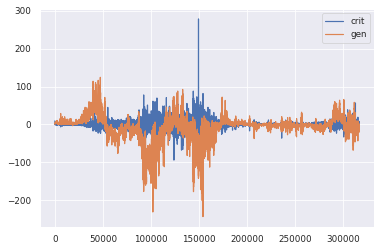

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2398 - g_loss: -5.9040
Epoch 162/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0849 - g_loss: -7.4800

KL Divergence: 5.377145407872958 bits
Pinball Loss Temp mean: 1.110515806087759
Pinball Loss Humid mean: 0.33828898960044107
MSE Temp: 2.2210316121755493
MSE Humid: 0.6765779792008859


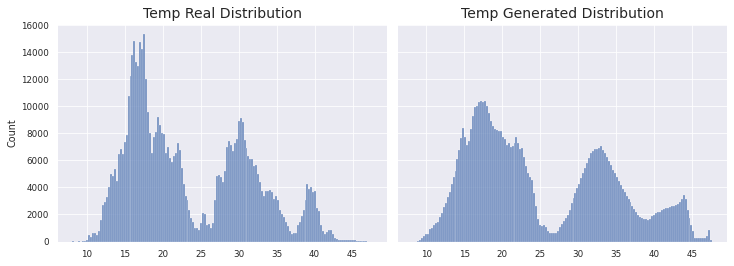

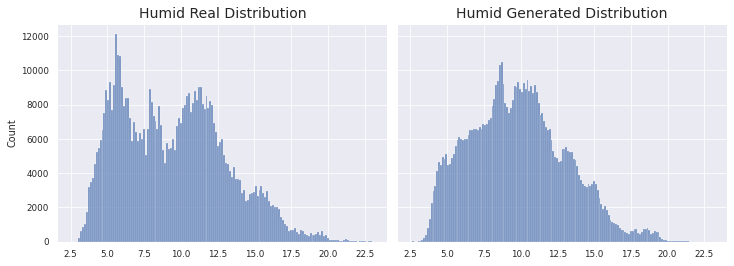

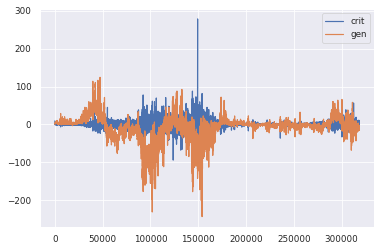

1966/1966 [==============================] - 131s 67ms/step - d_loss: 0.0956 - g_loss: -7.4884
Epoch 163/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2037 - g_loss: -5.2987

KL Divergence: 12.483530708915533 bits
Pinball Loss Temp mean: 2.54474191936019
Pinball Loss Humid mean: 0.5427902233529649
MSE Temp: 5.089483838720502
MSE Humid: 1.0855804467059242


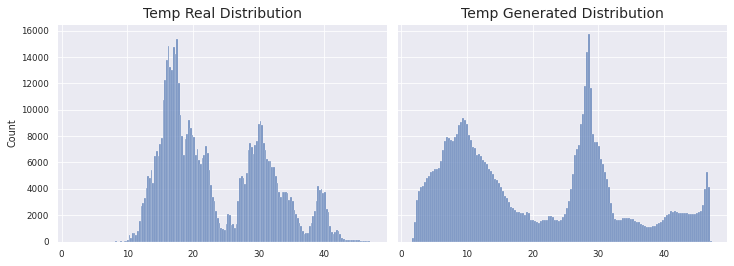

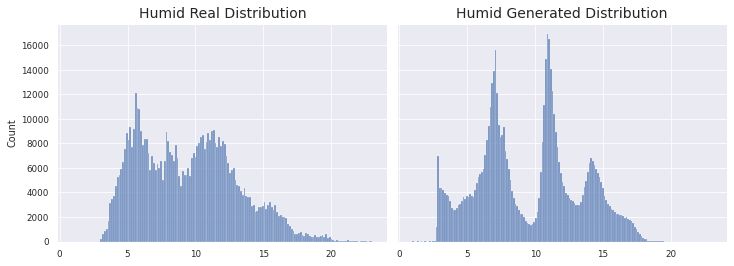

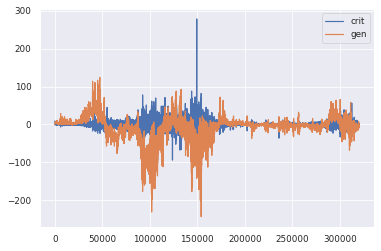

1966/1966 [==============================] - 130s 66ms/step - d_loss: 0.2037 - g_loss: -5.3015
Epoch 164/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1063 - g_loss: 2.7859

KL Divergence: 3.2489771237474567 bits
Pinball Loss Temp mean: 0.7857805168890225
Pinball Loss Humid mean: 0.5410133748415046
MSE Temp: 1.5715610337780448
MSE Humid: 1.0820267496830016


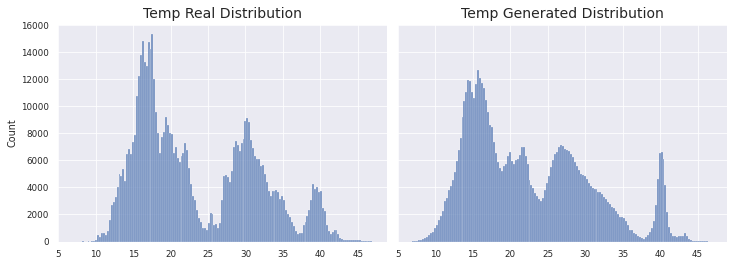

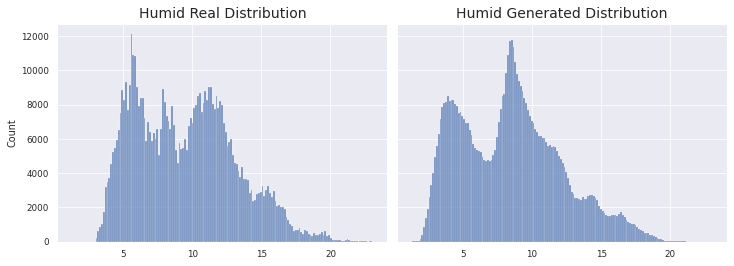

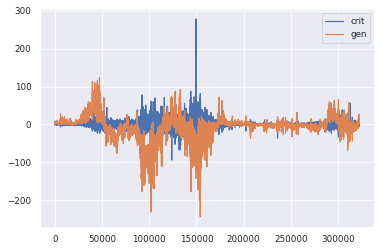

1966/1966 [==============================] - 132s 67ms/step - d_loss: 0.1068 - g_loss: 2.7978
Epoch 165/200
 669/1966 [=========>....................] - ETA: 41s - d_loss: 0.0586 - g_loss: 15.8649

KeyboardInterrupt: ignored

In [ ]:
# prueba_9
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

## Scenario Generation

In [ ]:
day = 'prueba_9'
n_model = 45
latent_dim = 8

selected_generator = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
selected_critic = define_critic(in_shape=(25, 2), n_classes=35)

model_gen_name = '/content/drive/My Drive/TFM/Experiments/' + day + '/gen_model_' + str(n_model) + '_KL_Pinball_MSE'
model_critic_name = '/content/drive/My Drive/TFM/Experiments/'+ day + '/c_model_' + str(n_model) + '_KL_Pinball_MSE'

selected_generator.load_weights(model_gen_name)
selected_critic.load_weights(model_critic_name)

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Time-Series_Input (InputLayer)  [(None, 24, 2)]      0                                            
__________________________________________________________________________________________________
Categorical_Input (InputLayer)  [(None, 1)]          0                                            
__________________________________________________________________________________________________
lstm_2 (LSTM)                   (None, 24, 160)      104320      Time-Series_Input[0][0]          
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, 1, 8)         280         Categorical_Input[0][0]          
____________________________________________________________________________________________

### Validation data vs. Real data with the selected model

[Text(0.5, 1.0, 'Humid Real / Generated Distributions - 24 time-steps predictions')]

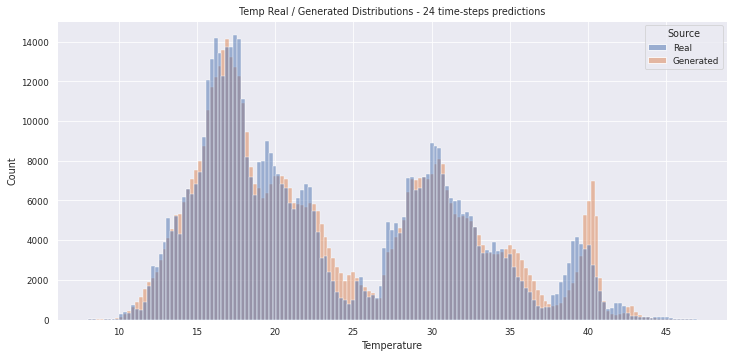

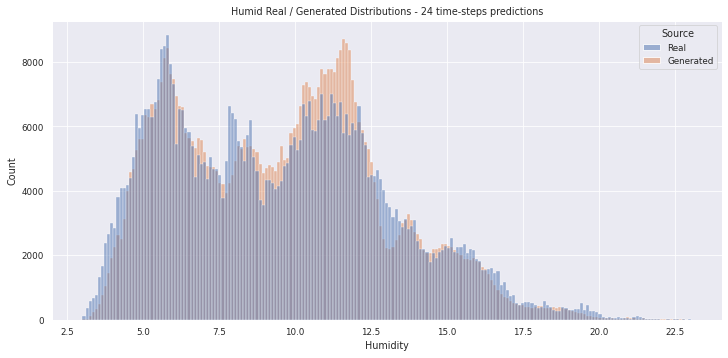

In [ ]:
flat_temp_real = np.load('/content/drive/My Drive/TFM/Experiments/prueba_9/45_temp_real.npy').flatten()
flat_temp_gen = np.load('/content/drive/My Drive/TFM/Experiments/prueba_9/45_temp_gen.npy').flatten()
flat_humid_real = np.load('/content/drive/My Drive/TFM/Experiments/prueba_9/45_humid_real.npy').flatten()
flat_humid_gen = np.load('/content/drive/My Drive/TFM/Experiments/prueba_9/45_humid_gen.npy').flatten()

temp_real_df = pd.DataFrame(flat_temp_real, columns=['Temperature'])
temp_real_df['Source'] = 'Real'
temp_gen_df = pd.DataFrame(flat_temp_gen, columns=['Temperature'])
temp_gen_df['Source'] = 'Generated'
temp_df = pd.concat([temp_real_df, temp_gen_df])

plt.figure(figsize=(12,5.5))
sns.histplot(data=temp_df, x='Temperature', bins='auto', hue='Source').set(title='Temp Real / Generated Distributions - 24 time-steps predictions')

humid_real_df = pd.DataFrame(flat_humid_real, columns=['Humidity'])
humid_real_df['Source'] = 'Real'
humid_gen_df = pd.DataFrame(flat_humid_gen, columns=['Humidity'])
humid_gen_df['Source'] = 'Generated'
humid_df = pd.concat([humid_real_df, humid_gen_df])

plt.figure(figsize=(12,5.5))
sns.histplot(data=humid_df, x='Humidity', bins='auto', hue='Source').set(title='Humid Real / Generated Distributions - 24 time-steps predictions')

In [ ]:
temp_real_df = pd.DataFrame(flat_temp_real, columns=['Temperature'])
temp_real_df['Source'] = 'Real'
temp_gen_df = pd.DataFrame(flat_temp_gen, columns=['Temperature'])
temp_gen_df['Source'] = 'Generated'
temp_df = pd.concat([temp_real_df, temp_gen_df])

humid_real_df = pd.DataFrame(flat_humid_real, columns=['Humidity'])
humid_gen_df = pd.DataFrame(flat_humid_gen, columns=['Humidity'])
humid_df = pd.concat([humid_real_df, humid_gen_df])

temp_df['Humidity'] = humid_df

<Figure size 720x720 with 0 Axes>

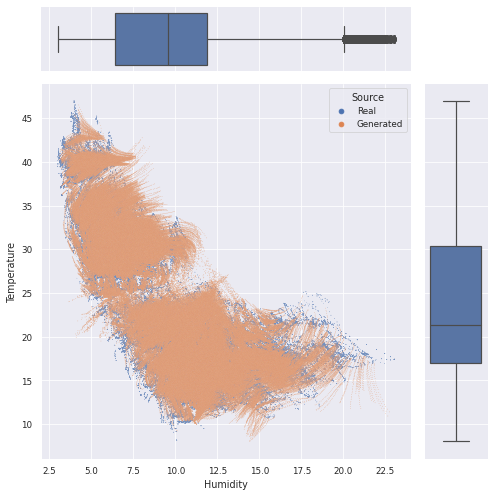

In [ ]:
plt.figure(figsize=(10,10))
g = sns.JointGrid(data=temp_df, x='Humidity', y='Temperature', height=7, hue='Source')
g.plot_joint(sns.scatterplot, s=0.3)
g.plot_marginals(sns.boxplot)

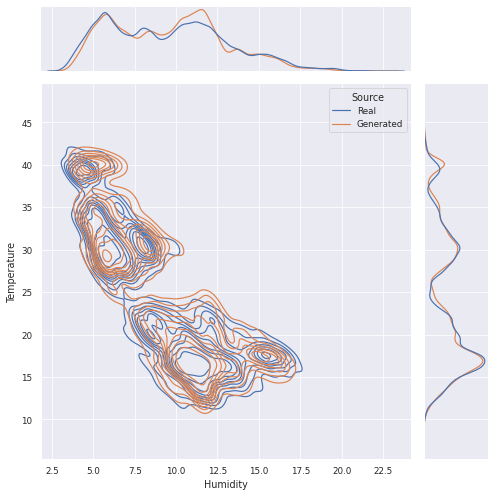

In [ ]:
sns.jointplot(data=temp_df, x='Humidity', y='Temperature',  hue='Source', kind='kde', height=7, thresh=0.12, fill=False)

### Random Exploration of Latent Space

y_real shape (20, 24, 2)
y generated shape: (20, 6, 24, 2)
Sensor #6


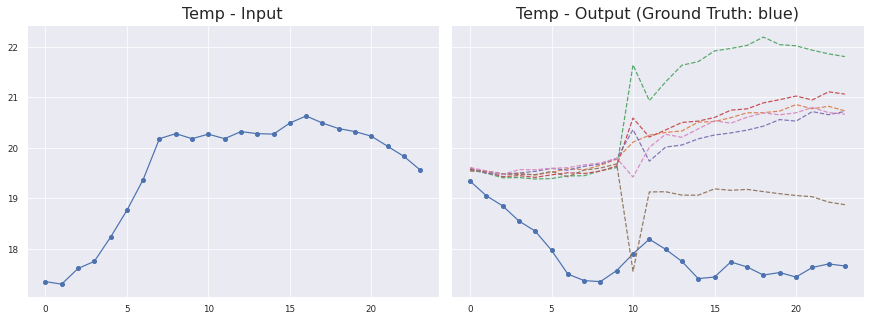

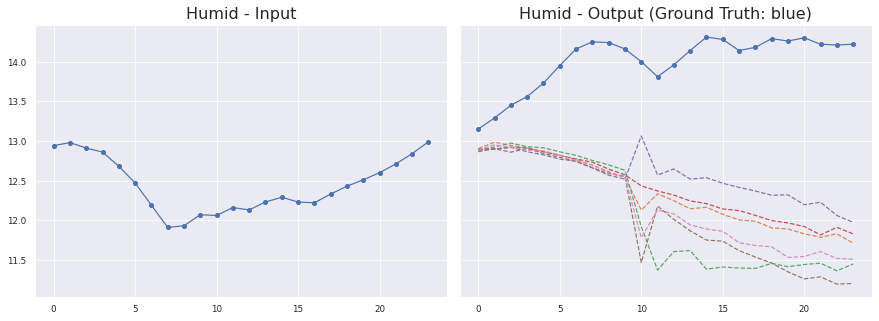

Sensor #6


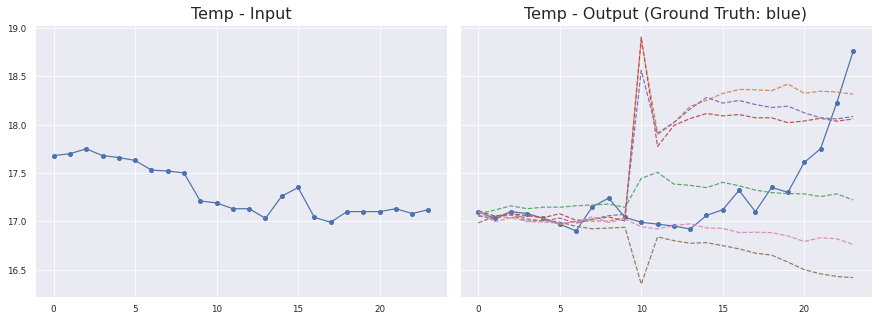

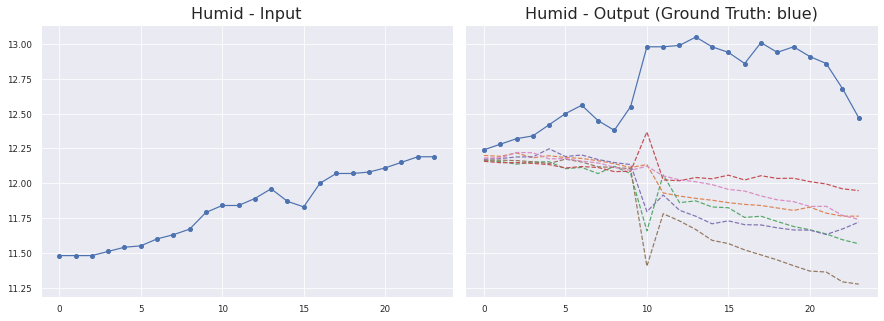

Sensor #5


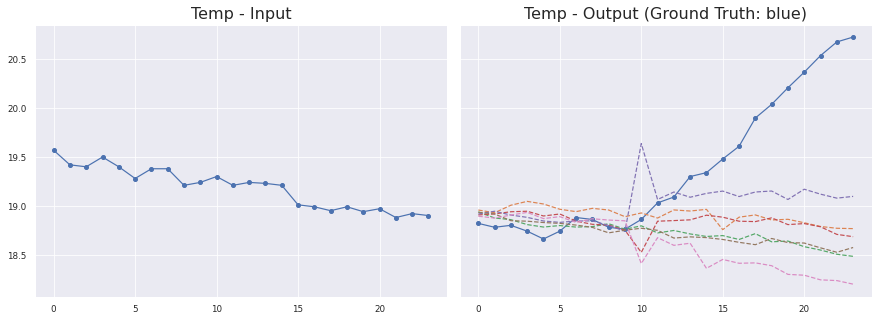

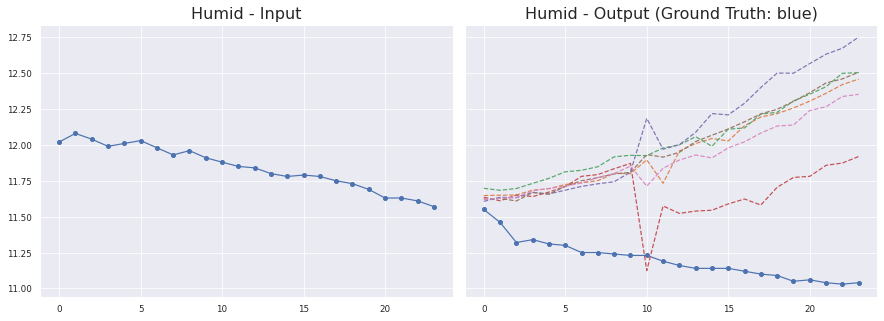

Sensor #4


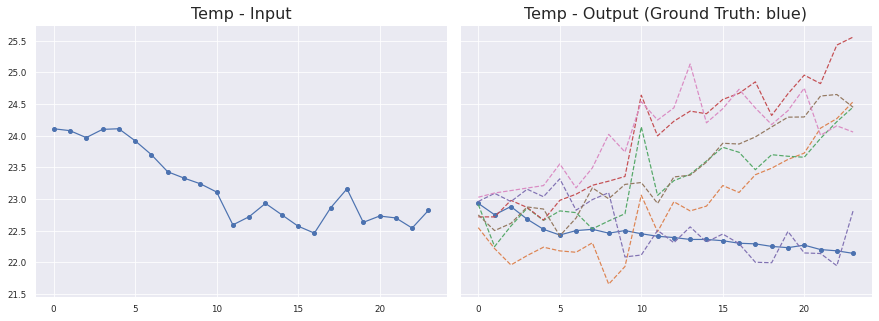

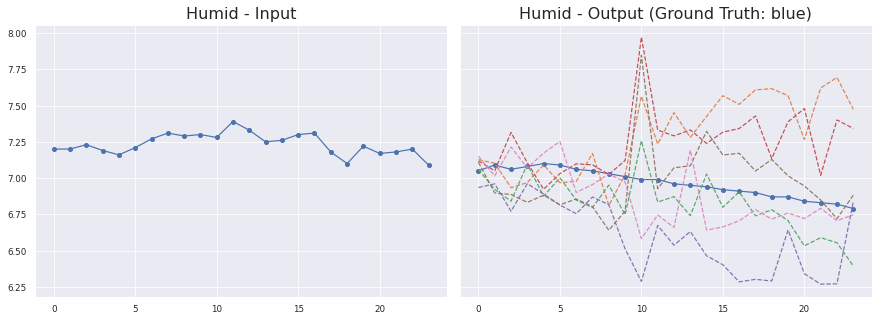

Sensor #0


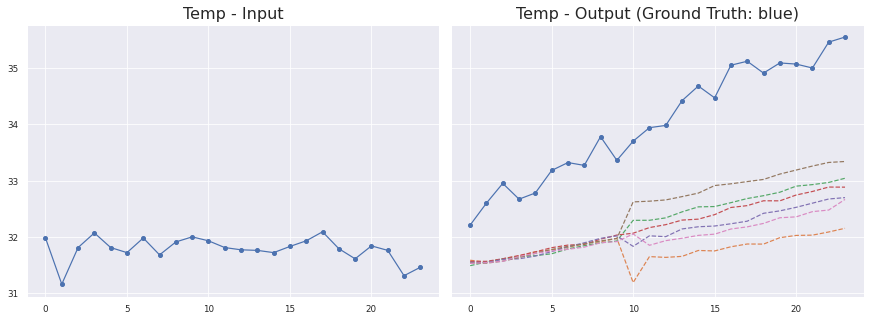

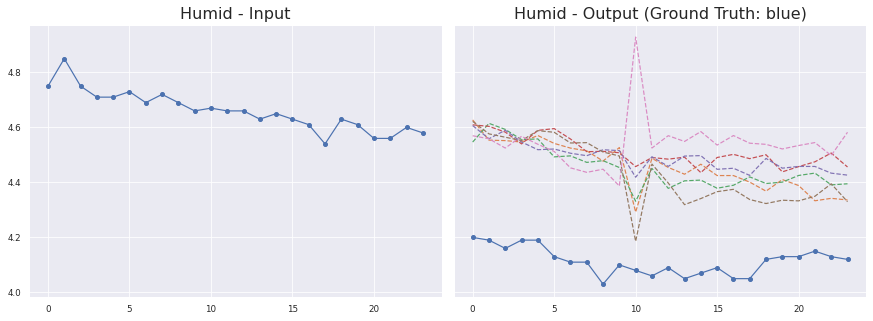

Sensor #5


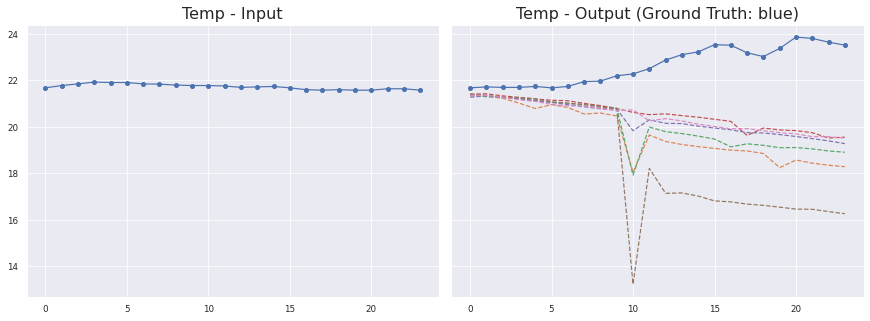

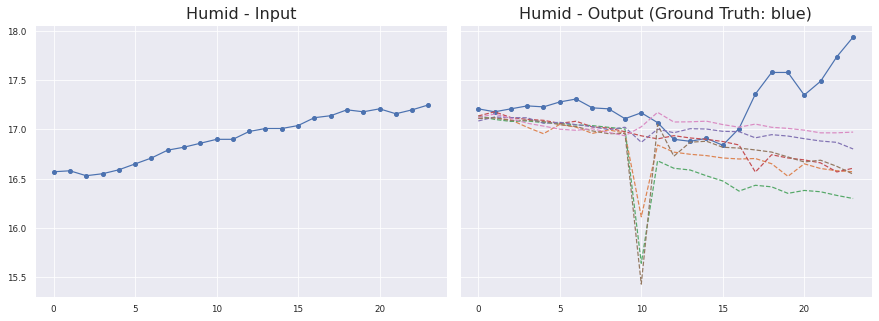

Sensor #4


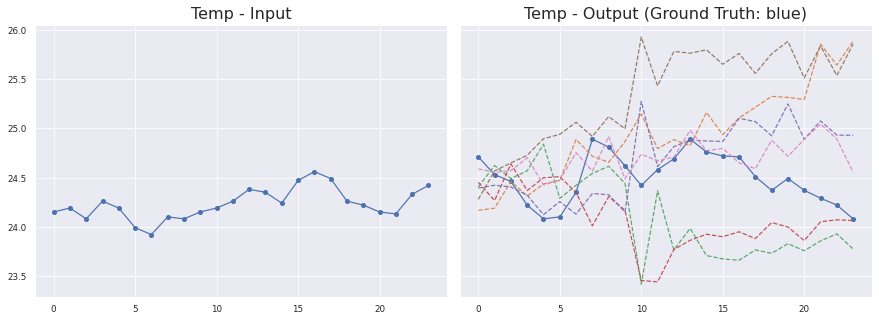

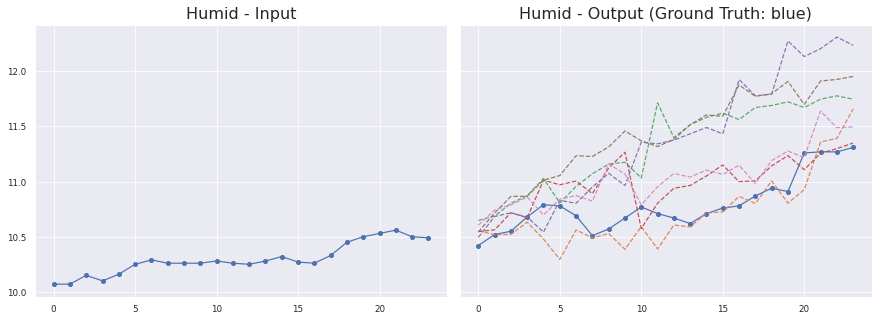

Sensor #5


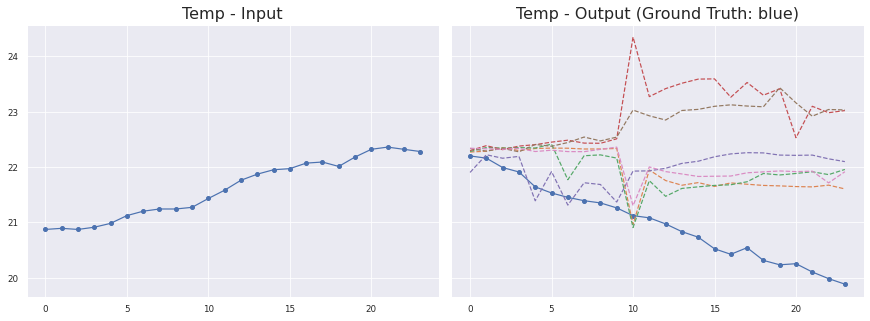

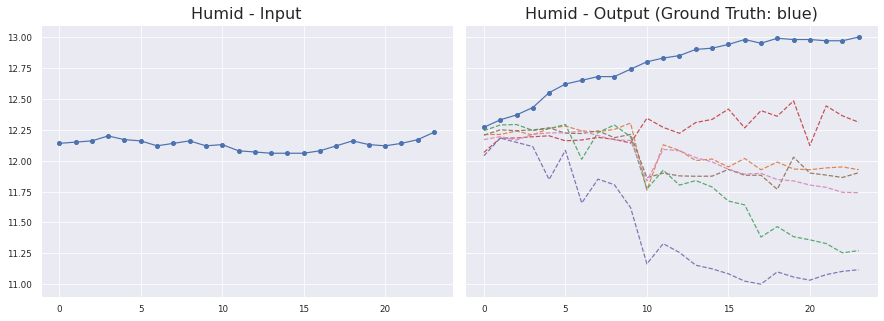

Sensor #5


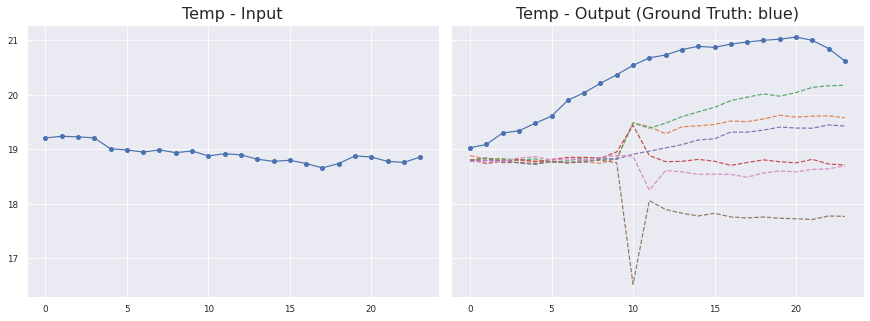

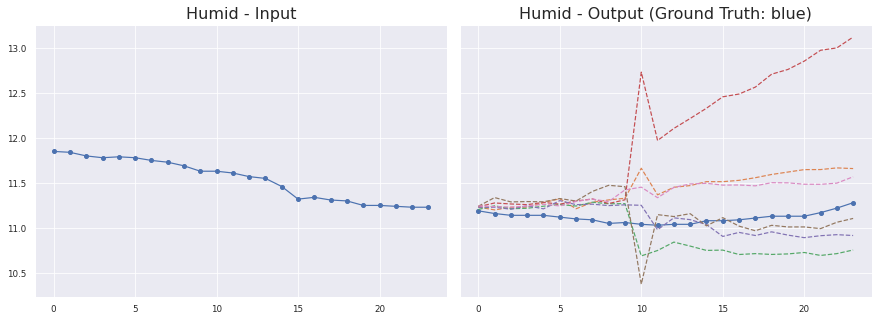

Sensor #0


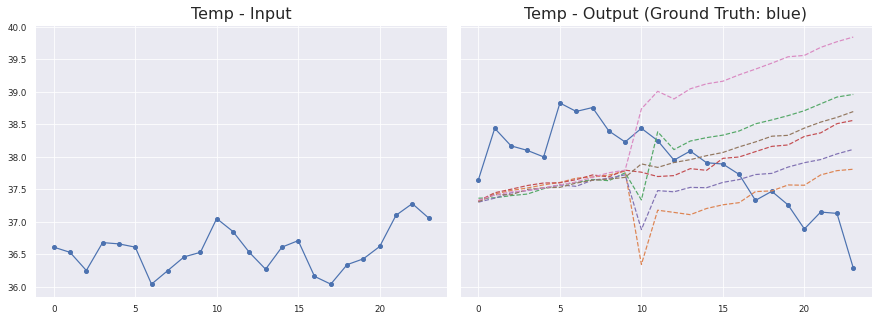

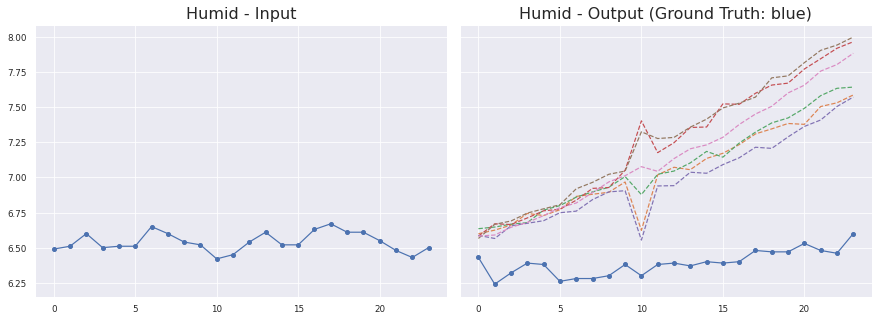

Sensor #5


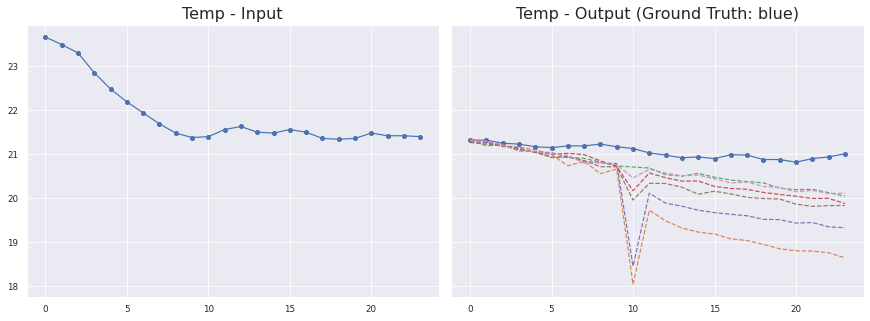

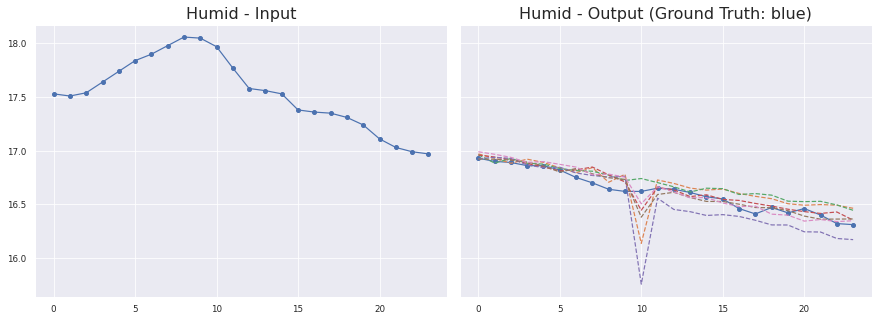

Sensor #3


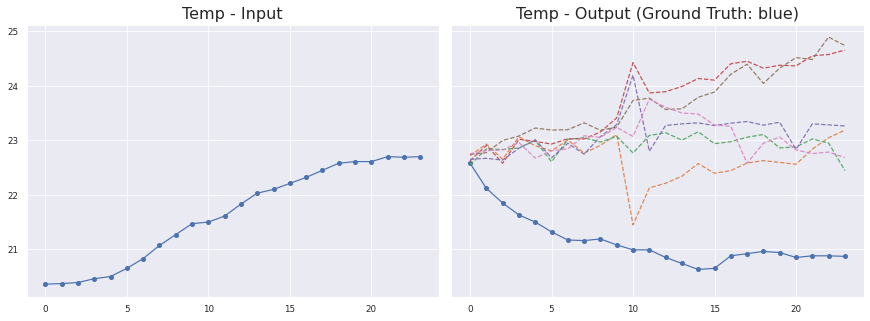

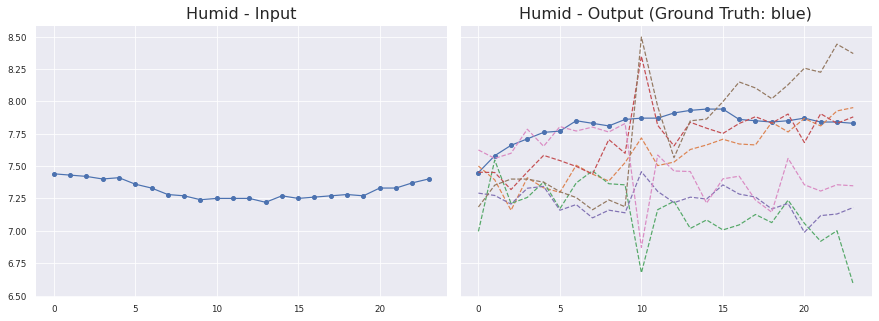

Sensor #0


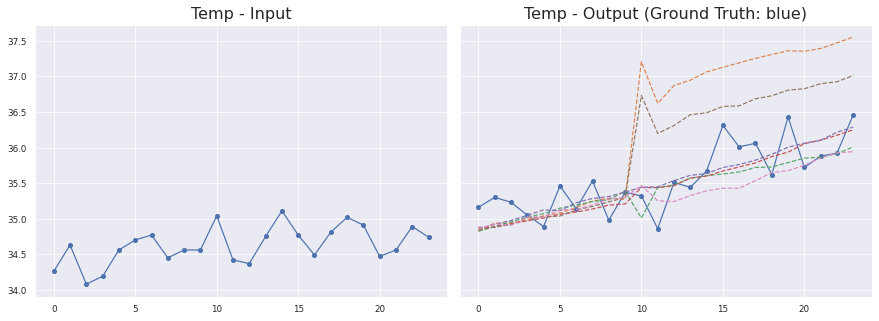

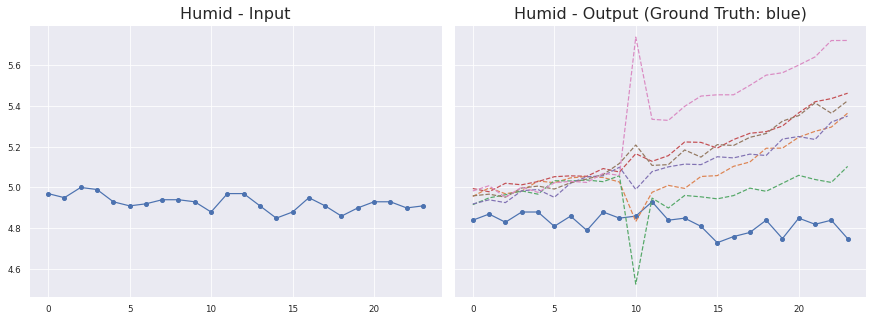

Sensor #3


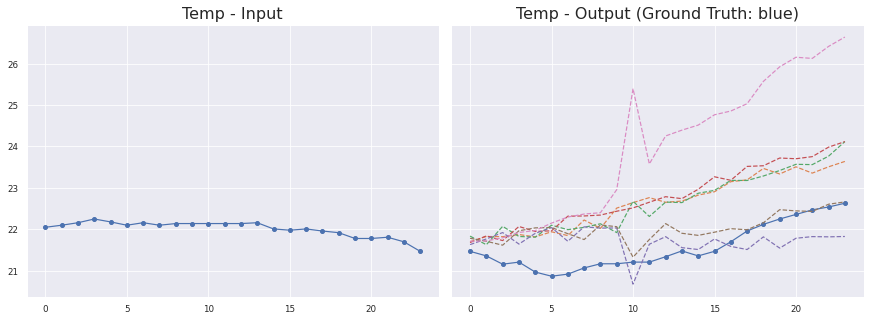

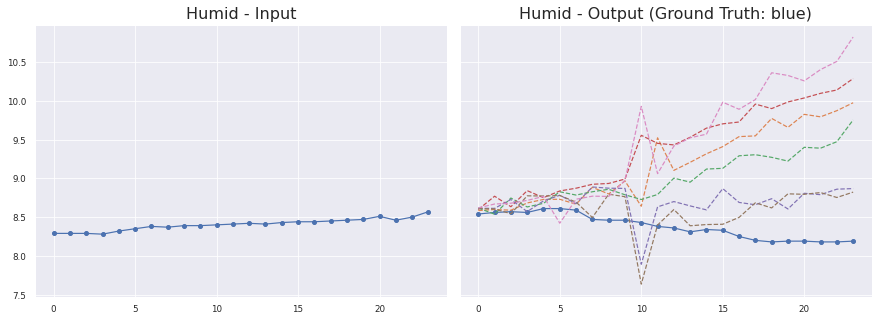

Sensor #3


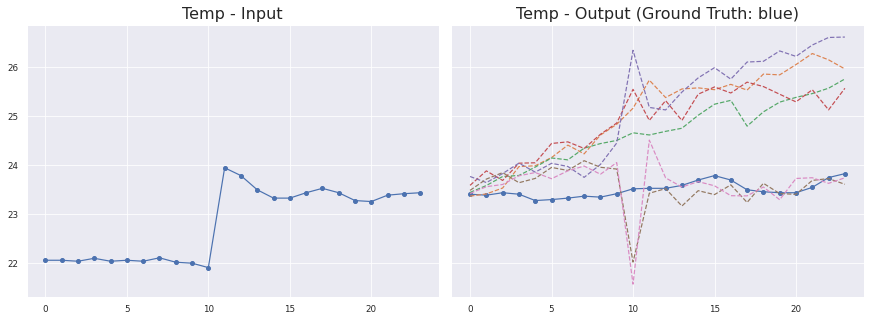

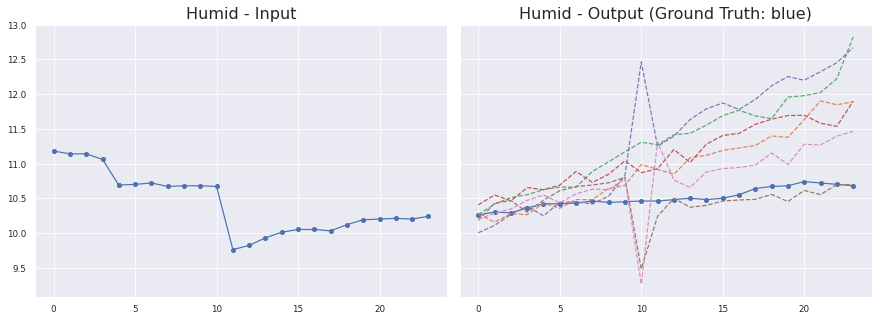

Sensor #6


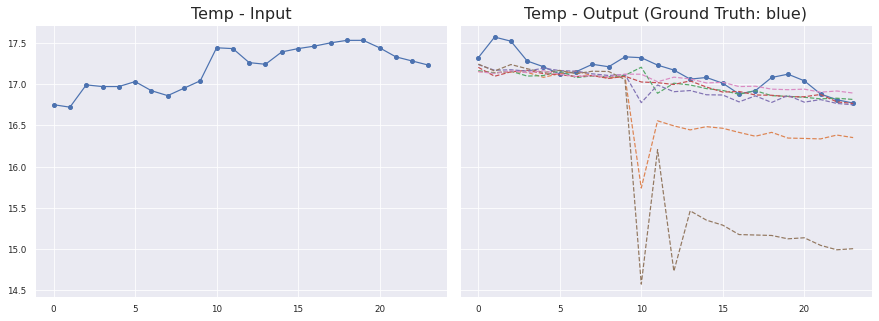

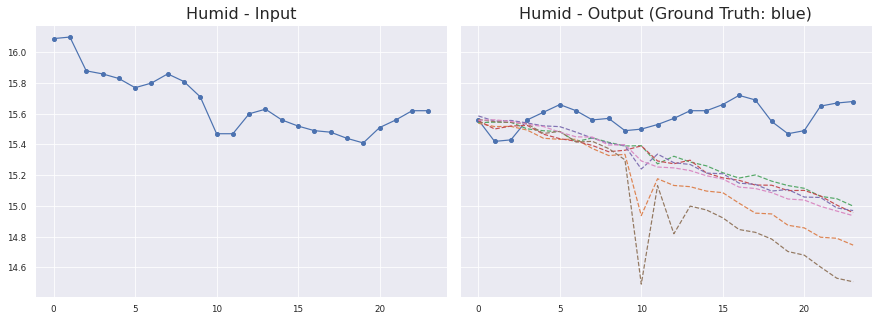

Sensor #3


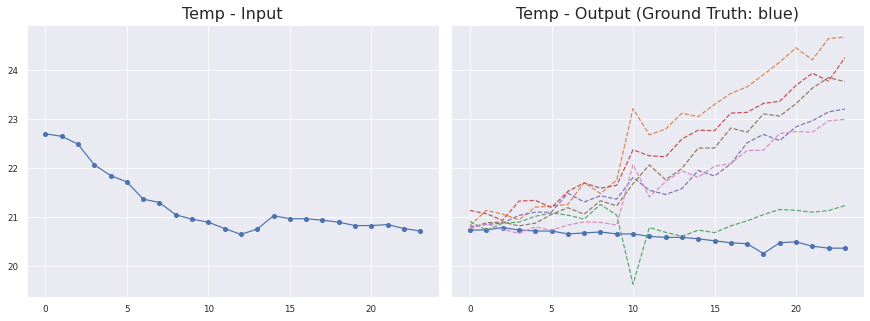

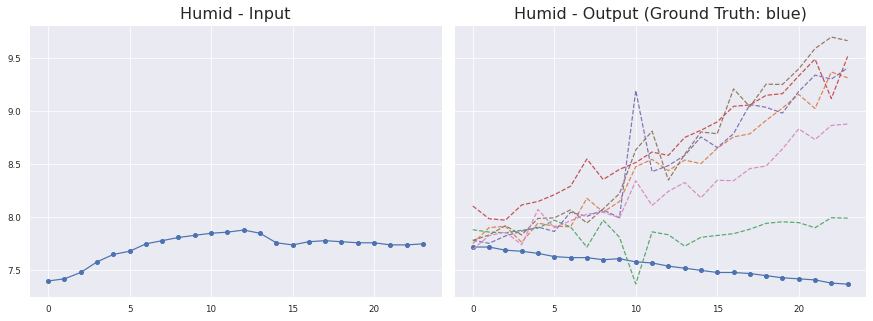

Sensor #5


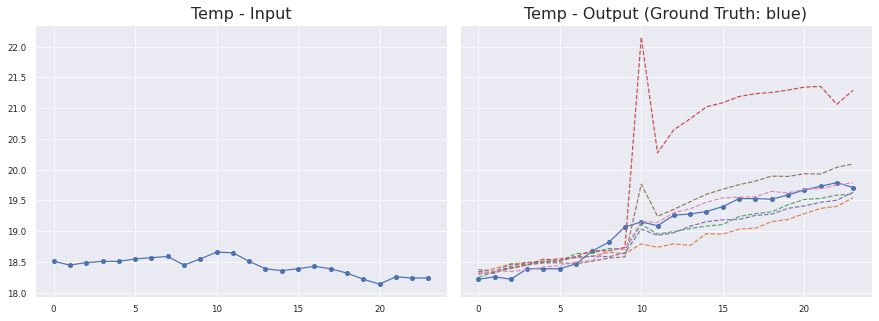

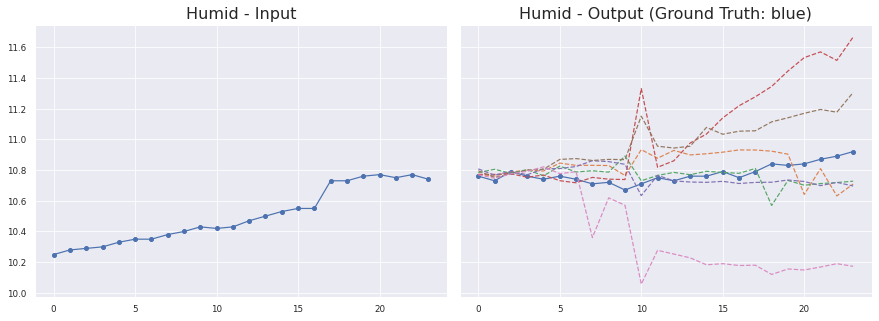

Sensor #3


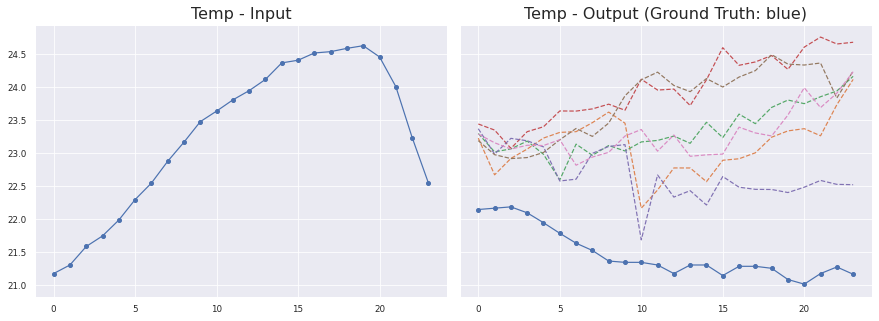

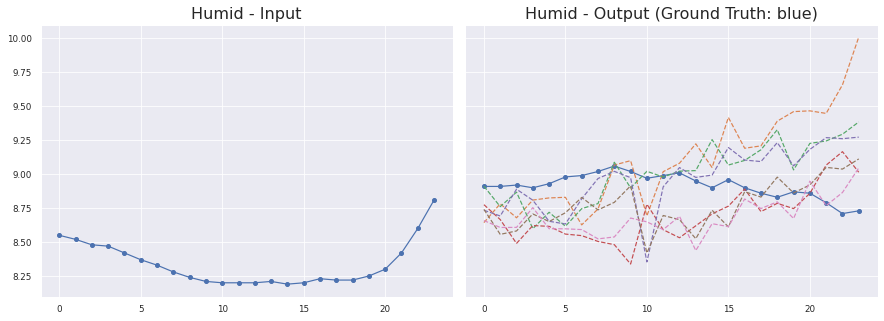

Sensor #4


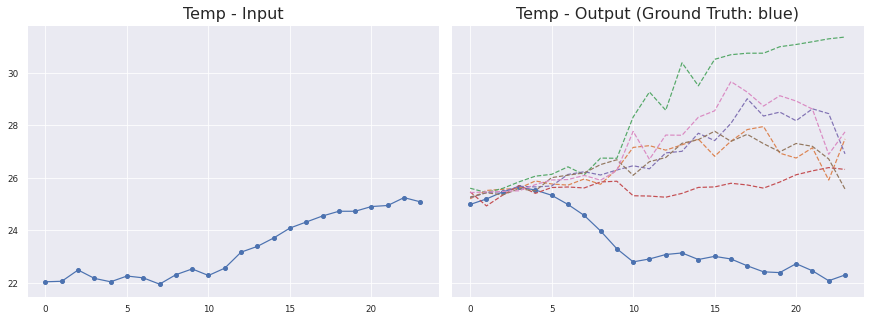

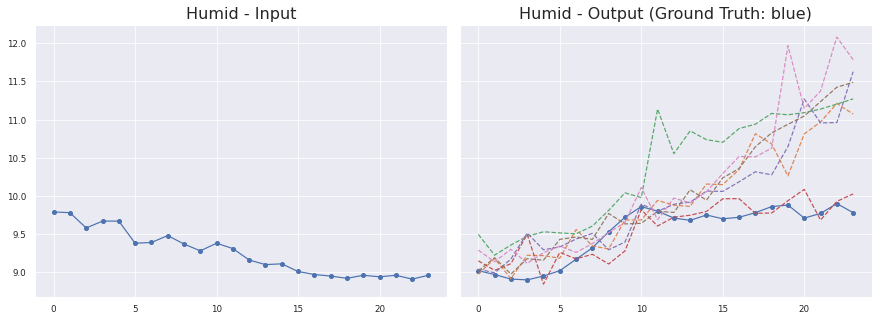

In [ ]:
n_samples = 20
n_scenarios = 6
n_prediction = 24

# Get real values
max_ix = 9999999
security_margin = len(list_ix) - (n_steps_in) 
while (max_ix > security_margin):
  ix_plot = np.random.choice(X_val_range, n_samples, replace=False)
  max_ix = np.amax(ix_plot)

X_cond = np.copy(X_sc[ix_plot])
X_label = np.copy(label_sc[ix_plot])
y_real = np.empty([n_samples, n_prediction, 2])
for k, index in enumerate(ix_plot):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real[k,:,:] = y_real_
print(f'y_real shape {y_real.shape}')

# Get predictions
# Final shape: [n_samples, n_scenarios, lenght, 2]
for scen in range(n_scenarios):
  X_aux_2 = np.copy(X_cond)
  for p in range(n_prediction):
    # Anomaly
    if p == 10:
      noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=10)
    else:
      noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=2.3)
    y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict [n_samples,2]
    y_gen = y_gen_[:,np.newaxis,:] #[n_samples,1,2]
    if p == 0: #Step 2: Save prediction
      y_gen_final = np.copy(y_gen)
    else:
      y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
    X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
    X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
  y_gen_final_aux = y_gen_final[:, np.newaxis, :, :]
  if scen == 0:
    y_gen_final_final = np.copy(y_gen_final_aux)
  else:
    y_gen_final_final = np.concatenate((y_gen_final_final, y_gen_final_aux), axis=1)

print(f'y generated shape: {y_gen_final_final.shape}') #shape: [20, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real.shape)
y_gen_inv = np.empty(y_gen_final_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(n_prediction):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=16)
    plt.show()
    plt.close()


### MH-GAN


In [ ]:
# calibrate the discriminator with Isotonic Regression
from sklearn.isotonic import IsotonicRegression

calibrator = IsotonicRegression(0,1)

# take 20% of training set to calibrate
n_samples = round(len(list_ix)*0.2)
ix_plot = np.random.choice(list_ix[:-24], n_samples, replace=False)
X_cond = np.copy(X_sc[ix_plot])
X_label = np.copy(label_sc[ix_plot])
y_test = np.copy(y_sc[ix_plot])

noise_calibrate = tf.random.normal(shape=(n_samples, latent_dim))
test_gen_ = selected_generator.predict([X_cond,X_label,noise_calibrate]) # [n_samples, 2]
test_gen = test_gen_[:,np.newaxis,:] #[n_samples,1,2]
input_cal_gen = np.concatenate((X_cond,test_gen), axis=1)  #shape:[n_samples,25,2]
print(input_cal_gen.shape)
# real test input to discriminator
input_cal_real = np.concatenate((X_cond,y_test), axis=1) #shape:[n_samples,25,2]
print(input_cal_real.shape)
# concatenate gen and real
input_cal = np.concatenate((input_cal_real,input_cal_gen), axis=0)
input_label = np.concatenate((X_label,X_label), axis=0)
# predict
predict_cal = selected_critic.predict([input_cal, input_label]).reshape((n_samples*2,))
print(predict_cal.shape)
y_cal = np.array([0]*n_samples + [1]*n_samples)
# fit calibrator
calibrator.fit(predict_cal, y_cal)

(25153, 25, 2)
(25153, 25, 2)
(50306,)


IsotonicRegression(increasing=True, out_of_bounds='nan', y_max=1, y_min=0)

In [ ]:
def calibrated_score(X, label, calibrator):
  s = selected_critic.predict([X, label]).reshape((X.shape[0],)) # [X.shape[0],]
  return calibrator.transform(s) # [X.shape, 1]

In [ ]:
n_prediction = 24
n_samples = 50
n_scenarios = 6
n_steps_MH_GAN = 20

# get random samples (index)
ix = random.sample(list_ix[:-24], k=n_samples)

# final numpy arrays
y_real_final = np.empty([n_samples,n_prediction,2]) #shape:[10,12,2]

# real values
for k, index in enumerate(ix):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real_final[k,:,:] = y_real_
print(f'y_real shape {y_real_final.shape}')

X_cond = np.copy(X_sc[ix])
X_label = np.copy(label_sc[ix])

# get predictions
y_gen_final = np.empty([n_samples, n_scenarios, n_prediction, 2])
for n in range(n_samples):
  X_aux_2 = X_cond[n].reshape(1,24,2)
  X_label_in = X_label[n].reshape(1,)
  for scen in range(n_scenarios):
    for p in range(n_prediction): 
      # initial real sample
      ix_init = random.sample(list_ix[:-24], k=1)
      X_ = X_sc[ix_init] #[1,24,2]
      y = y_sc[ix_init] #[1, 1,2]
      X = np.concatenate((X_,y), axis=1)
      X_label_init = label_sc[ix_init]
      y_score = calibrated_score(X, X_label_init, calibrator) #[1,1]
      for iter in range(n_steps_MH_GAN): #number of tries of new vector inputs
        # generate sample
        noise_point = tf.random.normal(shape=(1, latent_dim), stddev=2.3) #shape:[1,Latent_dim]
        if iter == 0:
          selected_noise_point = noise_point
        y_gen_MH_GAN_ = selected_generator.predict([X_aux_2, X_label_in, noise_point]) #Step 1: Predict [1,2]
        y_gen_MH_GAN = y_gen_MH_GAN_[:,np.newaxis,:] #[1,1,2]
        In_MH_GAN = np.concatenate((X_aux_2,y_gen_MH_GAN), axis=1)  #shape:[1,25,2]
        Scores_MH_GAN = calibrated_score(In_MH_GAN, X_label_in, calibrator)  #shape:[1,]
        u = np.random.uniform(0,1)
        if u >= np.fmin(1, ( (1/y_score - 1)/(1/Scores_MH_GAN - 1))):
          print('JUMP!')
          y_score = Scores_MH_GAN
          selected_noise_point = noise_point

      y_gen_ = selected_generator.predict([X_aux_2, X_label_in, selected_noise_point]) #Step 1: Predict [1,2]
      y_gen = y_gen_[:,np.newaxis,:] #[1,1,2]
      y_gen_final[n,scen,p,:] = y_gen_ #Step 2: Save prediction
      X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    X_aux_2 = X_cond[n].reshape(1,24,2)
  print(f'Working... {(100/n_samples)*(n+1)}%')

print(y_gen_final.shape) #shape: [6, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real_final.shape)
y_gen_inv = np.empty(y_gen_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(24):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=16)
    plt.show()
    plt.close()

y_real shape (50, 24, 2)
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 2.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 4.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 6.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 8.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 10.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 12.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 14.0%
JUMP!
JUMP!
Working... 16.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 18.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 20.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 22.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
Working... 24.0%
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
JUMP!
J

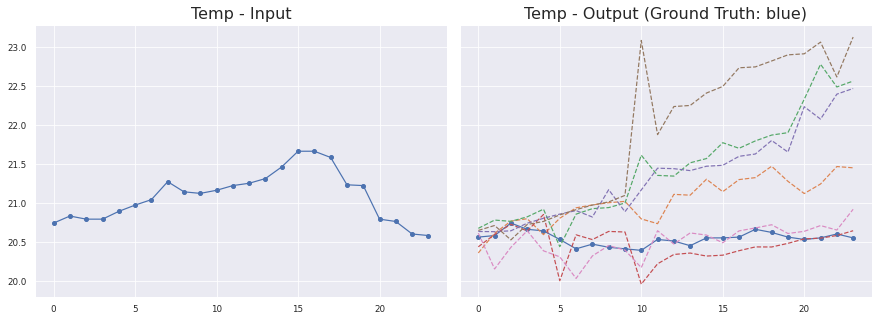

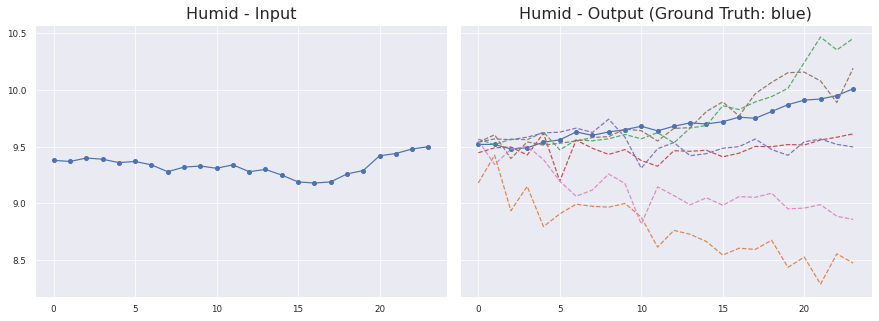

Sensor #0


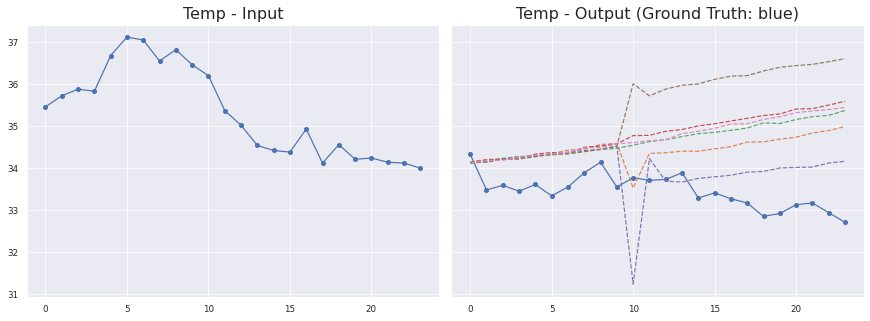

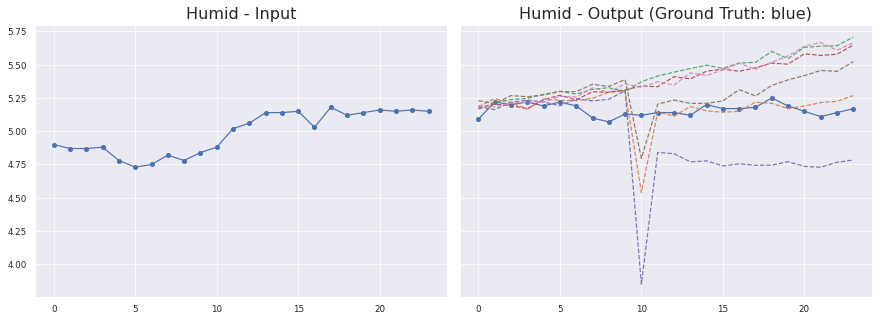

Sensor #20


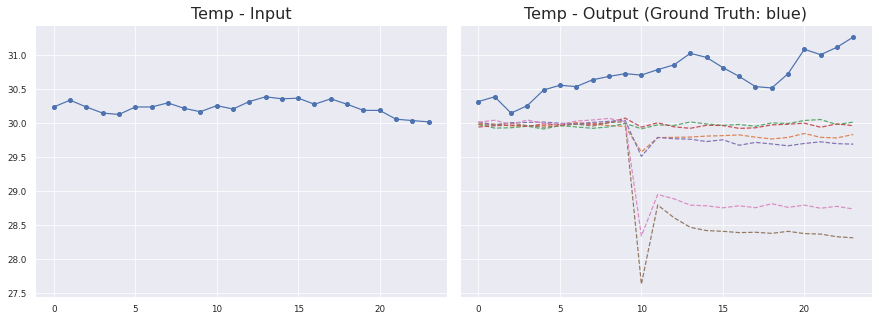

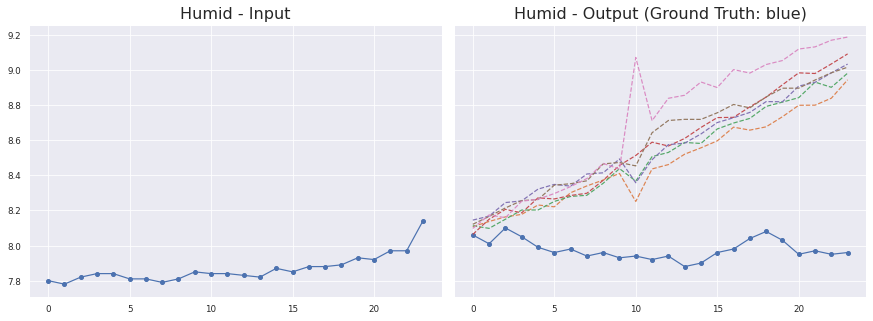

Sensor #21


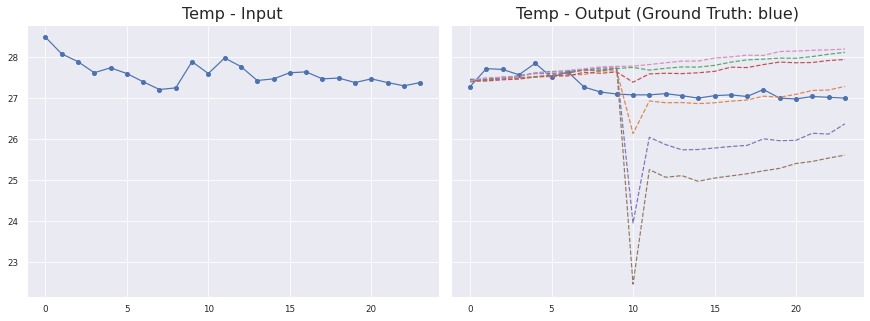

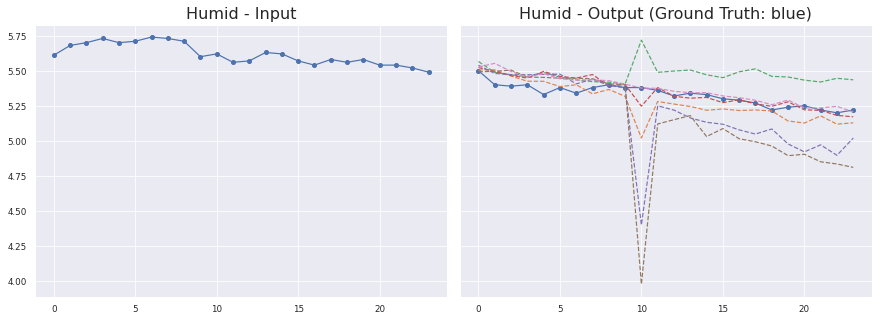

Sensor #4


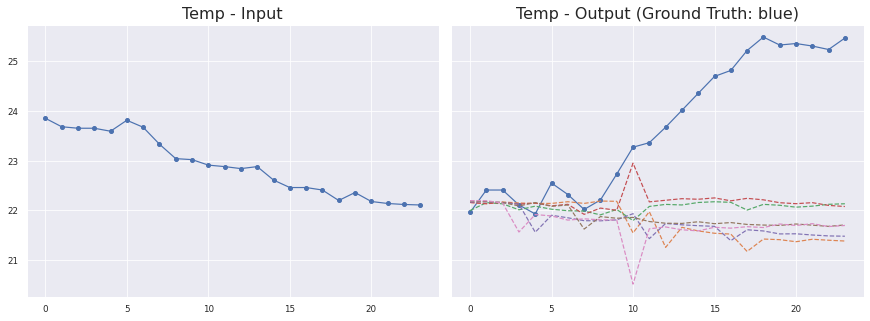

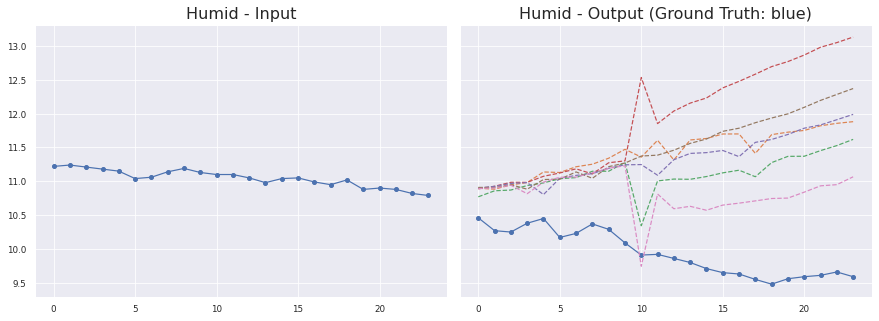

Sensor #9


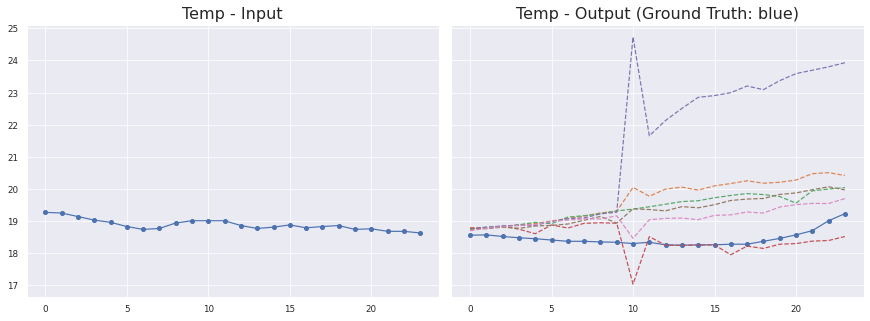

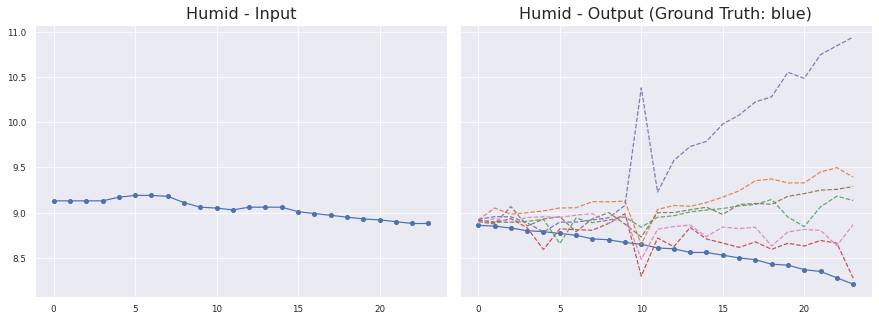

Sensor #17


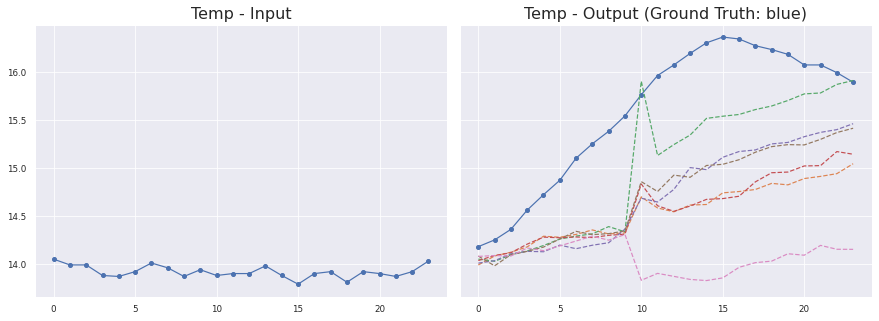

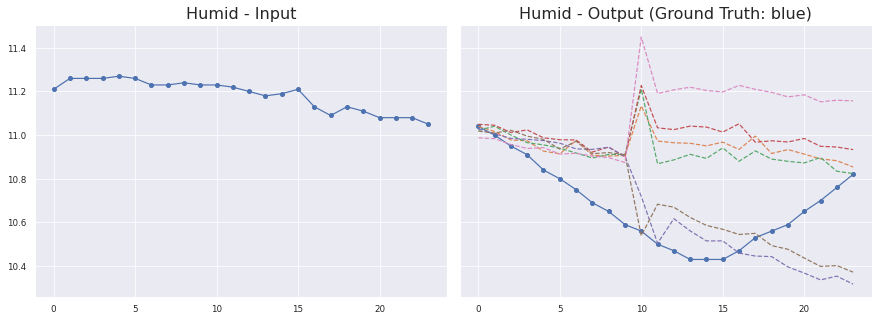

Sensor #30


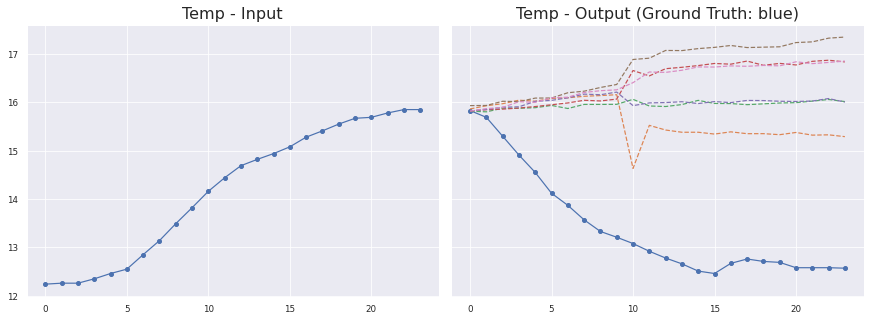

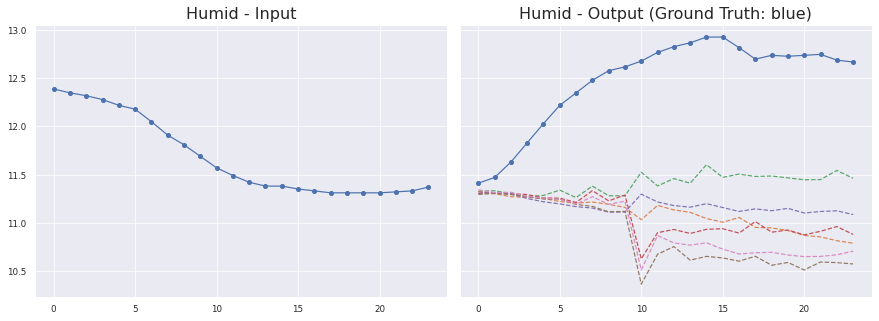

Sensor #22


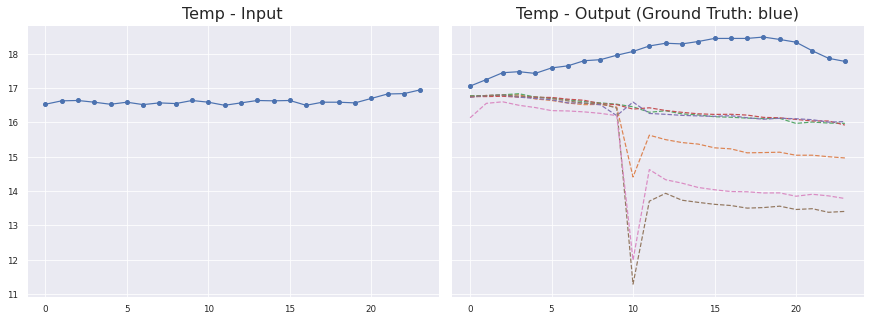

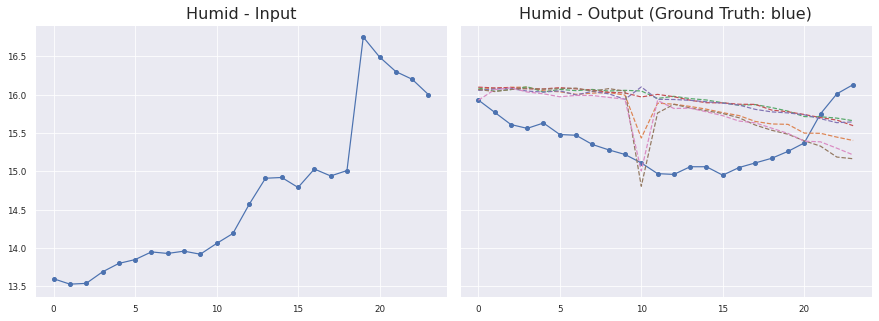

Sensor #2


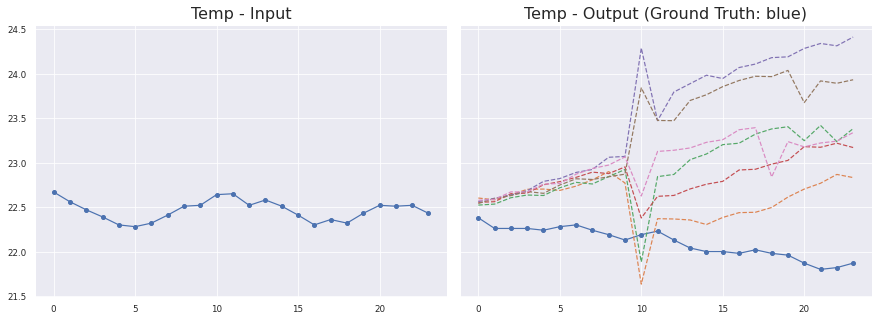

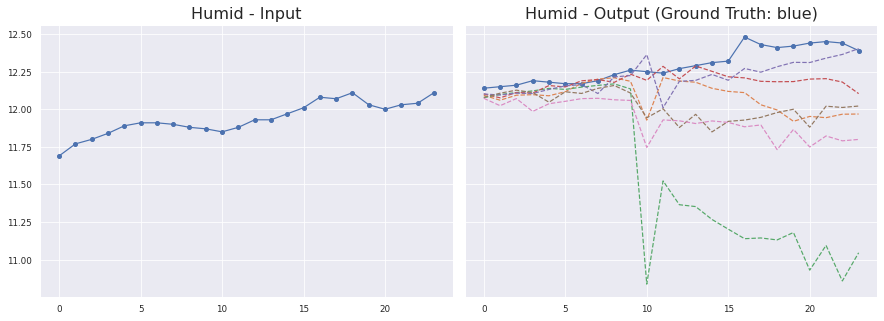

Sensor #3


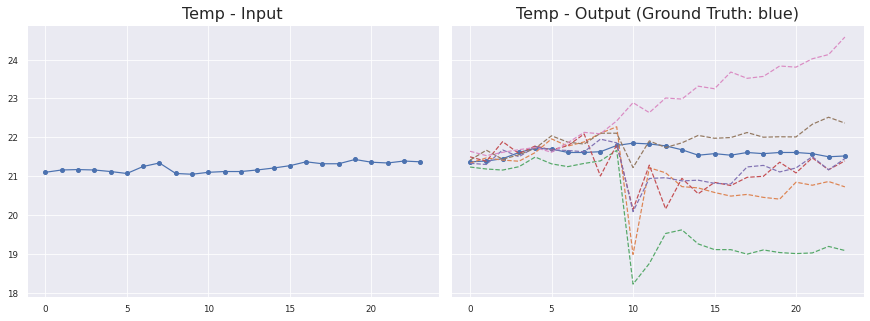

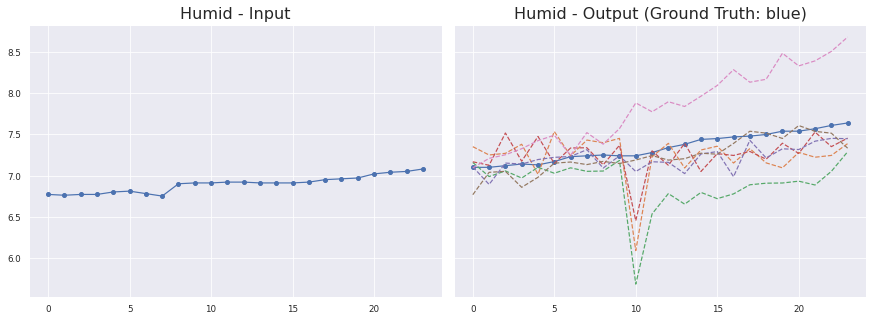

Sensor #9


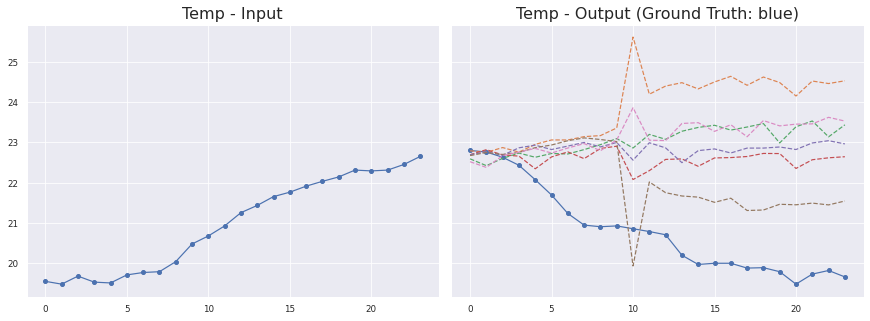

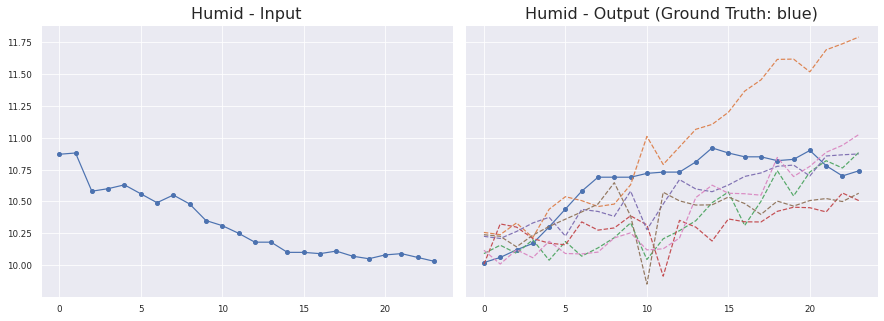

Sensor #11


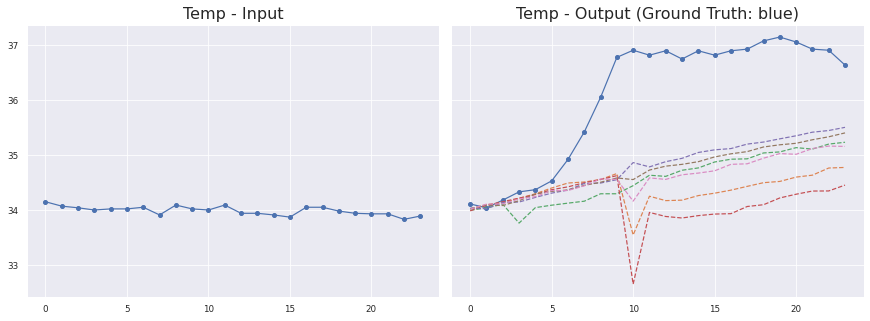

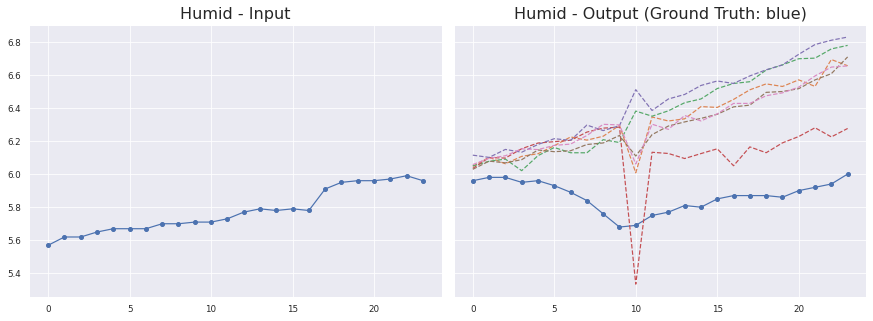

Sensor #19


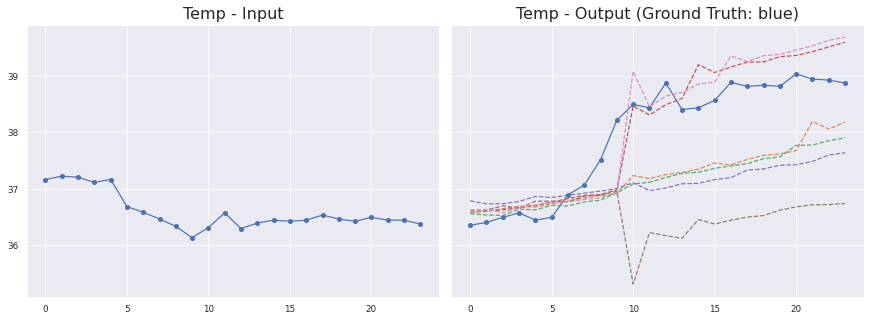

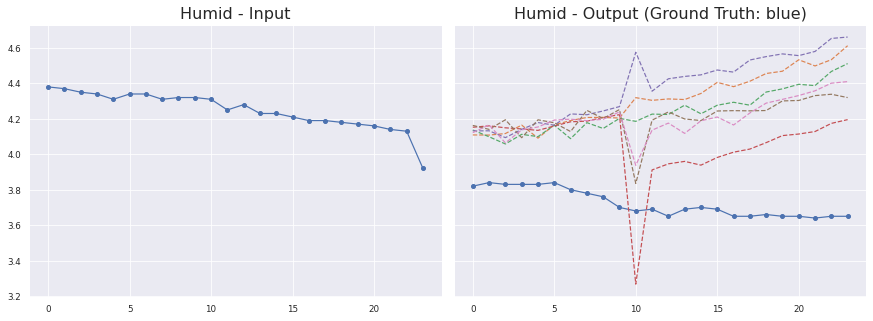

Sensor #26


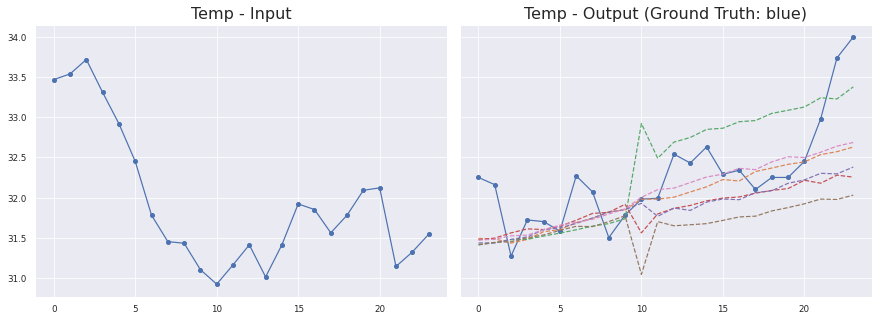

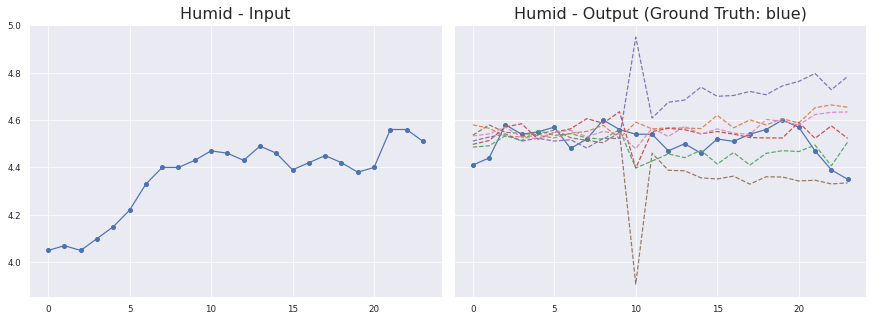

Sensor #31


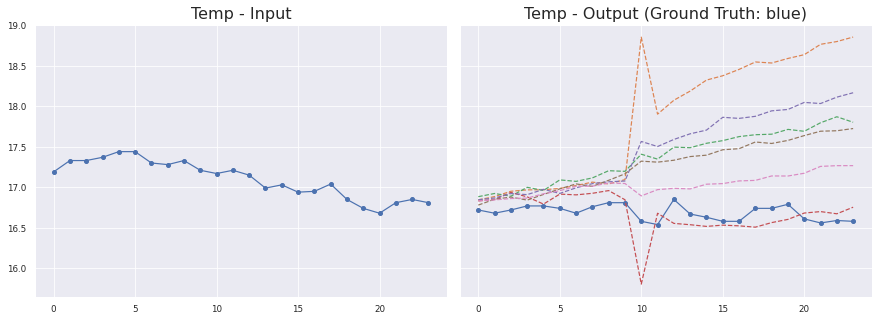

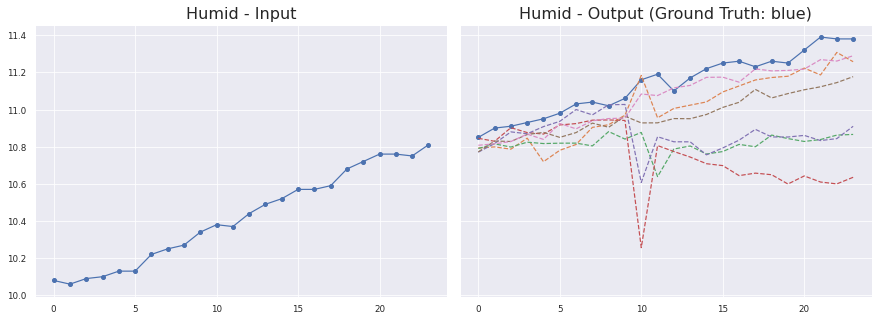

Sensor #23


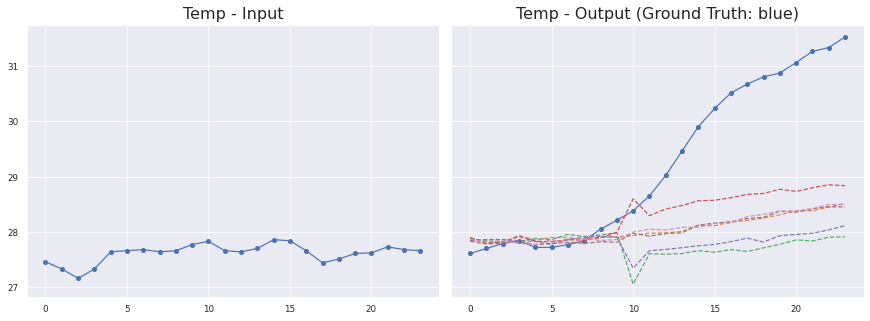

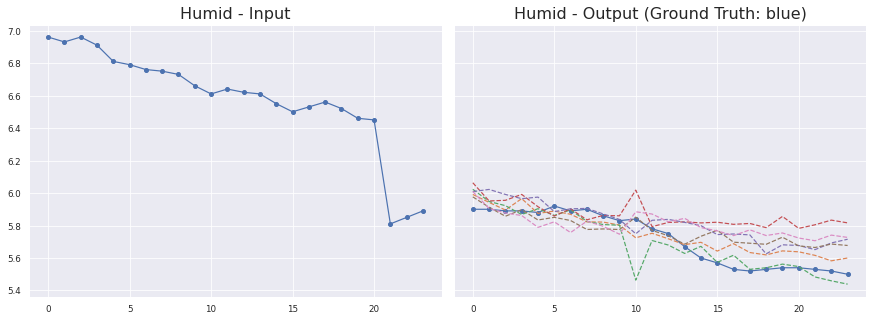

Sensor #1


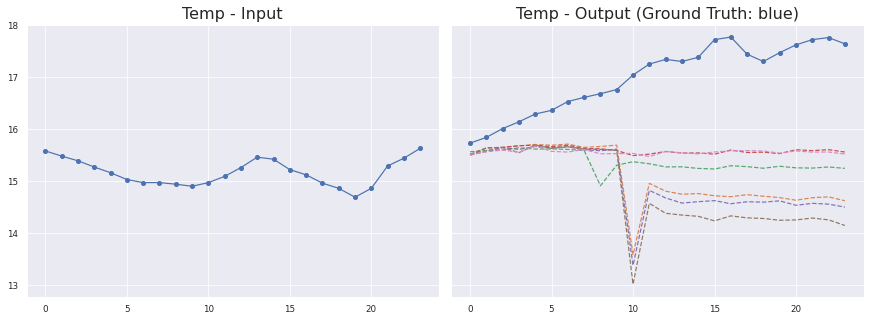

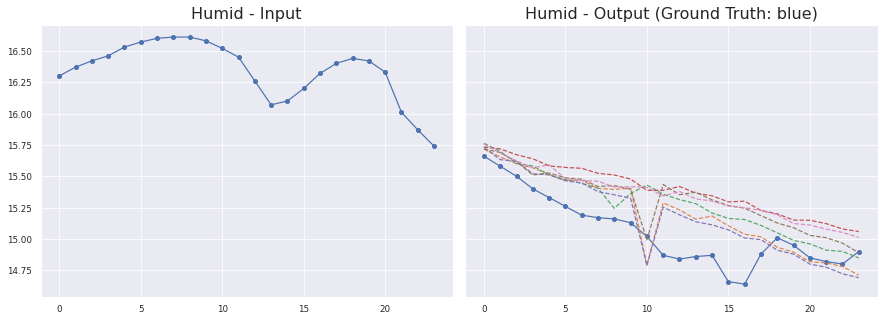

Sensor #33


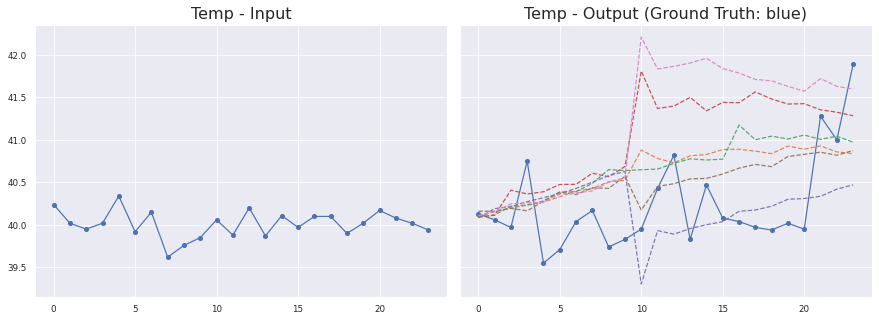

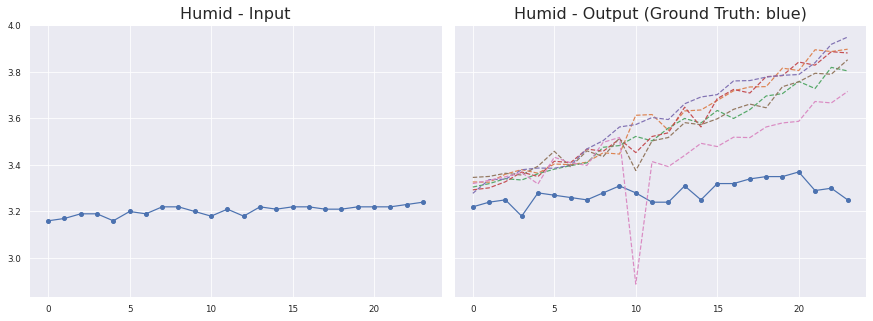

Sensor #9


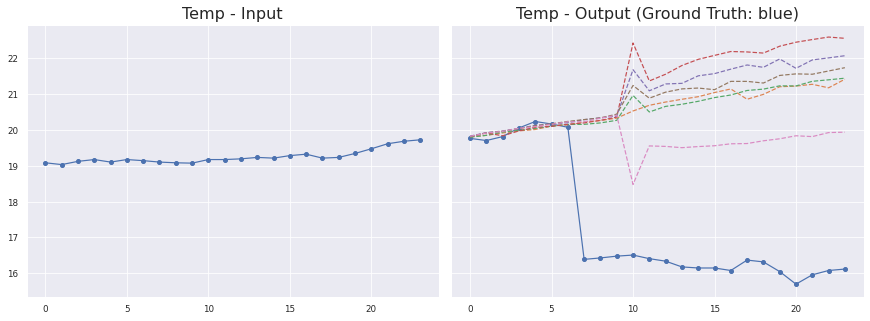

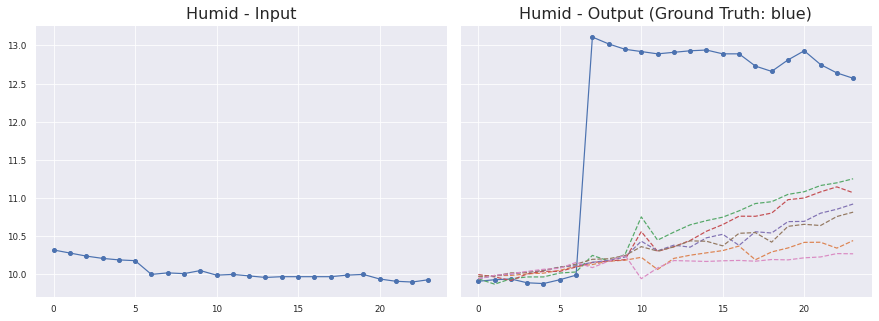

Sensor #11


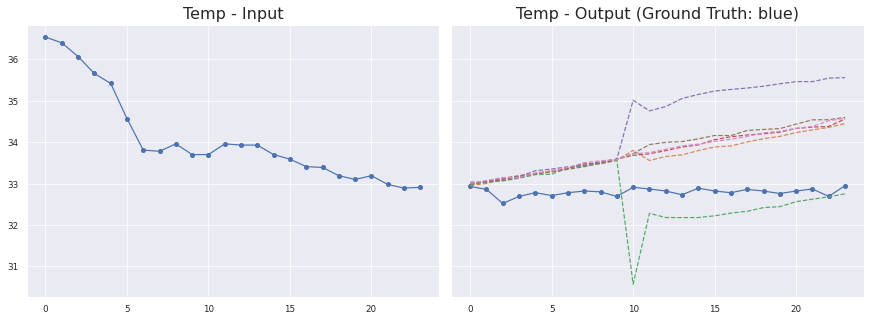

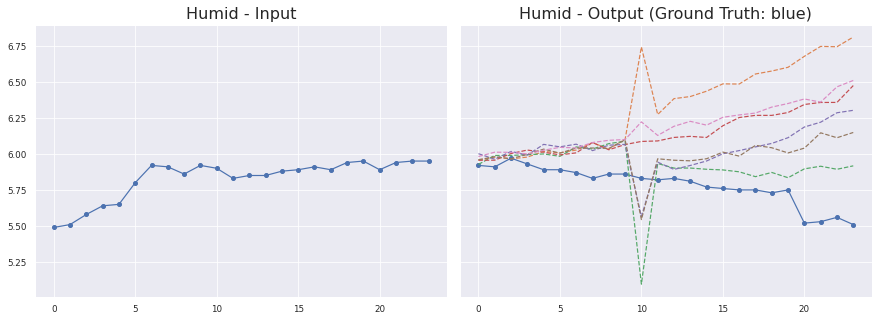

Sensor #13


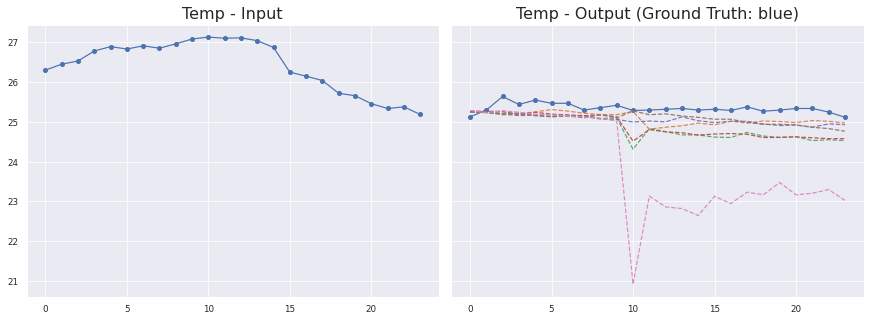

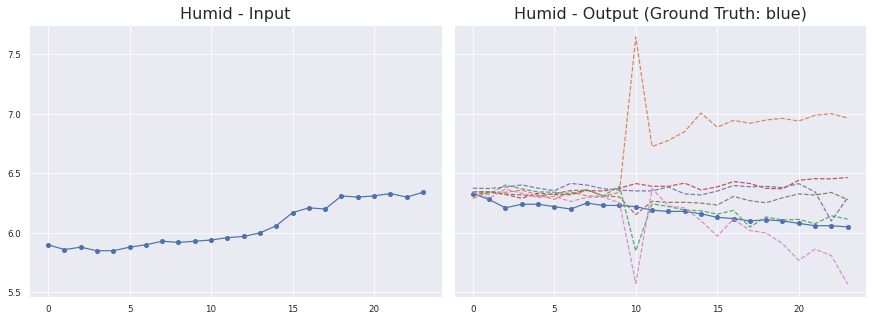

Sensor #20


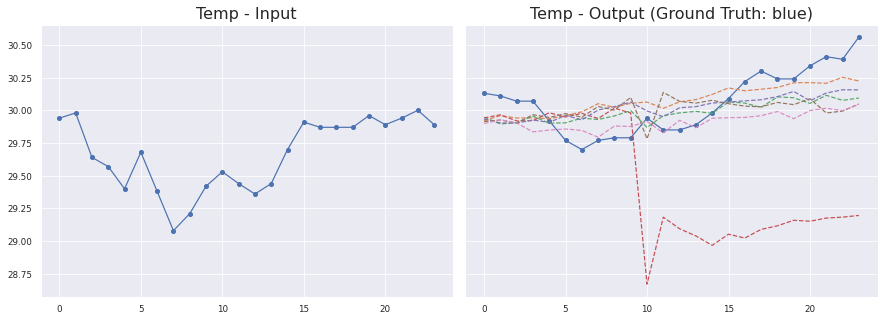

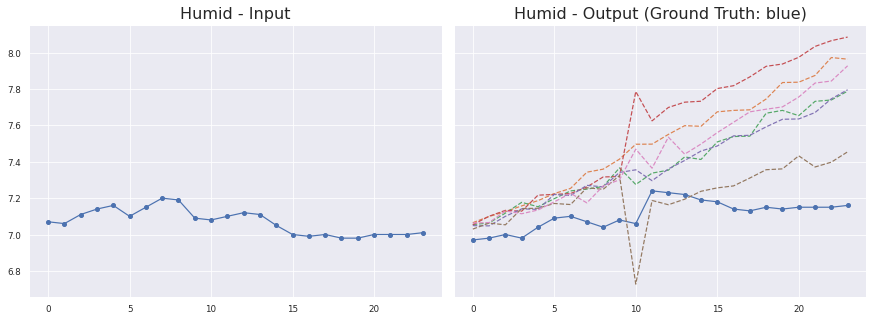

Sensor #31


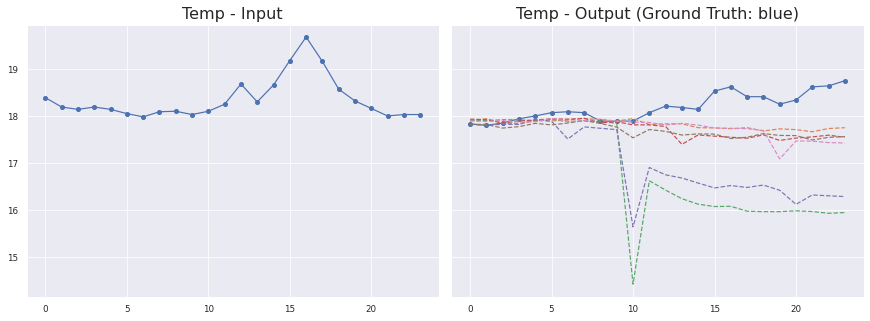

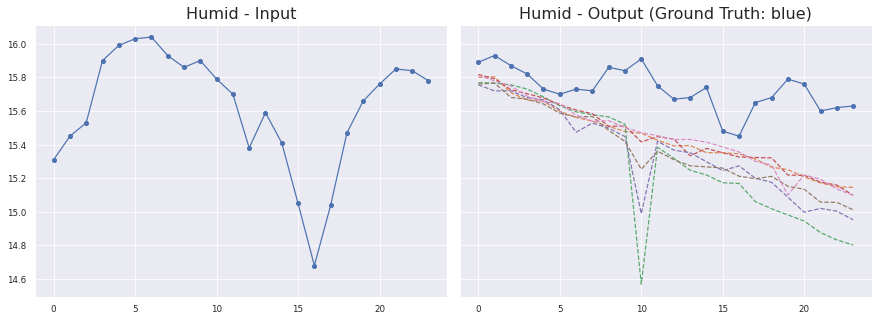

Sensor #25


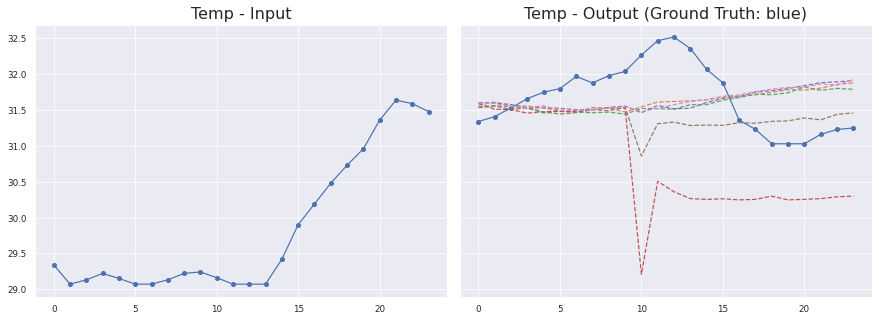

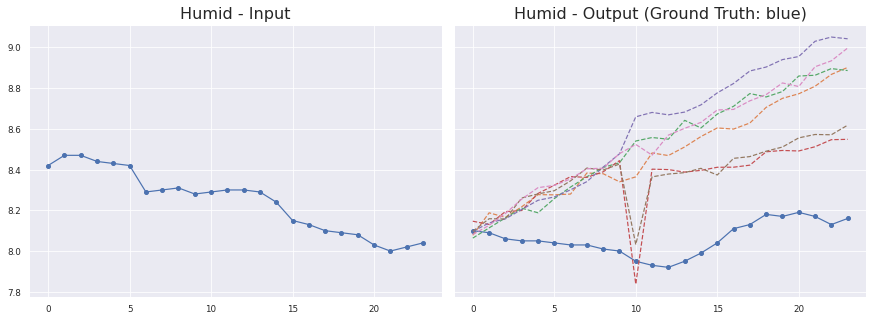

Sensor #19


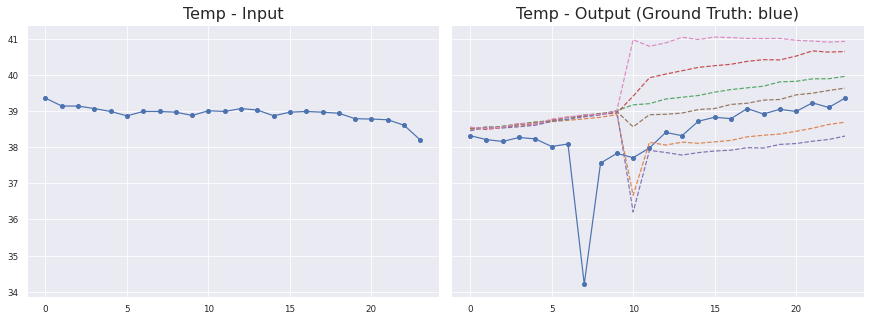

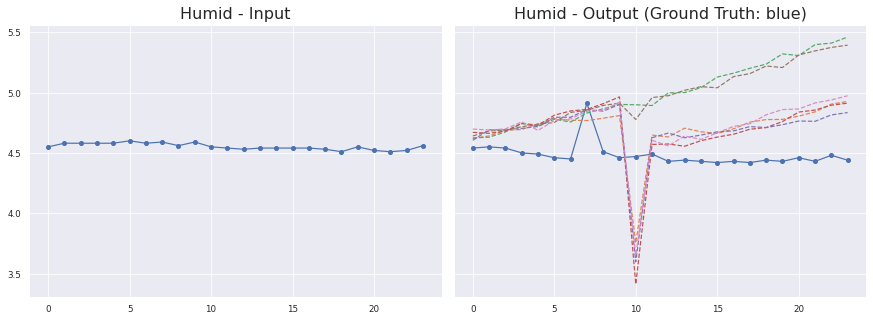

Sensor #26


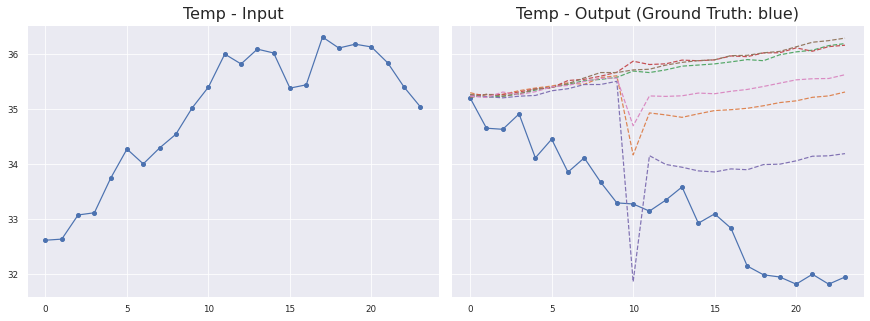

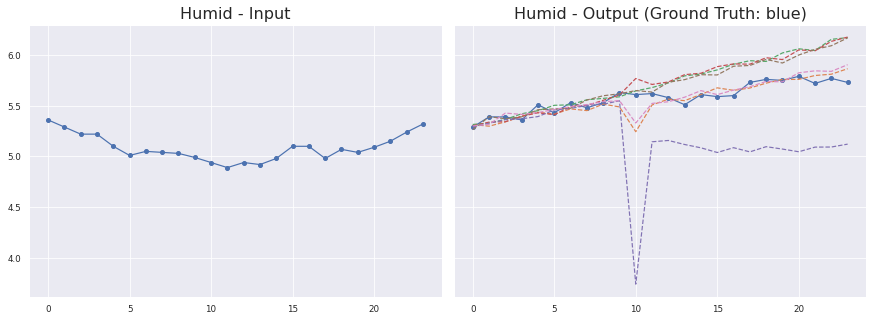

Sensor #22


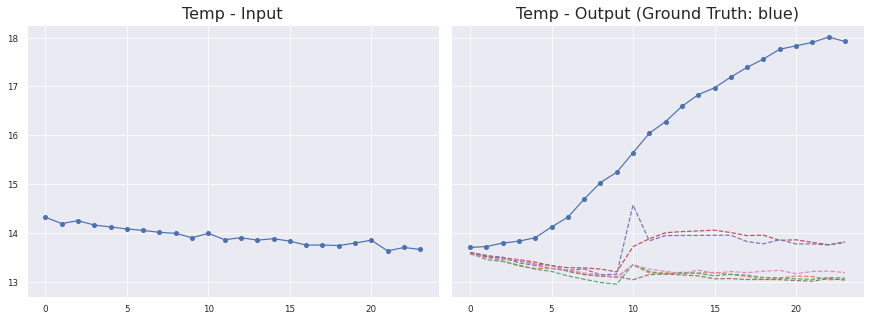

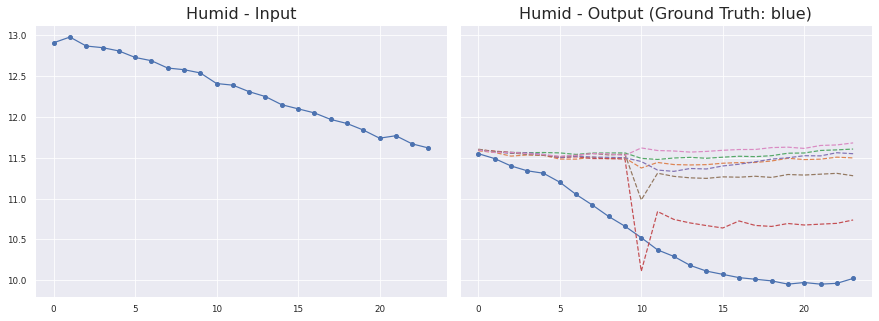

Sensor #12


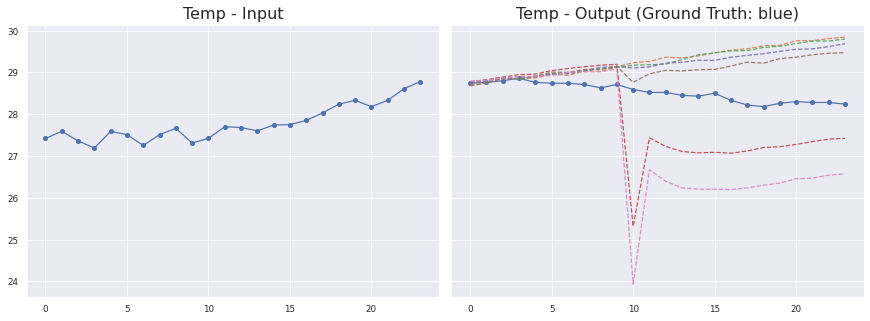

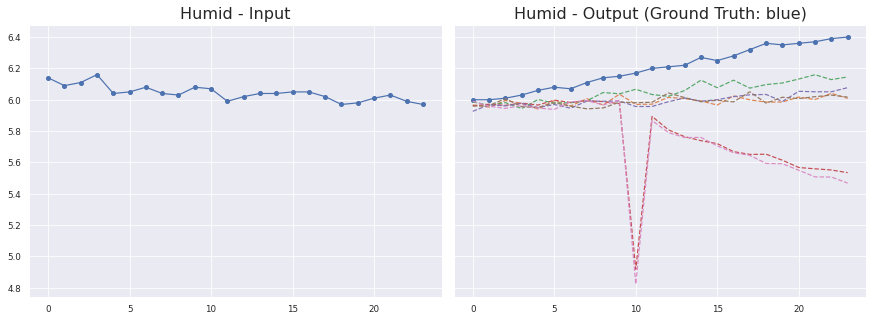

Sensor #21


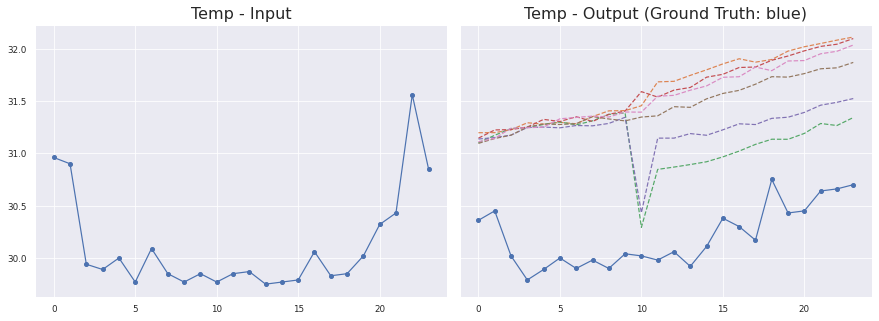

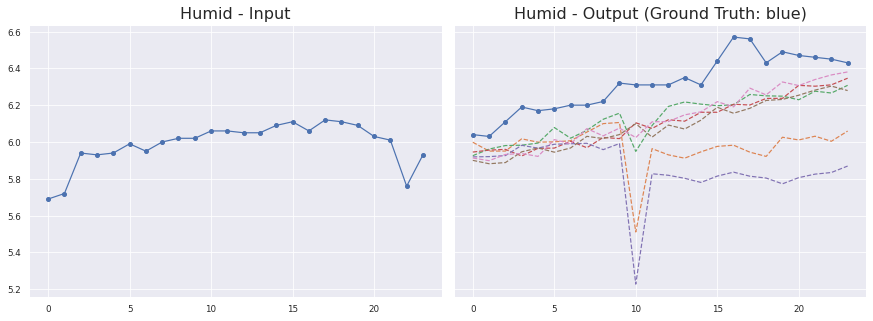

Sensor #15


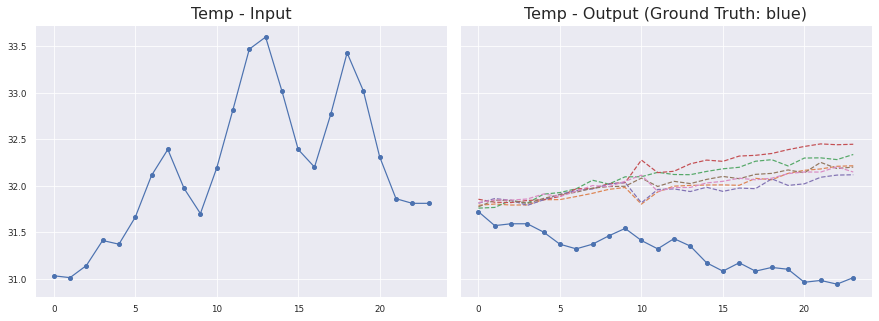

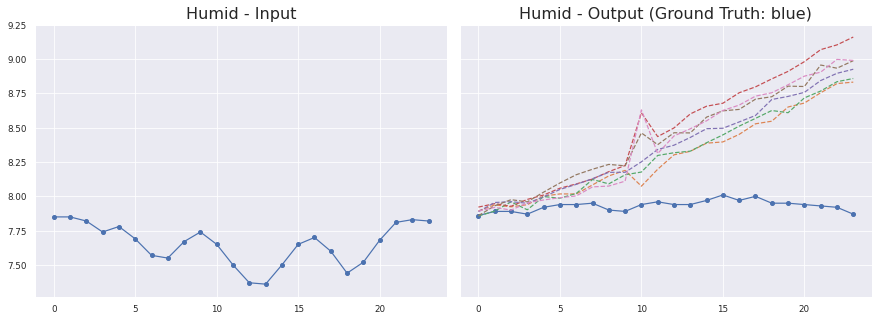

Sensor #32


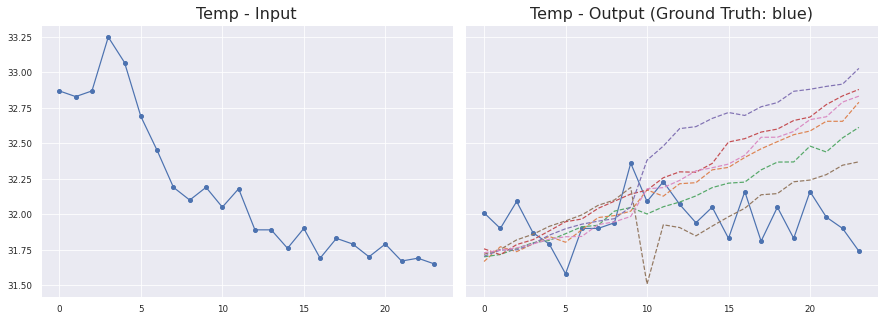

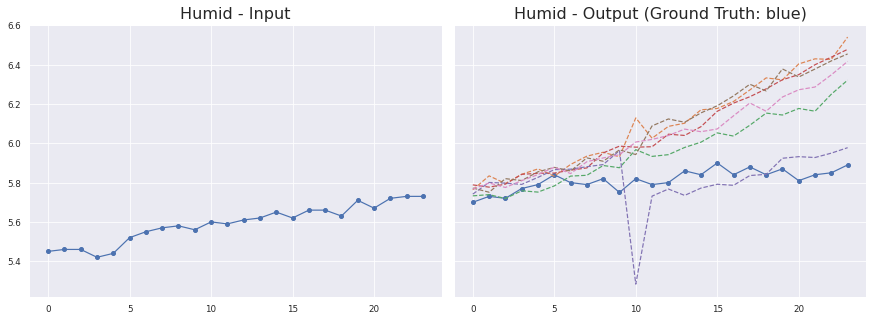

Sensor #17


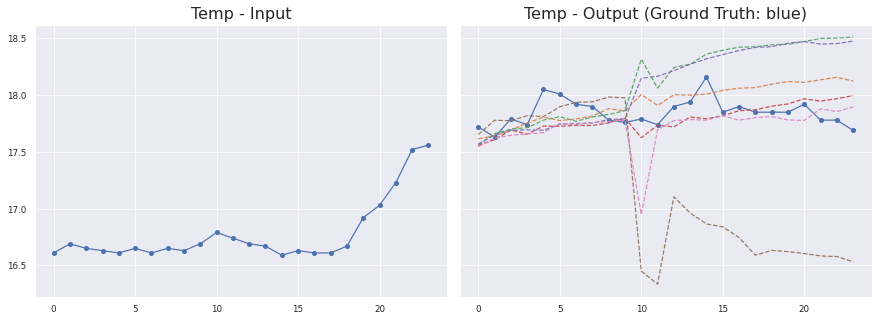

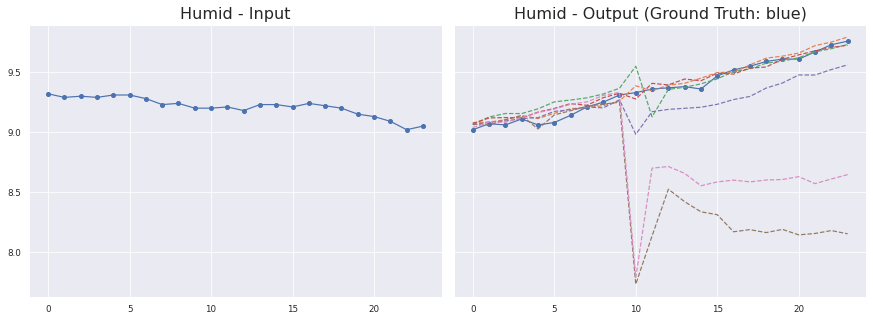

Sensor #3


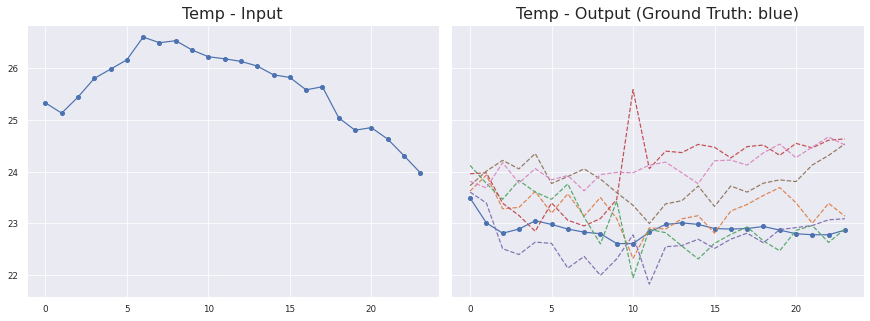

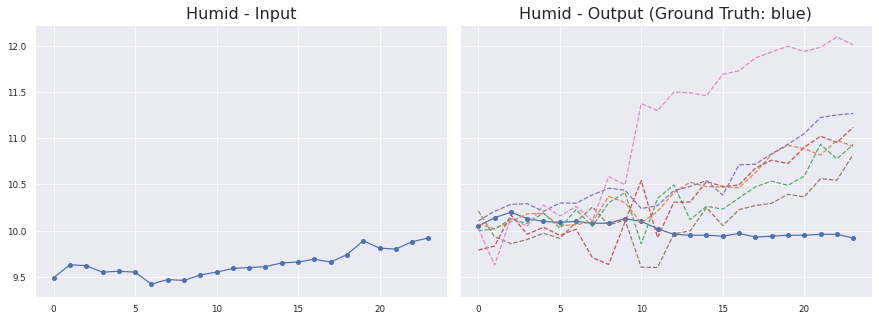

Sensor #9


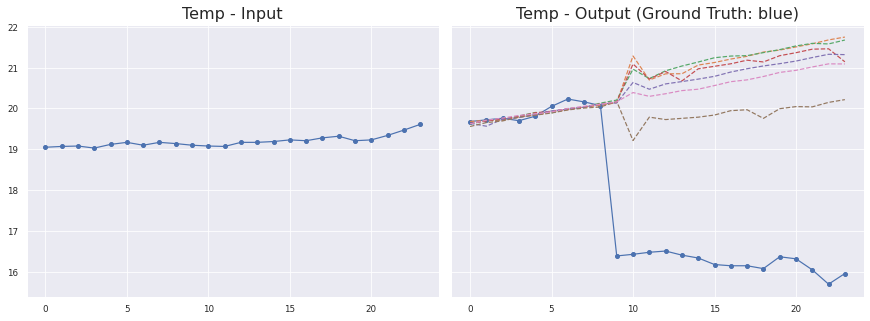

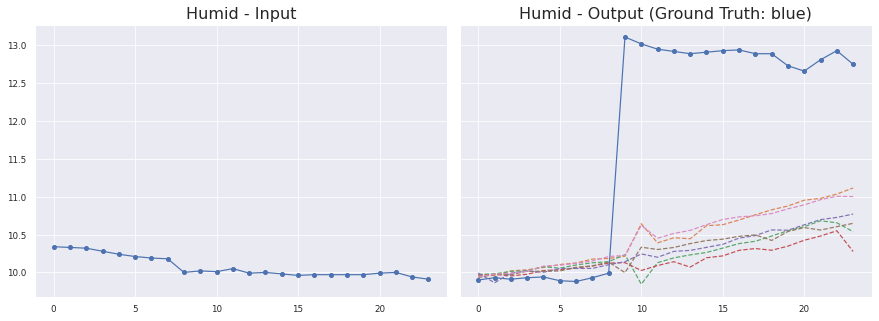

Sensor #3


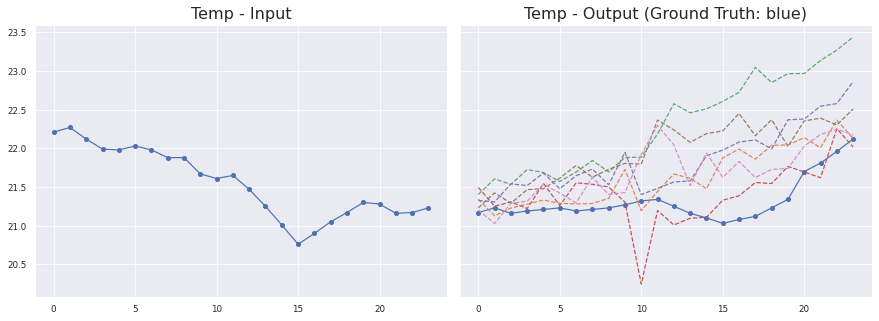

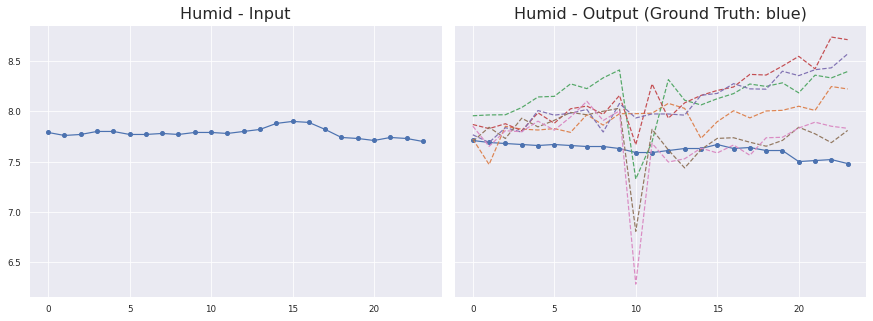

Sensor #19


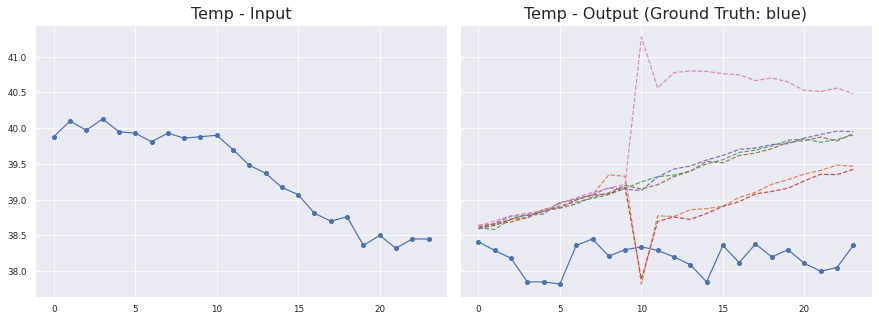

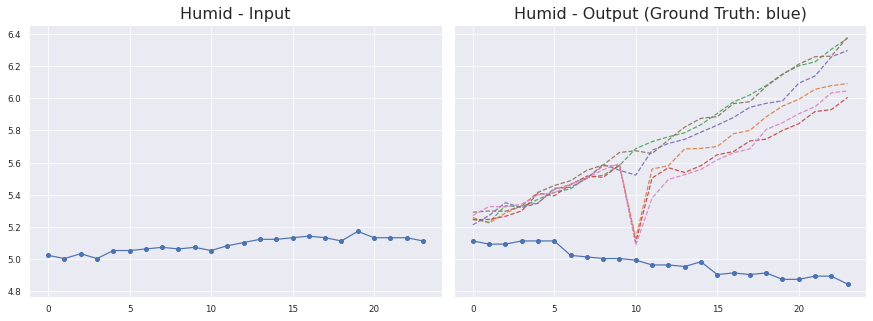

Sensor #12


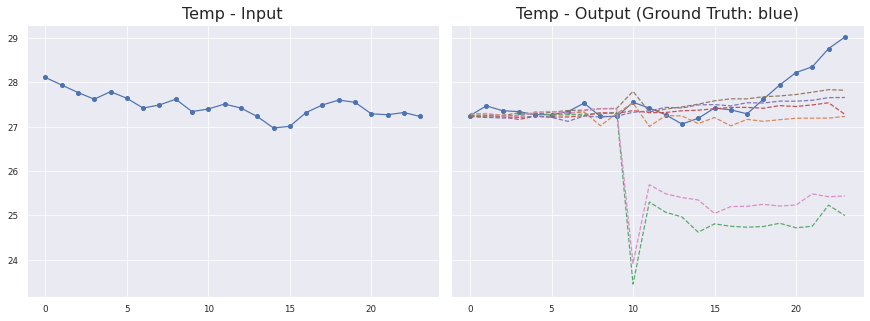

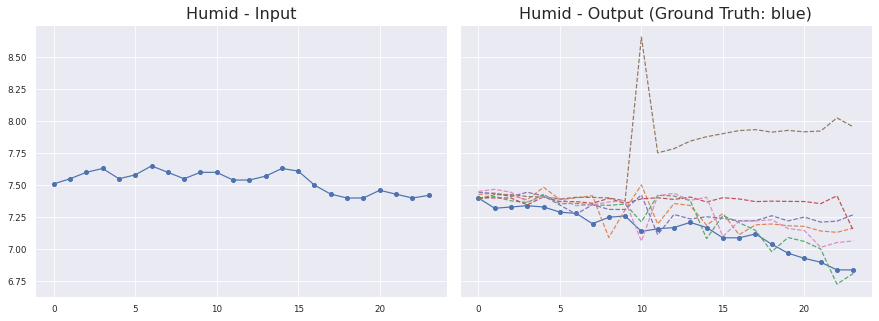

Sensor #31


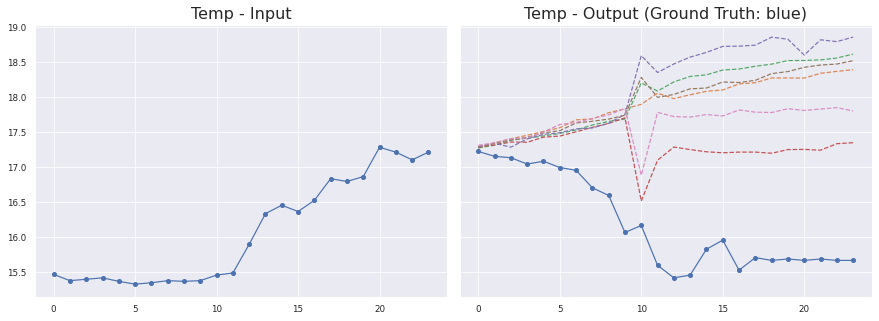

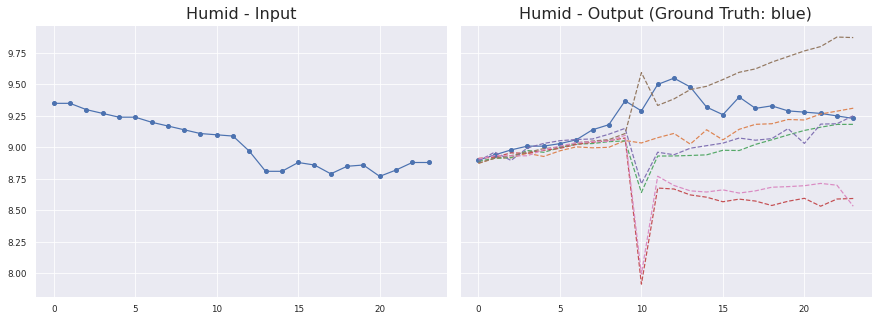

Sensor #10


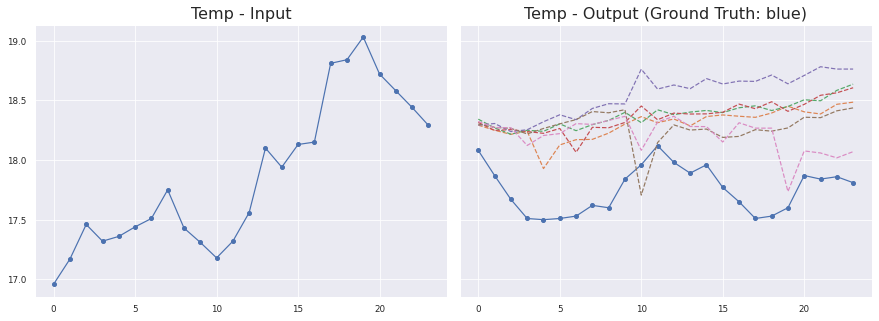

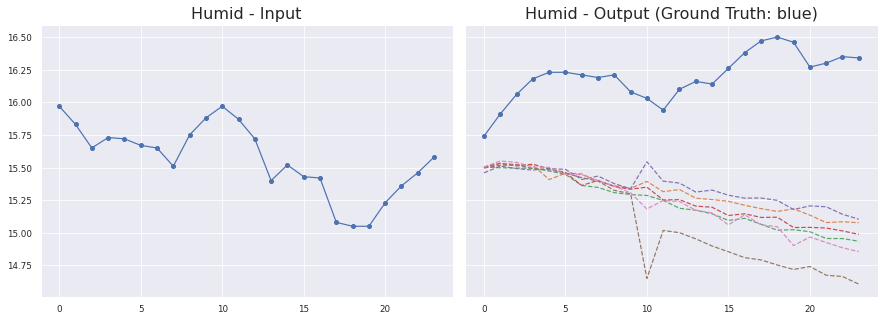

Sensor #0


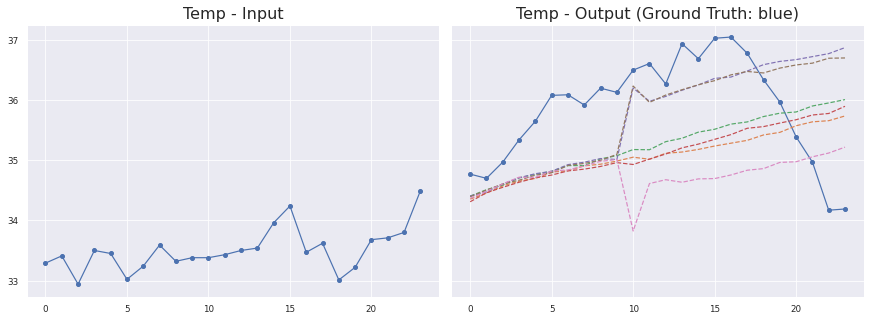

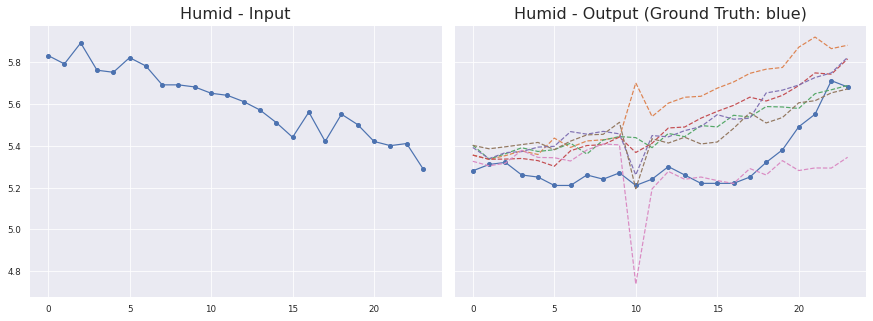

Sensor #19


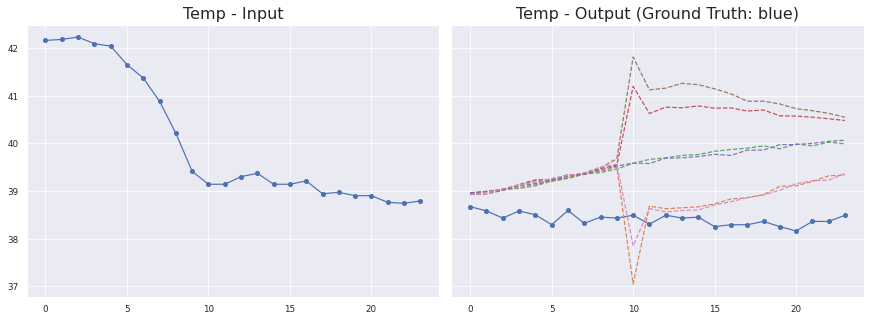

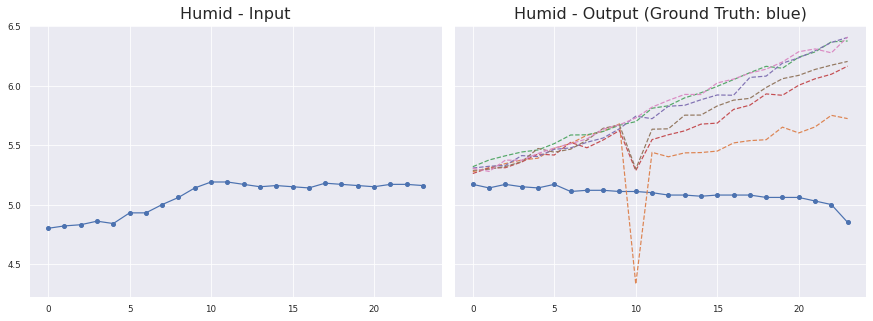

Sensor #7


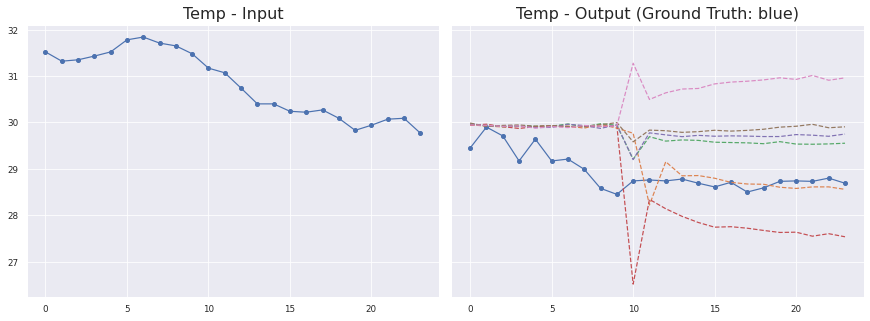

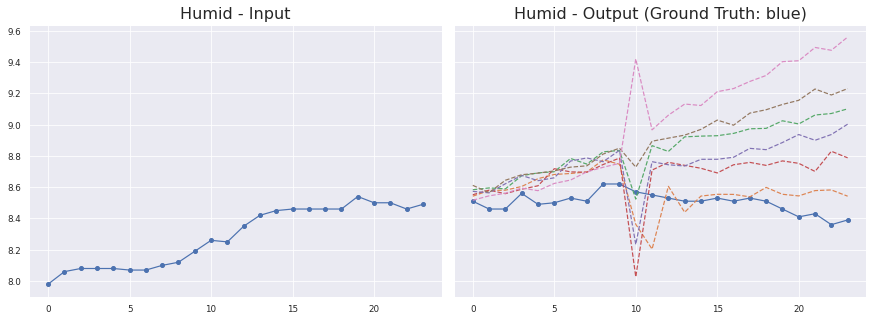

Sensor #1


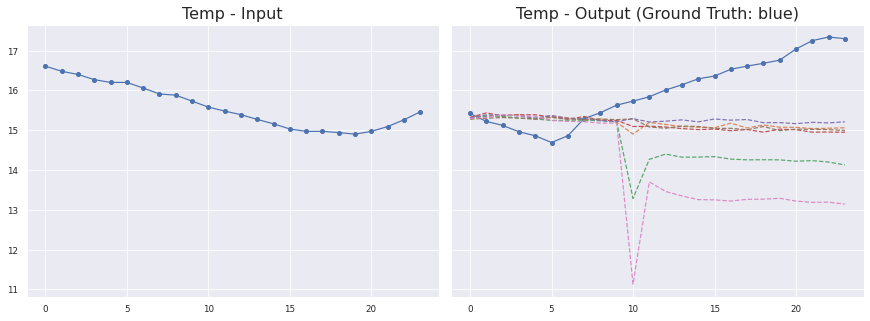

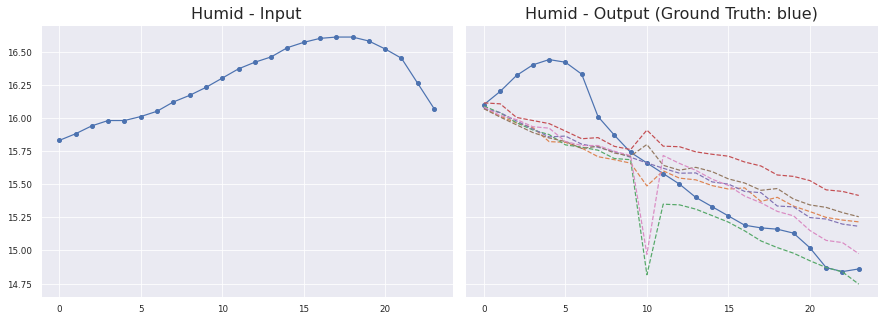

Sensor #11


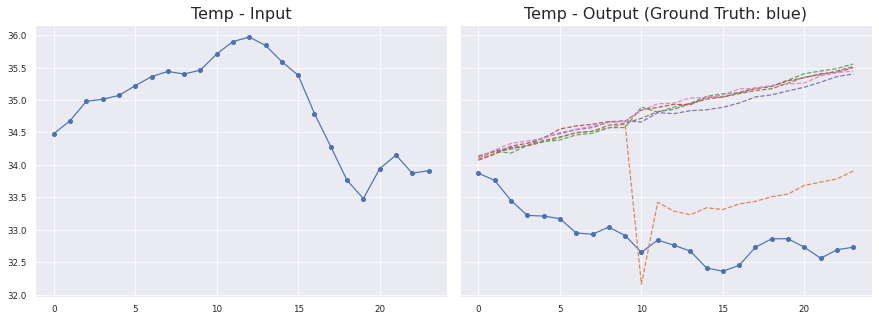

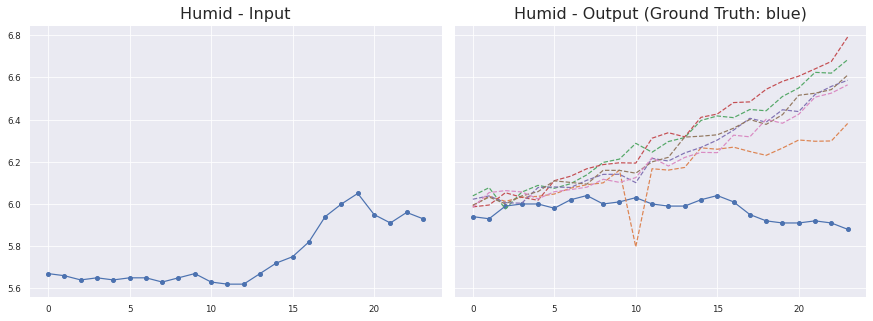

Sensor #5


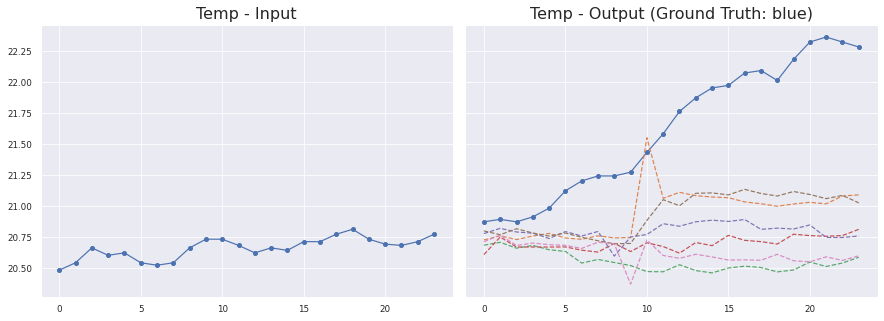

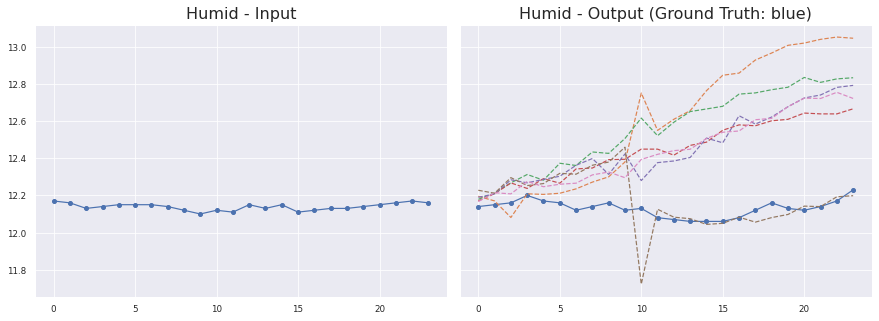

Sensor #4


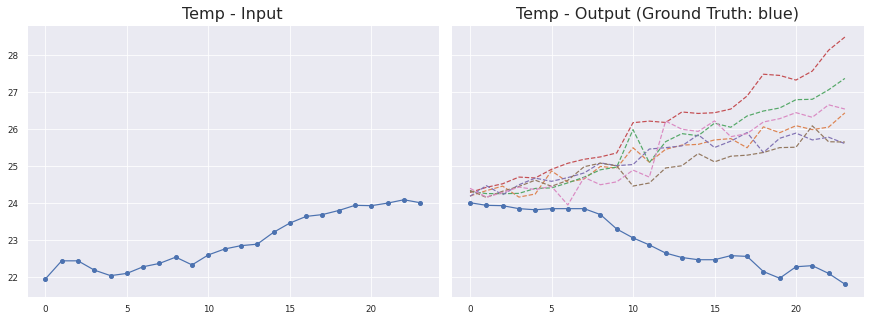

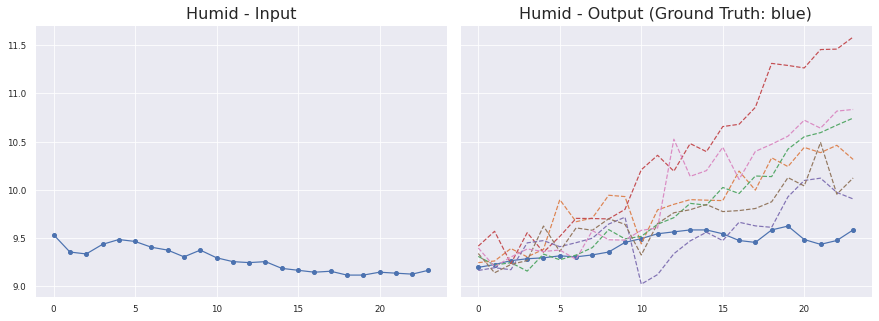

Sensor #31


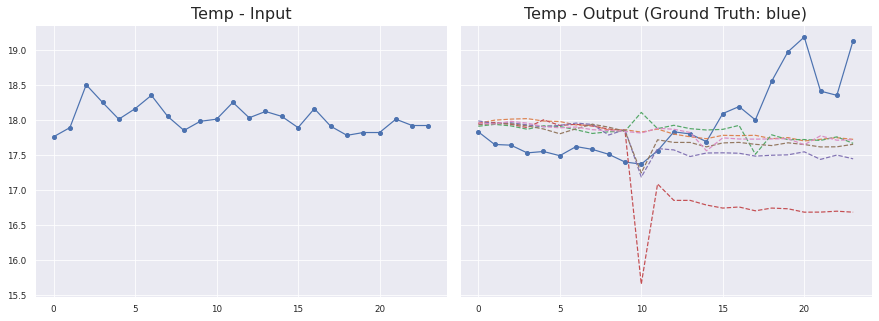

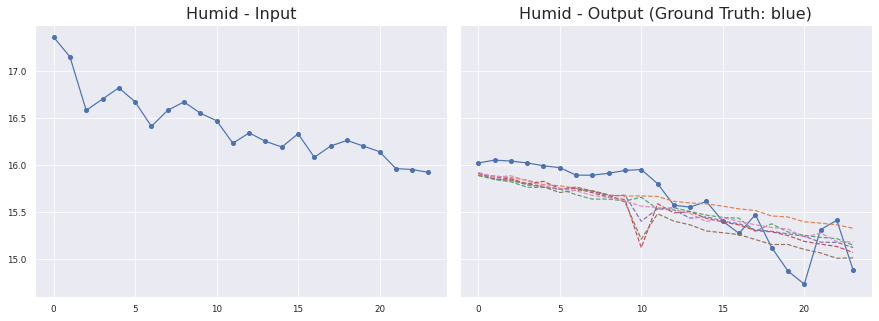

Sensor #6


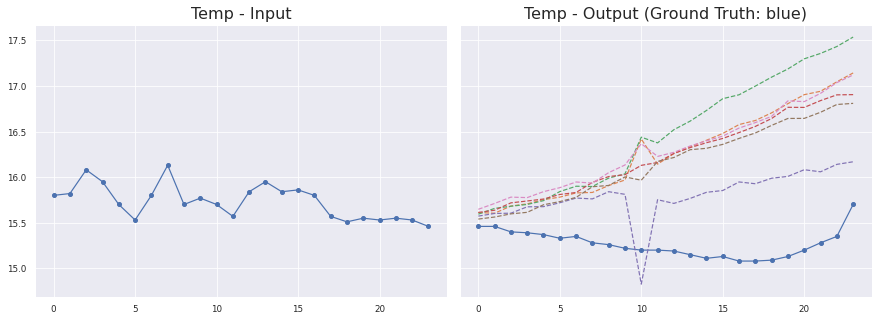

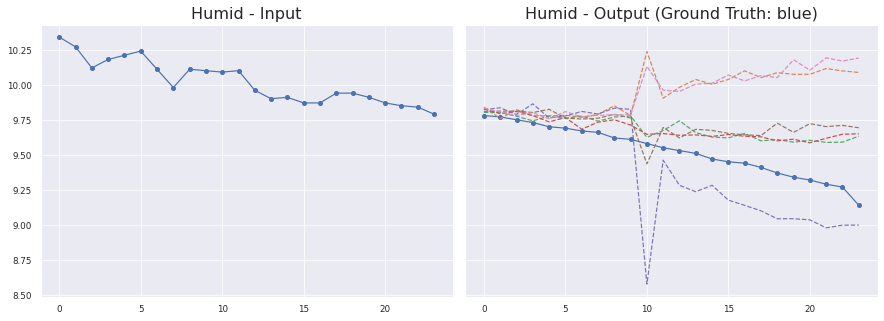

Sensor #22


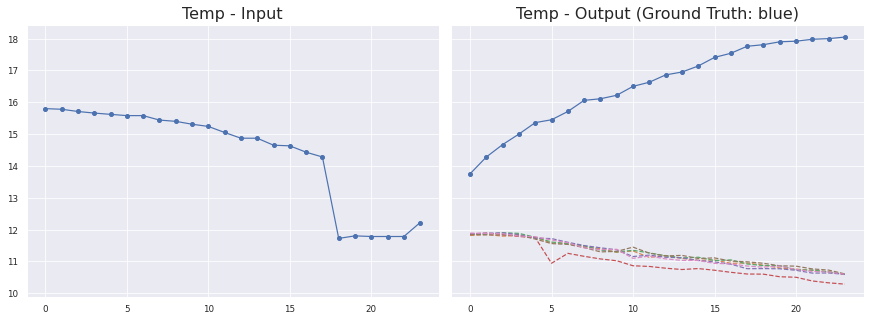

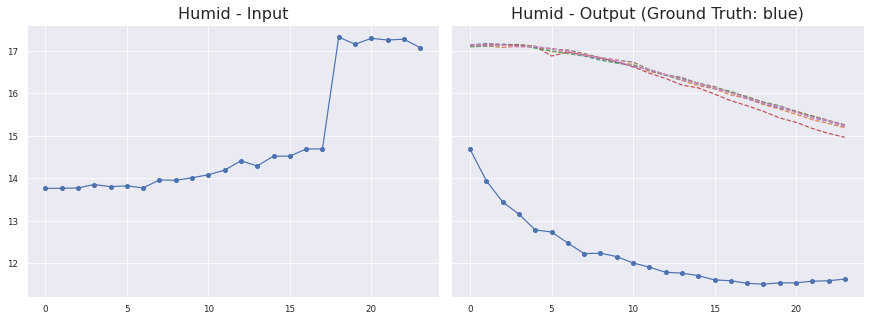

In [ ]:
n_prediction = 24
n_samples = 50
n_scenarios = 6
n_steps_MH_GAN = 20

# get random samples (index)
ix = random.sample(list_ix[:-24], k=n_samples)

# final numpy arrays
y_real_final = np.empty([n_samples,n_prediction,2]) #shape:[10,12,2]

# real values
for k, index in enumerate(ix):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real_final[k,:,:] = y_real_
print(f'y_real shape {y_real_final.shape}')

X_cond = np.copy(X_sc[ix])
X_label = np.copy(label_sc[ix])

# get predictions
y_gen_final = np.empty([n_samples, n_scenarios, n_prediction, 2])
for n in range(n_samples):
  X_aux_2 = X_cond[n].reshape(1,24,2)
  X_label_in = X_label[n].reshape(1,)
  for scen in range(n_scenarios):
    for p in range(n_prediction): 
      # initial real sample
      ix_init = random.sample(list_ix[:-24], k=1)
      X_ = X_sc[ix_init] #[1,24,2]
      y = y_sc[ix_init] #[1, 1,2]
      X = np.concatenate((X_,y), axis=1)
      X_label_init = label_sc[ix_init]
      y_score = calibrated_score(X, X_label_init, calibrator) #[1,1]
      if p == 10:
        n_steps_MH_GAN = 1
      else:
        n_steps_MH_GAN = 20
      for iter in range(n_steps_MH_GAN): #number of tries of new vector inputs
        # generate sample
        if p == 10:
          noise_point = tf.random.normal(shape=(1, latent_dim), stddev=10) #shape:[1,Latent_dim]
        else:
          noise_point = tf.random.normal(shape=(1, latent_dim), stddev=2.3) #shape:[1,Latent_dim]

        if iter == 0:
          selected_noise_point = noise_point
        y_gen_MH_GAN_ = selected_generator.predict([X_aux_2, X_label_in, noise_point]) #Step 1: Predict [1,2]
        y_gen_MH_GAN = y_gen_MH_GAN_[:,np.newaxis,:] #[1,1,2]
        In_MH_GAN = np.concatenate((X_aux_2,y_gen_MH_GAN), axis=1)  #shape:[1,25,2]
        Scores_MH_GAN = calibrated_score(In_MH_GAN, X_label_in, calibrator)  #shape:[1,]
        u = np.random.uniform(0,1)
        if u >= np.fmin(1, ( (1/y_score - 1)/(1/Scores_MH_GAN - 1))):
          print('JUMP!')
          y_score = Scores_MH_GAN
          selected_noise_point = noise_point

      y_gen_ = selected_generator.predict([X_aux_2, X_label_in, selected_noise_point]) #Step 1: Predict [1,2]
      y_gen = y_gen_[:,np.newaxis,:] #[1,1,2]
      y_gen_final[n,scen,p,:] = y_gen_ #Step 2: Save prediction
      X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    X_aux_2 = X_cond[n].reshape(1,24,2)
  print(f'Working... {(100/n_samples)*(n+1)}%')

print(y_gen_final.shape) #shape: [6, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real_final.shape)
y_gen_inv = np.empty(y_gen_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(24):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=16)
    plt.show()
    plt.close()

### Heatmap sensors and predictions

In [ ]:
n = 150

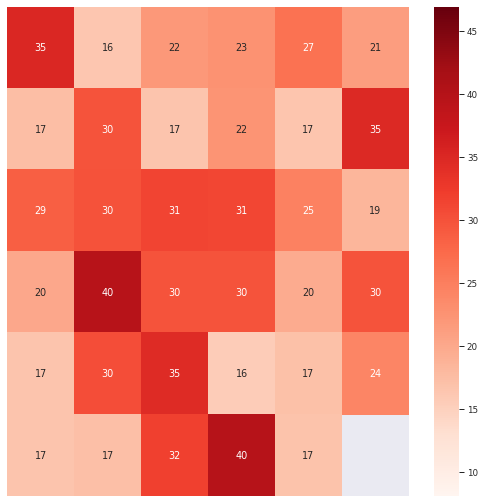

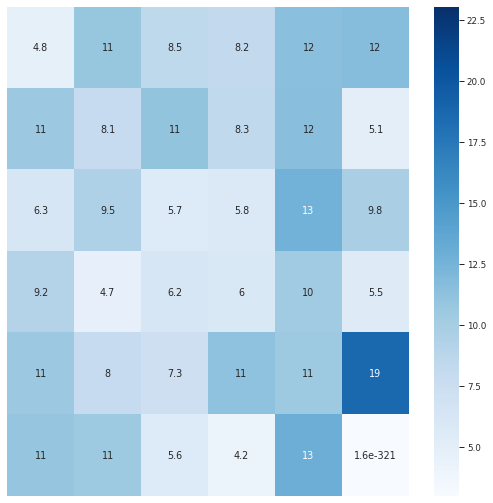

In [ ]:
Temps = np.empty([6,6])
Humids = np.empty([6,6])

for i, sensor_map in enumerate(merged_groups.values()):
  x = i % 6
  y = i // 6
  Temps[y,x] = sensor_map.iloc[n]['TEMP']
  Humids[y,x] = sensor_map.iloc[n]['HUM']

Temps[5,5] = np.NaN
Temps[5,5] = np.NaN

plt.figure(figsize=(9,9))
sns.heatmap(Temps, vmin=8.14, vmax=46.94, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False)
plt.figure(figsize=(9,9))
sns.heatmap(Humids, vmin=3.0, vmax=23.03, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False)

In [ ]:
n_pred = 30

for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  input_X = data[n-24:n,:].reshape(1,24,2)
  input_label = np.array(i).reshape(1,)
  output_y = data[n:n+n_pred,:].reshape(1,n_pred,2)
  # Scale
  input_X_sc = np.empty(input_X.shape)
  for j in range(24):
    input_X_sc[0,j,0] = ((b-a)*(input_X[0,j,0] - min_temp) /(diff_temp) ) + a
    input_X_sc[0,j,1] = ((b-a)*(input_X[0,j,1] - min_humid)/(diff_humid)) + a
  #insert values
  if i == 0:
    X_cond = input_X.copy()
    X_cond_sc = input_X_sc.copy()
    X_label = input_label.copy()
    y_real = output_y.copy()
  else:
    X_cond = np.concatenate((X_cond,input_X), axis=0)
    X_cond_sc = np.concatenate((X_cond_sc,input_X_sc), axis=0)
    X_label = np.concatenate((X_label,input_label), axis=0)
    y_real = np.concatenate((y_real,output_y),axis=0)
print(X_cond.shape)
print(X_cond_sc.shape)
print(X_label.shape)
print(y_real.shape)

(35, 24, 2)
(35, 24, 2)
(35,)
(35, 30, 2)


In [ ]:
# Get predictions
X_aux_2 = np.copy(X_cond_sc)
for p in range(n_pred):
  '''
  if p >= 9 and p < 15:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=15.3)
  else:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)
  '''
  noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)

  y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict 
  y_gen = y_gen_[:,np.newaxis,:] 
  if p == 0: #Step 2: Save prediction
    y_gen_final = y_gen.copy() 
  else:
    y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
  X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
  X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
  
print(y_gen_final.shape)

# Invert Scale
y_gen_inv = np.empty(y_gen_final.shape)
for s in range(35):
  for r in range(n_pred):
    y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)

print(y_gen_inv.shape)

(35, 30, 2)
(35, 30, 2)


In [ ]:
# Which are the MAX and MIN of each column??
flat_temp_real = y_real[:,:,0].flatten()
flat_temp_gen = y_gen_inv[:,:,0].flatten()
flat_humid_real = y_real[:,:,1].flatten()
flat_humid_gen = y_gen_inv[:,:,1].flatten()

Max_temp = max(np.amax(flat_temp_real), np.amax(flat_temp_gen))
min_temp = min(np.amin(flat_temp_real), np.amin(flat_temp_gen))
Max_humid = max(np.amax(flat_humid_real), np.amax(flat_humid_gen))
min_humid = min(np.amin(flat_humid_real), np.amin(flat_humid_gen))

print(f'Max Temp: {Max_temp}')
print(f'min Temp: {min_humid}')
print(' ')

print(f'Max Humid: {Max_humid}')
print(f'min Humid: {min_humid}')
print(' ')

Max Temp: 40.89
min Temp: 4.15
 
Max Humid: 19.76
min Humid: 4.15
 


In [ ]:
for n in range(n_pred):  
  step_plot = n

  Temps_real = np.empty([6,6])
  Temps_gen = np.empty([6,6])
  Humids_real = np.empty([6,6])
  Humids_gen = np.empty([6,6])
  for i in range(35):
    x = i % 6
    y = i // 6
    Temps_real[y,x] = y_real[i,step_plot,0]
    Temps_gen[y,x] = y_gen_inv[i,step_plot,0]
    Humids_real[y,x] = y_real[i,step_plot,1]
    Humids_gen[y,x] = y_gen_inv[i,step_plot,1]

  Temps_real[5,5] = np.NaN
  Temps_gen[5,5] = np.NaN
  Humids_real[5,5] = np.NaN
  Humids_gen[5,5] = np.NaN

  # plot images
  fig,axs = plt.subplots(1,2,figsize=(18,7))
  axs[0].set_title(f'Heatmap Sensors - Temperature Real - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Temps_real, vmin=min_temp, vmax=Max_temp, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[0])
  axs[1].set_title(f'Heatmap Sensors - Temperature Fake - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Temps_gen, vmin=min_temp, vmax=Max_temp, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[1])
  plt.show()

  fig,axs = plt.subplots(1,2,figsize=(18,7))
  axs[0].set_title(f'Heatmap Sensors - Humidity Real - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Humids_real, vmin=min_humid, vmax=Max_humid, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[0])
  axs[1].set_title(f'Heatmap Sensors - Humidity Fake - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Humids_gen, vmin=min_humid, vmax=Max_humid, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[1])
  plt.show()

In [ ]:
# plot images and metrics
for i in range(35):
  for j in range(dim_n_vars):
    fig,axs = plt.subplots(1,dim_n_vars,sharey=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real[i,:,j], marker='.', ms=8)
    axs[1].plot(y_gen_inv[i,:,j], 'tab:red', marker='.', ms=8)
    axs[1].set_title('Output (red: predicted)', fontsize=16)
    plt.show()
    plt.close()
    print(dict_variables[j])
    # mean absolute error ± standard deviation
    error_np = np.subtract(y_real[i,:,j], y_gen_inv[i,:,j])
    mae = mean_absolute_error(y_real[i,:,j], y_gen_inv[i,:,j])
    std = np.std(error_np)
    print(f'MAE: {mae} ± {std}') 
    # mean squared error
    mse = mean_squared_error(y_real[i,:,j], y_gen_inv[i,:,j])
    print(f'MSE: {mse}') 
    # root mean square error
    rmse = np.sqrt(mse)
    print(f'RMSE: {rmse}') 
    # max error
    max_err = max_error(y_real[i,:,j], y_gen_inv[i,:,j])
    print(f'Max Error: {max_err}') 